In [496]:
%load_ext autoreload
%autoreload 2

import os
import json
import main
import random
import numpy as np
import matplotlib.pyplot as plt
from argparse import ArgumentDefaultsHelpFormatter, ArgumentParser
from tqdm import tqdm
from dataraw_sampling import decode_key_idx, encode_key_idx, decode_query_idx_to_key_properties, check_q1q2k_match, queryidx_to_querypair, decode_key_idx

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [461]:
def find_eulcidean(v, Wv):
    # (b, ), similarity = negative distance
    return - np.sum((v.reshape(1, -1) - Wv)**2, axis=-1)**(1/2)

def find_cos(v, Wv):
    dot_products = np.dot(Wv, v) # shape v,1
    l2norm_products = np.multiply(np.linalg.norm(Wv, axis=1),np.linalg.norm(v)) #shape v,1
    cos_sim = np.divide(dot_products,l2norm_products)
    return cos_sim

def find_dotproduct(v, Wv):
    # (b,)
    print('hit')
    return np.dot(Wv, v)

def find_nn(v, Wv, similarity_fn, k=None):
    """Find nearest neighbors of a given word, by cosine similarity.
    
    Returns two parallel lists: indices of nearest neighbors, and 
    their cosine similarities. Both lists are in descending order, 
    and inclusive: so nns[0] should be the index of the input word, 
    nns[1] should be the index of the first nearest neighbor, and so on.
    
    You may find the following numpy functions useful:
      np.linalg.norm : take the l2-norm of a vector or matrix
      np.dot : dot product or matrix multiplication
      np.argsort : get indices sorted by element value,
        so np.argsort(numbers)[-5:] will return the top five elements
    
    Args:
      v: (d-dimensional vector) word vector of interest
      Wv: (V x d matrix) word embeddings
      k: (int) number of neighbors to return
    
    Returns (nns, ds), where:
      nns: (k-dimensional vector of int), row indices of nearest neighbors, 
        which may include the given word.
      similarities: (k-dimensional vector of float), cosine similarity of each 
        neighbor in nns.
    """
    if k is None:
        k = Wv.shape[0]
    sim = similarity_fn(v, Wv)
    nns = np.argsort(sim)[-k:][::-1]
    similarities = np.take(sim, nns)
    return nns, similarities

def analogy(vA, vB, vC, Wv, k, similarity_fn):
    """Compute a linear analogy in vector space, as described in the async.
    Find the vector(s) that best answer "A is to B as C is to ___", returning 
    the top k candidates by cosine similarity.
    
    Args:
      vA: (d-dimensional vector) vector for word A
      vB: (d-dimensional vector) vector for word B
      vC: (d-dimensional vector) vector for word C
      Wv: (V x d matrix) word embeddings
      k: (int) number of neighbors to return
    Returns (nns, ds), where:
      nns: (k-dimensional vector of int), row indices of the top candidate 
        words.
      similarities: (k-dimensional vector of float), cosine similarity of each 
        of the top candidate words.
    """
    A_to_B = vB - vA
    vD = vC + A_to_B
    return find_nn(vD, Wv, similarity_fn, k)
    
    
def construct_filter(count_table, hparams, num_attr_shared_in_query, num_attr_hit_by_key=None):
    '''compute filters'''
    keep_queries = []
    keep_querykeys = np.zeros(count_table.shape)
    for i in range((hparams['query_support_size'])):
        card1, card2 = queryidx_to_querypair(hparams['num_attributes'], hparams['num_attr_vals'], i)
        if np.sum(card1 == card2) == num_attr_shared_in_query:
            keep_queries.append(True)
            for j in range(hparams['key_support_size']):
                num_matches = check_q1q2k_match(hparams['num_attributes'], hparams['num_attr_vals'], card1, card2, j)
                if num_matches == num_attr_hit_by_key:
                    keep_querykeys[j,i] = 1.0
        else:
            keep_queries.append(False)

    return keep_queries, keep_querykeys

In [3]:
# arguments
parser = ArgumentParser(formatter_class=ArgumentDefaultsHelpFormatter)
args = parser.parse_args('')

args.data_path = '../Raw_Datasets/3Attr-4Vals-2hat23Train-2hat12Val.json'
args.config_path = 'config.json'
args.mode = 'train'
args.generate_full_matrix = True

In [370]:
game_data = main.load_data(args.data_path)
main.validate_data(game_data)
hparams = main.load_hparams(args, game_data)

---------data----------
num_attributes : 3
num_attr_vals : 4
key_support_size : 65
query_support_size : 4096
train_datapoints length : 8388608
val_datapoints length : 4096
sparsity_estimate : 0.17980795755722673
-----------------------
----------hparams----------
seed : 42
batch_size : 512
max_epochs : 200
d_model : 128
embed_dropout : 0.0
model : contrastive
embedding_by_property : False
encoder : lookup
decoder : lookup
d_ff : 1024
num_heads : 1
N_enc : 2
N_dec : 2
attn_wt_tying_scheme : untie_QKVO_zero_O
attn_wt_dropout : 0.0
heads_dropout : 0.0
pff_dropout : 0.0
representation_pos : 0
dotproduct_bottleneck : True
loss_temperature_const : 1.0
loss_smoothing_const : 0.1
nonlinear_classifier_scale_down_factor : [2, 1]
adam_lr : 0.001
adam_beta1 : 0.9
adam_beta2 : 0.999
adam_epsilon : 1e-08
adam_weight_decay : 0
scheduled_adam_beta1 : 0.9
scheduled_adam_beta2 : 0.98
scheduled_adam_epsilon : 1e-09
scheduled_adam_warmup_steps : 4000
gradient_clip_val : 0
debug : False
key_support_size : 

In [35]:
gt = main.gen_full_matrix(hparams)
xy = gt['xy']
count_table = gt['count_table']

Generating Full Matrix
Generated 65 unqiue cards
Generated 4096 cardpairs
-- 2368 cardpairs with shared concept
-- 1728 cardpairs without shared concept
Number of cardpairs per shared concept [(1, 1728), (0, 1728), (2, 576), (3, 64)]
Total number of matches =  47872
Number of matches per key concept hit =  [(1, 43200), (2, 2880), (0, 1728), (3, 64)]
{'shape': (65, 4096), 'size': 266240, 'sparsity': 0.1798076923076923, 'xy_rank': 65, 'xy_div_xyind_rank': 65}


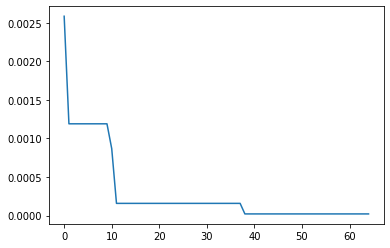

In [467]:
xy = count_table / np.sum(count_table)
u,s,vh = np.linalg.svd(xy, full_matrices=False)
plt.plot(s)

In [576]:
d_model = 37
u_repr = np.matmul(u[:, :d_model], np.diag(s[:d_model]))
# key_repr = np.matmul(u[:d_model, :].T, np.diag(s[:d_model]))
vh_repr = vh[:d_model, :]
print('u_repr.shape', u_repr.shape)
print('vh_repr.shape', vh_repr.shape)

reconstruct = (np.matmul(u_repr, vh_repr))
reconstruct_normalized = reconstruct / (np.sum(reconstruct, axis=0).reshape(1, -1))
count_table_normalized = count_table / np.sum(count_table, axis=0).reshape(1, -1)
threshold = 1 / count_table.shape[1]
predictions = (reconstruct_normalized > threshold).astype(int)
print('errors:', np.sum(predictions != count_table))
print('successes:', np.sum(predictions == count_table))

key_repr = u_repr
query_repr = vh_repr

u_repr.shape (65, 37)
vh_repr.shape (37, 4096)
errors: 8456
successes: 257784


In [577]:
# closest key for each key
for i in range(game_data['key_support_size']):
    print('key:' ,decode_key_idx(game_data['num_attributes'], game_data['num_attr_vals'], i))
    print(('NNs:\n'))
    nns, distances = find_nn(v=key_repr[i], Wv=key_repr, similarity_fn=find_cos)
    for nni, dist in zip(nns, distances):
        print(decode_key_idx(game_data['num_attributes'], game_data['num_attr_vals'], nni.item()), dist)
    print('---------------------------')

key: [0 0 0]
NNs:

[0 0 0] 1.0
[0 0 1] 0.6952596858185276
[0 2 0] 0.6949889900513034
[0 0 3] 0.6934793761070595
[0 3 0] 0.6915217379896563
[0 0 2] 0.6909511331788487
[1 0 0] 0.6909103911341712
[0 1 0] 0.6901343526564122
[2 0 0] 0.6894434901852705
[3 0 0] 0.6893327078522222
[1 2 0] 0.4117562469665492
[0 1 1] 0.40699626004380346
[3 0 3] 0.40594682505009433
[0 3 1] 0.4058819990057155
[2 0 3] 0.40488402090335296
[1 0 1] 0.40482574327282256
[1 0 2] 0.40421146710501227
[2 2 0] 0.4038459878139541
[3 2 0] 0.40384424881006376
[1 3 0] 0.4021813041697555
[3 3 0] 0.40211926559975425
[2 1 0] 0.4020469024839075
[2 0 2] 0.4019244682272558
[3 0 2] 0.40156216068039674
[2 3 0] 0.4015019226895653
[3 1 0] 0.40100886693352583
[0 1 3] 0.4009876384128903
[0 3 3] 0.40094959434682764
[0 2 1] 0.40037276838659225
[0 1 2] 0.4003581357351565
[0 2 2] 0.39972642083581517
[1 0 3] 0.39943184967016443
[0 2 3] 0.3990708056328303
[2 0 1] 0.3988196232352069
[3 0 1] 0.39838307755570235
[0 3 2] 0.3976916562044413
[1 1 0] 0.

[0 0 2] 0.3971956487824919
[3 3 1] 0.397156584939834
[1 3 2] 0.3971028110211433
[3 2 3] 0.39706662356932926
[1 0 3] 0.39687225499847606
[0 2 2] 0.3968405471738632
[0 1 1] 0.3968091216882281
[0 1 2] 0.39678203033032033
[0 2 1] 0.39678082393129793
[3 0 3] 0.3967381902558624
[0 2 0] 0.3967150616674396
[2 3 0] 0.3967070779685458
[0 0 1] 0.3967021530456434
[1 3 1] 0.3966958255498669
[2 0 3] 0.3966891716504396
[3 3 0] 0.3966821442140276
[1 3 0] 0.39668021103889084
[2 1 3] 0.3966758120922015
[3 1 3] 0.39667387054599046
[3 2 1] 0.1263050535454314
[2 2 1] 0.12624434237197954
[3 0 0] 0.12548249520699156
[2 0 0] 0.12546113459507058
[1 1 2] 0.12541211121564075
[1 1 0] 0.1254079325483889
[1 0 0] 0.12521108756397378
[3 2 2] 0.12518137816956598
[2 2 2] 0.12515525334196845
[1 1 1] 0.12511801014380522
[3 0 1] 0.1250578363392361
[2 0 1] 0.12500390198272265
[3 1 1] 0.12499274286400346
[2 1 1] 0.12484985715741193
[3 1 2] 0.12482471183588939
[3 1 0] 0.1247707321630773
[1 2 1] 0.12475103895346402
[3 0 2] 0.

[1 2 2] 0.3964437677000434
[0 0 0] 0.12799803526761908
[3 0 0] 0.12573587872057537
[2 0 0] 0.1257063847161208
[0 1 0] 0.12553240644129277
[2 2 3] 0.125399776237797
[0 0 2] 0.12534626118084394
[3 2 2] 0.12531250608860534
[2 2 2] 0.12527488035516238
[3 2 3] 0.12520220255043102
[0 2 3] 0.12500875132387498
[0 2 2] 0.12489698373458162
[0 0 3] 0.1248729352067685
[0 1 2] 0.12479510511449594
[3 1 2] 0.12478076391189916
[0 1 3] 0.12469894906115023
[3 1 0] 0.1246957964075435
[0 2 0] 0.12464652522275783
[3 0 2] 0.12461562891268588
[2 1 2] 0.12459870256792112
[2 0 2] 0.12456517056434271
[2 1 0] 0.12454847355912925
[2 1 3] 0.12450962289115455
[3 1 3] 0.12449946574345468
[3 2 0] 0.12432278443488157
[2 2 0] 0.12432258284796172
[2 0 3] 0.12420765130476602
[3 0 3] 0.12410061214634549
[] 6.467580376256893e-17
---------------------------
key: [1 3 2]
NNs:

[1 3 2] 1.0000000000000004
[1 2 2] 0.689857212869713
[1 0 2] 0.689699130799096
[1 3 0] 0.689124209286706
[1 3 1] 0.6890215355458257
[1 3 3] 0.68870017

[3 3 2] 0.3973174257260977
[3 3 1] 0.39726395786767776
[2 2 2] 0.39723129039202254
[0 3 2] 0.3972210840913786
[1 3 2] 0.3971974034968393
[2 0 1] 0.3970000726033551
[1 2 0] 0.3969793695384325
[2 1 1] 0.3967928253512037
[0 3 3] 0.3967070779685458
[3 1 0] 0.3967010268837061
[0 2 0] 0.3966686412925139
[2 1 2] 0.3966396278739801
[1 3 1] 0.3966342487789797
[3 3 3] 0.3966309400710874
[2 0 2] 0.3966207854579659
[2 1 3] 0.39659246076587507
[3 2 0] 0.3965273269870626
[0 3 1] 0.3965262739755513
[2 0 3] 0.3965150384745732
[1 1 3] 0.12700005795759506
[3 2 1] 0.126668407270843
[1 1 2] 0.12556833901292144
[1 2 3] 0.12542081102872132
[0 0 2] 0.12530227443602712
[3 2 2] 0.1252716580686162
[1 1 1] 0.12518875493405535
[3 2 3] 0.12517181188256143
[3 0 1] 0.12510934477934044
[3 1 1] 0.12502259762413967
[0 2 3] 0.12499751778062403
[1 0 3] 0.12494160582010959
[0 2 2] 0.12489735541855493
[0 0 3] 0.1248758609859821
[0 1 2] 0.12480644584805528
[0 2 1] 0.124804402743461
[3 1 2] 0.1247936810824222
[0 1 3] 0.12472

[3 2 3] 1.0000000000000002
[3 0 3] 0.6901779917800627
[3 2 1] 0.6896698225857824
[3 2 0] 0.6894943787453255
[3 1 3] 0.6891147360199442
[3 3 3] 0.68897339180727
[0 2 3] 0.6885493009024096
[1 2 3] 0.6884859237376819
[2 2 3] 0.6884738663740235
[3 2 2] 0.6884700204095261
[1 2 0] 0.39973884322039116
[2 0 3] 0.39781512878460445
[1 2 2] 0.3977725347588922
[2 2 0] 0.39758804132002623
[1 1 3] 0.3973202393100234
[2 1 3] 0.39729441085314987
[3 3 0] 0.3972558834509287
[3 0 2] 0.39716192067197853
[0 2 0] 0.3971272792495561
[1 2 1] 0.3971080188947891
[3 1 0] 0.3970754663061775
[0 1 3] 0.39707228980838966
[0 3 3] 0.39706662356932926
[2 2 1] 0.39703066181336316
[3 1 2] 0.39699539678888407
[0 2 1] 0.3969849437101134
[2 3 3] 0.39694833401061524
[0 0 3] 0.3969207386348261
[0 2 2] 0.3969032007793998
[1 0 3] 0.39686953101328776
[3 1 1] 0.39681590015443363
[3 0 1] 0.3967690115651427
[1 3 3] 0.3967205143374893
[2 2 2] 0.39671763191327564
[3 3 1] 0.39670946674034435
[3 3 2] 0.3966979784669375
[3 0 0] 0.396671

In [582]:
# closest query for each key
found_idxs = []

for i in tqdm(range(game_data['key_support_size'])):
    key_prop = tuple(decode_key_idx(game_data['num_attributes'], game_data['num_attr_vals'], i))
    print('key:' , key_prop)
    print(('NNs:\n'))
    nns, distances = find_nn(v=key_repr[i], Wv=query_repr.T, similarity_fn=find_dotproduct, k=None)
    for j, (nni, dist) in enumerate(zip(nns, distances)):
        query_prop = decode_query_idx_to_key_properties(game_data['num_attributes'], game_data['num_attr_vals'], nni.item())
        query_prop = (tuple(query_prop[0]),tuple(query_prop[1]))
        if tuple(set(query_prop)) == (key_prop,):
            found_idx = j
            found_qkdist = (key_prop, query_prop, dist)
        print(f'{j} \t', query_prop, 
              dist.item())
    print(found_idx)
    found_idxs.append((found_idx, found_qkdist))
    print('---------------------------')
    

  0%|          | 0/65 [00:00<?, ?it/s]

key: (0, 0, 0)
NNs:

hit
0 	 ((3, 0, 0), (3, 0, 0)) 2.7106213317331302e-05
1 	 ((0, 0, 0), (3, 0, 0)) 2.7061996066606014e-05
2 	 ((0, 0, 0), (1, 0, 0)) 2.7061996066606004e-05
3 	 ((0, 0, 0), (2, 0, 0)) 2.7061996066605957e-05
4 	 ((2, 0, 0), (0, 0, 0)) 2.7061996066605953e-05
5 	 ((3, 0, 0), (2, 0, 0)) 2.7061996066605953e-05
6 	 ((3, 0, 0), (0, 0, 0)) 2.7061996066605953e-05
7 	 ((2, 0, 0), (3, 0, 0)) 2.7061996066605953e-05
8 	 ((1, 0, 0), (3, 0, 0)) 2.7061996066605953e-05
9 	 ((1, 0, 0), (2, 0, 0)) 2.7061996066605953e-05
10 	 ((2, 0, 0), (1, 0, 0)) 2.7061996066605953e-05
11 	 ((1, 0, 0), (0, 0, 0)) 2.7061996066605953e-05
12 	 ((3, 0, 0), (1, 0, 0)) 2.7061996066605953e-05
13 	 ((2, 0, 0), (2, 0, 0)) 2.699523174175832e-05
14 	 ((0, 1, 0), (0, 1, 0)) 2.6325168785368036e-05
15 	 ((1, 0, 0), (1, 0, 0)) 2.5612709879948814e-05
16 	 ((0, 0, 2), (0, 0, 2)) 2.557635922380559e-05
17 	 ((0, 0, 0), (0, 1, 0)) 2.5080636016779784e-05
18 	 ((0, 1, 0), (0, 0, 0)) 2.5080636016779645e-05
19 	 ((0, 3, 0), (

1207 	 ((3, 1, 0), (2, 1, 2)) 7.327206372044432e-22
1208 	 ((2, 1, 1), (3, 1, 0)) 7.327206372044432e-22
1209 	 ((2, 1, 3), (0, 1, 2)) 7.327206372044432e-22
1210 	 ((0, 1, 0), (3, 1, 2)) 7.327206372044432e-22
1211 	 ((0, 1, 2), (2, 1, 0)) 7.327206372044432e-22
1212 	 ((0, 1, 3), (2, 1, 0)) 7.327206372044432e-22
1213 	 ((0, 1, 1), (2, 1, 2)) 7.327206372044432e-22
1214 	 ((2, 1, 0), (1, 1, 2)) 7.327206372044432e-22
1215 	 ((3, 1, 0), (0, 1, 2)) 7.327206372044432e-22
1216 	 ((3, 1, 0), (1, 1, 2)) 7.327206372044432e-22
1217 	 ((0, 1, 0), (1, 1, 2)) 7.327206372044432e-22
1218 	 ((2, 1, 2), (1, 1, 0)) 7.327206372044432e-22
1219 	 ((0, 1, 3), (1, 1, 0)) 7.327206372044432e-22
1220 	 ((0, 1, 3), (1, 1, 2)) 7.327206372044432e-22
1221 	 ((2, 1, 2), (3, 1, 0)) 7.327206372044432e-22
1222 	 ((0, 1, 3), (3, 1, 2)) 7.327206372044432e-22
1223 	 ((2, 1, 1), (1, 1, 0)) 7.327206372044432e-22
1224 	 ((2, 1, 1), (0, 1, 2)) 7.327206372044432e-22
1225 	 ((2, 1, 3), (1, 1, 2)) 7.327206372044432e-22
1226 	 ((2, 

2389 	 ((2, 2, 2), (3, 3, 3)) -5.496205397452862e-22
2390 	 ((2, 2, 3), (0, 0, 0)) -5.496205397452862e-22
2391 	 ((2, 2, 3), (0, 0, 1)) -5.496205397452862e-22
2392 	 ((2, 2, 3), (0, 0, 2)) -5.496205397452862e-22
2393 	 ((0, 0, 1), (1, 2, 0)) -5.496205397452862e-22
2394 	 ((2, 2, 3), (0, 1, 0)) -5.496205397452862e-22
2395 	 ((2, 2, 3), (0, 1, 1)) -5.496205397452862e-22
2396 	 ((2, 2, 3), (0, 1, 2)) -5.496205397452862e-22
2397 	 ((0, 0, 1), (1, 1, 3)) -5.496205397452862e-22
2398 	 ((0, 0, 1), (1, 1, 2)) -5.496205397452862e-22
2399 	 ((2, 2, 3), (0, 3, 0)) -5.496205397452862e-22
2400 	 ((2, 2, 3), (0, 3, 1)) -5.496205397452862e-22
2401 	 ((2, 2, 3), (0, 3, 2)) -5.496205397452862e-22
2402 	 ((2, 2, 3), (1, 0, 0)) -5.496205397452862e-22
2403 	 ((2, 2, 3), (1, 0, 1)) -5.496205397452862e-22
2404 	 ((2, 2, 3), (1, 0, 2)) -5.496205397452862e-22
2405 	 ((0, 0, 1), (1, 1, 0)) -5.496205397452862e-22
2406 	 ((2, 2, 3), (1, 1, 0)) -5.496205397452862e-22
2407 	 ((2, 2, 3), (1, 1, 1)) -5.4962053974528

  2%|▏         | 1/65 [00:00<00:44,  1.44it/s]

 ((3, 0, 3), (3, 2, 0)) -6.815483045436457e-21
3570 	 ((3, 0, 2), (3, 1, 3)) -6.815483045436457e-21
3571 	 ((3, 0, 0), (3, 1, 2)) -6.815483045436457e-21
3572 	 ((3, 1, 2), (3, 0, 0)) -6.815483045436457e-21
3573 	 ((3, 0, 0), (3, 1, 1)) -6.815483045436457e-21
3574 	 ((3, 1, 2), (3, 0, 1)) -6.815483045436457e-21
3575 	 ((3, 1, 2), (3, 0, 3)) -6.815483045436457e-21
3576 	 ((3, 0, 2), (3, 1, 0)) -6.815483045436457e-21
3577 	 ((3, 0, 2), (3, 1, 1)) -6.815483045436457e-21
3578 	 ((3, 0, 2), (3, 2, 0)) -6.815483045436457e-21
3579 	 ((3, 1, 3), (3, 0, 2)) -6.815483045436457e-21
3580 	 ((3, 1, 2), (3, 2, 0)) -6.815483045436457e-21
3581 	 ((3, 1, 2), (3, 2, 1)) -6.815483045436457e-21
3582 	 ((3, 1, 2), (3, 2, 3)) -6.815483045436457e-21
3583 	 ((3, 2, 3), (3, 3, 2)) -6.815483045436457e-21
3584 	 ((3, 1, 2), (3, 3, 0)) -6.815483045436457e-21
3585 	 ((3, 0, 2), (3, 2, 1)) -6.815483045436457e-21
3586 	 ((3, 1, 2), (3, 3, 3)) -6.815483045436457e-21
3587 	 ((3, 0, 0), (3, 1, 3)) -6.815483045436457e-21

540 	 ((1, 0, 2), (0, 0, 3)) 2.0889037433154998e-05
541 	 ((0, 0, 3), (1, 0, 1)) 2.0889037433154998e-05
542 	 ((0, 0, 2), (2, 0, 1)) 2.0889037433154998e-05
543 	 ((0, 0, 2), (2, 0, 0)) 2.0889037433154998e-05
544 	 ((0, 0, 3), (1, 0, 2)) 2.0889037433154998e-05
545 	 ((0, 0, 2), (1, 0, 3)) 2.0889037433154998e-05
546 	 ((1, 0, 2), (2, 0, 0)) 2.0889037433154998e-05
547 	 ((1, 0, 2), (2, 0, 1)) 2.0889037433154998e-05
548 	 ((0, 0, 3), (2, 0, 0)) 2.0889037433154998e-05
549 	 ((0, 0, 3), (2, 0, 1)) 2.0889037433154998e-05
550 	 ((0, 0, 2), (1, 0, 1)) 2.0889037433154998e-05
551 	 ((1, 0, 2), (2, 0, 3)) 2.0889037433154998e-05
552 	 ((1, 0, 2), (3, 0, 0)) 2.0889037433154998e-05
553 	 ((1, 0, 2), (3, 0, 1)) 2.0889037433154998e-05
554 	 ((0, 0, 2), (1, 0, 0)) 2.0889037433154998e-05
555 	 ((1, 0, 2), (3, 0, 3)) 2.0889037433154998e-05
556 	 ((1, 0, 3), (0, 0, 0)) 2.0889037433154998e-05
557 	 ((1, 0, 3), (0, 0, 1)) 2.0889037433154998e-05
558 	 ((0, 0, 2), (2, 0, 3)) 2.0889037433154998e-05
559 	 ((1, 0

1721 	 ((1, 2, 0), (0, 0, 3)) 1.5026788998380537e-21
1722 	 ((3, 3, 3), (1, 0, 1)) 1.5026788998380537e-21
1723 	 ((1, 2, 0), (0, 1, 1)) 1.5026788998380537e-21
1724 	 ((3, 3, 3), (1, 0, 2)) 1.5026788998380537e-21
1725 	 ((1, 2, 0), (0, 1, 2)) 1.5026788998380537e-21
1726 	 ((1, 2, 0), (0, 1, 3)) 1.5026788998380537e-21
1727 	 ((3, 2, 0), (1, 3, 3)) 1.5026788998380537e-21
1728 	 ((3, 3, 3), (1, 1, 0)) 1.5026788998380537e-21
1729 	 ((3, 3, 3), (1, 1, 1)) 1.5026788998380537e-21
1730 	 ((1, 2, 0), (0, 3, 1)) 1.5026788998380537e-21
1731 	 ((1, 2, 0), (0, 3, 2)) 1.5026788998380537e-21
1732 	 ((1, 2, 0), (3, 3, 2)) 1.5026788998380537e-21
1733 	 ((1, 2, 0), (3, 3, 3)) 1.5026788998380537e-21
1734 	 ((1, 2, 1), (0, 0, 0)) 1.5026788998380537e-21
1735 	 ((1, 2, 1), (3, 3, 3)) 1.5026788998380537e-21
1736 	 ((1, 2, 1), (2, 3, 3)) 1.5026788998380537e-21
1737 	 ((1, 2, 1), (3, 0, 0)) 1.5026788998380537e-21
1738 	 ((3, 2, 0), (0, 3, 2)) 1.5026788998380537e-21
1739 	 ((1, 2, 1), (3, 0, 2)) 1.50267889983805

2763 	 ((2, 3, 2), (3, 2, 0)) 1.5026788998380537e-21
2764 	 ((2, 0, 3), (3, 3, 1)) 1.5026788998380537e-21
2765 	 ((2, 3, 2), (3, 1, 3)) 1.5026788998380537e-21
2766 	 ((2, 0, 3), (3, 3, 2)) 1.5026788998380537e-21
2767 	 ((2, 3, 2), (3, 1, 1)) 1.5026788998380537e-21
2768 	 ((2, 1, 0), (0, 0, 1)) 1.5026788998380537e-21
2769 	 ((2, 3, 2), (3, 1, 0)) 1.5026788998380537e-21
2770 	 ((2, 1, 3), (0, 0, 2)) 1.5026788998380537e-21
2771 	 ((2, 1, 3), (0, 0, 1)) 1.5026788998380537e-21
2772 	 ((2, 1, 3), (0, 0, 0)) 1.5026788998380537e-21
2773 	 ((2, 3, 2), (3, 0, 3)) 1.5026788998380537e-21
2774 	 ((2, 1, 0), (0, 0, 2)) 1.5026788998380537e-21
2775 	 ((2, 1, 0), (0, 0, 3)) 1.5026788998380537e-21
2776 	 ((2, 3, 2), (3, 0, 1)) 1.5026788998380537e-21
2777 	 ((2, 3, 2), (3, 0, 0)) 1.5026788998380537e-21
2778 	 ((2, 1, 0), (0, 2, 1)) 1.5026788998380537e-21
2779 	 ((2, 1, 0), (0, 2, 2)) 1.5026788998380537e-21
2780 	 ((2, 1, 0), (0, 2, 3)) 1.5026788998380537e-21
2781 	 ((2, 1, 2), (3, 3, 3)) 1.50267889983805

  3%|▎         | 2/65 [00:01<00:44,  1.42it/s]

-1.2955228603681875e-07
4012 	 ((3, 1, 3), (2, 1, 3)) -1.2955228603681875e-07
4013 	 ((0, 1, 3), (2, 1, 3)) -1.2955228603681875e-07
4014 	 ((1, 1, 3), (2, 1, 3)) -1.2955228603681875e-07
4015 	 ((1, 1, 3), (3, 1, 3)) -1.2955228603681875e-07
4016 	 ((2, 1, 3), (1, 1, 3)) -1.2955228603681875e-07
4017 	 ((2, 1, 3), (3, 1, 3)) -1.2955228603681875e-07
4018 	 ((3, 1, 3), (1, 1, 3)) -1.2955228603681875e-07
4019 	 ((3, 1, 3), (0, 1, 3)) -1.2955228603681875e-07
4020 	 ((1, 1, 0), (1, 1, 0)) -1.3743849980318102e-07
4021 	 ((1, 1, 2), (1, 1, 2)) -1.410198639477753e-07
4022 	 ((3, 2, 3), (2, 2, 3)) -3.0428604380062023e-07
4023 	 ((1, 2, 3), (3, 2, 3)) -3.0428604380062023e-07
4024 	 ((1, 2, 3), (2, 2, 3)) -3.0428604380062023e-07
4025 	 ((0, 2, 3), (1, 2, 3)) -3.0428604380062023e-07
4026 	 ((2, 2, 3), (1, 2, 3)) -3.0428604380062023e-07
4027 	 ((3, 2, 3), (1, 2, 3)) -3.0428604380062023e-07
4028 	 ((3, 2, 3), (0, 2, 3)) -3.0428604380062023e-07
4029 	 ((2, 2, 3), (3, 2, 3)) -3.0428604380062023e-07
4030 

1101 	 ((0, 2, 1), (3, 2, 3)) 2.3753585377811976e-20
1102 	 ((3, 2, 0), (0, 2, 3)) 2.3753585377811976e-20
1103 	 ((2, 2, 1), (3, 2, 2)) 2.3753585377811976e-20
1104 	 ((2, 2, 3), (0, 2, 1)) 2.3753585377811976e-20
1105 	 ((1, 2, 1), (3, 2, 0)) 2.3753585377811976e-20
1106 	 ((1, 2, 1), (2, 2, 3)) 2.3753585377811976e-20
1107 	 ((1, 2, 1), (2, 2, 2)) 2.3753585377811976e-20
1108 	 ((1, 2, 1), (2, 2, 0)) 2.3753585377811976e-20
1109 	 ((1, 2, 1), (0, 2, 3)) 2.3753585377811976e-20
1110 	 ((1, 2, 1), (0, 2, 2)) 2.3753585377811976e-20
1111 	 ((2, 2, 3), (1, 2, 2)) 2.3753585377811976e-20
1112 	 ((1, 2, 1), (0, 2, 0)) 2.3753585377811976e-20
1113 	 ((1, 2, 0), (3, 2, 3)) 2.3753585377811976e-20
1114 	 ((1, 2, 0), (3, 2, 2)) 2.3753585377811976e-20
1115 	 ((1, 2, 0), (3, 2, 1)) 2.3753585377811976e-20
1116 	 ((1, 2, 0), (2, 2, 3)) 2.3753585377811976e-20
1117 	 ((1, 2, 0), (2, 2, 2)) 2.3753585377811976e-20
1118 	 ((1, 2, 0), (2, 2, 1)) 2.3753585377811976e-20
1119 	 ((1, 2, 0), (0, 2, 3)) 2.37535853778119

2259 	 ((0, 3, 1), (2, 2, 0)) 9.338102169702018e-22
2260 	 ((0, 3, 1), (2, 2, 2)) 9.338102169702018e-22
2261 	 ((0, 3, 1), (2, 2, 3)) 9.338102169702018e-22
2262 	 ((0, 3, 1), (3, 0, 0)) 9.338102169702018e-22
2263 	 ((0, 3, 1), (3, 0, 2)) 9.338102169702018e-22
2264 	 ((0, 3, 1), (3, 0, 3)) 9.338102169702018e-22
2265 	 ((0, 3, 1), (3, 1, 0)) 9.338102169702018e-22
2266 	 ((0, 3, 1), (3, 1, 2)) 9.338102169702018e-22
2267 	 ((0, 3, 1), (3, 1, 3)) 9.338102169702018e-22
2268 	 ((0, 3, 1), (3, 2, 0)) 9.338102169702018e-22
2269 	 ((0, 3, 1), (3, 2, 2)) 9.338102169702018e-22
2270 	 ((0, 3, 1), (3, 2, 3)) 9.338102169702018e-22
2271 	 ((0, 0, 3), (3, 2, 2)) 9.338102169702018e-22
2272 	 ((0, 0, 3), (3, 2, 1)) 9.338102169702018e-22
2273 	 ((3, 2, 2), (1, 1, 3)) 9.338102169702018e-22
2274 	 ((3, 2, 2), (1, 1, 1)) 9.338102169702018e-22
2275 	 ((3, 2, 2), (1, 1, 0)) 9.338102169702018e-22
2276 	 ((3, 2, 2), (1, 0, 3)) 9.338102169702018e-22
2277 	 ((0, 3, 1), (1, 2, 0)) 9.338102169702018e-22
2278 	 ((0, 

  5%|▍         | 3/65 [00:02<00:44,  1.39it/s]

 ((1, 1, 3), (1, 0, 2)) -1.1880925415574988e-20
3361 	 ((1, 2, 1), (1, 1, 0)) -1.1880925415574988e-20
3362 	 ((1, 2, 1), (1, 1, 2)) -1.1880925415574988e-20
3363 	 ((1, 3, 3), (1, 1, 1)) -1.1880925415574988e-20
3364 	 ((1, 3, 0), (1, 0, 3)) -1.1880925415574988e-20
3365 	 ((1, 2, 0), (1, 3, 1)) -1.1880925415574988e-20
3366 	 ((1, 3, 0), (1, 1, 1)) -1.1880925415574988e-20
3367 	 ((1, 2, 2), (1, 1, 3)) -1.1880925415574988e-20
3368 	 ((1, 2, 3), (1, 0, 2)) -1.1880925415574988e-20
3369 	 ((1, 3, 2), (1, 0, 0)) -1.1880925415574988e-20
3370 	 ((1, 2, 3), (1, 0, 1)) -1.1880925415574988e-20
3371 	 ((1, 2, 3), (1, 0, 0)) -1.1880925415574988e-20
3372 	 ((1, 2, 2), (1, 3, 0)) -1.1880925415574988e-20
3373 	 ((1, 3, 0), (1, 2, 1)) -1.1880925415574988e-20
3374 	 ((1, 3, 0), (1, 2, 2)) -1.1880925415574988e-20
3375 	 ((1, 2, 2), (1, 3, 1)) -1.1880925415574988e-20
3376 	 ((1, 2, 2), (1, 3, 3)) -1.1880925415574988e-20
3377 	 ((1, 3, 0), (1, 2, 3)) -1.1880925415574988e-20
3378 	 ((1, 3, 2), (1, 0, 1)) -1.1

370 	 ((3, 0, 3), (0, 0, 2)) 2.0889037433155076e-05
371 	 ((0, 0, 3), (2, 0, 2)) 2.0889037433155076e-05
372 	 ((3, 0, 3), (1, 0, 0)) 2.0889037433155076e-05
373 	 ((3, 0, 3), (1, 0, 1)) 2.0889037433155076e-05
374 	 ((3, 0, 3), (1, 0, 2)) 2.0889037433155076e-05
375 	 ((3, 0, 3), (2, 0, 0)) 2.0889037433155076e-05
376 	 ((3, 0, 3), (2, 0, 1)) 2.0889037433155076e-05
377 	 ((3, 0, 3), (2, 0, 2)) 2.0889037433155076e-05
378 	 ((0, 0, 3), (3, 0, 2)) 2.0889037433155076e-05
379 	 ((0, 0, 3), (3, 0, 1)) 2.0889037433155076e-05
380 	 ((0, 0, 3), (3, 0, 0)) 2.0889037433155076e-05
381 	 ((0, 0, 3), (2, 0, 1)) 2.0889037433155076e-05
382 	 ((3, 0, 1), (2, 0, 3)) 2.0889037433155076e-05
383 	 ((0, 0, 3), (1, 0, 1)) 2.0889037433155076e-05
384 	 ((3, 0, 0), (2, 0, 1)) 2.0889037433155076e-05
385 	 ((0, 0, 3), (1, 0, 2)) 2.0889037433155076e-05
386 	 ((0, 0, 1), (1, 0, 0)) 2.0889037433155076e-05
387 	 ((2, 0, 0), (0, 0, 1)) 2.0889037433155076e-05
388 	 ((0, 0, 1), (3, 0, 3)) 2.0889037433155076e-05
389 	 ((0, 0

1438 	 ((1, 1, 2), (3, 0, 3)) 4.0621254990684e-22
1439 	 ((3, 3, 2), (0, 0, 3)) 4.0621254990684e-22
1440 	 ((1, 1, 2), (3, 2, 0)) 4.0621254990684e-22
1441 	 ((1, 1, 2), (3, 2, 1)) 4.0621254990684e-22
1442 	 ((1, 1, 2), (3, 2, 3)) 4.0621254990684e-22
1443 	 ((1, 1, 2), (3, 3, 0)) 4.0621254990684e-22
1444 	 ((1, 1, 2), (2, 2, 1)) 4.0621254990684e-22
1445 	 ((0, 1, 1), (1, 2, 2)) 4.0621254990684e-22
1446 	 ((0, 1, 1), (2, 0, 0)) 4.0621254990684e-22
1447 	 ((1, 1, 2), (2, 0, 3)) 4.0621254990684e-22
1448 	 ((1, 1, 1), (3, 2, 0)) 4.0621254990684e-22
1449 	 ((1, 1, 1), (3, 2, 2)) 4.0621254990684e-22
1450 	 ((0, 1, 1), (3, 0, 2)) 4.0621254990684e-22
1451 	 ((1, 1, 1), (3, 2, 3)) 4.0621254990684e-22
1452 	 ((1, 1, 1), (3, 3, 0)) 4.0621254990684e-22
1453 	 ((1, 1, 1), (3, 3, 2)) 4.0621254990684e-22
1454 	 ((1, 1, 1), (3, 3, 3)) 4.0621254990684e-22
1455 	 ((1, 1, 2), (0, 0, 0)) 4.0621254990684e-22
1456 	 ((1, 1, 2), (0, 0, 1)) 4.0621254990684e-22
1457 	 ((1, 1, 2), (0, 0, 3)) 4.0621254990684e-22


2597 	 ((3, 0, 3), (0, 1, 2)) 4.0621254990684e-22
2598 	 ((3, 0, 3), (0, 1, 1)) 4.0621254990684e-22
2599 	 ((3, 0, 3), (1, 3, 1)) 4.0621254990684e-22
2600 	 ((3, 0, 3), (1, 3, 2)) 4.0621254990684e-22
2601 	 ((3, 1, 2), (2, 3, 3)) 4.0621254990684e-22
2602 	 ((3, 0, 3), (2, 2, 2)) 4.0621254990684e-22
2603 	 ((3, 1, 2), (2, 0, 3)) 4.0621254990684e-22
2604 	 ((3, 1, 2), (2, 2, 0)) 4.0621254990684e-22
2605 	 ((3, 1, 2), (2, 2, 1)) 4.0621254990684e-22
2606 	 ((3, 0, 3), (2, 3, 2)) 4.0621254990684e-22
2607 	 ((3, 0, 3), (2, 3, 1)) 4.0621254990684e-22
2608 	 ((3, 0, 3), (2, 3, 0)) 4.0621254990684e-22
2609 	 ((3, 0, 3), (2, 2, 1)) 4.0621254990684e-22
2610 	 ((3, 1, 2), (2, 3, 1)) 4.0621254990684e-22
2611 	 ((3, 0, 3), (2, 2, 0)) 4.0621254990684e-22
2612 	 ((3, 1, 2), (2, 2, 3)) 4.0621254990684e-22
2613 	 ((3, 0, 3), (2, 1, 2)) 4.0621254990684e-22
2614 	 ((3, 0, 3), (2, 1, 1)) 4.0621254990684e-22
2615 	 ((3, 0, 3), (2, 1, 0)) 4.0621254990684e-22
2616 	 ((3, 1, 2), (2, 3, 0)) 4.0621254990684e-22


  6%|▌         | 4/65 [00:02<00:44,  1.38it/s]

 -1.9067766233532624e-20
3759 	 ((3, 1, 3), (0, 1, 0)) -1.9067766233532624e-20
3760 	 ((2, 1, 1), (0, 1, 2)) -1.9067766233532624e-20
3761 	 ((3, 1, 3), (0, 1, 2)) -1.9067766233532624e-20
3762 	 ((1, 1, 1), (3, 1, 2)) -1.9067766233532624e-20
3763 	 ((1, 1, 1), (0, 1, 2)) -1.9067766233532624e-20
3764 	 ((2, 1, 0), (3, 1, 2)) -1.9067766233532624e-20
3765 	 ((2, 1, 0), (0, 1, 2)) -1.9067766233532624e-20
3766 	 ((0, 1, 0), (1, 1, 2)) -1.9067766233532624e-20
3767 	 ((3, 1, 2), (2, 1, 0)) -1.9067766233532624e-20
3768 	 ((0, 1, 0), (3, 1, 2)) -1.9067766233532624e-20
3769 	 ((2, 1, 3), (0, 1, 0)) -1.9067766233532624e-20
3770 	 ((3, 1, 3), (1, 1, 0)) -1.9067766233532624e-20
3771 	 ((1, 1, 2), (3, 1, 0)) -1.9067766233532624e-20
3772 	 ((1, 1, 2), (0, 1, 0)) -1.9067766233532624e-20
3773 	 ((2, 1, 2), (3, 1, 0)) -1.9067766233532624e-20
3774 	 ((3, 1, 3), (2, 1, 0)) -1.9067766233532624e-20
3775 	 ((3, 1, 1), (2, 1, 0)) -1.9067766233532624e-20
3776 	 ((3, 1, 1), (2, 1, 2)) -1.9067766233532624e-20
377

902 	 ((0, 1, 2), (2, 0, 2)) 1.861844427104743e-20
903 	 ((0, 3, 2), (3, 1, 2)) 1.861844427104743e-20
904 	 ((2, 0, 2), (1, 1, 2)) 1.861844427104743e-20
905 	 ((2, 3, 2), (1, 0, 2)) 1.861844427104743e-20
906 	 ((2, 3, 2), (0, 2, 2)) 1.861844427104743e-20
907 	 ((3, 1, 2), (1, 3, 2)) 1.861844427104743e-20
908 	 ((3, 3, 2), (2, 0, 2)) 1.861844427104743e-20
909 	 ((2, 2, 2), (0, 0, 2)) 1.861844427104743e-20
910 	 ((0, 2, 2), (1, 0, 2)) 1.861844427104743e-20
911 	 ((3, 0, 2), (1, 2, 2)) 1.861844427104743e-20
912 	 ((1, 1, 2), (3, 3, 2)) 1.861844427104743e-20
913 	 ((2, 0, 2), (3, 1, 2)) 1.861844427104743e-20
914 	 ((0, 1, 2), (1, 0, 2)) 1.861844427104743e-20
915 	 ((1, 1, 2), (2, 0, 2)) 1.861844427104743e-20
916 	 ((1, 2, 2), (2, 1, 2)) 1.861844427104743e-20
917 	 ((2, 1, 2), (1, 2, 2)) 1.861844427104743e-20
918 	 ((2, 2, 2), (0, 1, 2)) 1.861844427104743e-20
919 	 ((0, 1, 2), (1, 2, 2)) 1.861844427104743e-20
920 	 ((1, 2, 2), (2, 0, 2)) 1.861844427104743e-20
921 	 ((1, 0, 2), (2, 1, 2)) 1.

2115 	 ((0, 2, 0), (1, 0, 3)) 2.485494027943251e-22
2116 	 ((3, 3, 0), (1, 0, 2)) 2.485494027943251e-22
2117 	 ((0, 2, 0), (1, 1, 1)) 2.485494027943251e-22
2118 	 ((0, 2, 0), (1, 1, 2)) 2.485494027943251e-22
2119 	 ((0, 2, 0), (1, 1, 3)) 2.485494027943251e-22
2120 	 ((3, 3, 0), (1, 0, 1)) 2.485494027943251e-22
2121 	 ((3, 3, 2), (0, 0, 0)) 2.485494027943251e-22
2122 	 ((3, 3, 2), (0, 0, 1)) 2.485494027943251e-22
2123 	 ((0, 2, 0), (1, 3, 1)) 2.485494027943251e-22
2124 	 ((0, 2, 0), (1, 3, 2)) 2.485494027943251e-22
2125 	 ((0, 2, 0), (1, 3, 3)) 2.485494027943251e-22
2126 	 ((0, 2, 0), (2, 0, 1)) 2.485494027943251e-22
2127 	 ((0, 1, 3), (3, 2, 2)) 2.485494027943251e-22
2128 	 ((0, 1, 3), (3, 2, 0)) 2.485494027943251e-22
2129 	 ((0, 1, 2), (3, 3, 1)) 2.485494027943251e-22
2130 	 ((3, 3, 1), (0, 0, 2)) 2.485494027943251e-22
2131 	 ((0, 1, 3), (1, 2, 1)) 2.485494027943251e-22
2132 	 ((0, 1, 3), (1, 2, 0)) 2.485494027943251e-22
2133 	 ((0, 1, 3), (1, 0, 2)) 2.485494027943251e-22
2134 	 ((0, 

  8%|▊         | 5/65 [00:03<00:43,  1.38it/s]

((3, 3, 3), (0, 1, 1)) 2.485494027943251e-22
3310 	 ((3, 3, 3), (0, 1, 0)) 2.485494027943251e-22
3311 	 ((1, 2, 3), (2, 1, 2)) 2.485494027943251e-22
3312 	 ((0, 0, 1), (2, 3, 0)) 2.485494027943251e-22
3313 	 ((1, 2, 3), (2, 1, 1)) 2.485494027943251e-22
3314 	 ((0, 0, 0), (2, 2, 3)) -9.778811434997166e-23
3315 	 ((0, 0, 0), (3, 3, 2)) -1.3947521093200875e-22
3316 	 ((0, 0, 0), (2, 2, 2)) -3.7731969989712254e-22
3317 	 ((0, 0, 0), (3, 2, 1)) -5.560743052703321e-22
3318 	 ((0, 0, 0), (2, 3, 3)) -7.367576063102314e-22
3319 	 ((0, 0, 0), (3, 2, 2)) -7.455087886036124e-22
3320 	 ((0, 0, 0), (3, 1, 3)) -1.2798493470225254e-21
3321 	 ((0, 0, 0), (2, 1, 3)) -3.55993039877248e-21
3322 	 ((0, 0, 0), (3, 1, 1)) -4.4918106716718124e-21
3323 	 ((0, 0, 0), (2, 1, 1)) -6.133700455881481e-21
3324 	 ((2, 3, 2), (2, 1, 1)) -6.643190236116426e-21
3325 	 ((2, 3, 2), (2, 1, 0)) -6.643190236116426e-21
3326 	 ((2, 3, 2), (2, 0, 3)) -6.643190236116426e-21
3327 	 ((2, 2, 2), (2, 3, 3)) -6.643190236116426e-21
33

316 	 ((3, 2, 1), (2, 0, 1)) 2.0889037433155065e-05
317 	 ((3, 1, 1), (0, 3, 1)) 2.0889037433155065e-05
318 	 ((2, 1, 1), (0, 2, 1)) 2.0889037433155065e-05
319 	 ((3, 2, 1), (2, 1, 1)) 2.0889037433155065e-05
320 	 ((1, 0, 1), (3, 3, 1)) 2.0889037433155065e-05
321 	 ((3, 0, 1), (1, 1, 1)) 2.0889037433155065e-05
322 	 ((3, 0, 1), (0, 3, 1)) 2.0889037433155065e-05
323 	 ((3, 1, 1), (0, 2, 1)) 2.0889037433155065e-05
324 	 ((3, 2, 1), (0, 3, 1)) 2.0889037433155065e-05
325 	 ((1, 1, 1), (0, 3, 1)) 2.0889037433155065e-05
326 	 ((3, 1, 1), (0, 0, 1)) 2.0889037433155065e-05
327 	 ((3, 0, 1), (0, 2, 1)) 2.0889037433155065e-05
328 	 ((1, 1, 1), (0, 2, 1)) 2.0889037433155065e-05
329 	 ((3, 2, 1), (1, 1, 1)) 2.0889037433155065e-05
330 	 ((3, 2, 1), (1, 3, 1)) 2.0889037433155065e-05
331 	 ((1, 1, 1), (0, 0, 1)) 2.0889037433155065e-05
332 	 ((2, 1, 1), (0, 3, 1)) 2.0889037433155065e-05
333 	 ((1, 3, 1), (0, 0, 1)) 2.0889037433155065e-05
334 	 ((3, 2, 1), (0, 0, 1)) 2.0889037433155065e-05
335 	 ((1, 2

1567 	 ((3, 1, 0), (0, 3, 1)) 3.729118482404259e-21
1568 	 ((0, 2, 1), (1, 1, 3)) 3.729118482404259e-21
1569 	 ((1, 3, 1), (3, 2, 3)) 3.729118482404259e-21
1570 	 ((1, 3, 1), (3, 2, 2)) 3.729118482404259e-21
1571 	 ((3, 1, 3), (1, 0, 1)) 3.729118482404259e-21
1572 	 ((1, 3, 1), (2, 0, 0)) 3.729118482404259e-21
1573 	 ((1, 3, 1), (2, 0, 2)) 3.729118482404259e-21
1574 	 ((1, 3, 1), (2, 0, 3)) 3.729118482404259e-21
1575 	 ((1, 3, 1), (2, 1, 0)) 3.729118482404259e-21
1576 	 ((3, 1, 3), (1, 2, 2)) 3.729118482404259e-21
1577 	 ((1, 3, 1), (2, 1, 2)) 3.729118482404259e-21
1578 	 ((1, 3, 1), (2, 1, 3)) 3.729118482404259e-21
1579 	 ((1, 3, 1), (2, 2, 0)) 3.729118482404259e-21
1580 	 ((3, 1, 3), (1, 2, 1)) 3.729118482404259e-21
1581 	 ((1, 3, 1), (2, 2, 2)) 3.729118482404259e-21
1582 	 ((1, 3, 1), (2, 2, 3)) 3.729118482404259e-21
1583 	 ((3, 1, 3), (1, 2, 0)) 3.729118482404259e-21
1584 	 ((3, 0, 2), (2, 3, 1)) 3.729118482404259e-21
1585 	 ((1, 3, 1), (3, 0, 0)) 3.729118482404259e-21
1586 	 ((1, 

2701 	 ((3, 0, 0), (2, 2, 1)) 3.729118482404259e-21
2702 	 ((0, 1, 2), (2, 3, 0)) 3.729118482404259e-21
2703 	 ((0, 1, 2), (2, 2, 3)) 3.729118482404259e-21
2704 	 ((0, 1, 2), (2, 2, 1)) 3.729118482404259e-21
2705 	 ((0, 1, 2), (2, 2, 0)) 3.729118482404259e-21
2706 	 ((3, 3, 1), (0, 1, 2)) 3.729118482404259e-21
2707 	 ((0, 1, 0), (3, 2, 2)) 3.729118482404259e-21
2708 	 ((3, 3, 1), (0, 2, 0)) 3.729118482404259e-21
2709 	 ((2, 0, 2), (1, 1, 0)) 3.729118482404259e-21
2710 	 ((3, 0, 0), (2, 3, 2)) 3.729118482404259e-21
2711 	 ((2, 0, 1), (3, 1, 2)) 3.729118482404259e-21
2712 	 ((3, 3, 1), (0, 0, 2)) 3.729118482404259e-21
2713 	 ((2, 0, 1), (3, 1, 3)) 3.729118482404259e-21
2714 	 ((2, 0, 1), (3, 2, 0)) 3.729118482404259e-21
2715 	 ((2, 0, 1), (3, 2, 2)) 3.729118482404259e-21
2716 	 ((2, 0, 1), (3, 2, 3)) 3.729118482404259e-21
2717 	 ((2, 0, 1), (3, 3, 0)) 3.729118482404259e-21
2718 	 ((3, 0, 3), (0, 1, 1)) 3.729118482404259e-21
2719 	 ((2, 0, 1), (3, 3, 2)) 3.729118482404259e-21
2720 	 ((2, 

  9%|▉         | 6/65 [00:04<00:43,  1.37it/s]

 ((1, 3, 3), (2, 3, 0)) -2.788233205211543e-20
3724 	 ((3, 3, 0), (1, 3, 2)) -2.788233205211543e-20
3725 	 ((1, 3, 0), (3, 3, 2)) -2.788233205211543e-20
3726 	 ((1, 3, 3), (3, 3, 0)) -2.788233205211543e-20
3727 	 ((1, 3, 1), (0, 3, 0)) -2.788233205211543e-20
3728 	 ((0, 3, 2), (1, 3, 0)) -2.788233205211543e-20
3729 	 ((1, 3, 1), (3, 3, 0)) -2.788233205211543e-20
3730 	 ((0, 3, 1), (1, 3, 2)) -2.788233205211543e-20
3731 	 ((1, 3, 2), (0, 3, 0)) -2.788233205211543e-20
3732 	 ((3, 3, 0), (2, 3, 2)) -2.788233205211543e-20
3733 	 ((0, 3, 3), (2, 3, 2)) -2.788233205211543e-20
3734 	 ((1, 3, 2), (2, 3, 0)) -2.788233205211543e-20
3735 	 ((1, 3, 2), (3, 3, 0)) -2.788233205211543e-20
3736 	 ((3, 3, 1), (0, 3, 2)) -2.788233205211543e-20
3737 	 ((3, 3, 1), (0, 3, 0)) -2.788233205211543e-20
3738 	 ((0, 3, 0), (1, 3, 2)) -2.788233205211543e-20
3739 	 ((3, 3, 0), (0, 3, 2)) -2.788233205211543e-20
3740 	 ((1, 3, 3), (0, 3, 0)) -2.788233205211543e-20
3741 	 ((0, 3, 0), (2, 3, 2)) -2.788233205211543e-20

667 	 ((0, 0, 1), (0, 0, 2)) 2.065690645527056e-05
668 	 ((0, 0, 2), (0, 0, 3)) 2.065690645527056e-05
669 	 ((0, 0, 0), (0, 1, 0)) 2.0598413658592858e-05
670 	 ((0, 0, 0), (0, 2, 0)) 2.059841365859279e-05
671 	 ((0, 3, 0), (0, 1, 0)) 2.0598413658592756e-05
672 	 ((0, 1, 0), (0, 2, 0)) 2.0598413658592756e-05
673 	 ((0, 3, 0), (0, 0, 0)) 2.0598413658592756e-05
674 	 ((0, 2, 0), (0, 0, 0)) 2.0598413658592756e-05
675 	 ((0, 1, 0), (0, 3, 0)) 2.0598413658592756e-05
676 	 ((0, 3, 0), (0, 2, 0)) 2.0598413658592756e-05
677 	 ((0, 1, 0), (0, 0, 0)) 2.0598413658592756e-05
678 	 ((0, 2, 0), (0, 3, 0)) 2.0598413658592756e-05
679 	 ((0, 2, 0), (0, 1, 0)) 2.0598413658592756e-05
680 	 ((0, 0, 0), (0, 3, 0)) 2.059841365859271e-05
681 	 ((1, 1, 2), (1, 1, 3)) 2.0540887395171803e-05
682 	 ((1, 1, 3), (1, 1, 1)) 2.0540887395171803e-05
683 	 ((1, 1, 0), (1, 1, 3)) 2.0540887395171803e-05
684 	 ((1, 1, 2), (1, 1, 1)) 2.0540887395171803e-05
685 	 ((1, 1, 1), (1, 1, 3)) 2.0540887395171803e-05
686 	 ((1, 1, 0)

1819 	 ((1, 2, 0), (3, 0, 1)) 2.1956457575168753e-21
1820 	 ((1, 2, 0), (3, 0, 2)) 2.1956457575168753e-21
1821 	 ((1, 2, 0), (3, 0, 3)) 2.1956457575168753e-21
1822 	 ((0, 0, 2), (2, 1, 3)) 2.1956457575168753e-21
1823 	 ((0, 1, 1), (2, 2, 3)) 2.1956457575168753e-21
1824 	 ((1, 2, 0), (3, 1, 1)) 2.1956457575168753e-21
1825 	 ((1, 2, 0), (3, 1, 2)) 2.1956457575168753e-21
1826 	 ((1, 2, 0), (3, 1, 3)) 2.1956457575168753e-21
1827 	 ((0, 1, 1), (2, 2, 2)) 2.1956457575168753e-21
1828 	 ((0, 1, 1), (2, 2, 0)) 2.1956457575168753e-21
1829 	 ((3, 3, 2), (2, 1, 1)) 2.1956457575168753e-21
1830 	 ((0, 1, 1), (2, 0, 3)) 2.1956457575168753e-21
1831 	 ((3, 3, 3), (0, 2, 1)) 2.1956457575168753e-21
1832 	 ((1, 2, 1), (2, 1, 3)) 2.1956457575168753e-21
1833 	 ((1, 2, 1), (2, 1, 2)) 2.1956457575168753e-21
1834 	 ((1, 1, 3), (3, 3, 0)) 2.1956457575168753e-21
1835 	 ((1, 1, 3), (3, 2, 2)) 2.1956457575168753e-21
1836 	 ((1, 1, 2), (2, 0, 1)) 2.1956457575168753e-21
1837 	 ((1, 1, 2), (3, 3, 3)) 2.19564575751687

 11%|█         | 7/65 [00:05<00:42,  1.36it/s]

2.1956457575168753e-21
2853 	 ((2, 2, 3), (0, 3, 1)) 2.1956457575168753e-21
2854 	 ((2, 2, 3), (3, 1, 0)) 2.1956457575168753e-21
2855 	 ((2, 2, 3), (3, 1, 1)) 2.1956457575168753e-21
2856 	 ((2, 2, 3), (3, 1, 2)) 2.1956457575168753e-21
2857 	 ((2, 2, 3), (3, 3, 0)) 2.1956457575168753e-21
2858 	 ((2, 2, 3), (3, 3, 1)) 2.1956457575168753e-21
2859 	 ((2, 2, 3), (3, 3, 2)) 2.1956457575168753e-21
2860 	 ((2, 3, 0), (0, 0, 1)) 2.1956457575168753e-21
2861 	 ((2, 3, 0), (0, 0, 2)) 2.1956457575168753e-21
2862 	 ((2, 3, 0), (0, 0, 3)) 2.1956457575168753e-21
2863 	 ((2, 3, 0), (0, 1, 1)) 2.1956457575168753e-21
2864 	 ((2, 3, 0), (0, 1, 2)) 2.1956457575168753e-21
2865 	 ((2, 3, 0), (0, 1, 3)) 2.1956457575168753e-21
2866 	 ((2, 3, 0), (0, 2, 1)) 2.1956457575168753e-21
2867 	 ((2, 3, 0), (0, 2, 2)) 2.1956457575168753e-21
2868 	 ((2, 3, 0), (0, 2, 3)) 2.1956457575168753e-21
2869 	 ((2, 3, 0), (1, 0, 1)) 2.1956457575168753e-21
2870 	 ((2, 3, 0), (1, 0, 2)) 2.1956457575168753e-21
2871 	 ((2, 3, 1), (3, 

key: (0, 1, 3)
NNs:

hit
0 	 ((0, 1, 1), (0, 1, 1)) 2.4449348109386463e-05
1 	 ((3, 1, 3), (3, 1, 3)) 2.408630377779964e-05
2 	 ((2, 1, 3), (2, 1, 3)) 2.4079841277260367e-05
3 	 ((0, 3, 3), (0, 3, 3)) 2.3961141963498316e-05
4 	 ((0, 1, 2), (0, 1, 2)) 2.390912830097826e-05
5 	 ((0, 0, 3), (0, 0, 3)) 2.386574781908679e-05
6 	 ((0, 2, 3), (0, 2, 3)) 2.3792751686740046e-05
7 	 ((0, 1, 0), (0, 1, 0)) 2.3537230308496675e-05
8 	 ((1, 1, 3), (1, 1, 3)) 2.2895431143361078e-05
9 	 ((0, 3, 1), (0, 1, 1)) 2.136771239731133e-05
10 	 ((0, 3, 1), (0, 2, 1)) 2.136771239731133e-05
11 	 ((0, 0, 1), (0, 2, 1)) 2.136771239731133e-05
12 	 ((0, 3, 1), (0, 0, 1)) 2.136771239731133e-05
13 	 ((0, 2, 1), (0, 3, 1)) 2.136771239731133e-05
14 	 ((0, 0, 1), (0, 3, 1)) 2.136771239731133e-05
15 	 ((0, 1, 1), (0, 3, 1)) 2.136771239731133e-05
16 	 ((0, 0, 1), (0, 1, 1)) 2.136771239731133e-05
17 	 ((0, 2, 1), (0, 1, 1)) 2.136771239731133e-05
18 	 ((0, 1, 1), (0, 0, 1)) 2.136771239731133e-05
19 	 ((0, 2, 1), (0, 0, 1)) 2

1078 	 ((1, 1, 1), (1, 3, 2)) 1.0566697389503007e-20
1079 	 ((1, 2, 3), (1, 1, 1)) 1.0566697389503007e-20
1080 	 ((1, 3, 2), (1, 2, 3)) 1.0566697389503007e-20
1081 	 ((1, 1, 1), (1, 3, 0)) 1.0566697389503007e-20
1082 	 ((1, 1, 1), (1, 2, 3)) 1.0566697389503007e-20
1083 	 ((1, 1, 1), (1, 2, 2)) 1.0566697389503007e-20
1084 	 ((1, 1, 1), (1, 2, 0)) 1.0566697389503007e-20
1085 	 ((1, 1, 1), (1, 0, 3)) 1.0566697389503007e-20
1086 	 ((1, 1, 1), (1, 0, 2)) 1.0566697389503007e-20
1087 	 ((1, 0, 2), (1, 2, 0)) 1.0566697389503007e-20
1088 	 ((1, 3, 2), (1, 1, 0)) 1.0566697389503007e-20
1089 	 ((1, 3, 0), (1, 1, 1)) 1.0566697389503007e-20
1090 	 ((1, 0, 2), (1, 3, 3)) 1.0566697389503007e-20
1091 	 ((1, 3, 2), (1, 0, 0)) 1.0566697389503007e-20
1092 	 ((1, 2, 1), (1, 0, 3)) 1.0566697389503007e-20
1093 	 ((1, 2, 1), (1, 1, 0)) 1.0566697389503007e-20
1094 	 ((1, 2, 1), (1, 0, 0)) 1.0566697389503007e-20
1095 	 ((1, 2, 1), (1, 0, 2)) 1.0566697389503007e-20
1096 	 ((1, 3, 2), (1, 0, 1)) 1.05666973895030

2140 	 ((0, 3, 3), (2, 0, 1)) -1.9173376510003686e-22
2141 	 ((0, 3, 3), (3, 1, 0)) -1.9173376510003686e-22
2142 	 ((0, 3, 3), (3, 1, 2)) -1.9173376510003686e-22
2143 	 ((1, 0, 0), (2, 1, 3)) -1.9173376510003686e-22
2144 	 ((0, 3, 3), (3, 2, 0)) -1.9173376510003686e-22
2145 	 ((1, 0, 0), (2, 1, 2)) -1.9173376510003686e-22
2146 	 ((1, 0, 0), (2, 1, 1)) -1.9173376510003686e-22
2147 	 ((1, 0, 0), (0, 3, 3)) -1.9173376510003686e-22
2148 	 ((1, 0, 0), (0, 3, 2)) -1.9173376510003686e-22
2149 	 ((1, 0, 0), (0, 3, 1)) -1.9173376510003686e-22
2150 	 ((1, 0, 0), (0, 2, 3)) -1.9173376510003686e-22
2151 	 ((1, 0, 0), (0, 2, 2)) -1.9173376510003686e-22
2152 	 ((1, 0, 0), (0, 2, 1)) -1.9173376510003686e-22
2153 	 ((1, 0, 0), (0, 1, 3)) -1.9173376510003686e-22
2154 	 ((1, 0, 0), (0, 1, 2)) -1.9173376510003686e-22
2155 	 ((1, 0, 0), (0, 1, 1)) -1.9173376510003686e-22
2156 	 ((3, 2, 2), (0, 3, 0)) -1.9173376510003686e-22
2157 	 ((3, 2, 2), (0, 3, 1)) -1.9173376510003686e-22
2158 	 ((0, 3, 3), (3, 2, 2)

 12%|█▏        | 8/65 [00:05<00:41,  1.36it/s]


3438 	 ((1, 3, 2), (0, 3, 1)) -1.086091628555669e-20
3439 	 ((0, 3, 1), (3, 3, 3)) -1.086091628555669e-20
3440 	 ((1, 3, 1), (0, 3, 3)) -1.086091628555669e-20
3441 	 ((1, 3, 1), (2, 3, 3)) -1.086091628555669e-20
3442 	 ((0, 3, 0), (3, 3, 1)) -1.086091628555669e-20
3443 	 ((0, 3, 0), (3, 3, 3)) -1.086091628555669e-20
3444 	 ((0, 3, 1), (2, 3, 3)) -1.086091628555669e-20
3445 	 ((3, 3, 0), (2, 3, 3)) -1.086091628555669e-20
3446 	 ((3, 3, 0), (2, 3, 1)) -1.086091628555669e-20
3447 	 ((0, 3, 1), (1, 3, 3)) -1.086091628555669e-20
3448 	 ((0, 3, 0), (2, 3, 3)) -1.086091628555669e-20
3449 	 ((3, 3, 2), (1, 3, 1)) -1.086091628555669e-20
3450 	 ((1, 3, 3), (3, 3, 1)) -1.086091628555669e-20
3451 	 ((1, 3, 2), (3, 3, 3)) -1.086091628555669e-20
3452 	 ((0, 3, 0), (2, 3, 1)) -1.086091628555669e-20
3453 	 ((3, 3, 2), (0, 3, 3)) -1.086091628555669e-20
3454 	 ((0, 3, 0), (1, 3, 3)) -1.086091628555669e-20
3455 	 ((1, 3, 2), (0, 3, 3)) -1.086091628555669e-20
3456 	 ((0, 3, 2), (1, 3, 1)) -1.086091628555

505 	 ((0, 3, 1), (0, 0, 3)) 2.0889037433155055e-05
506 	 ((0, 3, 1), (0, 0, 2)) 2.0889037433155055e-05
507 	 ((0, 2, 2), (0, 1, 1)) 2.0889037433155055e-05
508 	 ((0, 3, 1), (0, 0, 0)) 2.0889037433155055e-05
509 	 ((0, 2, 1), (0, 3, 3)) 2.0889037433155055e-05
510 	 ((0, 2, 2), (0, 1, 3)) 2.0889037433155055e-05
511 	 ((0, 2, 2), (0, 3, 0)) 2.0889037433155055e-05
512 	 ((0, 2, 1), (0, 3, 2)) 2.0889037433155055e-05
513 	 ((0, 2, 1), (0, 3, 0)) 2.0889037433155055e-05
514 	 ((0, 2, 1), (0, 1, 3)) 2.0889037433155055e-05
515 	 ((0, 2, 2), (0, 3, 1)) 2.0889037433155055e-05
516 	 ((0, 2, 2), (0, 3, 3)) 2.0889037433155055e-05
517 	 ((0, 3, 0), (0, 2, 3)) 2.0889037433155055e-05
518 	 ((0, 3, 0), (0, 2, 2)) 2.0889037433155055e-05
519 	 ((0, 2, 1), (0, 1, 0)) 2.0889037433155055e-05
520 	 ((0, 3, 3), (0, 2, 0)) 2.0889037433155055e-05
521 	 ((0, 3, 3), (0, 1, 2)) 2.0889037433155055e-05
522 	 ((0, 3, 0), (0, 1, 3)) 2.0889037433155055e-05
523 	 ((0, 3, 1), (0, 1, 3)) 2.0889037433155055e-05
524 	 ((0, 3

1482 	 ((1, 1, 2), (3, 1, 0)) 1.4541913847608942e-20
1483 	 ((1, 1, 2), (2, 1, 0)) 1.4541913847608942e-20
1484 	 ((1, 1, 0), (0, 1, 2)) 1.4541913847608942e-20
1485 	 ((1, 1, 2), (0, 1, 0)) 1.4541913847608942e-20
1486 	 ((1, 1, 0), (2, 1, 2)) 1.4541913847608942e-20
1487 	 ((3, 1, 3), (0, 1, 0)) 1.4541913847608942e-20
1488 	 ((3, 1, 3), (0, 1, 2)) 1.4541913847608942e-20
1489 	 ((1, 1, 0), (3, 1, 2)) 1.4541913847608942e-20
1490 	 ((1, 1, 1), (0, 1, 0)) 1.4541913847608942e-20
1491 	 ((1, 1, 1), (3, 1, 2)) 1.4541913847608942e-20
1492 	 ((1, 1, 1), (0, 1, 2)) 1.4541913847608942e-20
1493 	 ((1, 1, 1), (2, 1, 0)) 1.4541913847608942e-20
1494 	 ((1, 1, 1), (2, 1, 2)) 1.4541913847608942e-20
1495 	 ((3, 1, 3), (2, 1, 2)) 1.4541913847608942e-20
1496 	 ((0, 1, 3), (3, 1, 2)) 1.4541913847608942e-20
1497 	 ((0, 1, 3), (3, 1, 0)) 1.4541913847608942e-20
1498 	 ((0, 1, 2), (2, 1, 0)) 1.4541913847608942e-20
1499 	 ((0, 1, 1), (2, 1, 0)) 1.4541913847608942e-20
1500 	 ((0, 1, 1), (2, 1, 2)) 1.45419138476089

2581 	 ((2, 2, 1), (0, 3, 2)) 2.1211212354925167e-23
2582 	 ((2, 2, 1), (3, 3, 3)) 2.1211212354925167e-23
2583 	 ((1, 3, 0), (3, 1, 3)) 2.1211212354925167e-23
2584 	 ((3, 1, 3), (0, 2, 0)) 2.1211212354925167e-23
2585 	 ((1, 3, 0), (3, 2, 1)) 2.1211212354925167e-23
2586 	 ((1, 3, 0), (3, 2, 2)) 2.1211212354925167e-23
2587 	 ((1, 3, 0), (3, 2, 3)) 2.1211212354925167e-23
2588 	 ((3, 1, 2), (1, 0, 1)) 2.1211212354925167e-23
2589 	 ((2, 2, 3), (3, 1, 0)) 2.1211212354925167e-23
2590 	 ((2, 1, 1), (1, 0, 2)) 2.1211212354925167e-23
2591 	 ((2, 2, 3), (3, 0, 2)) 2.1211212354925167e-23
2592 	 ((1, 3, 1), (0, 0, 0)) 2.1211212354925167e-23
2593 	 ((2, 2, 3), (3, 0, 1)) 2.1211212354925167e-23
2594 	 ((1, 3, 1), (0, 0, 2)) 2.1211212354925167e-23
2595 	 ((1, 3, 1), (0, 0, 3)) 2.1211212354925167e-23
2596 	 ((3, 1, 2), (1, 0, 0)) 2.1211212354925167e-23
2597 	 ((3, 1, 2), (0, 3, 3)) 2.1211212354925167e-23
2598 	 ((2, 1, 1), (1, 0, 3)) 2.1211212354925167e-23
2599 	 ((2, 2, 2), (0, 0, 3)) 2.12112123549251

 14%|█▍        | 9/65 [00:06<00:41,  1.34it/s]

3689 	 ((3, 3, 3), (2, 0, 3)) -2.0966599571272294e-20
3690 	 ((3, 0, 3), (2, 1, 3)) -2.0966599571272294e-20
3691 	 ((2, 1, 3), (0, 3, 3)) -2.0966599571272294e-20
3692 	 ((2, 1, 3), (3, 0, 3)) -2.0966599571272294e-20
3693 	 ((3, 3, 3), (1, 2, 3)) -2.0966599571272294e-20
3694 	 ((3, 0, 3), (1, 3, 3)) -2.0966599571272294e-20
3695 	 ((3, 0, 3), (1, 2, 3)) -2.0966599571272294e-20
3696 	 ((3, 3, 3), (1, 1, 3)) -2.0966599571272294e-20
3697 	 ((3, 3, 3), (1, 0, 3)) -2.0966599571272294e-20
3698 	 ((2, 1, 3), (3, 2, 3)) -2.0966599571272294e-20
3699 	 ((2, 1, 3), (1, 3, 3)) -2.0966599571272294e-20
3700 	 ((2, 1, 3), (1, 2, 3)) -2.0966599571272294e-20
3701 	 ((3, 0, 3), (1, 1, 3)) -2.0966599571272294e-20
3702 	 ((2, 1, 3), (1, 0, 3)) -2.0966599571272294e-20
3703 	 ((3, 3, 3), (2, 1, 3)) -2.0966599571272294e-20
3704 	 ((2, 1, 3), (0, 2, 3)) -2.0966599571272294e-20
3705 	 ((0, 0, 3), (3, 1, 3)) -2.0966599571272294e-20
3706 	 ((0, 0, 3), (2, 3, 3)) -2.0966599571272294e-20
3707 	 ((2, 1, 3), (0, 0, 3)

621 	 ((2, 2, 1), (2, 2, 0)) 2.072716915216836e-05
622 	 ((2, 2, 1), (2, 2, 2)) 2.072716915216836e-05
623 	 ((2, 2, 1), (2, 2, 3)) 2.072716915216836e-05
624 	 ((2, 2, 0), (2, 2, 3)) 2.072716915216836e-05
625 	 ((2, 2, 0), (2, 2, 2)) 2.072716915216836e-05
626 	 ((2, 2, 0), (2, 2, 1)) 2.072716915216836e-05
627 	 ((2, 2, 3), (2, 2, 2)) 2.072716915216836e-05
628 	 ((2, 2, 3), (2, 2, 1)) 2.072716915216836e-05
629 	 ((2, 2, 3), (2, 2, 0)) 2.072716915216836e-05
630 	 ((2, 2, 2), (2, 2, 0)) 2.072716915216836e-05
631 	 ((2, 2, 2), (2, 2, 1)) 2.072716915216836e-05
632 	 ((2, 2, 2), (2, 2, 3)) 2.072716915216836e-05
633 	 ((2, 2, 1), (2, 0, 1)) 2.0691340790160972e-05
634 	 ((2, 1, 1), (2, 2, 1)) 2.0691340790160972e-05
635 	 ((2, 0, 1), (2, 1, 1)) 2.0691340790160972e-05
636 	 ((2, 2, 1), (2, 3, 1)) 2.0691340790160972e-05
637 	 ((2, 1, 1), (2, 0, 1)) 2.0691340790160972e-05
638 	 ((2, 0, 1), (2, 3, 1)) 2.0691340790160972e-05
639 	 ((2, 2, 1), (2, 1, 1)) 2.0691340790160972e-05
640 	 ((2, 0, 1), (2, 2,

1634 	 ((0, 1, 3), (3, 3, 2)) 5.8041336705070785e-22
1635 	 ((0, 1, 3), (3, 3, 1)) 5.8041336705070785e-22
1636 	 ((0, 1, 3), (3, 3, 0)) 5.8041336705070785e-22
1637 	 ((0, 1, 3), (3, 2, 2)) 5.8041336705070785e-22
1638 	 ((0, 1, 3), (3, 2, 1)) 5.8041336705070785e-22
1639 	 ((0, 1, 3), (3, 2, 0)) 5.8041336705070785e-22
1640 	 ((3, 3, 3), (1, 2, 0)) 5.8041336705070785e-22
1641 	 ((0, 1, 3), (1, 0, 2)) 5.8041336705070785e-22
1642 	 ((0, 1, 3), (1, 0, 0)) 5.8041336705070785e-22
1643 	 ((3, 3, 1), (0, 2, 2)) 5.8041336705070785e-22
1644 	 ((0, 1, 2), (1, 3, 1)) 5.8041336705070785e-22
1645 	 ((0, 1, 2), (2, 2, 3)) 5.8041336705070785e-22
1646 	 ((0, 1, 2), (2, 2, 1)) 5.8041336705070785e-22
1647 	 ((0, 1, 2), (2, 2, 0)) 5.8041336705070785e-22
1648 	 ((0, 1, 2), (2, 0, 3)) 5.8041336705070785e-22
1649 	 ((0, 1, 2), (2, 0, 1)) 5.8041336705070785e-22
1650 	 ((0, 1, 2), (2, 0, 0)) 5.8041336705070785e-22
1651 	 ((0, 1, 2), (1, 3, 3)) 5.8041336705070785e-22
1652 	 ((0, 1, 2), (1, 3, 0)) 5.80413367050707

2857 	 ((3, 1, 3), (0, 2, 0)) 5.8041336705070785e-22
2858 	 ((1, 3, 1), (3, 1, 0)) 5.8041336705070785e-22
2859 	 ((3, 1, 0), (0, 3, 1)) 5.8041336705070785e-22
2860 	 ((1, 3, 1), (3, 0, 3)) 5.8041336705070785e-22
2861 	 ((1, 3, 1), (3, 0, 2)) 5.8041336705070785e-22
2862 	 ((3, 1, 3), (0, 2, 1)) 5.8041336705070785e-22
2863 	 ((3, 1, 0), (0, 3, 2)) 5.8041336705070785e-22
2864 	 ((1, 3, 1), (2, 1, 2)) 5.8041336705070785e-22
2865 	 ((3, 1, 0), (0, 3, 3)) 5.8041336705070785e-22
2866 	 ((3, 1, 3), (0, 2, 2)) 5.8041336705070785e-22
2867 	 ((1, 3, 1), (2, 2, 3)) 5.8041336705070785e-22
2868 	 ((1, 3, 1), (2, 2, 2)) 5.8041336705070785e-22
2869 	 ((2, 0, 3), (3, 1, 0)) 5.8041336705070785e-22
2870 	 ((3, 1, 0), (1, 0, 1)) 5.8041336705070785e-22
2871 	 ((1, 3, 1), (2, 2, 0)) 5.8041336705070785e-22
2872 	 ((3, 1, 0), (0, 2, 3)) 5.8041336705070785e-22
2873 	 ((1, 3, 1), (3, 1, 3)) 5.8041336705070785e-22
2874 	 ((1, 3, 1), (3, 2, 0)) 5.8041336705070785e-22
2875 	 ((1, 3, 2), (2, 1, 0)) 5.80413367050707

 15%|█▌        | 10/65 [00:07<00:40,  1.34it/s]

 ((1, 1, 0), (3, 2, 0)) -2.1263661866357064e-20
3928 	 ((1, 1, 0), (3, 3, 0)) -2.1263661866357064e-20
3929 	 ((2, 1, 0), (3, 0, 0)) -2.1263661866357064e-20
3930 	 ((0, 1, 0), (1, 0, 0)) -2.1263661866357064e-20
3931 	 ((2, 1, 0), (1, 3, 0)) -2.1263661866357064e-20
3932 	 ((2, 1, 0), (1, 0, 0)) -2.1263661866357064e-20
3933 	 ((1, 0, 0), (2, 3, 0)) -2.1263661866357064e-20
3934 	 ((2, 1, 0), (0, 3, 0)) -2.1263661866357064e-20
3935 	 ((2, 1, 0), (0, 2, 0)) -2.1263661866357064e-20
3936 	 ((2, 1, 0), (0, 0, 0)) -2.1263661866357064e-20
3937 	 ((1, 2, 0), (0, 0, 0)) -2.1263661866357064e-20
3938 	 ((1, 2, 0), (0, 1, 0)) -2.1263661866357064e-20
3939 	 ((3, 2, 0), (2, 3, 0)) -2.1263661866357064e-20
3940 	 ((1, 2, 0), (0, 3, 0)) -2.1263661866357064e-20
3941 	 ((3, 2, 0), (2, 1, 0)) -2.1263661866357064e-20
3942 	 ((1, 2, 0), (2, 0, 0)) -2.1263661866357064e-20
3943 	 ((1, 2, 0), (2, 1, 0)) -2.1263661866357064e-20
3944 	 ((1, 1, 0), (2, 2, 0)) -2.1263661866357064e-20
3945 	 ((1, 1, 0), (2, 0, 0)) -2.1

940 	 ((3, 3, 1), (3, 3, 3)) 3.445104062303107e-09
941 	 ((3, 3, 2), (3, 3, 0)) 3.445104062303107e-09
942 	 ((3, 3, 2), (3, 3, 1)) 3.445104062303107e-09
943 	 ((3, 3, 2), (3, 3, 3)) 3.445104062303107e-09
944 	 ((3, 3, 3), (3, 3, 2)) 3.445104062303107e-09
945 	 ((3, 3, 0), (3, 3, 3)) 3.445104062303107e-09
946 	 ((3, 3, 1), (3, 3, 2)) 3.445104062303107e-09
947 	 ((3, 3, 1), (3, 3, 0)) 3.445104062303107e-09
948 	 ((3, 3, 3), (3, 3, 1)) 3.445104062303107e-09
949 	 ((3, 3, 0), (3, 3, 2)) 3.445104062303107e-09
950 	 ((3, 3, 3), (3, 3, 0)) 3.445104062303107e-09
951 	 ((3, 3, 0), (3, 3, 1)) 3.445104062303107e-09
952 	 ((0, 0, 0), (1, 3, 2)) 3.87407411836136e-20
953 	 ((0, 0, 0), (1, 1, 0)) 2.2742844518548098e-20
954 	 ((1, 3, 1), (0, 1, 1)) 2.0954392991770665e-20
955 	 ((1, 3, 1), (0, 2, 1)) 2.0954392991770665e-20
956 	 ((3, 2, 1), (0, 0, 1)) 2.0954392991770665e-20
957 	 ((1, 2, 1), (0, 0, 1)) 2.0954392991770665e-20
958 	 ((1, 2, 1), (0, 1, 1)) 2.0954392991770665e-20
959 	 ((3, 2, 1), (0, 3, 1

2114 	 ((3, 3, 3), (2, 0, 2)) -4.0818367619798196e-22
2115 	 ((3, 3, 3), (2, 0, 1)) -4.0818367619798196e-22
2116 	 ((3, 3, 3), (2, 0, 0)) -4.0818367619798196e-22
2117 	 ((0, 0, 1), (1, 1, 0)) -4.0818367619798196e-22
2118 	 ((3, 1, 0), (0, 2, 3)) -4.0818367619798196e-22
2119 	 ((0, 0, 1), (1, 1, 2)) -4.0818367619798196e-22
2120 	 ((0, 0, 1), (1, 1, 3)) -4.0818367619798196e-22
2121 	 ((0, 0, 1), (1, 2, 0)) -4.0818367619798196e-22
2122 	 ((3, 3, 3), (1, 1, 0)) -4.0818367619798196e-22
2123 	 ((3, 3, 3), (1, 0, 1)) -4.0818367619798196e-22
2124 	 ((0, 0, 3), (2, 3, 2)) -4.0818367619798196e-22
2125 	 ((0, 0, 2), (3, 3, 1)) -4.0818367619798196e-22
2126 	 ((3, 3, 3), (0, 0, 2)) -4.0818367619798196e-22
2127 	 ((3, 3, 3), (0, 0, 1)) -4.0818367619798196e-22
2128 	 ((3, 3, 3), (0, 0, 0)) -4.0818367619798196e-22
2129 	 ((3, 0, 3), (2, 3, 2)) -4.0818367619798196e-22
2130 	 ((3, 0, 3), (2, 3, 1)) -4.0818367619798196e-22
2131 	 ((3, 0, 3), (2, 3, 0)) -4.0818367619798196e-22
2132 	 ((3, 0, 3), (2, 2, 2)

 17%|█▋        | 11/65 [00:08<00:40,  1.34it/s]

((1, 2, 3), (1, 0, 1)) -1.6141868440627135e-21
3215 	 ((1, 2, 3), (1, 0, 2)) -1.6141868440627135e-21
3216 	 ((1, 0, 2), (1, 3, 1)) -1.6141868440627135e-21
3217 	 ((1, 3, 1), (1, 0, 2)) -1.6141868440627135e-21
3218 	 ((1, 0, 2), (1, 2, 3)) -1.6141868440627135e-21
3219 	 ((1, 3, 3), (1, 1, 0)) -1.6141868440627135e-21
3220 	 ((1, 3, 3), (1, 1, 1)) -1.6141868440627135e-21
3221 	 ((1, 3, 3), (1, 1, 2)) -1.6141868440627135e-21
3222 	 ((1, 0, 2), (1, 3, 0)) -1.6141868440627135e-21
3223 	 ((1, 3, 3), (1, 2, 0)) -1.6141868440627135e-21
3224 	 ((1, 3, 3), (1, 2, 1)) -1.6141868440627135e-21
3225 	 ((1, 3, 3), (1, 2, 2)) -1.6141868440627135e-21
3226 	 ((1, 2, 3), (1, 3, 2)) -1.6141868440627135e-21
3227 	 ((1, 2, 2), (1, 0, 0)) -1.6141868440627135e-21
3228 	 ((1, 1, 3), (1, 0, 2)) -1.6141868440627135e-21
3229 	 ((1, 1, 2), (1, 0, 3)) -1.6141868440627135e-21
3230 	 ((1, 1, 3), (1, 3, 0)) -1.6141868440627135e-21
3231 	 ((1, 2, 1), (1, 0, 0)) -1.6141868440627135e-21
3232 	 ((1, 0, 2), (1, 1, 0)) -1.61

228 	 ((3, 0, 3), (1, 3, 3)) 2.0889037433155076e-05
229 	 ((0, 1, 3), (3, 3, 3)) 2.0889037433155076e-05
230 	 ((2, 1, 3), (1, 2, 3)) 2.0889037433155076e-05
231 	 ((0, 1, 3), (2, 0, 3)) 2.0889037433155076e-05
232 	 ((3, 3, 3), (2, 1, 3)) 2.0889037433155076e-05
233 	 ((1, 1, 3), (0, 3, 3)) 2.0889037433155076e-05
234 	 ((0, 1, 3), (1, 0, 3)) 2.0889037433155076e-05
235 	 ((1, 1, 3), (0, 0, 3)) 2.0889037433155076e-05
236 	 ((0, 1, 3), (1, 2, 3)) 2.0889037433155076e-05
237 	 ((3, 3, 3), (2, 2, 3)) 2.0889037433155076e-05
238 	 ((0, 1, 3), (1, 3, 3)) 2.0889037433155076e-05
239 	 ((1, 0, 3), (3, 3, 3)) 2.0889037433155076e-05
240 	 ((0, 1, 3), (3, 2, 3)) 2.0889037433155076e-05
241 	 ((0, 1, 3), (2, 2, 3)) 2.0889037433155076e-05
242 	 ((0, 1, 3), (2, 3, 3)) 2.0889037433155076e-05
243 	 ((2, 1, 3), (3, 2, 3)) 2.0889037433155076e-05
244 	 ((1, 1, 3), (2, 0, 3)) 2.0889037433155076e-05
245 	 ((0, 1, 3), (3, 0, 3)) 2.0889037433155076e-05
246 	 ((1, 1, 3), (2, 2, 3)) 2.0889037433155076e-05
247 	 ((2, 3

1258 	 ((1, 3, 3), (1, 1, 0)) 1.2012945665176584e-20
1259 	 ((1, 2, 0), (1, 1, 1)) 1.2012945665176584e-20
1260 	 ((1, 3, 3), (1, 0, 2)) 1.2012945665176584e-20
1261 	 ((1, 3, 3), (1, 0, 1)) 1.2012945665176584e-20
1262 	 ((1, 3, 3), (1, 0, 0)) 1.2012945665176584e-20
1263 	 ((1, 2, 0), (1, 0, 1)) 1.2012945665176584e-20
1264 	 ((1, 2, 0), (1, 0, 3)) 1.2012945665176584e-20
1265 	 ((1, 3, 0), (1, 1, 2)) 1.2012945665176584e-20
1266 	 ((1, 2, 1), (1, 0, 0)) 1.2012945665176584e-20
1267 	 ((1, 3, 0), (1, 1, 1)) 1.2012945665176584e-20
1268 	 ((1, 2, 1), (1, 0, 2)) 1.2012945665176584e-20
1269 	 ((1, 2, 1), (1, 0, 3)) 1.2012945665176584e-20
1270 	 ((1, 0, 3), (1, 2, 0)) 1.2012945665176584e-20
1271 	 ((1, 3, 3), (1, 2, 1)) 1.2012945665176584e-20
1272 	 ((1, 2, 0), (1, 3, 2)) 1.2012945665176584e-20
1273 	 ((1, 2, 0), (1, 3, 1)) 1.2012945665176584e-20
1274 	 ((1, 0, 3), (1, 1, 2)) 1.2012945665176584e-20
1275 	 ((1, 0, 2), (1, 1, 0)) 1.2012945665176584e-20
1276 	 ((1, 0, 2), (1, 1, 1)) 1.20129456651765

2400 	 ((0, 2, 1), (2, 3, 3)) -8.227272888351702e-22
2401 	 ((0, 2, 1), (2, 3, 2)) -8.227272888351702e-22
2402 	 ((3, 0, 3), (2, 2, 0)) -8.227272888351702e-22
2403 	 ((3, 3, 0), (2, 2, 1)) -8.227272888351702e-22
2404 	 ((0, 2, 1), (2, 0, 3)) -8.227272888351702e-22
2405 	 ((3, 3, 0), (2, 2, 2)) -8.227272888351702e-22
2406 	 ((3, 3, 0), (2, 2, 3)) -8.227272888351702e-22
2407 	 ((0, 2, 1), (2, 1, 3)) -8.227272888351702e-22
2408 	 ((0, 2, 1), (2, 1, 2)) -8.227272888351702e-22
2409 	 ((3, 0, 3), (2, 2, 1)) -8.227272888351702e-22
2410 	 ((0, 2, 1), (2, 1, 0)) -8.227272888351702e-22
2411 	 ((0, 2, 0), (3, 3, 2)) -8.227272888351702e-22
2412 	 ((0, 2, 0), (3, 3, 1)) -8.227272888351702e-22
2413 	 ((3, 3, 1), (0, 0, 2)) -8.227272888351702e-22
2414 	 ((0, 2, 0), (1, 1, 3)) -8.227272888351702e-22
2415 	 ((0, 2, 0), (2, 0, 1)) -8.227272888351702e-22
2416 	 ((0, 2, 0), (1, 3, 3)) -8.227272888351702e-22
2417 	 ((0, 2, 0), (1, 3, 2)) -8.227272888351702e-22
2418 	 ((0, 2, 0), (1, 3, 1)) -8.2272728883517

 18%|█▊        | 12/65 [00:08<00:40,  1.32it/s]

 -2.06173614949341e-21
3425 	 ((2, 0, 2), (2, 3, 0)) -2.06173614949341e-21
3426 	 ((2, 3, 2), (2, 1, 3)) -2.06173614949341e-21
3427 	 ((2, 0, 2), (2, 3, 1)) -2.06173614949341e-21
3428 	 ((2, 1, 0), (2, 0, 3)) -2.06173614949341e-21
3429 	 ((2, 1, 0), (2, 0, 2)) -2.06173614949341e-21
3430 	 ((2, 1, 0), (2, 0, 1)) -2.06173614949341e-21
3431 	 ((2, 3, 1), (2, 0, 0)) -2.06173614949341e-21
3432 	 ((2, 0, 2), (2, 2, 1)) -2.06173614949341e-21
3433 	 ((2, 1, 0), (2, 2, 3)) -2.06173614949341e-21
3434 	 ((2, 0, 2), (2, 2, 0)) -2.06173614949341e-21
3435 	 ((2, 1, 0), (2, 2, 2)) -2.06173614949341e-21
3436 	 ((2, 0, 0), (2, 1, 1)) -2.06173614949341e-21
3437 	 ((2, 1, 0), (2, 3, 1)) -2.06173614949341e-21
3438 	 ((2, 3, 2), (2, 2, 1)) -2.06173614949341e-21
3439 	 ((2, 3, 1), (2, 0, 2)) -2.06173614949341e-21
3440 	 ((2, 1, 0), (2, 3, 2)) -2.06173614949341e-21
3441 	 ((2, 1, 0), (2, 3, 3)) -2.06173614949341e-21
3442 	 ((2, 3, 2), (2, 2, 0)) -2.06173614949341e-21
3443 	 ((2, 3, 1), (2, 0, 3)) -2.06173614

332 	 ((0, 3, 1), (0, 2, 3)) 2.088903743315507e-05
333 	 ((0, 0, 1), (0, 3, 0)) 2.088903743315507e-05
334 	 ((0, 0, 1), (0, 2, 3)) 2.088903743315507e-05
335 	 ((0, 3, 2), (0, 0, 0)) 2.088903743315507e-05
336 	 ((0, 3, 2), (0, 0, 1)) 2.088903743315507e-05
337 	 ((0, 3, 2), (0, 0, 3)) 2.088903743315507e-05
338 	 ((0, 3, 2), (0, 1, 0)) 2.088903743315507e-05
339 	 ((0, 3, 2), (0, 1, 1)) 2.088903743315507e-05
340 	 ((0, 3, 2), (0, 1, 3)) 2.088903743315507e-05
341 	 ((0, 3, 2), (0, 2, 0)) 2.088903743315507e-05
342 	 ((0, 3, 2), (0, 2, 1)) 2.088903743315507e-05
343 	 ((0, 2, 3), (0, 1, 0)) 2.088903743315507e-05
344 	 ((0, 1, 1), (0, 2, 0)) 2.088903743315507e-05
345 	 ((0, 2, 3), (0, 0, 2)) 2.088903743315507e-05
346 	 ((0, 0, 2), (0, 2, 0)) 2.088903743315507e-05
347 	 ((0, 1, 3), (0, 2, 1)) 2.088903743315507e-05
348 	 ((0, 1, 3), (0, 2, 2)) 2.088903743315507e-05
349 	 ((0, 1, 3), (0, 3, 0)) 2.088903743315507e-05
350 	 ((0, 1, 3), (0, 3, 1)) 2.088903743315507e-05
351 	 ((0, 1, 3), (0, 3, 2)) 2.

1254 	 ((2, 3, 2), (3, 1, 2)) 9.34316926866899e-21
1255 	 ((2, 2, 2), (0, 3, 2)) 9.34316926866899e-21
1256 	 ((0, 1, 2), (3, 2, 2)) 9.34316926866899e-21
1257 	 ((3, 0, 2), (1, 1, 2)) 9.34316926866899e-21
1258 	 ((1, 2, 2), (2, 1, 2)) 9.34316926866899e-21
1259 	 ((3, 1, 2), (1, 3, 2)) 9.34316926866899e-21
1260 	 ((2, 3, 2), (0, 1, 2)) 9.34316926866899e-21
1261 	 ((2, 3, 2), (0, 0, 2)) 9.34316926866899e-21
1262 	 ((2, 2, 2), (1, 1, 2)) 9.34316926866899e-21
1263 	 ((1, 1, 2), (0, 3, 2)) 9.34316926866899e-21
1264 	 ((3, 0, 2), (0, 3, 2)) 9.34316926866899e-21
1265 	 ((0, 1, 2), (1, 0, 2)) 9.34316926866899e-21
1266 	 ((3, 2, 2), (0, 3, 2)) 9.34316926866899e-21
1267 	 ((2, 2, 2), (1, 0, 2)) 9.34316926866899e-21
1268 	 ((3, 1, 2), (1, 0, 2)) 9.34316926866899e-21
1269 	 ((3, 0, 2), (1, 2, 2)) 9.34316926866899e-21
1270 	 ((3, 3, 2), (0, 2, 2)) 9.34316926866899e-21
1271 	 ((2, 2, 2), (1, 3, 2)) 9.34316926866899e-21
1272 	 ((3, 1, 2), (2, 0, 2)) 9.34316926866899e-21
1273 	 ((1, 2, 2), (2, 0, 2)) 9

2441 	 ((0, 0, 1), (3, 1, 0)) -2.0214405817969608e-22
2442 	 ((3, 2, 3), (0, 1, 1)) -2.0214405817969608e-22
2443 	 ((3, 2, 3), (0, 1, 2)) -2.0214405817969608e-22
2444 	 ((0, 2, 0), (3, 3, 3)) -2.0214405817969608e-22
2445 	 ((0, 2, 0), (3, 3, 2)) -2.0214405817969608e-22
2446 	 ((0, 3, 2), (2, 1, 1)) -2.0214405817969608e-22
2447 	 ((1, 3, 3), (0, 1, 2)) -2.0214405817969608e-22
2448 	 ((1, 2, 1), (3, 0, 0)) -2.0214405817969608e-22
2449 	 ((2, 2, 1), (3, 0, 0)) -2.0214405817969608e-22
2450 	 ((2, 2, 1), (3, 3, 0)) -2.0214405817969608e-22
2451 	 ((2, 2, 1), (3, 1, 3)) -2.0214405817969608e-22
2452 	 ((2, 2, 1), (3, 1, 2)) -2.0214405817969608e-22
2453 	 ((2, 2, 1), (3, 1, 0)) -2.0214405817969608e-22
2454 	 ((2, 2, 1), (3, 0, 3)) -2.0214405817969608e-22
2455 	 ((2, 2, 1), (3, 0, 2)) -2.0214405817969608e-22
2456 	 ((2, 2, 1), (1, 3, 3)) -2.0214405817969608e-22
2457 	 ((2, 0, 3), (3, 1, 0)) -2.0214405817969608e-22
2458 	 ((2, 2, 1), (1, 3, 2)) -2.0214405817969608e-22
2459 	 ((2, 2, 1), (1, 3, 0)

 20%|██        | 13/65 [00:09<00:40,  1.28it/s]

3421 	 ((0, 2, 3), (1, 2, 0)) -3.239845105470271e-21
3422 	 ((2, 2, 0), (1, 2, 2)) -3.239845105470271e-21
3423 	 ((2, 2, 0), (1, 2, 3)) -3.239845105470271e-21
3424 	 ((2, 2, 3), (0, 2, 2)) -3.239845105470271e-21
3425 	 ((3, 2, 0), (1, 2, 2)) -3.239845105470271e-21
3426 	 ((2, 2, 0), (3, 2, 1)) -3.239845105470271e-21
3427 	 ((3, 2, 0), (1, 2, 1)) -3.239845105470271e-21
3428 	 ((3, 2, 1), (2, 2, 3)) -3.239845105470271e-21
3429 	 ((3, 2, 2), (1, 2, 3)) -3.239845105470271e-21
3430 	 ((3, 2, 1), (2, 2, 2)) -3.239845105470271e-21
3431 	 ((2, 2, 1), (0, 2, 3)) -3.239845105470271e-21
3432 	 ((2, 2, 1), (0, 2, 2)) -3.239845105470271e-21
3433 	 ((2, 2, 0), (3, 2, 2)) -3.239845105470271e-21
3434 	 ((2, 2, 3), (1, 2, 0)) -3.239845105470271e-21
3435 	 ((2, 2, 3), (1, 2, 1)) -3.239845105470271e-21
3436 	 ((2, 2, 1), (0, 2, 0)) -3.239845105470271e-21
3437 	 ((2, 2, 3), (1, 2, 2)) -3.239845105470271e-21
3438 	 ((2, 2, 0), (3, 2, 3)) -3.239845105470271e-21
3439 	 ((2, 2, 0), (1, 2, 1)) -3.2398451054702

303 	 ((0, 2, 0), (0, 0, 3)) 2.0889037433155055e-05
304 	 ((0, 2, 0), (0, 0, 2)) 2.0889037433155055e-05
305 	 ((0, 2, 0), (0, 0, 1)) 2.0889037433155055e-05
306 	 ((0, 0, 3), (0, 3, 1)) 2.0889037433155055e-05
307 	 ((0, 2, 0), (0, 3, 3)) 2.0889037433155055e-05
308 	 ((0, 1, 0), (0, 2, 2)) 2.0889037433155055e-05
309 	 ((0, 1, 0), (0, 2, 1)) 2.0889037433155055e-05
310 	 ((0, 2, 1), (0, 1, 3)) 2.0889037433155055e-05
311 	 ((0, 2, 1), (0, 3, 2)) 2.0889037433155055e-05
312 	 ((0, 1, 1), (0, 0, 3)) 2.0889037433155055e-05
313 	 ((0, 1, 1), (0, 0, 2)) 2.0889037433155055e-05
314 	 ((0, 1, 1), (0, 0, 0)) 2.0889037433155055e-05
315 	 ((0, 1, 0), (0, 3, 3)) 2.0889037433155055e-05
316 	 ((0, 2, 1), (0, 3, 0)) 2.0889037433155055e-05
317 	 ((0, 2, 1), (0, 1, 2)) 2.0889037433155055e-05
318 	 ((0, 0, 3), (0, 2, 2)) 2.0889037433155055e-05
319 	 ((0, 1, 0), (0, 3, 2)) 2.0889037433155055e-05
320 	 ((0, 1, 0), (0, 3, 1)) 2.0889037433155055e-05
321 	 ((0, 2, 1), (0, 1, 0)) 2.0889037433155055e-05
322 	 ((0, 1

1199 	 ((0, 1, 2), (3, 1, 1)) 1.2454845926328533e-20
1200 	 ((2, 1, 2), (1, 1, 3)) 1.2454845926328533e-20
1201 	 ((0, 1, 0), (3, 1, 1)) 1.2454845926328533e-20
1202 	 ((0, 1, 0), (2, 1, 3)) 1.2454845926328533e-20
1203 	 ((0, 1, 0), (1, 1, 3)) 1.2454845926328533e-20
1204 	 ((0, 1, 0), (3, 1, 3)) 1.2454845926328533e-20
1205 	 ((1, 1, 3), (3, 1, 1)) 1.2454845926328533e-20
1206 	 ((0, 1, 2), (3, 1, 3)) 1.2454845926328533e-20
1207 	 ((1, 1, 2), (2, 1, 3)) 1.2454845926328533e-20
1208 	 ((2, 1, 3), (1, 1, 1)) 1.2454845926328533e-20
1209 	 ((1, 1, 1), (3, 1, 3)) 1.2454845926328533e-20
1210 	 ((1, 1, 2), (0, 1, 1)) 1.2454845926328533e-20
1211 	 ((1, 1, 2), (0, 1, 3)) 1.2454845926328533e-20
1212 	 ((1, 1, 2), (2, 1, 1)) 1.2454845926328533e-20
1213 	 ((3, 1, 1), (0, 1, 3)) 1.2454845926328533e-20
1214 	 ((1, 1, 2), (3, 1, 1)) 1.2454845926328533e-20
1215 	 ((2, 1, 3), (0, 1, 1)) 1.2454845926328533e-20
1216 	 ((1, 1, 2), (3, 1, 3)) 1.2454845926328533e-20
1217 	 ((3, 1, 1), (1, 1, 3)) 1.24548459263285

2508 	 ((3, 0, 0), (2, 2, 1)) 1.1186471034537199e-21
2509 	 ((3, 3, 3), (1, 1, 2)) 1.1186471034537199e-21
2510 	 ((3, 0, 0), (2, 1, 2)) 1.1186471034537199e-21
2511 	 ((2, 0, 1), (3, 2, 3)) 1.1186471034537199e-21
2512 	 ((3, 0, 0), (2, 1, 1)) 1.1186471034537199e-21
2513 	 ((0, 0, 1), (2, 3, 0)) 1.1186471034537199e-21
2514 	 ((3, 1, 1), (0, 0, 3)) 1.1186471034537199e-21
2515 	 ((0, 0, 1), (2, 2, 3)) 1.1186471034537199e-21
2516 	 ((3, 1, 1), (0, 0, 2)) 1.1186471034537199e-21
2517 	 ((3, 0, 0), (1, 3, 3)) 1.1186471034537199e-21
2518 	 ((3, 0, 0), (1, 3, 2)) 1.1186471034537199e-21
2519 	 ((2, 0, 1), (3, 1, 0)) 1.1186471034537199e-21
2520 	 ((2, 0, 1), (3, 1, 2)) 1.1186471034537199e-21
2521 	 ((2, 0, 1), (3, 1, 3)) 1.1186471034537199e-21
2522 	 ((2, 0, 1), (3, 2, 0)) 1.1186471034537199e-21
2523 	 ((0, 0, 1), (2, 2, 2)) 1.1186471034537199e-21
2524 	 ((2, 0, 1), (3, 2, 2)) 1.1186471034537199e-21
2525 	 ((3, 0, 0), (0, 3, 3)) 1.1186471034537199e-21
2526 	 ((3, 0, 0), (0, 3, 1)) 1.11864710345371

 22%|██▏       | 14/65 [00:10<00:39,  1.28it/s]

 ((3, 0, 0), (0, 0, 1)) -2.148646249400606e-20
3611 	 ((0, 0, 1), (2, 0, 3)) -2.148646249400606e-20
3612 	 ((1, 0, 0), (0, 0, 1)) -2.148646249400606e-20
3613 	 ((1, 0, 0), (0, 0, 3)) -2.148646249400606e-20
3614 	 ((2, 0, 0), (0, 0, 3)) -2.148646249400606e-20
3615 	 ((1, 0, 1), (2, 0, 3)) -2.148646249400606e-20
3616 	 ((3, 0, 2), (1, 0, 3)) -2.148646249400606e-20
3617 	 ((2, 0, 0), (0, 0, 2)) -2.254468428380087e-20
3618 	 ((2, 0, 1), (3, 0, 2)) -2.254468428380087e-20
3619 	 ((2, 0, 1), (3, 0, 0)) -2.254468428380087e-20
3620 	 ((3, 0, 0), (0, 0, 2)) -2.254468428380087e-20
3621 	 ((2, 0, 3), (3, 0, 2)) -2.254468428380087e-20
3622 	 ((1, 0, 2), (3, 0, 0)) -2.254468428380087e-20
3623 	 ((3, 0, 3), (1, 0, 2)) -2.254468428380087e-20
3624 	 ((0, 0, 1), (2, 0, 2)) -2.254468428380087e-20
3625 	 ((1, 0, 0), (2, 0, 2)) -2.254468428380087e-20
3626 	 ((2, 0, 3), (3, 0, 0)) -2.254468428380087e-20
3627 	 ((3, 0, 1), (0, 0, 0)) -2.254468428380087e-20
3628 	 ((0, 0, 3), (2, 0, 0)) -2.254468428380087e-20

573 	 ((3, 3, 0), (3, 3, 2)) 2.0867357381687878e-05
574 	 ((2, 2, 2), (1, 2, 2)) 2.0842784059144146e-05
575 	 ((2, 2, 2), (3, 2, 2)) 2.0842784059144146e-05
576 	 ((3, 2, 2), (2, 2, 2)) 2.0842784059144146e-05
577 	 ((0, 2, 2), (3, 2, 2)) 2.0842784059144146e-05
578 	 ((0, 2, 2), (2, 2, 2)) 2.0842784059144146e-05
579 	 ((0, 2, 2), (1, 2, 2)) 2.0842784059144146e-05
580 	 ((1, 2, 2), (0, 2, 2)) 2.0842784059144146e-05
581 	 ((2, 2, 2), (0, 2, 2)) 2.0842784059144146e-05
582 	 ((3, 2, 2), (1, 2, 2)) 2.0842784059144146e-05
583 	 ((1, 2, 2), (3, 2, 2)) 2.0842784059144146e-05
584 	 ((3, 2, 2), (0, 2, 2)) 2.0842784059144146e-05
585 	 ((1, 2, 2), (2, 2, 2)) 2.0842784059144146e-05
586 	 ((0, 2, 0), (0, 2, 1)) 2.079204644797211e-05
587 	 ((0, 2, 0), (0, 2, 3)) 2.079204644797211e-05
588 	 ((0, 2, 2), (0, 2, 1)) 2.079204644797211e-05
589 	 ((0, 2, 2), (0, 2, 3)) 2.079204644797211e-05
590 	 ((0, 2, 1), (0, 2, 3)) 2.079204644797211e-05
591 	 ((0, 2, 3), (0, 2, 1)) 2.079204644797211e-05
592 	 ((0, 2, 3), 

1734 	 ((3, 3, 3), (2, 1, 0)) -1.2248406242561891e-21
1735 	 ((3, 3, 0), (0, 2, 2)) -1.2248406242561891e-21
1736 	 ((0, 1, 2), (1, 0, 0)) -1.2248406242561891e-21
1737 	 ((0, 1, 2), (1, 0, 1)) -1.2248406242561891e-21
1738 	 ((3, 3, 0), (0, 2, 1)) -1.2248406242561891e-21
1739 	 ((0, 1, 1), (2, 0, 2)) -1.2248406242561891e-21
1740 	 ((0, 1, 1), (1, 3, 3)) -1.2248406242561891e-21
1741 	 ((0, 1, 2), (1, 2, 0)) -1.2248406242561891e-21
1742 	 ((0, 1, 0), (3, 2, 1)) -1.2248406242561891e-21
1743 	 ((3, 3, 0), (2, 2, 3)) -1.2248406242561891e-21
1744 	 ((0, 1, 0), (3, 3, 3)) -1.2248406242561891e-21
1745 	 ((0, 1, 0), (3, 3, 2)) -1.2248406242561891e-21
1746 	 ((0, 1, 0), (3, 3, 1)) -1.2248406242561891e-21
1747 	 ((0, 1, 0), (3, 2, 3)) -1.2248406242561891e-21
1748 	 ((0, 1, 0), (3, 2, 2)) -1.2248406242561891e-21
1749 	 ((0, 1, 0), (3, 0, 3)) -1.2248406242561891e-21
1750 	 ((0, 1, 1), (1, 3, 2)) -1.2248406242561891e-21
1751 	 ((0, 1, 0), (3, 0, 2)) -1.2248406242561891e-21
1752 	 ((0, 1, 0), (3, 0, 1)

2837 	 ((1, 3, 1), (2, 2, 2)) -1.2248406242561891e-21
2838 	 ((1, 3, 1), (2, 2, 3)) -1.2248406242561891e-21
2839 	 ((3, 1, 3), (2, 2, 1)) -1.2248406242561891e-21
2840 	 ((3, 1, 3), (2, 2, 0)) -1.2248406242561891e-21
2841 	 ((3, 0, 2), (2, 2, 1)) -1.2248406242561891e-21
2842 	 ((1, 3, 1), (3, 0, 0)) -1.2248406242561891e-21
2843 	 ((1, 3, 1), (3, 0, 2)) -1.2248406242561891e-21
2844 	 ((3, 3, 3), (0, 2, 2)) -1.2248406242561891e-21
2845 	 ((3, 0, 3), (0, 1, 0)) -1.2248406242561891e-21
2846 	 ((3, 0, 3), (0, 1, 1)) -1.2248406242561891e-21
2847 	 ((3, 0, 3), (1, 2, 2)) -1.2248406242561891e-21
2848 	 ((3, 1, 3), (2, 3, 0)) -1.2248406242561891e-21
2849 	 ((3, 0, 3), (2, 2, 2)) -1.2248406242561891e-21
2850 	 ((3, 0, 3), (2, 2, 1)) -1.2248406242561891e-21
2851 	 ((3, 0, 3), (2, 2, 0)) -1.2248406242561891e-21
2852 	 ((3, 0, 3), (2, 1, 2)) -1.2248406242561891e-21
2853 	 ((3, 0, 3), (2, 1, 1)) -1.2248406242561891e-21
2854 	 ((3, 0, 3), (2, 1, 0)) -1.2248406242561891e-21
2855 	 ((3, 0, 3), (1, 3, 2)

 23%|██▎       | 15/65 [00:11<00:38,  1.31it/s]


4004 	 ((1, 0, 3), (1, 0, 0)) -2.593553364826925e-07
4005 	 ((1, 0, 1), (1, 0, 3)) -2.593553364826925e-07
4006 	 ((1, 0, 1), (1, 0, 2)) -2.593553364826925e-07
4007 	 ((1, 0, 1), (1, 0, 0)) -2.593553364826925e-07
4008 	 ((1, 0, 2), (1, 0, 3)) -2.593553364826925e-07
4009 	 ((1, 0, 2), (1, 0, 1)) -2.593553364826925e-07
4010 	 ((1, 1, 0), (1, 2, 0)) -2.620014788690768e-07
4011 	 ((1, 3, 0), (1, 0, 0)) -2.620014788690768e-07
4012 	 ((1, 2, 0), (1, 3, 0)) -2.620014788690768e-07
4013 	 ((1, 0, 0), (1, 1, 0)) -2.620014788690768e-07
4014 	 ((1, 0, 0), (1, 2, 0)) -2.620014788690768e-07
4015 	 ((1, 3, 0), (1, 2, 0)) -2.620014788690768e-07
4016 	 ((1, 1, 0), (1, 3, 0)) -2.620014788690768e-07
4017 	 ((1, 3, 0), (1, 1, 0)) -2.620014788690768e-07
4018 	 ((1, 0, 0), (1, 3, 0)) -2.620014788690768e-07
4019 	 ((1, 2, 0), (1, 1, 0)) -2.620014788690768e-07
4020 	 ((1, 1, 0), (1, 0, 0)) -2.620014788690768e-07
4021 	 ((1, 2, 0), (1, 0, 0)) -2.620014788690768e-07
4022 	 ((1, 0, 1), (1, 1, 1)) -2.675109777764

1049 	 ((2, 3, 1), (2, 2, 0)) 1.1714297665248236e-20
1050 	 ((2, 1, 2), (2, 2, 0)) 1.1714297665248236e-20
1051 	 ((2, 2, 2), (2, 0, 0)) 1.1714297665248236e-20
1052 	 ((2, 3, 1), (2, 1, 3)) 1.1714297665248236e-20
1053 	 ((2, 3, 0), (2, 0, 1)) 1.1714297665248236e-20
1054 	 ((2, 2, 1), (2, 3, 3)) 1.1714297665248236e-20
1055 	 ((2, 3, 0), (2, 0, 2)) 1.1714297665248236e-20
1056 	 ((2, 2, 1), (2, 3, 2)) 1.1714297665248236e-20
1057 	 ((2, 3, 2), (2, 2, 3)) 1.1714297665248236e-20
1058 	 ((2, 2, 1), (2, 3, 0)) 1.1714297665248236e-20
1059 	 ((2, 3, 2), (2, 2, 1)) 1.1714297665248236e-20
1060 	 ((2, 3, 2), (2, 2, 0)) 1.1714297665248236e-20
1061 	 ((2, 3, 2), (2, 1, 3)) 1.1714297665248236e-20
1062 	 ((2, 2, 1), (2, 1, 3)) 1.1714297665248236e-20
1063 	 ((2, 3, 2), (2, 1, 1)) 1.1714297665248236e-20
1064 	 ((2, 3, 2), (2, 1, 0)) 1.1714297665248236e-20
1065 	 ((2, 1, 3), (2, 0, 2)) 1.1714297665248236e-20
1066 	 ((2, 2, 1), (2, 1, 2)) 1.1714297665248236e-20
1067 	 ((2, 0, 3), (2, 2, 0)) 1.17142976652482

2241 	 ((0, 3, 0), (3, 0, 3)) -8.481016460492942e-23
2242 	 ((0, 3, 0), (3, 1, 1)) -8.481016460492942e-23
2243 	 ((0, 3, 0), (3, 1, 2)) -8.481016460492942e-23
2244 	 ((0, 3, 0), (3, 1, 3)) -8.481016460492942e-23
2245 	 ((0, 3, 0), (3, 2, 2)) -8.481016460492942e-23
2246 	 ((3, 2, 3), (1, 1, 1)) -8.481016460492942e-23
2247 	 ((0, 3, 0), (3, 2, 3)) -8.481016460492942e-23
2248 	 ((3, 2, 3), (2, 3, 0)) -8.481016460492942e-23
2249 	 ((3, 1, 1), (1, 2, 0)) -8.481016460492942e-23
2250 	 ((1, 2, 2), (2, 1, 1)) -8.481016460492942e-23
2251 	 ((3, 2, 3), (2, 1, 1)) -8.481016460492942e-23
2252 	 ((3, 2, 3), (2, 1, 0)) -8.481016460492942e-23
2253 	 ((3, 2, 3), (2, 0, 2)) -8.481016460492942e-23
2254 	 ((3, 2, 3), (2, 0, 1)) -8.481016460492942e-23
2255 	 ((3, 2, 3), (2, 0, 0)) -8.481016460492942e-23
2256 	 ((3, 2, 3), (1, 3, 2)) -8.481016460492942e-23
2257 	 ((3, 2, 3), (1, 3, 1)) -8.481016460492942e-23
2258 	 ((3, 2, 3), (1, 3, 0)) -8.481016460492942e-23
2259 	 ((3, 2, 3), (1, 1, 2)) -8.4810164604929

 25%|██▍       | 16/65 [00:11<00:37,  1.32it/s]

 ((3, 0, 2), (3, 2, 1)) -9.93084811105081e-21
3381 	 ((3, 0, 0), (3, 2, 1)) -9.93084811105081e-21
3382 	 ((3, 0, 0), (3, 2, 2)) -9.93084811105081e-21
3383 	 ((3, 0, 0), (3, 2, 3)) -9.93084811105081e-21
3384 	 ((3, 0, 0), (3, 3, 1)) -9.93084811105081e-21
3385 	 ((3, 0, 0), (3, 3, 2)) -9.93084811105081e-21
3386 	 ((3, 0, 0), (3, 3, 3)) -9.93084811105081e-21
3387 	 ((3, 1, 2), (3, 3, 3)) -9.93084811105081e-21
3388 	 ((3, 2, 1), (3, 3, 2)) -9.93084811105081e-21
3389 	 ((3, 2, 1), (3, 3, 0)) -9.93084811105081e-21
3390 	 ((3, 0, 2), (3, 3, 3)) -9.93084811105081e-21
3391 	 ((3, 0, 2), (3, 3, 1)) -9.93084811105081e-21
3392 	 ((3, 0, 2), (3, 3, 0)) -9.93084811105081e-21
3393 	 ((3, 0, 2), (3, 2, 3)) -9.93084811105081e-21
3394 	 ((3, 2, 1), (3, 1, 3)) -9.93084811105081e-21
3395 	 ((3, 2, 1), (3, 1, 2)) -9.93084811105081e-21
3396 	 ((3, 2, 0), (3, 1, 1)) -9.93084811105081e-21
3397 	 ((3, 1, 2), (3, 2, 1)) -9.93084811105081e-21
3398 	 ((3, 2, 3), (3, 0, 2)) -9.93084811105081e-21
3399 	 ((3, 2, 3),

293 	 ((0, 2, 0), (2, 3, 0)) 2.0889037433155055e-05
294 	 ((2, 2, 0), (0, 1, 0)) 2.0889037433155055e-05
295 	 ((2, 3, 0), (0, 2, 0)) 2.0889037433155055e-05
296 	 ((2, 3, 0), (0, 1, 0)) 2.0889037433155055e-05
297 	 ((3, 1, 0), (0, 2, 0)) 2.0889037433155055e-05
298 	 ((2, 3, 0), (0, 0, 0)) 2.0889037433155055e-05
299 	 ((3, 1, 0), (1, 0, 0)) 2.0889037433155055e-05
300 	 ((2, 1, 0), (1, 3, 0)) 2.0889037433155055e-05
301 	 ((2, 2, 0), (1, 0, 0)) 2.0889037433155055e-05
302 	 ((3, 1, 0), (1, 2, 0)) 2.0889037433155055e-05
303 	 ((3, 1, 0), (1, 3, 0)) 2.0889037433155055e-05
304 	 ((3, 1, 0), (2, 0, 0)) 2.0889037433155055e-05
305 	 ((2, 2, 0), (1, 1, 0)) 2.0889037433155055e-05
306 	 ((1, 2, 0), (2, 0, 0)) 2.0889037433155055e-05
307 	 ((1, 2, 0), (2, 1, 0)) 2.0889037433155055e-05
308 	 ((2, 2, 0), (3, 3, 0)) 2.0889037433155055e-05
309 	 ((1, 2, 0), (2, 3, 0)) 2.0889037433155055e-05
310 	 ((2, 3, 0), (1, 2, 0)) 2.0889037433155055e-05
311 	 ((3, 1, 0), (0, 0, 0)) 2.0889037433155055e-05
312 	 ((1, 2

1388 	 ((3, 3, 2), (0, 1, 2)) 1.5218577839191183e-20
1389 	 ((2, 3, 2), (0, 1, 2)) 1.5218577839191183e-20
1390 	 ((3, 2, 2), (0, 1, 2)) 1.5218577839191183e-20
1391 	 ((1, 2, 2), (3, 3, 2)) 1.5218577839191183e-20
1392 	 ((1, 0, 2), (3, 2, 2)) 1.5218577839191183e-20
1393 	 ((3, 0, 2), (0, 1, 2)) 1.5218577839191183e-20
1394 	 ((2, 1, 2), (3, 3, 2)) 1.5218577839191183e-20
1395 	 ((3, 1, 2), (2, 3, 2)) 1.5218577839191183e-20
1396 	 ((0, 2, 2), (1, 3, 2)) 1.5218577839191183e-20
1397 	 ((0, 3, 2), (1, 0, 2)) 1.5218577839191183e-20
1398 	 ((0, 1, 2), (2, 0, 2)) 1.5218577839191183e-20
1399 	 ((3, 1, 2), (0, 3, 2)) 1.5218577839191183e-20
1400 	 ((3, 1, 2), (2, 2, 2)) 1.5218577839191183e-20
1401 	 ((2, 0, 2), (1, 1, 2)) 1.5218577839191183e-20
1402 	 ((2, 1, 2), (3, 2, 2)) 1.5218577839191183e-20
1403 	 ((2, 0, 2), (3, 1, 2)) 1.5218577839191183e-20
1404 	 ((2, 2, 2), (1, 0, 2)) 1.5218577839191183e-20
1405 	 ((0, 0, 2), (2, 1, 2)) 1.5218577839191183e-20
1406 	 ((3, 0, 2), (1, 1, 2)) 1.52185778391911

2565 	 ((2, 1, 2), (3, 3, 0)) -3.0642089340013632e-22
2566 	 ((2, 1, 2), (3, 2, 3)) -3.0642089340013632e-22
2567 	 ((2, 1, 2), (3, 2, 1)) -3.0642089340013632e-22
2568 	 ((2, 1, 2), (3, 2, 0)) -3.0642089340013632e-22
2569 	 ((2, 1, 3), (0, 3, 2)) -3.0642089340013632e-22
2570 	 ((2, 1, 3), (1, 0, 1)) -3.0642089340013632e-22
2571 	 ((2, 2, 2), (0, 0, 0)) -3.0642089340013632e-22
2572 	 ((2, 1, 3), (3, 0, 0)) -3.0642089340013632e-22
2573 	 ((2, 1, 3), (3, 3, 0)) -3.0642089340013632e-22
2574 	 ((2, 1, 3), (3, 2, 2)) -3.0642089340013632e-22
2575 	 ((2, 1, 3), (3, 2, 1)) -3.0642089340013632e-22
2576 	 ((2, 1, 3), (3, 2, 0)) -3.0642089340013632e-22
2577 	 ((2, 1, 3), (3, 0, 2)) -3.0642089340013632e-22
2578 	 ((2, 1, 3), (3, 0, 1)) -3.0642089340013632e-22
2579 	 ((2, 1, 3), (1, 3, 2)) -3.0642089340013632e-22
2580 	 ((2, 1, 3), (1, 0, 2)) -3.0642089340013632e-22
2581 	 ((2, 1, 3), (1, 3, 1)) -3.0642089340013632e-22
2582 	 ((2, 1, 3), (1, 3, 0)) -3.0642089340013632e-22
2583 	 ((2, 1, 3), (1, 2, 2)

 26%|██▌       | 17/65 [00:12<00:36,  1.31it/s]

3649 	 ((3, 0, 3), (1, 3, 3)) -1.063455719275763e-20
3650 	 ((3, 1, 3), (0, 3, 3)) -1.063455719275763e-20
3651 	 ((2, 1, 3), (3, 3, 3)) -1.063455719275763e-20
3652 	 ((0, 0, 3), (1, 1, 3)) -1.063455719275763e-20
3653 	 ((3, 2, 3), (2, 1, 3)) -1.063455719275763e-20
3654 	 ((2, 3, 3), (1, 2, 3)) -1.063455719275763e-20
3655 	 ((0, 0, 3), (1, 2, 3)) -1.063455719275763e-20
3656 	 ((0, 2, 3), (3, 0, 3)) -1.063455719275763e-20
3657 	 ((2, 3, 3), (1, 1, 3)) -1.063455719275763e-20
3658 	 ((2, 3, 3), (0, 0, 3)) -1.063455719275763e-20
3659 	 ((0, 0, 3), (3, 3, 3)) -1.063455719275763e-20
3660 	 ((0, 0, 3), (1, 3, 3)) -1.063455719275763e-20
3661 	 ((0, 0, 3), (3, 2, 3)) -1.063455719275763e-20
3662 	 ((2, 3, 3), (0, 1, 3)) -1.063455719275763e-20
3663 	 ((0, 2, 3), (2, 3, 3)) -1.063455719275763e-20
3664 	 ((0, 0, 3), (3, 1, 3)) -1.063455719275763e-20
3665 	 ((2, 3, 3), (0, 2, 3)) -1.063455719275763e-20
3666 	 ((0, 0, 3), (2, 3, 3)) -1.063455719275763e-20
3667 	 ((0, 0, 3), (2, 1, 3)) -1.0634557192757

585 	 ((1, 0, 1), (2, 0, 2)) 2.088903743315506e-05
586 	 ((1, 0, 1), (2, 0, 0)) 2.088903743315506e-05
587 	 ((2, 0, 1), (1, 0, 2)) 2.088903743315506e-05
588 	 ((1, 0, 1), (2, 0, 3)) 2.088903743315506e-05
589 	 ((2, 0, 1), (1, 0, 0)) 2.088903743315506e-05
590 	 ((2, 0, 1), (0, 0, 3)) 2.088903743315506e-05
591 	 ((2, 0, 1), (1, 0, 3)) 2.088903743315506e-05
592 	 ((1, 0, 2), (0, 0, 0)) 2.088903743315506e-05
593 	 ((2, 0, 1), (0, 0, 0)) 2.088903743315506e-05
594 	 ((1, 0, 1), (3, 0, 3)) 2.088903743315506e-05
595 	 ((2, 0, 0), (3, 0, 3)) 2.088903743315506e-05
596 	 ((2, 0, 0), (3, 0, 2)) 2.088903743315506e-05
597 	 ((0, 0, 0), (2, 0, 2)) 2.0889037433155055e-05
598 	 ((0, 0, 0), (3, 0, 3)) 2.088903743315505e-05
599 	 ((0, 0, 0), (2, 0, 1)) 2.0889037433155045e-05
600 	 ((0, 0, 0), (3, 0, 2)) 2.088903743315504e-05
601 	 ((0, 0, 0), (1, 0, 1)) 2.0889037433155e-05
602 	 ((0, 0, 0), (1, 0, 2)) 2.0889037433154954e-05
603 	 ((1, 3, 0), (1, 3, 0)) 2.070373318058454e-05
604 	 ((1, 3, 2), (1, 3, 1)) 2

1740 	 ((3, 2, 2), (0, 1, 0)) 9.50567478244683e-22
1741 	 ((3, 2, 2), (0, 0, 3)) 9.50567478244683e-22
1742 	 ((1, 2, 1), (2, 0, 0)) 9.50567478244683e-22
1743 	 ((1, 2, 1), (2, 0, 2)) 9.50567478244683e-22
1744 	 ((1, 2, 1), (2, 0, 3)) 9.50567478244683e-22
1745 	 ((1, 2, 1), (2, 1, 0)) 9.50567478244683e-22
1746 	 ((0, 0, 3), (2, 3, 1)) 9.50567478244683e-22
1747 	 ((0, 0, 3), (2, 3, 0)) 9.50567478244683e-22
1748 	 ((0, 0, 3), (2, 2, 2)) 9.50567478244683e-22
1749 	 ((3, 2, 2), (0, 0, 1)) 9.50567478244683e-22
1750 	 ((1, 2, 1), (2, 1, 2)) 9.50567478244683e-22
1751 	 ((1, 2, 1), (2, 1, 3)) 9.50567478244683e-22
1752 	 ((0, 0, 3), (2, 2, 1)) 9.50567478244683e-22
1753 	 ((1, 2, 1), (0, 3, 2)) 9.50567478244683e-22
1754 	 ((3, 2, 2), (1, 0, 3)) 9.50567478244683e-22
1755 	 ((1, 2, 1), (0, 3, 0)) 9.50567478244683e-22
1756 	 ((0, 0, 2), (3, 2, 3)) 9.50567478244683e-22
1757 	 ((1, 2, 0), (3, 1, 3)) 9.50567478244683e-22
1758 	 ((3, 2, 2), (1, 1, 3)) 9.50567478244683e-22
1759 	 ((0, 0, 2), (3, 2, 1)) 9

 28%|██▊       | 18/65 [00:13<00:35,  1.33it/s]

9.50567478244683e-22
3112 	 ((3, 0, 0), (2, 1, 3)) 9.50567478244683e-22
3113 	 ((3, 1, 3), (1, 2, 2)) 9.50567478244683e-22
3114 	 ((3, 0, 0), (2, 1, 2)) 9.50567478244683e-22
3115 	 ((3, 1, 3), (1, 2, 1)) 9.50567478244683e-22
3116 	 ((3, 1, 1), (2, 0, 3)) 9.50567478244683e-22
3117 	 ((3, 1, 3), (2, 0, 0)) 9.50567478244683e-22
3118 	 ((2, 0, 0), (3, 3, 2)) 9.50567478244683e-22
3119 	 ((2, 0, 1), (0, 1, 3)) 9.50567478244683e-22
3120 	 ((3, 1, 1), (2, 0, 2)) 9.50567478244683e-22
3121 	 ((1, 2, 2), (3, 1, 0)) 9.50567478244683e-22
3122 	 ((2, 0, 0), (3, 3, 3)) 9.50567478244683e-22
3123 	 ((3, 1, 3), (2, 2, 1)) 9.50567478244683e-22
3124 	 ((3, 1, 0), (1, 0, 1)) 9.50567478244683e-22
3125 	 ((3, 1, 3), (2, 2, 0)) 9.50567478244683e-22
3126 	 ((1, 2, 2), (3, 0, 3)) 9.50567478244683e-22
3127 	 ((3, 1, 0), (1, 0, 2)) 9.50567478244683e-22
3128 	 ((2, 0, 1), (0, 1, 0)) 9.50567478244683e-22
3129 	 ((2, 0, 1), (0, 1, 2)) 9.50567478244683e-22
3130 	 ((2, 0, 1), (0, 2, 0)) 9.50567478244683e-22
3131 	 ((3

115 	 ((2, 0, 2), (2, 0, 1)) 2.1139754184749563e-05
116 	 ((2, 0, 2), (2, 0, 0)) 2.1139754184749563e-05
117 	 ((2, 0, 1), (2, 0, 3)) 2.1139754184749563e-05
118 	 ((2, 0, 0), (2, 0, 3)) 2.1139754184749563e-05
119 	 ((2, 0, 0), (2, 0, 2)) 2.1139754184749563e-05
120 	 ((3, 0, 2), (3, 0, 0)) 2.1137886628172242e-05
121 	 ((3, 0, 0), (3, 0, 1)) 2.1137886628172242e-05
122 	 ((3, 0, 3), (3, 0, 1)) 2.1137886628172242e-05
123 	 ((3, 0, 3), (3, 0, 0)) 2.1137886628172242e-05
124 	 ((3, 0, 1), (3, 0, 3)) 2.1137886628172242e-05
125 	 ((3, 0, 1), (3, 0, 2)) 2.1137886628172242e-05
126 	 ((3, 0, 3), (3, 0, 2)) 2.1137886628172242e-05
127 	 ((3, 0, 0), (3, 0, 2)) 2.1137886628172242e-05
128 	 ((3, 0, 2), (3, 0, 1)) 2.1137886628172242e-05
129 	 ((3, 0, 0), (3, 0, 3)) 2.1137886628172242e-05
130 	 ((3, 0, 1), (3, 0, 0)) 2.1137886628172242e-05
131 	 ((3, 0, 2), (3, 0, 3)) 2.1137886628172242e-05
132 	 ((2, 2, 2), (0, 2, 2)) 2.1003982810415277e-05
133 	 ((0, 2, 2), (2, 2, 2)) 2.1003982810415277e-05
134 	 ((2, 2

1225 	 ((0, 0, 0), (0, 3, 3)) 2.6173338411694445e-20
1226 	 ((0, 0, 0), (0, 3, 2)) 2.5194409058759275e-20
1227 	 ((0, 0, 0), (1, 3, 1)) 2.147474540791307e-20
1228 	 ((1, 0, 1), (0, 2, 1)) 1.9588009839604812e-20
1229 	 ((1, 1, 1), (0, 0, 1)) 1.9588009839604812e-20
1230 	 ((2, 0, 1), (0, 2, 1)) 1.9588009839604812e-20
1231 	 ((2, 0, 1), (0, 3, 1)) 1.9588009839604812e-20
1232 	 ((3, 3, 1), (2, 1, 1)) 1.9588009839604812e-20
1233 	 ((1, 2, 1), (2, 0, 1)) 1.9588009839604812e-20
1234 	 ((1, 0, 1), (2, 3, 1)) 1.9588009839604812e-20
1235 	 ((1, 2, 1), (2, 1, 1)) 1.9588009839604812e-20
1236 	 ((0, 2, 1), (1, 3, 1)) 1.9588009839604812e-20
1237 	 ((1, 1, 1), (0, 2, 1)) 1.9588009839604812e-20
1238 	 ((1, 2, 1), (0, 0, 1)) 1.9588009839604812e-20
1239 	 ((3, 3, 1), (2, 2, 1)) 1.9588009839604812e-20
1240 	 ((2, 0, 1), (0, 1, 1)) 1.9588009839604812e-20
1241 	 ((0, 2, 1), (2, 0, 1)) 1.9588009839604812e-20
1242 	 ((0, 2, 1), (2, 1, 1)) 1.9588009839604812e-20
1243 	 ((1, 0, 1), (2, 1, 1)) 1.958800983960481

2408 	 ((3, 3, 2), (2, 2, 1)) -1.292856461663633e-21
2409 	 ((0, 1, 0), (3, 3, 3)) -1.292856461663633e-21
2410 	 ((0, 1, 0), (3, 3, 2)) -1.292856461663633e-21
2411 	 ((0, 3, 1), (2, 2, 2)) -1.292856461663633e-21
2412 	 ((0, 3, 1), (2, 2, 3)) -1.292856461663633e-21
2413 	 ((0, 1, 0), (3, 3, 1)) -1.292856461663633e-21
2414 	 ((0, 1, 0), (3, 2, 3)) -1.292856461663633e-21
2415 	 ((0, 3, 1), (3, 0, 0)) -1.292856461663633e-21
2416 	 ((0, 1, 0), (3, 2, 2)) -1.292856461663633e-21
2417 	 ((0, 1, 0), (3, 2, 1)) -1.292856461663633e-21
2418 	 ((0, 3, 1), (3, 0, 2)) -1.292856461663633e-21
2419 	 ((0, 3, 2), (1, 0, 3)) -1.292856461663633e-21
2420 	 ((0, 3, 2), (1, 1, 1)) -1.292856461663633e-21
2421 	 ((0, 3, 3), (2, 1, 2)) -1.292856461663633e-21
2422 	 ((0, 3, 3), (1, 0, 0)) -1.292856461663633e-21
2423 	 ((0, 0, 3), (3, 3, 1)) -1.292856461663633e-21
2424 	 ((0, 0, 3), (3, 3, 0)) -1.292856461663633e-21
2425 	 ((0, 0, 3), (3, 2, 2)) -1.292856461663633e-21
2426 	 ((0, 0, 3), (3, 2, 1)) -1.2928564616636

 29%|██▉       | 19/65 [00:14<00:34,  1.34it/s]

 -2.041552037146512e-20
3662 	 ((0, 0, 0), (1, 2, 1)) -2.1905125574893748e-20
3663 	 ((2, 0, 3), (2, 3, 0)) -2.240609064425435e-20
3664 	 ((2, 0, 0), (2, 1, 1)) -2.240609064425435e-20
3665 	 ((2, 2, 0), (2, 1, 3)) -2.240609064425435e-20
3666 	 ((2, 0, 1), (2, 3, 3)) -2.240609064425435e-20
3667 	 ((2, 0, 3), (2, 3, 2)) -2.240609064425435e-20
3668 	 ((2, 2, 1), (2, 0, 2)) -2.240609064425435e-20
3669 	 ((2, 0, 3), (2, 3, 1)) -2.240609064425435e-20
3670 	 ((2, 2, 1), (2, 0, 0)) -2.240609064425435e-20
3671 	 ((2, 2, 0), (2, 3, 1)) -2.240609064425435e-20
3672 	 ((2, 0, 3), (2, 2, 1)) -2.240609064425435e-20
3673 	 ((2, 2, 0), (2, 3, 2)) -2.240609064425435e-20
3674 	 ((2, 3, 2), (2, 1, 3)) -2.240609064425435e-20
3675 	 ((2, 1, 0), (2, 3, 1)) -2.240609064425435e-20
3676 	 ((2, 0, 3), (2, 1, 0)) -2.240609064425435e-20
3677 	 ((2, 2, 0), (2, 3, 3)) -2.240609064425435e-20
3678 	 ((2, 0, 3), (2, 2, 2)) -2.240609064425435e-20
3679 	 ((2, 3, 2), (2, 2, 0)) -2.240609064425435e-20
3680 	 ((2, 3, 2), (2

746 	 ((0, 3, 1), (0, 3, 1)) 3.236146222771406e-07
747 	 ((0, 1, 1), (0, 1, 1)) 3.2317757045636726e-07
748 	 ((0, 0, 0), (0, 1, 0)) 2.504536021639117e-09
749 	 ((0, 0, 0), (0, 2, 0)) 2.504536021326191e-09
750 	 ((0, 1, 0), (0, 3, 0)) 2.504536021108345e-09
751 	 ((0, 1, 0), (0, 0, 0)) 2.504536021108345e-09
752 	 ((0, 2, 0), (0, 1, 0)) 2.504536021108345e-09
753 	 ((0, 3, 0), (0, 2, 0)) 2.504536021108345e-09
754 	 ((0, 1, 0), (0, 2, 0)) 2.504536021108345e-09
755 	 ((0, 2, 0), (0, 3, 0)) 2.504536021108345e-09
756 	 ((0, 3, 0), (0, 0, 0)) 2.504536021108345e-09
757 	 ((0, 3, 0), (0, 1, 0)) 2.504536021108345e-09
758 	 ((0, 2, 0), (0, 0, 0)) 2.504536021108345e-09
759 	 ((0, 0, 0), (0, 3, 0)) 2.504536020622042e-09
760 	 ((1, 2, 1), (3, 2, 1)) 2.314430770583143e-09
761 	 ((2, 2, 1), (3, 2, 1)) 2.314430770583143e-09
762 	 ((0, 2, 1), (3, 2, 1)) 2.314430770583143e-09
763 	 ((0, 2, 1), (1, 2, 1)) 2.314430770583143e-09
764 	 ((0, 2, 1), (2, 2, 1)) 2.314430770583143e-09
765 	 ((1, 2, 1), (2, 2, 1)) 2

1886 	 ((3, 3, 3), (3, 2, 2)) -5.412960428781952e-22
1887 	 ((3, 1, 2), (3, 3, 0)) -5.412960428781952e-22
1888 	 ((3, 1, 2), (3, 2, 1)) -5.412960428781952e-22
1889 	 ((3, 1, 0), (3, 3, 3)) -5.412960428781952e-22
1890 	 ((3, 3, 3), (3, 1, 1)) -5.412960428781952e-22
1891 	 ((3, 3, 3), (3, 1, 2)) -5.412960428781952e-22
1892 	 ((3, 0, 3), (3, 2, 0)) -5.412960428781952e-22
1893 	 ((3, 0, 3), (3, 2, 1)) -5.412960428781952e-22
1894 	 ((3, 3, 3), (3, 2, 0)) -5.412960428781952e-22
1895 	 ((3, 1, 2), (3, 2, 3)) -5.412960428781952e-22
1896 	 ((3, 1, 2), (3, 3, 1)) -5.412960428781952e-22
1897 	 ((0, 0, 0), (2, 2, 3)) -6.20237276229577e-22
1898 	 ((0, 0, 0), (2, 1, 1)) -9.808489191117624e-22
1899 	 ((0, 0, 0), (0, 2, 3)) -1.1010085350819698e-21
1900 	 ((0, 0, 0), (3, 1, 0)) -1.1609943847760204e-21
1901 	 ((0, 0, 0), (2, 2, 1)) -1.3028642561164446e-21
1902 	 ((1, 0, 2), (2, 2, 3)) -1.3455483468557428e-21
1903 	 ((1, 0, 1), (2, 3, 3)) -1.3455483468557428e-21
1904 	 ((1, 0, 1), (2, 3, 0)) -1.345548346

2885 	 ((3, 2, 1), (0, 0, 0)) -1.3455483468557428e-21
2886 	 ((1, 3, 2), (2, 0, 0)) -1.3455483468557428e-21
2887 	 ((1, 3, 2), (2, 0, 3)) -1.3455483468557428e-21
2888 	 ((1, 3, 2), (3, 2, 1)) -1.3455483468557428e-21
2889 	 ((1, 3, 2), (2, 1, 0)) -1.3455483468557428e-21
2890 	 ((1, 3, 2), (2, 1, 1)) -1.3455483468557428e-21
2891 	 ((1, 3, 2), (2, 1, 3)) -1.3455483468557428e-21
2892 	 ((1, 3, 2), (2, 2, 0)) -1.3455483468557428e-21
2893 	 ((1, 3, 2), (2, 2, 1)) -1.3455483468557428e-21
2894 	 ((1, 3, 2), (2, 2, 3)) -1.3455483468557428e-21
2895 	 ((1, 3, 2), (3, 0, 0)) -1.3455483468557428e-21
2896 	 ((1, 3, 2), (3, 0, 1)) -1.3455483468557428e-21
2897 	 ((1, 3, 2), (3, 0, 3)) -1.3455483468557428e-21
2898 	 ((1, 3, 2), (3, 1, 0)) -1.3455483468557428e-21
2899 	 ((1, 3, 2), (3, 1, 1)) -1.3455483468557428e-21
2900 	 ((1, 3, 2), (3, 1, 3)) -1.3455483468557428e-21
2901 	 ((1, 3, 2), (3, 2, 0)) -1.3455483468557428e-21
2902 	 ((1, 3, 3), (3, 0, 1)) -1.3455483468557428e-21
2903 	 ((1, 3, 3), (3, 0, 2)

 31%|███       | 20/65 [00:14<00:33,  1.33it/s]

-6.058879090456183e-10
3974 	 ((2, 3, 1), (3, 3, 1)) -6.058879090456183e-10
3975 	 ((3, 3, 1), (1, 3, 1)) -6.058879090456183e-10
3976 	 ((0, 3, 3), (0, 3, 1)) -6.262321751777587e-10
3977 	 ((0, 3, 3), (0, 3, 0)) -6.262321751777587e-10
3978 	 ((0, 3, 3), (0, 3, 2)) -6.262321751777587e-10
3979 	 ((0, 3, 1), (0, 3, 2)) -6.262321751777587e-10
3980 	 ((0, 3, 1), (0, 3, 3)) -6.262321751777587e-10
3981 	 ((0, 3, 2), (0, 3, 1)) -6.262321751777587e-10
3982 	 ((0, 3, 2), (0, 3, 3)) -6.262321751777587e-10
3983 	 ((0, 3, 2), (0, 3, 0)) -6.262321751777587e-10
3984 	 ((0, 3, 0), (0, 3, 1)) -6.262321751777587e-10
3985 	 ((0, 3, 0), (0, 3, 2)) -6.262321751777587e-10
3986 	 ((0, 3, 0), (0, 3, 3)) -6.262321751777587e-10
3987 	 ((0, 3, 1), (0, 3, 0)) -6.262321751777587e-10
3988 	 ((3, 0, 0), (3, 1, 0)) -6.404610636911229e-10
3989 	 ((3, 0, 0), (3, 2, 0)) -6.404610636911229e-10
3990 	 ((3, 1, 0), (3, 0, 0)) -6.404610636911229e-10
3991 	 ((3, 0, 0), (3, 3, 0)) -6.404610636911229e-10
3992 	 ((3, 2, 0), (3, 

1086 	 ((3, 2, 2), (1, 3, 2)) 1.1917153827309256e-20
1087 	 ((1, 1, 2), (0, 3, 2)) 1.1917153827309256e-20
1088 	 ((3, 2, 2), (0, 0, 2)) 1.1917153827309256e-20
1089 	 ((1, 3, 2), (3, 2, 2)) 1.1917153827309256e-20
1090 	 ((0, 3, 2), (1, 1, 2)) 1.1917153827309256e-20
1091 	 ((1, 3, 2), (3, 1, 2)) 1.1917153827309256e-20
1092 	 ((1, 2, 2), (3, 3, 2)) 1.1917153827309256e-20
1093 	 ((1, 2, 2), (3, 0, 2)) 1.1917153827309256e-20
1094 	 ((1, 2, 2), (2, 3, 2)) 1.1917153827309256e-20
1095 	 ((1, 2, 2), (2, 1, 2)) 1.1917153827309256e-20
1096 	 ((1, 2, 2), (2, 0, 2)) 1.1917153827309256e-20
1097 	 ((1, 2, 2), (0, 3, 2)) 1.1917153827309256e-20
1098 	 ((1, 2, 2), (0, 1, 2)) 1.1917153827309256e-20
1099 	 ((1, 2, 2), (0, 0, 2)) 1.1917153827309256e-20
1100 	 ((1, 3, 2), (0, 0, 2)) 1.1917153827309256e-20
1101 	 ((1, 3, 2), (0, 1, 2)) 1.1917153827309256e-20
1102 	 ((1, 3, 2), (0, 2, 2)) 1.1917153827309256e-20
1103 	 ((3, 1, 2), (2, 3, 2)) 1.1917153827309256e-20
1104 	 ((3, 1, 2), (2, 2, 2)) 1.19171538273092

2314 	 ((0, 3, 2), (3, 2, 3)) 1.0410267789315222e-21
2315 	 ((0, 0, 3), (2, 1, 2)) 1.0410267789315222e-21
2316 	 ((0, 3, 3), (1, 0, 0)) 1.0410267789315222e-21
2317 	 ((0, 0, 3), (2, 1, 1)) 1.0410267789315222e-21
2318 	 ((0, 3, 3), (1, 0, 2)) 1.0410267789315222e-21
2319 	 ((0, 3, 3), (1, 1, 0)) 1.0410267789315222e-21
2320 	 ((0, 3, 3), (1, 1, 1)) 1.0410267789315222e-21
2321 	 ((0, 3, 3), (1, 1, 2)) 1.0410267789315222e-21
2322 	 ((0, 0, 3), (2, 1, 0)) 1.0410267789315222e-21
2323 	 ((0, 3, 3), (1, 2, 0)) 1.0410267789315222e-21
2324 	 ((0, 3, 3), (1, 2, 1)) 1.0410267789315222e-21
2325 	 ((0, 3, 3), (1, 2, 2)) 1.0410267789315222e-21
2326 	 ((3, 3, 1), (1, 0, 0)) 1.0410267789315222e-21
2327 	 ((0, 3, 2), (1, 0, 3)) 1.0410267789315222e-21
2328 	 ((0, 3, 3), (2, 0, 0)) 1.0410267789315222e-21
2329 	 ((0, 3, 3), (2, 0, 1)) 1.0410267789315222e-21
2330 	 ((0, 3, 3), (2, 0, 2)) 1.0410267789315222e-21
2331 	 ((0, 3, 3), (2, 1, 0)) 1.0410267789315222e-21
2332 	 ((0, 3, 3), (2, 1, 1)) 1.04102677893152

 32%|███▏      | 21/65 [00:15<00:32,  1.35it/s]

 -2.043341605845822e-20
3549 	 ((3, 0, 1), (1, 0, 2)) -2.043341605845822e-20
3550 	 ((0, 0, 3), (2, 0, 2)) -2.043341605845822e-20
3551 	 ((0, 0, 3), (2, 0, 0)) -2.043341605845822e-20
3552 	 ((2, 0, 1), (3, 0, 0)) -2.043341605845822e-20
3553 	 ((1, 0, 1), (3, 0, 2)) -2.043341605845822e-20
3554 	 ((0, 0, 3), (3, 0, 0)) -2.043341605845822e-20
3555 	 ((1, 0, 2), (2, 0, 0)) -2.043341605845822e-20
3556 	 ((3, 0, 1), (2, 0, 0)) -2.043341605845822e-20
3557 	 ((0, 0, 1), (2, 0, 0)) -2.043341605845822e-20
3558 	 ((3, 0, 3), (0, 0, 2)) -2.043341605845822e-20
3559 	 ((0, 0, 1), (3, 0, 0)) -2.043341605845822e-20
3560 	 ((2, 0, 2), (1, 0, 0)) -2.043341605845822e-20
3561 	 ((3, 0, 3), (0, 0, 0)) -2.043341605845822e-20
3562 	 ((1, 0, 0), (3, 0, 2)) -2.043341605845822e-20
3563 	 ((3, 0, 1), (2, 0, 2)) -2.043341605845822e-20
3564 	 ((3, 0, 1), (1, 0, 0)) -2.043341605845822e-20
3565 	 ((0, 0, 1), (3, 0, 2)) -2.043341605845822e-20
3566 	 ((1, 0, 3), (3, 0, 2)) -2.043341605845822e-20
3567 	 ((3, 0, 3), (1,

605 	 ((2, 1, 1), (1, 1, 1)) 2.0717208132330576e-05
606 	 ((3, 1, 1), (0, 1, 1)) 2.0717208132330576e-05
607 	 ((3, 1, 1), (1, 1, 1)) 2.0717208132330576e-05
608 	 ((0, 1, 1), (3, 1, 1)) 2.0717208132330576e-05
609 	 ((2, 1, 1), (0, 1, 1)) 2.0717208132330576e-05
610 	 ((2, 2, 1), (2, 2, 1)) 2.0711896730910524e-05
611 	 ((0, 1, 0), (0, 1, 2)) 2.069913111920023e-05
612 	 ((0, 1, 3), (0, 1, 2)) 2.069913111920023e-05
613 	 ((0, 1, 2), (0, 1, 0)) 2.069913111920023e-05
614 	 ((0, 1, 1), (0, 1, 0)) 2.069913111920023e-05
615 	 ((0, 1, 3), (0, 1, 0)) 2.069913111920023e-05
616 	 ((0, 1, 1), (0, 1, 2)) 2.069913111920023e-05
617 	 ((0, 1, 3), (0, 1, 1)) 2.0699131119200227e-05
618 	 ((0, 1, 2), (0, 1, 3)) 2.0699131119200227e-05
619 	 ((0, 1, 2), (0, 1, 1)) 2.0699131119200227e-05
620 	 ((0, 1, 0), (0, 1, 3)) 2.0699131119200227e-05
621 	 ((0, 1, 1), (0, 1, 3)) 2.0699131119200227e-05
622 	 ((0, 1, 0), (0, 1, 1)) 2.0699131119200227e-05
623 	 ((1, 0, 1), (1, 0, 0)) 2.066441189460693e-05
624 	 ((1, 0, 1), (

1727 	 ((1, 1, 3), (3, 3, 2)) 1.067681887571823e-21
1728 	 ((1, 2, 0), (0, 0, 1)) 1.067681887571823e-21
1729 	 ((1, 2, 0), (0, 0, 2)) 1.067681887571823e-21
1730 	 ((1, 2, 0), (0, 0, 3)) 1.067681887571823e-21
1731 	 ((1, 2, 0), (0, 1, 1)) 1.067681887571823e-21
1732 	 ((0, 0, 1), (3, 1, 3)) 1.067681887571823e-21
1733 	 ((1, 2, 0), (0, 1, 2)) 1.067681887571823e-21
1734 	 ((1, 2, 0), (0, 1, 3)) 1.067681887571823e-21
1735 	 ((0, 0, 1), (3, 2, 0)) 1.067681887571823e-21
1736 	 ((3, 3, 3), (2, 0, 0)) 1.067681887571823e-21
1737 	 ((3, 3, 3), (2, 0, 1)) 1.067681887571823e-21
1738 	 ((1, 2, 0), (0, 3, 1)) 1.067681887571823e-21
1739 	 ((1, 2, 0), (0, 3, 2)) 1.067681887571823e-21
1740 	 ((1, 2, 0), (0, 3, 3)) 1.067681887571823e-21
1741 	 ((0, 0, 1), (3, 3, 3)) 1.067681887571823e-21
1742 	 ((3, 2, 1), (2, 1, 3)) 1.067681887571823e-21
1743 	 ((3, 2, 1), (2, 1, 2)) 1.067681887571823e-21
1744 	 ((3, 2, 1), (2, 1, 0)) 1.067681887571823e-21
1745 	 ((3, 2, 1), (2, 0, 3)) 1.067681887571823e-21
1746 	 ((3, 

 34%|███▍      | 22/65 [00:16<00:31,  1.36it/s]

1.067681887571823e-21
2847 	 ((2, 3, 1), (0, 2, 0)) 1.067681887571823e-21
2848 	 ((3, 0, 3), (2, 3, 1)) 1.067681887571823e-21
2849 	 ((2, 3, 1), (0, 2, 2)) 1.067681887571823e-21
2850 	 ((2, 3, 1), (0, 2, 3)) 1.067681887571823e-21
2851 	 ((3, 0, 3), (2, 3, 0)) 1.067681887571823e-21
2852 	 ((2, 3, 1), (1, 0, 0)) 1.067681887571823e-21
2853 	 ((2, 3, 1), (1, 0, 2)) 1.067681887571823e-21
2854 	 ((2, 3, 1), (1, 0, 3)) 1.067681887571823e-21
2855 	 ((2, 3, 1), (1, 1, 0)) 1.067681887571823e-21
2856 	 ((3, 0, 3), (2, 2, 2)) 1.067681887571823e-21
2857 	 ((2, 3, 1), (1, 1, 2)) 1.067681887571823e-21
2858 	 ((2, 3, 1), (1, 1, 3)) 1.067681887571823e-21
2859 	 ((2, 3, 1), (1, 2, 0)) 1.067681887571823e-21
2860 	 ((3, 0, 3), (2, 2, 1)) 1.067681887571823e-21
2861 	 ((2, 3, 1), (1, 2, 2)) 1.067681887571823e-21
2862 	 ((2, 3, 1), (1, 2, 3)) 1.067681887571823e-21
2863 	 ((3, 0, 3), (2, 2, 0)) 1.067681887571823e-21
2864 	 ((3, 0, 3), (2, 1, 2)) 1.067681887571823e-21
2865 	 ((3, 0, 3), (2, 1, 1)) 1.0676818875

0 	 ((1, 1, 3), (1, 1, 3)) 2.610189691046496e-05
1 	 ((1, 1, 0), (1, 1, 0)) 2.4643697951452243e-05
2 	 ((1, 3, 2), (1, 3, 2)) 2.420096317512414e-05
3 	 ((1, 1, 1), (1, 1, 1)) 2.4173139106222682e-05
4 	 ((0, 1, 2), (0, 1, 2)) 2.362478711065941e-05
5 	 ((3, 1, 2), (3, 1, 2)) 2.3604929044100934e-05
6 	 ((2, 1, 2), (2, 1, 2)) 2.3343098732019146e-05
7 	 ((1, 0, 2), (1, 0, 2)) 2.283209532414983e-05
8 	 ((1, 2, 2), (1, 2, 2)) 2.273786654763203e-05
9 	 ((1, 1, 0), (1, 1, 2)) 2.230987343437329e-05
10 	 ((1, 1, 1), (1, 1, 2)) 2.230987343437329e-05
11 	 ((1, 1, 2), (1, 1, 0)) 2.230987343437329e-05
12 	 ((1, 1, 1), (1, 1, 0)) 2.230987343437329e-05
13 	 ((1, 1, 3), (1, 1, 2)) 2.230987343437329e-05
14 	 ((1, 1, 3), (1, 1, 0)) 2.230987343437329e-05
15 	 ((1, 1, 1), (1, 1, 3)) 2.2309873434373285e-05
16 	 ((1, 1, 2), (1, 1, 3)) 2.2309873434373285e-05
17 	 ((1, 1, 0), (1, 1, 3)) 2.2309873434373285e-05
18 	 ((1, 1, 2), (1, 1, 1)) 2.2309873434373285e-05
19 	 ((1, 1, 3), (1, 1, 1)) 2.2309873434373285e-05
2

1106 	 ((3, 0, 3), (3, 2, 0)) 2.057701702624927e-20
1107 	 ((3, 0, 0), (3, 1, 1)) 2.057701702624927e-20
1108 	 ((3, 0, 3), (3, 1, 2)) 2.057701702624927e-20
1109 	 ((3, 0, 3), (3, 1, 1)) 2.057701702624927e-20
1110 	 ((3, 0, 1), (3, 2, 2)) 2.057701702624927e-20
1111 	 ((3, 0, 1), (3, 2, 3)) 2.057701702624927e-20
1112 	 ((3, 0, 1), (3, 3, 0)) 2.057701702624927e-20
1113 	 ((3, 0, 3), (3, 1, 0)) 2.057701702624927e-20
1114 	 ((3, 0, 1), (3, 3, 2)) 2.057701702624927e-20
1115 	 ((3, 0, 1), (3, 3, 3)) 2.057701702624927e-20
1116 	 ((3, 3, 3), (3, 0, 0)) 2.057701702624927e-20
1117 	 ((3, 0, 0), (3, 1, 2)) 2.057701702624927e-20
1118 	 ((3, 0, 2), (3, 1, 0)) 2.057701702624927e-20
1119 	 ((3, 0, 0), (3, 3, 2)) 2.057701702624927e-20
1120 	 ((3, 2, 2), (3, 1, 0)) 2.057701702624927e-20
1121 	 ((3, 0, 3), (3, 3, 2)) 2.057701702624927e-20
1122 	 ((3, 2, 2), (3, 0, 3)) 2.057701702624927e-20
1123 	 ((3, 2, 2), (3, 0, 1)) 2.057701702624927e-20
1124 	 ((3, 3, 3), (3, 0, 2)) 2.057701702624927e-20
1125 	 ((3, 

2171 	 ((1, 0, 2), (2, 2, 0)) -3.6216401884789893e-22
2172 	 ((1, 0, 2), (2, 1, 3)) -3.6216401884789893e-22
2173 	 ((1, 0, 2), (2, 1, 1)) -3.6216401884789893e-22
2174 	 ((1, 0, 2), (2, 1, 0)) -3.6216401884789893e-22
2175 	 ((3, 3, 0), (1, 0, 1)) -3.6216401884789893e-22
2176 	 ((3, 3, 0), (1, 0, 3)) -3.6216401884789893e-22
2177 	 ((1, 0, 2), (0, 3, 3)) -3.6216401884789893e-22
2178 	 ((3, 3, 0), (1, 1, 1)) -3.6216401884789893e-22
2179 	 ((3, 3, 0), (1, 1, 2)) -3.6216401884789893e-22
2180 	 ((3, 3, 0), (1, 1, 3)) -3.6216401884789893e-22
2181 	 ((3, 3, 0), (1, 2, 1)) -3.6216401884789893e-22
2182 	 ((3, 3, 0), (1, 2, 2)) -3.6216401884789893e-22
2183 	 ((3, 3, 0), (1, 2, 3)) -3.6216401884789893e-22
2184 	 ((1, 0, 1), (3, 1, 2)) -3.6216401884789893e-22
2185 	 ((1, 0, 1), (2, 3, 3)) -3.6216401884789893e-22
2186 	 ((1, 0, 0), (2, 3, 3)) -3.6216401884789893e-22
2187 	 ((1, 0, 0), (3, 3, 2)) -3.6216401884789893e-22
2188 	 ((1, 0, 1), (0, 2, 2)) -3.6216401884789893e-22
2189 	 ((1, 0, 1), (0, 2, 0)

 35%|███▌      | 23/65 [00:17<00:31,  1.35it/s]

-1.28154980049312e-20
3437 	 ((2, 1, 3), (2, 3, 0)) -1.28154980049312e-20
3438 	 ((2, 2, 3), (2, 1, 1)) -1.28154980049312e-20
3439 	 ((2, 2, 3), (2, 1, 0)) -1.28154980049312e-20
3440 	 ((2, 2, 3), (2, 1, 2)) -1.28154980049312e-20
3441 	 ((2, 1, 1), (2, 2, 2)) -1.28154980049312e-20
3442 	 ((2, 1, 3), (2, 3, 2)) -1.28154980049312e-20
3443 	 ((2, 1, 3), (2, 3, 1)) -1.28154980049312e-20
3444 	 ((2, 2, 3), (2, 0, 2)) -1.28154980049312e-20
3445 	 ((2, 2, 3), (2, 0, 1)) -1.28154980049312e-20
3446 	 ((2, 2, 3), (2, 3, 0)) -1.28154980049312e-20
3447 	 ((2, 2, 3), (2, 0, 0)) -1.28154980049312e-20
3448 	 ((2, 2, 3), (2, 3, 1)) -1.28154980049312e-20
3449 	 ((2, 3, 1), (2, 0, 0)) -1.28154980049312e-20
3450 	 ((2, 1, 3), (2, 2, 2)) -1.28154980049312e-20
3451 	 ((2, 1, 3), (2, 2, 1)) -1.28154980049312e-20
3452 	 ((2, 3, 1), (1, 1, 1)) -1.6043952697958348e-20
3453 	 ((0, 1, 1), (2, 2, 1)) -1.6043952697958348e-20
3454 	 ((0, 1, 1), (3, 0, 1)) -1.6043952697958348e-20
3455 	 ((0, 1, 1), (2, 0, 1)) -1.604

293 	 ((1, 0, 3), (2, 3, 3)) 2.0889037433155103e-05
294 	 ((0, 3, 3), (1, 2, 3)) 2.0889037433155103e-05
295 	 ((1, 0, 3), (3, 1, 3)) 2.0889037433155103e-05
296 	 ((3, 3, 3), (0, 2, 3)) 2.0889037433155103e-05
297 	 ((1, 0, 3), (3, 2, 3)) 2.0889037433155103e-05
298 	 ((1, 0, 3), (3, 3, 3)) 2.0889037433155103e-05
299 	 ((0, 3, 3), (1, 1, 3)) 2.0889037433155103e-05
300 	 ((0, 3, 3), (1, 0, 3)) 2.0889037433155103e-05
301 	 ((1, 0, 0), (1, 3, 3)) 2.0889037433155103e-05
302 	 ((3, 3, 3), (1, 0, 3)) 2.0889037433155103e-05
303 	 ((1, 1, 0), (1, 0, 1)) 2.0889037433155103e-05
304 	 ((1, 1, 0), (1, 0, 2)) 2.0889037433155103e-05
305 	 ((1, 0, 3), (1, 1, 0)) 2.0889037433155103e-05
306 	 ((0, 3, 3), (3, 2, 3)) 2.0889037433155103e-05
307 	 ((0, 2, 3), (3, 3, 3)) 2.0889037433155103e-05
308 	 ((1, 0, 3), (0, 3, 3)) 2.0889037433155103e-05
309 	 ((1, 0, 0), (1, 3, 1)) 2.0889037433155103e-05
310 	 ((1, 0, 1), (1, 1, 0)) 2.0889037433155103e-05
311 	 ((1, 0, 0), (1, 2, 3)) 2.0889037433155103e-05
312 	 ((1, 0

1683 	 ((1, 1, 3), (0, 2, 1)) -1.283455675303085e-21
1684 	 ((1, 1, 3), (0, 2, 0)) -1.283455675303085e-21
1685 	 ((3, 2, 3), (0, 0, 1)) -1.283455675303085e-21
1686 	 ((3, 2, 3), (0, 0, 2)) -1.283455675303085e-21
1687 	 ((3, 2, 3), (0, 1, 0)) -1.283455675303085e-21
1688 	 ((3, 2, 3), (0, 1, 1)) -1.283455675303085e-21
1689 	 ((2, 3, 3), (1, 0, 2)) -1.283455675303085e-21
1690 	 ((2, 3, 3), (1, 0, 1)) -1.283455675303085e-21
1691 	 ((2, 3, 3), (1, 0, 0)) -1.283455675303085e-21
1692 	 ((3, 1, 2), (0, 0, 0)) -1.283455675303085e-21
1693 	 ((3, 1, 2), (0, 0, 1)) -1.283455675303085e-21
1694 	 ((2, 3, 3), (0, 2, 2)) -1.283455675303085e-21
1695 	 ((2, 3, 3), (0, 2, 1)) -1.283455675303085e-21
1696 	 ((2, 3, 3), (0, 2, 0)) -1.283455675303085e-21
1697 	 ((2, 3, 3), (0, 1, 2)) -1.283455675303085e-21
1698 	 ((2, 3, 3), (0, 1, 1)) -1.283455675303085e-21
1699 	 ((1, 1, 3), (2, 0, 0)) -1.283455675303085e-21
1700 	 ((1, 1, 3), (2, 0, 1)) -1.283455675303085e-21
1701 	 ((1, 1, 3), (2, 0, 2)) -1.2834556753030

2780 	 ((3, 1, 2), (0, 3, 0)) -1.283455675303085e-21
2781 	 ((3, 1, 2), (1, 2, 1)) -1.283455675303085e-21
2782 	 ((2, 2, 3), (0, 3, 0)) -1.283455675303085e-21
2783 	 ((2, 2, 3), (0, 3, 1)) -1.283455675303085e-21
2784 	 ((2, 2, 3), (0, 3, 2)) -1.283455675303085e-21
2785 	 ((2, 2, 3), (1, 0, 0)) -1.283455675303085e-21
2786 	 ((3, 1, 2), (0, 2, 1)) -1.283455675303085e-21
2787 	 ((2, 2, 3), (1, 0, 1)) -1.283455675303085e-21
2788 	 ((2, 2, 3), (1, 0, 2)) -1.283455675303085e-21
2789 	 ((3, 1, 2), (1, 0, 3)) -1.283455675303085e-21
2790 	 ((2, 2, 3), (1, 1, 0)) -1.283455675303085e-21
2791 	 ((2, 2, 3), (1, 1, 1)) -1.283455675303085e-21
2792 	 ((2, 2, 3), (1, 1, 2)) -1.283455675303085e-21
2793 	 ((3, 1, 2), (1, 0, 1)) -1.283455675303085e-21
2794 	 ((2, 2, 3), (1, 3, 0)) -1.283455675303085e-21
2795 	 ((2, 2, 3), (1, 3, 1)) -1.283455675303085e-21
2796 	 ((2, 2, 3), (1, 3, 2)) -1.283455675303085e-21
2797 	 ((3, 1, 2), (1, 0, 0)) -1.283455675303085e-21
2798 	 ((3, 1, 2), (0, 3, 3)) -1.2834556753030

 37%|███▋      | 24/65 [00:17<00:29,  1.37it/s]

((3, 3, 1), (1, 3, 1)) -7.928352906372025e-07
3983 	 ((2, 3, 1), (0, 3, 1)) -7.928352906372025e-07
3984 	 ((3, 3, 1), (2, 3, 1)) -7.928352906372025e-07
3985 	 ((0, 3, 1), (2, 3, 1)) -7.928352906372025e-07
3986 	 ((2, 3, 1), (1, 3, 1)) -7.928352906372025e-07
3987 	 ((0, 3, 1), (3, 3, 1)) -7.928352906372025e-07
3988 	 ((1, 3, 1), (0, 3, 1)) -7.928352906372025e-07
3989 	 ((2, 3, 1), (3, 3, 1)) -7.928352906372025e-07
3990 	 ((3, 3, 1), (0, 3, 1)) -7.928352906372025e-07
3991 	 ((0, 2, 0), (0, 2, 0)) -8.143461330295982e-07
3992 	 ((0, 3, 2), (0, 3, 3)) -8.194568024202246e-07
3993 	 ((0, 3, 2), (0, 3, 0)) -8.194568024202246e-07
3994 	 ((0, 3, 2), (0, 3, 1)) -8.194568024202246e-07
3995 	 ((0, 3, 3), (0, 3, 2)) -8.194568024202246e-07
3996 	 ((0, 3, 1), (0, 3, 2)) -8.194568024202246e-07
3997 	 ((0, 3, 3), (0, 3, 1)) -8.194568024202246e-07
3998 	 ((0, 3, 3), (0, 3, 0)) -8.194568024202246e-07
3999 	 ((0, 3, 0), (0, 3, 1)) -8.194568024202246e-07
4000 	 ((0, 3, 1), (0, 3, 3)) -8.194568024202246e-07


1050 	 ((2, 1, 0), (1, 1, 1)) 5.0025957513101586e-20
1051 	 ((1, 1, 0), (3, 1, 1)) 5.0025957513101586e-20
1052 	 ((3, 1, 2), (0, 1, 1)) 5.0025957513101586e-20
1053 	 ((1, 1, 0), (3, 1, 3)) 5.0025957513101586e-20
1054 	 ((0, 1, 3), (2, 1, 1)) 5.0025957513101586e-20
1055 	 ((2, 1, 3), (3, 1, 1)) 5.0025957513101586e-20
1056 	 ((3, 1, 2), (2, 1, 1)) 5.0025957513101586e-20
1057 	 ((0, 1, 2), (3, 1, 3)) 5.0025957513101586e-20
1058 	 ((3, 1, 2), (2, 1, 3)) 5.0025957513101586e-20
1059 	 ((0, 1, 2), (3, 1, 1)) 5.0025957513101586e-20
1060 	 ((2, 1, 2), (0, 1, 3)) 5.0025957513101586e-20
1061 	 ((2, 1, 2), (0, 1, 1)) 5.0025957513101586e-20
1062 	 ((1, 1, 2), (2, 1, 1)) 5.0025957513101586e-20
1063 	 ((3, 1, 3), (0, 1, 1)) 5.0025957513101586e-20
1064 	 ((1, 1, 0), (2, 1, 1)) 5.0025957513101586e-20
1065 	 ((0, 1, 0), (1, 1, 1)) 5.0025957513101586e-20
1066 	 ((3, 1, 2), (0, 1, 3)) 5.0025957513101586e-20
1067 	 ((0, 1, 2), (1, 1, 3)) 5.0025957513101586e-20
1068 	 ((3, 1, 0), (2, 1, 3)) 5.00259575131015

2251 	 ((0, 2, 2), (2, 3, 0)) 1.7004585094791828e-21
2252 	 ((0, 2, 2), (2, 3, 1)) 1.7004585094791828e-21
2253 	 ((0, 2, 2), (2, 3, 3)) 1.7004585094791828e-21
2254 	 ((0, 2, 2), (3, 0, 0)) 1.7004585094791828e-21
2255 	 ((0, 2, 2), (3, 0, 1)) 1.7004585094791828e-21
2256 	 ((0, 2, 2), (3, 0, 3)) 1.7004585094791828e-21
2257 	 ((0, 2, 2), (3, 1, 0)) 1.7004585094791828e-21
2258 	 ((0, 2, 2), (3, 1, 1)) 1.7004585094791828e-21
2259 	 ((0, 2, 2), (3, 1, 3)) 1.7004585094791828e-21
2260 	 ((3, 3, 2), (1, 1, 1)) 1.7004585094791828e-21
2261 	 ((3, 3, 2), (1, 1, 0)) 1.7004585094791828e-21
2262 	 ((3, 3, 2), (1, 0, 3)) 1.7004585094791828e-21
2263 	 ((0, 2, 2), (3, 3, 0)) 1.7004585094791828e-21
2264 	 ((0, 2, 3), (3, 3, 0)) 1.7004585094791828e-21
2265 	 ((0, 2, 3), (3, 3, 2)) 1.7004585094791828e-21
2266 	 ((0, 3, 2), (2, 0, 3)) 1.7004585094791828e-21
2267 	 ((0, 3, 1), (2, 1, 3)) 1.7004585094791828e-21
2268 	 ((0, 3, 1), (3, 0, 3)) 1.7004585094791828e-21
2269 	 ((0, 3, 1), (3, 0, 2)) 1.70045850947918

 38%|███▊      | 25/65 [00:18<00:29,  1.37it/s]

 -1.059890294608815e-20
3425 	 ((3, 3, 2), (3, 2, 1)) -1.059890294608815e-20
3426 	 ((3, 3, 2), (3, 2, 3)) -1.059890294608815e-20
3427 	 ((3, 2, 3), (3, 0, 2)) -1.059890294608815e-20
3428 	 ((3, 2, 3), (3, 1, 2)) -1.059890294608815e-20
3429 	 ((3, 2, 2), (3, 3, 1)) -1.059890294608815e-20
3430 	 ((3, 3, 3), (3, 1, 0)) -1.059890294608815e-20
3431 	 ((3, 0, 1), (3, 3, 2)) -1.059890294608815e-20
3432 	 ((3, 0, 3), (3, 1, 0)) -1.059890294608815e-20
3433 	 ((3, 0, 0), (3, 3, 3)) -1.059890294608815e-20
3434 	 ((3, 2, 0), (3, 1, 2)) -1.059890294608815e-20
3435 	 ((3, 2, 0), (3, 3, 3)) -1.059890294608815e-20
3436 	 ((3, 3, 3), (3, 2, 2)) -1.059890294608815e-20
3437 	 ((3, 1, 1), (3, 0, 0)) -1.059890294608815e-20
3438 	 ((3, 1, 3), (3, 3, 0)) -1.059890294608815e-20
3439 	 ((3, 0, 3), (3, 2, 2)) -1.059890294608815e-20
3440 	 ((3, 1, 3), (3, 3, 1)) -1.059890294608815e-20
3441 	 ((3, 0, 2), (3, 2, 3)) -1.059890294608815e-20
3442 	 ((3, 1, 1), (3, 0, 2)) -1.059890294608815e-20
3443 	 ((3, 1, 1), (3,

484 	 ((0, 2, 2), (1, 2, 1)) 2.0889037433155072e-05
485 	 ((0, 2, 3), (1, 2, 1)) 2.0889037433155072e-05
486 	 ((2, 2, 1), (1, 2, 3)) 2.0889037433155072e-05
487 	 ((0, 2, 3), (1, 2, 0)) 2.0889037433155072e-05
488 	 ((2, 2, 3), (0, 2, 0)) 2.0889037433155072e-05
489 	 ((0, 2, 2), (3, 2, 0)) 2.0889037433155072e-05
490 	 ((2, 2, 2), (3, 2, 3)) 2.0889037433155072e-05
491 	 ((2, 2, 1), (3, 2, 0)) 2.0889037433155072e-05
492 	 ((2, 2, 2), (3, 2, 1)) 2.0889037433155072e-05
493 	 ((0, 2, 2), (3, 2, 1)) 2.0889037433155072e-05
494 	 ((3, 2, 1), (2, 2, 3)) 2.0889037433155072e-05
495 	 ((0, 2, 2), (3, 2, 3)) 2.0889037433155072e-05
496 	 ((2, 2, 1), (3, 2, 2)) 2.0889037433155072e-05
497 	 ((2, 2, 1), (3, 2, 3)) 2.0889037433155072e-05
498 	 ((2, 2, 2), (3, 2, 0)) 2.0889037433155072e-05
499 	 ((2, 2, 2), (0, 2, 0)) 2.0889037433155072e-05
500 	 ((2, 2, 2), (0, 2, 1)) 2.0889037433155072e-05
501 	 ((2, 2, 2), (0, 2, 3)) 2.0889037433155072e-05
502 	 ((2, 2, 2), (1, 2, 0)) 2.0889037433155072e-05
503 	 ((2, 2

1631 	 ((1, 3, 1), (3, 0, 2)) 1.0503974737198972e-21
1632 	 ((1, 3, 1), (3, 0, 3)) 1.0503974737198972e-21
1633 	 ((1, 3, 1), (3, 1, 0)) 1.0503974737198972e-21
1634 	 ((0, 3, 0), (1, 2, 1)) 1.0503974737198972e-21
1635 	 ((1, 3, 1), (3, 1, 2)) 1.0503974737198972e-21
1636 	 ((1, 3, 1), (3, 1, 3)) 1.0503974737198972e-21
1637 	 ((1, 3, 1), (3, 2, 0)) 1.0503974737198972e-21
1638 	 ((1, 3, 1), (3, 2, 2)) 1.0503974737198972e-21
1639 	 ((1, 3, 1), (3, 2, 3)) 1.0503974737198972e-21
1640 	 ((0, 2, 0), (2, 3, 1)) 1.0503974737198972e-21
1641 	 ((0, 2, 0), (2, 3, 2)) 1.0503974737198972e-21
1642 	 ((1, 3, 1), (2, 2, 3)) 1.0503974737198972e-21
1643 	 ((1, 3, 1), (2, 2, 2)) 1.0503974737198972e-21
1644 	 ((0, 3, 0), (2, 1, 3)) 1.0503974737198972e-21
1645 	 ((0, 0, 2), (1, 3, 3)) 1.0503974737198972e-21
1646 	 ((0, 0, 2), (1, 3, 1)) 1.0503974737198972e-21
1647 	 ((0, 0, 2), (1, 3, 0)) 1.0503974737198972e-21
1648 	 ((0, 0, 2), (1, 2, 3)) 1.0503974737198972e-21
1649 	 ((0, 0, 2), (1, 2, 1)) 1.05039747371989

 40%|████      | 26/65 [00:19<00:28,  1.39it/s]


2922 	 ((2, 0, 0), (1, 3, 3)) 1.0503974737198972e-21
2923 	 ((1, 3, 3), (2, 2, 1)) 1.0503974737198972e-21
2924 	 ((1, 3, 3), (2, 2, 0)) 1.0503974737198972e-21
2925 	 ((2, 1, 2), (3, 0, 0)) 1.0503974737198972e-21
2926 	 ((2, 1, 2), (3, 0, 1)) 1.0503974737198972e-21
2927 	 ((2, 1, 1), (1, 3, 3)) 1.0503974737198972e-21
2928 	 ((2, 1, 1), (1, 3, 2)) 1.0503974737198972e-21
2929 	 ((2, 1, 2), (3, 0, 3)) 1.0503974737198972e-21
2930 	 ((1, 3, 3), (2, 1, 2)) 1.0503974737198972e-21
2931 	 ((1, 3, 3), (2, 1, 1)) 1.0503974737198972e-21
2932 	 ((1, 3, 3), (2, 1, 0)) 1.0503974737198972e-21
2933 	 ((1, 3, 3), (2, 0, 2)) 1.0503974737198972e-21
2934 	 ((1, 3, 3), (2, 0, 1)) 1.0503974737198972e-21
2935 	 ((1, 3, 3), (2, 0, 0)) 1.0503974737198972e-21
2936 	 ((2, 0, 1), (1, 1, 2)) 1.0503974737198972e-21
2937 	 ((2, 0, 0), (1, 1, 1)) 1.0503974737198972e-21
2938 	 ((2, 0, 1), (1, 2, 0)) 1.0503974737198972e-21
2939 	 ((1, 3, 2), (0, 2, 1)) 1.0503974737198972e-21
2940 	 ((2, 0, 2), (0, 1, 0)) 1.0503974737198

key: (1, 2, 2)
NNs:

hit
0 	 ((1, 2, 0), (1, 2, 0)) 2.6937529140381257e-05
1 	 ((1, 0, 2), (1, 0, 2)) 2.5141349746218693e-05
2 	 ((1, 2, 1), (1, 2, 1)) 2.4337965206990628e-05
3 	 ((0, 2, 2), (0, 2, 2)) 2.3910630211429564e-05
4 	 ((1, 3, 2), (1, 3, 2)) 2.3331553188047826e-05
5 	 ((2, 2, 2), (2, 2, 2)) 2.3282990866270258e-05
6 	 ((3, 2, 2), (3, 2, 2)) 2.322419200921226e-05
7 	 ((1, 2, 3), (1, 2, 3)) 2.2974320400037763e-05
8 	 ((0, 2, 0), (3, 2, 0)) 2.2921027042491892e-05
9 	 ((3, 2, 0), (1, 2, 0)) 2.2921027042491892e-05
10 	 ((1, 2, 0), (0, 2, 0)) 2.2921027042491892e-05
11 	 ((0, 2, 0), (1, 2, 0)) 2.2921027042491892e-05
12 	 ((2, 2, 0), (1, 2, 0)) 2.2921027042491892e-05
13 	 ((2, 2, 0), (0, 2, 0)) 2.2921027042491892e-05
14 	 ((1, 2, 0), (3, 2, 0)) 2.2921027042491892e-05
15 	 ((1, 2, 0), (2, 2, 0)) 2.2921027042491892e-05
16 	 ((2, 2, 0), (3, 2, 0)) 2.2921027042491892e-05
17 	 ((3, 2, 0), (0, 2, 0)) 2.2921027042491892e-05
18 	 ((0, 2, 0), (2, 2, 0)) 2.2921027042491892e-05
19 	 ((3, 2, 0), 

1147 	 ((2, 1, 0), (3, 1, 2)) 3.2439332396465554e-20
1148 	 ((3, 1, 0), (0, 1, 2)) 3.2439332396465554e-20
1149 	 ((3, 1, 3), (1, 1, 0)) 3.2439332396465554e-20
1150 	 ((0, 1, 1), (2, 1, 0)) 3.2439332396465554e-20
1151 	 ((0, 1, 3), (3, 1, 2)) 3.2439332396465554e-20
1152 	 ((3, 1, 2), (0, 1, 0)) 3.2439332396465554e-20
1153 	 ((1, 1, 2), (3, 1, 0)) 3.2439332396465554e-20
1154 	 ((1, 1, 1), (3, 1, 2)) 3.2439332396465554e-20
1155 	 ((2, 1, 1), (0, 1, 2)) 3.2439332396465554e-20
1156 	 ((3, 1, 3), (1, 1, 2)) 3.2439332396465554e-20
1157 	 ((3, 1, 3), (2, 1, 0)) 3.2439332396465554e-20
1158 	 ((1, 1, 0), (0, 1, 2)) 3.2439332396465554e-20
1159 	 ((2, 1, 0), (1, 1, 2)) 3.2439332396465554e-20
1160 	 ((0, 1, 1), (2, 1, 2)) 3.2439332396465554e-20
1161 	 ((1, 1, 1), (3, 1, 0)) 3.2439332396465554e-20
1162 	 ((2, 1, 0), (0, 1, 2)) 3.2439332396465554e-20
1163 	 ((3, 1, 3), (2, 1, 2)) 3.2439332396465554e-20
1164 	 ((0, 1, 3), (3, 1, 0)) 3.2439332396465554e-20
1165 	 ((2, 1, 1), (0, 1, 0)) 3.24393323964655

2376 	 ((0, 3, 0), (1, 1, 3)) -2.1847732879972685e-22
2377 	 ((0, 3, 0), (1, 2, 1)) -2.1847732879972685e-22
2378 	 ((0, 3, 0), (1, 2, 2)) -2.1847732879972685e-22
2379 	 ((0, 3, 0), (1, 2, 3)) -2.1847732879972685e-22
2380 	 ((3, 2, 3), (2, 0, 2)) -2.1847732879972685e-22
2381 	 ((0, 3, 0), (2, 0, 1)) -2.1847732879972685e-22
2382 	 ((0, 3, 0), (2, 0, 2)) -2.1847732879972685e-22
2383 	 ((0, 3, 0), (2, 0, 3)) -2.1847732879972685e-22
2384 	 ((0, 3, 0), (2, 1, 1)) -2.1847732879972685e-22
2385 	 ((0, 3, 0), (2, 1, 2)) -2.1847732879972685e-22
2386 	 ((0, 3, 0), (2, 1, 3)) -2.1847732879972685e-22
2387 	 ((0, 3, 0), (2, 2, 1)) -2.1847732879972685e-22
2388 	 ((0, 3, 0), (2, 2, 2)) -2.1847732879972685e-22
2389 	 ((0, 3, 0), (2, 2, 3)) -2.1847732879972685e-22
2390 	 ((0, 3, 1), (2, 1, 0)) -2.1847732879972685e-22
2391 	 ((0, 3, 1), (2, 1, 3)) -2.1847732879972685e-22
2392 	 ((3, 2, 3), (2, 3, 2)) -2.1847732879972685e-22
2393 	 ((0, 3, 2), (2, 0, 3)) -2.1847732879972685e-22
2394 	 ((0, 3, 2), (2, 1, 1)

 42%|████▏     | 27/65 [00:20<00:27,  1.39it/s]

-3.8537420330105195e-21
3515 	 ((2, 1, 0), (2, 0, 3)) -3.8537420330105195e-21
3516 	 ((2, 1, 0), (2, 0, 2)) -3.8537420330105195e-21
3517 	 ((2, 1, 0), (2, 2, 2)) -3.8537420330105195e-21
3518 	 ((2, 1, 0), (2, 2, 3)) -3.8537420330105195e-21
3519 	 ((2, 1, 0), (2, 0, 1)) -3.8537420330105195e-21
3520 	 ((2, 0, 2), (2, 1, 1)) -3.8537420330105195e-21
3521 	 ((2, 1, 0), (2, 3, 1)) -3.8537420330105195e-21
3522 	 ((2, 1, 0), (2, 3, 2)) -3.8537420330105195e-21
3523 	 ((2, 1, 0), (2, 3, 3)) -3.8537420330105195e-21
3524 	 ((2, 0, 2), (2, 1, 3)) -3.8537420330105195e-21
3525 	 ((2, 1, 0), (2, 2, 1)) -3.8537420330105195e-21
3526 	 ((2, 3, 2), (2, 2, 1)) -3.8537420330105195e-21
3527 	 ((2, 0, 2), (2, 2, 0)) -3.8537420330105195e-21
3528 	 ((2, 2, 3), (2, 3, 1)) -3.8537420330105195e-21
3529 	 ((2, 0, 0), (2, 1, 1)) -3.8537420330105195e-21
3530 	 ((2, 0, 0), (2, 1, 2)) -3.8537420330105195e-21
3531 	 ((2, 0, 0), (2, 1, 3)) -3.8537420330105195e-21
3532 	 ((2, 0, 0), (2, 2, 1)) -3.8537420330105195e-21
3533

559 	 ((3, 2, 2), (1, 2, 2)) 2.0814530703275848e-05
560 	 ((1, 2, 2), (3, 2, 2)) 2.0814530703275848e-05
561 	 ((3, 2, 2), (2, 2, 2)) 2.0814530703275848e-05
562 	 ((1, 2, 2), (2, 2, 2)) 2.0814530703275848e-05
563 	 ((0, 2, 1), (0, 2, 3)) 2.0732800590151177e-05
564 	 ((0, 2, 3), (0, 2, 2)) 2.0732800590151177e-05
565 	 ((0, 2, 0), (0, 2, 1)) 2.0732800590151177e-05
566 	 ((0, 2, 0), (0, 2, 2)) 2.0732800590151177e-05
567 	 ((0, 2, 0), (0, 2, 3)) 2.0732800590151177e-05
568 	 ((0, 2, 1), (0, 2, 2)) 2.0732800590151177e-05
569 	 ((0, 2, 2), (0, 2, 3)) 2.0732800590151177e-05
570 	 ((0, 2, 3), (0, 2, 0)) 2.0732800590151177e-05
571 	 ((0, 2, 2), (0, 2, 1)) 2.0732800590151177e-05
572 	 ((0, 2, 1), (0, 2, 0)) 2.0732800590151177e-05
573 	 ((0, 2, 2), (0, 2, 0)) 2.0732800590151177e-05
574 	 ((0, 2, 3), (0, 2, 1)) 2.0732800590151177e-05
575 	 ((0, 2, 3), (0, 3, 3)) 2.071186054058944e-05
576 	 ((0, 1, 3), (0, 3, 3)) 2.071186054058944e-05
577 	 ((0, 1, 3), (0, 2, 3)) 2.071186054058944e-05
578 	 ((0, 3, 3

2119 	 ((1, 0, 2), (2, 2, 0)) -7.303077630100146e-22
2120 	 ((0, 1, 1), (3, 0, 0)) -7.303077630100146e-22
2121 	 ((0, 1, 1), (2, 3, 3)) -7.303077630100146e-22
2122 	 ((0, 1, 1), (2, 3, 2)) -7.303077630100146e-22
2123 	 ((1, 0, 2), (2, 2, 1)) -7.303077630100146e-22
2124 	 ((1, 0, 2), (2, 2, 3)) -7.303077630100146e-22
2125 	 ((0, 1, 1), (2, 3, 0)) -7.303077630100146e-22
2126 	 ((1, 0, 2), (2, 3, 0)) -7.303077630100146e-22
2127 	 ((1, 0, 2), (2, 3, 1)) -7.303077630100146e-22
2128 	 ((0, 1, 1), (2, 2, 3)) -7.303077630100146e-22
2129 	 ((1, 0, 2), (2, 3, 3)) -7.303077630100146e-22
2130 	 ((1, 0, 2), (3, 1, 0)) -7.303077630100146e-22
2131 	 ((1, 0, 2), (3, 1, 1)) -7.303077630100146e-22
2132 	 ((3, 3, 1), (1, 0, 3)) -7.303077630100146e-22
2133 	 ((1, 0, 2), (0, 3, 1)) -7.303077630100146e-22
2134 	 ((0, 1, 1), (2, 2, 0)) -7.303077630100146e-22
2135 	 ((1, 0, 2), (0, 3, 0)) -7.303077630100146e-22
2136 	 ((1, 0, 1), (2, 3, 3)) -7.303077630100146e-22
2137 	 ((1, 0, 1), (3, 1, 0)) -7.3030776301001

 43%|████▎     | 28/65 [00:20<00:26,  1.40it/s]

 ((2, 0, 0), (1, 0, 3)) -2.0534351045510497e-21
3227 	 ((1, 0, 2), (3, 0, 1)) -2.0534351045510497e-21
3228 	 ((1, 0, 3), (0, 0, 1)) -2.0534351045510497e-21
3229 	 ((1, 0, 2), (0, 0, 3)) -2.0534351045510497e-21
3230 	 ((2, 0, 0), (3, 0, 3)) -2.0534351045510497e-21
3231 	 ((2, 0, 0), (0, 0, 1)) -2.0534351045510497e-21
3232 	 ((2, 0, 0), (0, 0, 3)) -2.0534351045510497e-21
3233 	 ((3, 0, 3), (2, 0, 1)) -2.0534351045510497e-21
3234 	 ((2, 0, 0), (3, 0, 1)) -2.0534351045510497e-21
3235 	 ((0, 0, 1), (3, 0, 3)) -2.0534351045510497e-21
3236 	 ((1, 0, 2), (2, 0, 1)) -2.0534351045510497e-21
3237 	 ((1, 0, 2), (3, 0, 3)) -2.0534351045510497e-21
3238 	 ((0, 0, 1), (1, 0, 3)) -2.0534351045510497e-21
3239 	 ((2, 0, 3), (3, 0, 1)) -2.0534351045510497e-21
3240 	 ((1, 0, 2), (2, 0, 3)) -2.0534351045510497e-21
3241 	 ((0, 0, 1), (2, 0, 3)) -2.0534351045510497e-21
3242 	 ((1, 0, 3), (2, 0, 1)) -2.0534351045510497e-21
3243 	 ((2, 0, 1), (0, 0, 3)) -2.0534351045510497e-21
3244 	 ((2, 0, 0), (1, 0, 1)) -2.0

353 	 ((2, 3, 0), (3, 0, 0)) 2.0889037433155072e-05
354 	 ((1, 3, 0), (0, 2, 0)) 2.0889037433155072e-05
355 	 ((1, 3, 0), (0, 0, 0)) 2.0889037433155072e-05
356 	 ((3, 1, 0), (0, 3, 0)) 2.0889037433155072e-05
357 	 ((3, 1, 0), (0, 2, 0)) 2.0889037433155072e-05
358 	 ((1, 3, 0), (0, 1, 0)) 2.0889037433155072e-05
359 	 ((2, 2, 0), (1, 3, 0)) 2.0889037433155072e-05
360 	 ((3, 1, 0), (0, 0, 0)) 2.0889037433155072e-05
361 	 ((2, 3, 0), (1, 0, 0)) 2.0889037433155072e-05
362 	 ((2, 1, 0), (1, 2, 0)) 2.0889037433155072e-05
363 	 ((2, 3, 0), (3, 1, 0)) 2.0889037433155072e-05
364 	 ((3, 0, 0), (2, 3, 0)) 2.0889037433155072e-05
365 	 ((2, 3, 0), (3, 2, 0)) 2.0889037433155072e-05
366 	 ((3, 0, 0), (2, 2, 0)) 2.0889037433155072e-05
367 	 ((2, 3, 0), (0, 2, 0)) 2.0889037433155072e-05
368 	 ((2, 1, 0), (1, 3, 0)) 2.0889037433155072e-05
369 	 ((3, 0, 0), (2, 1, 0)) 2.0889037433155072e-05
370 	 ((2, 1, 0), (1, 0, 0)) 2.0889037433155072e-05
371 	 ((1, 2, 0), (2, 1, 0)) 2.0889037433155072e-05
372 	 ((0, 1

1520 	 ((1, 1, 2), (0, 1, 1)) 1.7151218207670654e-20
1521 	 ((1, 1, 2), (3, 1, 3)) 1.7151218207670654e-20
1522 	 ((3, 1, 1), (2, 1, 3)) 1.7151218207670654e-20
1523 	 ((1, 1, 2), (3, 1, 1)) 1.7151218207670654e-20
1524 	 ((1, 1, 3), (0, 1, 1)) 1.7151218207670654e-20
1525 	 ((0, 1, 0), (3, 1, 1)) 1.7151218207670654e-20
1526 	 ((1, 1, 2), (0, 1, 3)) 1.7151218207670654e-20
1527 	 ((0, 1, 0), (3, 1, 3)) 1.7151218207670654e-20
1528 	 ((3, 1, 3), (1, 1, 1)) 1.7151218207670654e-20
1529 	 ((1, 1, 1), (3, 1, 3)) 1.7151218207670654e-20
1530 	 ((1, 1, 2), (2, 1, 3)) 1.7151218207670654e-20
1531 	 ((0, 0, 0), (2, 2, 1)) 5.685799877571111e-21
1532 	 ((0, 0, 0), (3, 2, 1)) 5.058473765175847e-21
1533 	 ((0, 0, 0), (2, 3, 3)) 3.805902777900116e-21
1534 	 ((0, 0, 0), (2, 3, 1)) 3.421106619149454e-21
1535 	 ((0, 0, 0), (3, 1, 3)) 2.857040355141921e-21
1536 	 ((0, 0, 0), (2, 2, 3)) 2.8025515613324724e-21
1537 	 ((0, 0, 0), (3, 2, 2)) 2.707917815992421e-21
1538 	 ((3, 2, 3), (3, 1, 2)) 2.3476473859456036e-21

2690 	 ((2, 0, 0), (1, 2, 1)) 1.0159221210544389e-21
2691 	 ((2, 0, 0), (1, 2, 2)) 1.0159221210544389e-21
2692 	 ((2, 0, 0), (1, 2, 3)) 1.0159221210544389e-21
2693 	 ((2, 0, 0), (1, 3, 1)) 1.0159221210544389e-21
2694 	 ((2, 2, 2), (1, 0, 0)) 1.0159221210544389e-21
2695 	 ((2, 0, 0), (1, 3, 2)) 1.0159221210544389e-21
2696 	 ((2, 3, 3), (0, 0, 1)) 1.0159221210544389e-21
2697 	 ((2, 0, 0), (3, 2, 3)) 1.0159221210544389e-21
2698 	 ((2, 3, 3), (0, 0, 0)) 1.0159221210544389e-21
2699 	 ((3, 1, 2), (1, 3, 1)) 1.0159221210544389e-21
2700 	 ((3, 1, 2), (1, 3, 3)) 1.0159221210544389e-21
2701 	 ((2, 2, 2), (0, 3, 3)) 1.0159221210544389e-21
2702 	 ((3, 1, 2), (2, 0, 0)) 1.0159221210544389e-21
2703 	 ((2, 2, 2), (0, 3, 1)) 1.0159221210544389e-21
2704 	 ((2, 2, 2), (0, 3, 0)) 1.0159221210544389e-21
2705 	 ((2, 0, 0), (3, 1, 1)) 1.0159221210544389e-21
2706 	 ((2, 0, 0), (3, 1, 2)) 1.0159221210544389e-21
2707 	 ((2, 0, 0), (3, 1, 3)) 1.0159221210544389e-21
2708 	 ((2, 0, 0), (3, 2, 1)) 1.01592212105443

 45%|████▍     | 29/65 [00:21<00:25,  1.40it/s]

((1, 0, 3), (3, 0, 2)) -5.355257321577901e-21
3774 	 ((1, 0, 0), (2, 0, 2)) -5.355257321577901e-21
3775 	 ((3, 0, 3), (1, 0, 0)) -5.355257321577901e-21
3776 	 ((3, 0, 3), (1, 0, 2)) -5.355257321577901e-21
3777 	 ((1, 0, 0), (0, 0, 2)) -5.355257321577901e-21
3778 	 ((2, 0, 3), (3, 0, 2)) -5.355257321577901e-21
3779 	 ((2, 0, 3), (3, 0, 0)) -5.355257321577901e-21
3780 	 ((2, 0, 2), (3, 0, 0)) -5.355257321577901e-21
3781 	 ((3, 0, 0), (2, 0, 2)) -5.355257321577901e-21
3782 	 ((3, 0, 1), (0, 0, 2)) -5.355257321577901e-21
3783 	 ((3, 0, 3), (2, 0, 2)) -5.355257321577901e-21
3784 	 ((2, 0, 3), (1, 0, 2)) -5.355257321577901e-21
3785 	 ((3, 0, 3), (2, 0, 0)) -5.355257321577901e-21
3786 	 ((2, 0, 3), (1, 0, 0)) -5.355257321577901e-21
3787 	 ((2, 0, 3), (0, 0, 0)) -5.355257321577901e-21
3788 	 ((3, 0, 1), (0, 0, 0)) -5.355257321577901e-21
3789 	 ((3, 0, 2), (2, 0, 0)) -5.355257321577901e-21
3790 	 ((3, 0, 2), (1, 0, 0)) -5.355257321577901e-21
3791 	 ((1, 0, 1), (0, 0, 0)) -5.355257321577901e-21


877 	 ((2, 0, 3), (2, 0, 0)) 1.2540781863127956e-07
878 	 ((2, 0, 3), (2, 0, 1)) 1.2540781863127913e-07
879 	 ((2, 0, 0), (2, 0, 3)) 1.2540781863127913e-07
880 	 ((2, 0, 0), (2, 0, 1)) 1.2540781863127913e-07
881 	 ((2, 0, 2), (2, 0, 3)) 1.2540781863127913e-07
882 	 ((2, 0, 2), (2, 0, 1)) 1.2540781863127913e-07
883 	 ((2, 0, 1), (2, 0, 3)) 1.2540781863127913e-07
884 	 ((3, 0, 3), (3, 0, 2)) 1.2447367204933917e-07
885 	 ((3, 0, 3), (3, 0, 0)) 1.2447367204933917e-07
886 	 ((3, 0, 1), (3, 0, 2)) 1.2447367204933917e-07
887 	 ((3, 0, 2), (3, 0, 0)) 1.2447367204933917e-07
888 	 ((3, 0, 0), (3, 0, 2)) 1.2447367204933917e-07
889 	 ((3, 0, 1), (3, 0, 0)) 1.2447367204933917e-07
890 	 ((3, 0, 3), (3, 0, 1)) 1.2447367204933817e-07
891 	 ((3, 0, 2), (3, 0, 1)) 1.2447367204933817e-07
892 	 ((3, 0, 1), (3, 0, 3)) 1.2447367204933817e-07
893 	 ((3, 0, 2), (3, 0, 3)) 1.2447367204933817e-07
894 	 ((3, 0, 0), (3, 0, 3)) 1.2447367204933817e-07
895 	 ((3, 0, 0), (3, 0, 1)) 1.2447367204933817e-07
896 	 ((0, 2

2120 	 ((0, 3, 2), (1, 1, 3)) 1.9473596824357995e-21
2121 	 ((0, 3, 2), (1, 2, 0)) 1.9473596824357995e-21
2122 	 ((0, 3, 2), (1, 2, 1)) 1.9473596824357995e-21
2123 	 ((0, 3, 3), (2, 2, 0)) 1.9473596824357995e-21
2124 	 ((3, 3, 1), (2, 0, 0)) 1.9473596824357995e-21
2125 	 ((3, 3, 1), (2, 0, 2)) 1.9473596824357995e-21
2126 	 ((3, 3, 1), (2, 0, 3)) 1.9473596824357995e-21
2127 	 ((3, 3, 1), (2, 1, 0)) 1.9473596824357995e-21
2128 	 ((0, 3, 3), (2, 2, 2)) 1.9473596824357995e-21
2129 	 ((0, 3, 3), (2, 2, 1)) 1.9473596824357995e-21
2130 	 ((0, 3, 3), (2, 1, 2)) 1.9473596824357995e-21
2131 	 ((3, 3, 1), (2, 2, 0)) 1.9473596824357995e-21
2132 	 ((0, 3, 3), (2, 1, 1)) 1.9473596824357995e-21
2133 	 ((0, 3, 3), (2, 1, 0)) 1.9473596824357995e-21
2134 	 ((0, 3, 3), (2, 0, 2)) 1.9473596824357995e-21
2135 	 ((0, 3, 3), (2, 0, 1)) 1.9473596824357995e-21
2136 	 ((0, 3, 3), (2, 0, 0)) 1.9473596824357995e-21
2137 	 ((3, 3, 1), (2, 1, 2)) 1.9473596824357995e-21
2138 	 ((0, 3, 3), (3, 0, 0)) 1.94735968243579

 46%|████▌     | 30/65 [00:22<00:25,  1.39it/s]

 ((3, 0, 0), (3, 2, 2)) -6.565906879020779e-21
3136 	 ((3, 0, 0), (3, 2, 1)) -6.565906879020779e-21
3137 	 ((3, 0, 0), (3, 1, 2)) -6.565906879020779e-21
3138 	 ((3, 0, 3), (3, 2, 2)) -6.565906879020779e-21
3139 	 ((3, 1, 1), (3, 2, 0)) -6.565906879020779e-21
3140 	 ((3, 0, 3), (3, 3, 0)) -6.565906879020779e-21
3141 	 ((3, 0, 3), (3, 3, 1)) -6.565906879020779e-21
3142 	 ((3, 2, 1), (3, 0, 0)) -6.565906879020779e-21
3143 	 ((3, 2, 1), (3, 0, 2)) -6.565906879020779e-21
3144 	 ((3, 0, 3), (3, 3, 2)) -6.565906879020779e-21
3145 	 ((3, 1, 3), (3, 3, 2)) -6.565906879020779e-21
3146 	 ((3, 0, 0), (3, 3, 3)) -6.565906879020779e-21
3147 	 ((3, 0, 3), (3, 2, 1)) -6.565906879020779e-21
3148 	 ((3, 1, 3), (3, 3, 0)) -6.565906879020779e-21
3149 	 ((3, 0, 3), (3, 1, 0)) -6.565906879020779e-21
3150 	 ((3, 0, 1), (3, 1, 2)) -6.565906879020779e-21
3151 	 ((3, 0, 1), (3, 1, 3)) -6.565906879020779e-21
3152 	 ((3, 0, 1), (3, 2, 0)) -6.565906879020779e-21
3153 	 ((3, 0, 1), (3, 2, 2)) -6.565906879020779e-21

321 	 ((1, 2, 2), (1, 0, 1)) 2.0889037433155062e-05
322 	 ((1, 2, 1), (1, 1, 3)) 2.0889037433155062e-05
323 	 ((1, 3, 2), (1, 1, 1)) 2.0889037433155062e-05
324 	 ((1, 1, 2), (1, 3, 1)) 2.0889037433155062e-05
325 	 ((1, 0, 3), (1, 2, 2)) 2.0889037433155062e-05
326 	 ((1, 0, 0), (1, 3, 1)) 2.0889037433155062e-05
327 	 ((1, 3, 3), (1, 0, 2)) 2.0889037433155062e-05
328 	 ((1, 3, 3), (1, 0, 1)) 2.0889037433155062e-05
329 	 ((1, 0, 3), (1, 1, 0)) 2.0889037433155062e-05
330 	 ((1, 0, 3), (1, 1, 1)) 2.0889037433155062e-05
331 	 ((1, 0, 3), (1, 1, 2)) 2.0889037433155062e-05
332 	 ((1, 3, 3), (1, 0, 0)) 2.0889037433155062e-05
333 	 ((1, 0, 3), (1, 2, 0)) 2.0889037433155062e-05
334 	 ((1, 0, 3), (1, 2, 1)) 2.0889037433155062e-05
335 	 ((1, 1, 2), (1, 3, 0)) 2.0889037433155062e-05
336 	 ((1, 0, 0), (1, 3, 3)) 2.0889037433155062e-05
337 	 ((1, 0, 3), (1, 3, 1)) 2.0889037433155062e-05
338 	 ((1, 0, 3), (1, 3, 2)) 2.0889037433155062e-05
339 	 ((1, 1, 0), (1, 0, 1)) 2.0889037433155062e-05
340 	 ((1, 1

1488 	 ((3, 3, 0), (3, 2, 1)) 1.3774962727977667e-20
1489 	 ((3, 3, 0), (3, 2, 2)) 1.3774962727977667e-20
1490 	 ((3, 3, 2), (3, 2, 3)) 1.3774962727977667e-20
1491 	 ((3, 3, 2), (3, 0, 0)) 1.3774962727977667e-20
1492 	 ((3, 3, 2), (3, 0, 1)) 1.3774962727977667e-20
1493 	 ((3, 3, 2), (3, 0, 3)) 1.3774962727977667e-20
1494 	 ((3, 3, 2), (3, 1, 0)) 1.3774962727977667e-20
1495 	 ((3, 3, 2), (3, 1, 1)) 1.3774962727977667e-20
1496 	 ((3, 3, 2), (3, 1, 3)) 1.3774962727977667e-20
1497 	 ((3, 3, 2), (3, 2, 0)) 1.3774962727977667e-20
1498 	 ((3, 3, 2), (3, 2, 1)) 1.3774962727977667e-20
1499 	 ((3, 3, 1), (3, 2, 3)) 1.3774962727977667e-20
1500 	 ((3, 3, 0), (3, 2, 3)) 1.3774962727977667e-20
1501 	 ((3, 3, 1), (3, 2, 2)) 1.3774962727977667e-20
1502 	 ((3, 3, 1), (3, 2, 0)) 1.3774962727977667e-20
1503 	 ((3, 3, 1), (3, 1, 3)) 1.3774962727977667e-20
1504 	 ((3, 3, 1), (3, 1, 2)) 1.3774962727977667e-20
1505 	 ((3, 3, 1), (3, 1, 0)) 1.3774962727977667e-20
1506 	 ((3, 3, 1), (3, 0, 3)) 1.37749627279776

2751 	 ((2, 2, 0), (3, 3, 1)) -9.755158122445942e-22
2752 	 ((2, 0, 1), (0, 3, 2)) -9.755158122445942e-22
2753 	 ((2, 0, 1), (0, 3, 3)) -9.755158122445942e-22
2754 	 ((2, 0, 1), (1, 1, 0)) -9.755158122445942e-22
2755 	 ((2, 0, 1), (1, 1, 2)) -9.755158122445942e-22
2756 	 ((2, 0, 1), (1, 1, 3)) -9.755158122445942e-22
2757 	 ((2, 0, 1), (1, 2, 0)) -9.755158122445942e-22
2758 	 ((3, 1, 0), (2, 2, 2)) -9.755158122445942e-22
2759 	 ((2, 0, 1), (1, 2, 2)) -9.755158122445942e-22
2760 	 ((2, 0, 1), (1, 2, 3)) -9.755158122445942e-22
2761 	 ((2, 0, 0), (3, 1, 3)) -9.755158122445942e-22
2762 	 ((2, 0, 0), (3, 1, 1)) -9.755158122445942e-22
2763 	 ((1, 3, 3), (3, 1, 1)) -9.755158122445942e-22
2764 	 ((2, 0, 0), (1, 3, 3)) -9.755158122445942e-22
2765 	 ((1, 3, 3), (3, 1, 2)) -9.755158122445942e-22
2766 	 ((1, 3, 3), (3, 2, 0)) -9.755158122445942e-22
2767 	 ((1, 3, 3), (3, 2, 1)) -9.755158122445942e-22
2768 	 ((1, 3, 3), (3, 2, 2)) -9.755158122445942e-22
2769 	 ((3, 1, 3), (1, 0, 2)) -9.7551581224459

 48%|████▊     | 31/65 [00:22<00:24,  1.39it/s]

 ((2, 1, 3), (2, 2, 2)) -1.3568278362676678e-20
3737 	 ((2, 2, 3), (2, 0, 0)) -1.3568278362676678e-20
3738 	 ((2, 0, 3), (2, 3, 2)) -1.3568278362676678e-20
3739 	 ((2, 0, 3), (2, 2, 1)) -1.3568278362676678e-20
3740 	 ((2, 0, 3), (2, 2, 2)) -1.3568278362676678e-20
3741 	 ((2, 3, 3), (2, 2, 2)) -1.3568278362676678e-20
3742 	 ((2, 1, 3), (2, 3, 0)) -1.3568278362676678e-20
3743 	 ((2, 0, 3), (2, 3, 0)) -1.3568278362676678e-20
3744 	 ((2, 3, 3), (2, 2, 0)) -1.3568278362676678e-20
3745 	 ((2, 0, 3), (2, 3, 1)) -1.3568278362676678e-20
3746 	 ((2, 0, 2), (2, 1, 1)) -1.3568278362676678e-20
3747 	 ((2, 3, 3), (2, 2, 1)) -1.3568278362676678e-20
3748 	 ((2, 3, 1), (2, 0, 2)) -1.3568278362676678e-20
3749 	 ((2, 1, 3), (2, 3, 2)) -1.3568278362676678e-20
3750 	 ((0, 0, 0), (3, 1, 0)) -3.303378033977146e-20
3751 	 ((0, 0, 0), (1, 1, 1)) -3.5782304714130585e-20
3752 	 ((0, 0, 0), (3, 2, 0)) -4.415583062957629e-20
3753 	 ((0, 0, 0), (2, 1, 0)) -4.783815641614561e-20
3754 	 ((2, 0, 0), (1, 3, 0)) -4.8438

830 	 ((0, 1, 2), (0, 2, 2)) 3.1427504376118753e-07
831 	 ((0, 0, 2), (0, 1, 2)) 3.1427504376118753e-07
832 	 ((0, 1, 2), (0, 0, 2)) 3.1427504376118753e-07
833 	 ((0, 3, 2), (0, 2, 2)) 3.1427504376118753e-07
834 	 ((0, 3, 2), (0, 1, 2)) 3.1427504376118753e-07
835 	 ((0, 1, 2), (0, 3, 2)) 3.1427504376118753e-07
836 	 ((0, 0, 2), (0, 2, 2)) 3.1427504376118753e-07
837 	 ((0, 0, 2), (0, 3, 2)) 3.1427504376118753e-07
838 	 ((0, 2, 2), (0, 0, 2)) 3.1427504376118753e-07
839 	 ((0, 2, 2), (0, 1, 2)) 3.1427504376118753e-07
840 	 ((0, 2, 2), (0, 3, 2)) 3.1427504376118753e-07
841 	 ((0, 1, 0), (3, 1, 0)) 3.11047276600526e-07
842 	 ((3, 1, 0), (0, 1, 0)) 3.11047276600526e-07
843 	 ((1, 1, 0), (2, 1, 0)) 3.11047276600526e-07
844 	 ((3, 1, 0), (2, 1, 0)) 3.11047276600526e-07
845 	 ((2, 1, 0), (0, 1, 0)) 3.11047276600526e-07
846 	 ((2, 1, 0), (1, 1, 0)) 3.11047276600526e-07
847 	 ((0, 1, 0), (2, 1, 0)) 3.11047276600526e-07
848 	 ((0, 1, 0), (1, 1, 0)) 3.11047276600526e-07
849 	 ((3, 1, 0), (1, 1, 0))

2060 	 ((1, 1, 2), (2, 2, 0)) -3.0500376475213477e-22
2061 	 ((1, 0, 3), (3, 1, 0)) -3.0500376475213477e-22
2062 	 ((1, 0, 3), (3, 1, 1)) -3.0500376475213477e-22
2063 	 ((1, 0, 3), (3, 1, 2)) -3.0500376475213477e-22
2064 	 ((1, 0, 3), (3, 2, 0)) -3.0500376475213477e-22
2065 	 ((1, 0, 3), (3, 2, 1)) -3.0500376475213477e-22
2066 	 ((1, 0, 3), (3, 3, 0)) -3.0500376475213477e-22
2067 	 ((3, 2, 2), (2, 3, 0)) -3.0500376475213477e-22
2068 	 ((1, 1, 2), (2, 0, 3)) -3.0500376475213477e-22
2069 	 ((1, 0, 3), (3, 3, 1)) -3.0500376475213477e-22
2070 	 ((1, 0, 3), (3, 3, 2)) -3.0500376475213477e-22
2071 	 ((3, 2, 2), (2, 1, 3)) -3.0500376475213477e-22
2072 	 ((1, 1, 0), (0, 0, 1)) -3.0500376475213477e-22
2073 	 ((1, 1, 0), (0, 0, 2)) -3.0500376475213477e-22
2074 	 ((1, 1, 0), (0, 0, 3)) -3.0500376475213477e-22
2075 	 ((1, 1, 2), (2, 0, 1)) -3.0500376475213477e-22
2076 	 ((1, 0, 3), (2, 3, 0)) -3.0500376475213477e-22
2077 	 ((1, 0, 3), (2, 2, 2)) -3.0500376475213477e-22
2078 	 ((1, 0, 3), (0, 2, 1)

 49%|████▉     | 32/65 [00:23<00:23,  1.41it/s]

((1, 3, 1), (3, 0, 3)) -3.0500376475213477e-22
3285 	 ((1, 3, 1), (3, 0, 2)) -3.0500376475213477e-22
3286 	 ((1, 3, 1), (3, 0, 0)) -3.0500376475213477e-22
3287 	 ((3, 1, 3), (2, 2, 1)) -3.0500376475213477e-22
3288 	 ((3, 1, 3), (2, 2, 2)) -3.0500376475213477e-22
3289 	 ((3, 1, 3), (2, 3, 0)) -3.0500376475213477e-22
3290 	 ((3, 1, 3), (2, 3, 1)) -3.0500376475213477e-22
3291 	 ((1, 3, 1), (2, 2, 3)) -3.0500376475213477e-22
3292 	 ((1, 3, 1), (2, 2, 2)) -3.0500376475213477e-22
3293 	 ((1, 3, 1), (2, 2, 0)) -3.0500376475213477e-22
3294 	 ((1, 3, 1), (2, 1, 3)) -3.0500376475213477e-22
3295 	 ((1, 3, 1), (2, 1, 2)) -3.0500376475213477e-22
3296 	 ((1, 3, 1), (2, 1, 0)) -3.0500376475213477e-22
3297 	 ((1, 3, 1), (2, 0, 3)) -3.0500376475213477e-22
3298 	 ((1, 3, 1), (3, 1, 2)) -3.0500376475213477e-22
3299 	 ((1, 3, 1), (3, 2, 0)) -3.0500376475213477e-22
3300 	 ((3, 1, 3), (1, 3, 2)) -3.0500376475213477e-22
3301 	 ((1, 3, 1), (3, 2, 2)) -3.0500376475213477e-22
3302 	 ((3, 1, 3), (2, 0, 0)) -3.05

385 	 ((2, 3, 2), (2, 2, 3)) 2.08890374331551e-05
386 	 ((2, 1, 0), (2, 2, 3)) 2.08890374331551e-05
387 	 ((2, 1, 0), (2, 3, 1)) 2.08890374331551e-05
388 	 ((2, 1, 0), (2, 3, 2)) 2.08890374331551e-05
389 	 ((2, 1, 1), (2, 0, 0)) 2.08890374331551e-05
390 	 ((2, 3, 3), (2, 0, 0)) 2.08890374331551e-05
391 	 ((2, 3, 1), (2, 0, 0)) 2.08890374331551e-05
392 	 ((2, 1, 0), (2, 3, 3)) 2.08890374331551e-05
393 	 ((2, 3, 1), (2, 0, 3)) 2.08890374331551e-05
394 	 ((2, 2, 1), (2, 3, 2)) 2.08890374331551e-05
395 	 ((2, 1, 0), (2, 0, 3)) 2.08890374331551e-05
396 	 ((2, 0, 3), (2, 3, 2)) 2.08890374331551e-05
397 	 ((2, 3, 2), (2, 0, 3)) 2.08890374331551e-05
398 	 ((2, 3, 2), (2, 0, 1)) 2.08890374331551e-05
399 	 ((2, 3, 2), (2, 0, 0)) 2.08890374331551e-05
400 	 ((2, 0, 3), (2, 1, 0)) 2.08890374331551e-05
401 	 ((2, 0, 3), (2, 1, 1)) 2.08890374331551e-05
402 	 ((2, 0, 3), (2, 1, 2)) 2.08890374331551e-05
403 	 ((2, 0, 3), (2, 2, 0)) 2.08890374331551e-05
404 	 ((2, 0, 3), (2, 2, 1)) 2.08890374331551e-05


1789 	 ((1, 0, 2), (2, 2, 1)) -1.157946527702157e-21
1790 	 ((1, 0, 2), (2, 2, 3)) -1.157946527702157e-21
1791 	 ((3, 3, 0), (1, 1, 1)) -1.157946527702157e-21
1792 	 ((3, 3, 0), (1, 0, 3)) -1.157946527702157e-21
1793 	 ((1, 0, 3), (0, 2, 2)) -1.157946527702157e-21
1794 	 ((1, 0, 2), (0, 3, 1)) -1.157946527702157e-21
1795 	 ((1, 0, 2), (3, 3, 1)) -1.157946527702157e-21
1796 	 ((1, 0, 2), (3, 3, 0)) -1.157946527702157e-21
1797 	 ((1, 0, 2), (0, 1, 3)) -1.157946527702157e-21
1798 	 ((1, 0, 2), (0, 2, 0)) -1.157946527702157e-21
1799 	 ((1, 0, 2), (0, 2, 1)) -1.157946527702157e-21
1800 	 ((1, 0, 2), (0, 2, 3)) -1.157946527702157e-21
1801 	 ((1, 0, 2), (0, 3, 0)) -1.157946527702157e-21
1802 	 ((1, 0, 2), (3, 2, 3)) -1.157946527702157e-21
1803 	 ((1, 0, 3), (0, 2, 0)) -1.157946527702157e-21
1804 	 ((3, 3, 0), (1, 0, 2)) -1.157946527702157e-21
1805 	 ((1, 0, 2), (3, 2, 0)) -1.157946527702157e-21
1806 	 ((1, 0, 2), (3, 1, 3)) -1.157946527702157e-21
1807 	 ((1, 0, 2), (3, 1, 1)) -1.1579465277021

2925 	 ((3, 0, 0), (2, 2, 1)) -1.157946527702157e-21
2926 	 ((3, 0, 0), (2, 1, 3)) -1.157946527702157e-21
2927 	 ((3, 0, 0), (2, 1, 2)) -1.157946527702157e-21
2928 	 ((3, 0, 3), (0, 1, 0)) -1.157946527702157e-21
2929 	 ((3, 0, 0), (2, 3, 3)) -1.157946527702157e-21
2930 	 ((3, 0, 3), (0, 1, 1)) -1.157946527702157e-21
2931 	 ((3, 0, 3), (0, 1, 2)) -1.157946527702157e-21
2932 	 ((3, 0, 3), (0, 2, 0)) -1.157946527702157e-21
2933 	 ((3, 0, 0), (1, 3, 3)) -1.157946527702157e-21
2934 	 ((3, 0, 0), (1, 3, 2)) -1.157946527702157e-21
2935 	 ((3, 0, 0), (1, 3, 1)) -1.157946527702157e-21
2936 	 ((3, 0, 0), (2, 3, 2)) -1.157946527702157e-21
2937 	 ((3, 0, 2), (2, 3, 3)) -1.157946527702157e-21
2938 	 ((3, 0, 1), (1, 1, 2)) -1.157946527702157e-21
2939 	 ((3, 0, 1), (0, 3, 0)) -1.157946527702157e-21
2940 	 ((3, 0, 1), (1, 1, 0)) -1.157946527702157e-21
2941 	 ((3, 0, 2), (2, 2, 0)) -1.157946527702157e-21
2942 	 ((3, 0, 2), (2, 2, 1)) -1.157946527702157e-21
2943 	 ((3, 0, 2), (2, 2, 3)) -1.1579465277021

 51%|█████     | 33/65 [00:24<00:22,  1.41it/s]

 ((1, 3, 1), (1, 1, 1)) -5.993872665818347e-07
4054 	 ((1, 1, 1), (1, 2, 1)) -5.993872665818347e-07
4055 	 ((1, 2, 1), (1, 1, 1)) -5.993872665818347e-07
4056 	 ((1, 0, 1), (1, 3, 1)) -5.993872665818347e-07
4057 	 ((3, 1, 3), (3, 2, 3)) -7.781913971464357e-07
4058 	 ((3, 2, 3), (3, 0, 3)) -7.781913971464357e-07
4059 	 ((3, 1, 3), (3, 3, 3)) -7.781913971464357e-07
4060 	 ((3, 3, 3), (3, 0, 3)) -7.781913971464357e-07
4061 	 ((3, 2, 3), (3, 1, 3)) -7.781913971464357e-07
4062 	 ((3, 2, 3), (3, 3, 3)) -7.781913971464357e-07
4063 	 ((3, 0, 3), (3, 2, 3)) -7.781913971464357e-07
4064 	 ((3, 3, 3), (3, 1, 3)) -7.781913971464357e-07
4065 	 ((3, 0, 3), (3, 3, 3)) -7.781913971464357e-07
4066 	 ((3, 0, 3), (3, 1, 3)) -7.781913971464357e-07
4067 	 ((3, 1, 3), (3, 0, 3)) -7.781913971464357e-07
4068 	 ((3, 3, 3), (3, 2, 3)) -7.781913971464357e-07
4069 	 ((1, 2, 2), (1, 2, 2)) -8.590354081089822e-07
4070 	 ((0, 3, 1), (0, 3, 1)) -1.1053432502580217e-06
4071 	 ((1, 2, 0), (1, 2, 3)) -1.1556119297427051e-

963 	 ((0, 2, 3), (3, 2, 1)) 3.773479872806855e-20
964 	 ((0, 2, 3), (3, 2, 0)) 3.773479872806855e-20
965 	 ((2, 2, 3), (0, 2, 2)) 3.773479872806855e-20
966 	 ((0, 2, 3), (2, 2, 1)) 3.773479872806855e-20
967 	 ((1, 2, 3), (2, 2, 0)) 3.773479872806855e-20
968 	 ((2, 2, 3), (0, 2, 1)) 3.773479872806855e-20
969 	 ((2, 2, 3), (0, 2, 0)) 3.773479872806855e-20
970 	 ((2, 2, 1), (3, 2, 0)) 3.773479872806855e-20
971 	 ((2, 2, 1), (3, 2, 2)) 3.773479872806855e-20
972 	 ((2, 2, 1), (3, 2, 3)) 3.773479872806855e-20
973 	 ((0, 2, 3), (2, 2, 2)) 3.773479872806855e-20
974 	 ((1, 2, 3), (2, 2, 2)) 3.773479872806855e-20
975 	 ((0, 2, 2), (3, 2, 1)) 3.773479872806855e-20
976 	 ((0, 2, 1), (2, 2, 2)) 3.773479872806855e-20
977 	 ((3, 2, 2), (0, 2, 0)) 3.773479872806855e-20
978 	 ((0, 2, 1), (1, 2, 3)) 3.773479872806855e-20
979 	 ((3, 2, 1), (2, 2, 0)) 3.773479872806855e-20
980 	 ((3, 2, 1), (2, 2, 2)) 3.773479872806855e-20
981 	 ((3, 2, 1), (2, 2, 3)) 3.773479872806855e-20
982 	 ((0, 2, 1), (1, 2, 2)) 3.

2357 	 ((1, 0, 1), (0, 2, 3)) -2.4198857239552706e-21
2358 	 ((1, 0, 1), (0, 3, 0)) -2.4198857239552706e-21
2359 	 ((3, 3, 1), (1, 2, 0)) -2.4198857239552706e-21
2360 	 ((1, 0, 1), (0, 3, 2)) -2.4198857239552706e-21
2361 	 ((1, 0, 1), (0, 3, 3)) -2.4198857239552706e-21
2362 	 ((3, 3, 1), (1, 1, 3)) -2.4198857239552706e-21
2363 	 ((3, 3, 1), (0, 1, 2)) -2.4198857239552706e-21
2364 	 ((1, 0, 1), (2, 3, 2)) -2.4198857239552706e-21
2365 	 ((1, 0, 1), (2, 3, 3)) -2.4198857239552706e-21
2366 	 ((1, 0, 2), (0, 3, 3)) -2.4198857239552706e-21
2367 	 ((0, 2, 2), (3, 3, 0)) -2.4198857239552706e-21
2368 	 ((3, 3, 2), (2, 1, 3)) -2.4198857239552706e-21
2369 	 ((0, 0, 3), (1, 1, 1)) -2.4198857239552706e-21
2370 	 ((0, 1, 1), (2, 2, 0)) -2.4198857239552706e-21
2371 	 ((0, 2, 2), (3, 1, 3)) -2.4198857239552706e-21
2372 	 ((0, 0, 3), (1, 1, 0)) -2.4198857239552706e-21
2373 	 ((0, 2, 2), (3, 1, 1)) -2.4198857239552706e-21
2374 	 ((0, 2, 2), (3, 1, 0)) -2.4198857239552706e-21
2375 	 ((3, 3, 3), (0, 0, 0)

 52%|█████▏    | 34/65 [00:25<00:22,  1.39it/s]

-4.5045204507133306e-20
3482 	 ((1, 1, 1), (0, 1, 2)) -5.3015039674045377e-20
3483 	 ((0, 1, 2), (3, 1, 0)) -5.3015039674045377e-20
3484 	 ((3, 1, 2), (2, 1, 0)) -5.3015039674045377e-20
3485 	 ((2, 1, 3), (3, 1, 0)) -5.3015039674045377e-20
3486 	 ((0, 1, 3), (3, 1, 2)) -5.3015039674045377e-20
3487 	 ((0, 1, 3), (3, 1, 0)) -5.3015039674045377e-20
3488 	 ((3, 1, 0), (1, 1, 2)) -5.3015039674045377e-20
3489 	 ((2, 1, 0), (1, 1, 2)) -5.3015039674045377e-20
3490 	 ((0, 1, 2), (2, 1, 0)) -5.3015039674045377e-20
3491 	 ((1, 1, 1), (0, 1, 0)) -5.3015039674045377e-20
3492 	 ((0, 1, 3), (1, 1, 2)) -5.3015039674045377e-20
3493 	 ((1, 1, 0), (3, 1, 2)) -5.3015039674045377e-20
3494 	 ((2, 1, 3), (1, 1, 2)) -5.3015039674045377e-20
3495 	 ((2, 1, 1), (0, 1, 2)) -5.3015039674045377e-20
3496 	 ((1, 1, 0), (2, 1, 2)) -5.3015039674045377e-20
3497 	 ((0, 1, 2), (1, 1, 0)) -5.3015039674045377e-20
3498 	 ((2, 1, 3), (1, 1, 0)) -5.3015039674045377e-20
3499 	 ((0, 1, 3), (1, 1, 0)) -5.3015039674045377e-20
3500

758 	 ((1, 2, 1), (1, 2, 2)) 6.880392518360508e-07
759 	 ((1, 2, 1), (1, 2, 0)) 6.880392518360508e-07
760 	 ((1, 2, 3), (1, 2, 0)) 6.880392518360508e-07
761 	 ((1, 2, 0), (1, 2, 2)) 6.880392518360508e-07
762 	 ((1, 2, 3), (1, 2, 2)) 6.880392518360508e-07
763 	 ((1, 2, 2), (1, 2, 0)) 6.880392518360508e-07
764 	 ((3, 3, 3), (3, 3, 3)) 6.545414393540718e-07
765 	 ((1, 3, 1), (1, 3, 1)) 6.488697518364824e-07
766 	 ((0, 2, 0), (0, 2, 0)) 5.940288954597586e-07
767 	 ((1, 2, 1), (1, 2, 1)) 5.771575651665801e-07
768 	 ((3, 1, 0), (3, 1, 0)) 5.477792370735064e-07
769 	 ((0, 1, 3), (0, 1, 3)) 5.448505464413697e-07
770 	 ((0, 3, 3), (0, 3, 3)) 5.395976086704457e-07
771 	 ((3, 1, 3), (3, 3, 3)) 4.633270156678238e-07
772 	 ((3, 2, 3), (3, 0, 3)) 4.633270156678238e-07
773 	 ((3, 1, 3), (3, 0, 3)) 4.633270156678238e-07
774 	 ((3, 3, 3), (3, 0, 3)) 4.633270156678238e-07
775 	 ((3, 1, 3), (3, 2, 3)) 4.633270156678238e-07
776 	 ((3, 3, 3), (3, 1, 3)) 4.633270156678238e-07
777 	 ((3, 2, 3), (3, 3, 3)) 4.

1894 	 ((0, 2, 0), (1, 1, 1)) -1.5853660415315322e-21
1895 	 ((0, 2, 0), (1, 1, 2)) -1.5853660415315322e-21
1896 	 ((0, 2, 0), (1, 1, 3)) -1.5853660415315322e-21
1897 	 ((0, 2, 0), (1, 3, 1)) -1.5853660415315322e-21
1898 	 ((0, 2, 0), (1, 3, 2)) -1.5853660415315322e-21
1899 	 ((0, 2, 0), (1, 3, 3)) -1.5853660415315322e-21
1900 	 ((0, 2, 0), (2, 0, 1)) -1.5853660415315322e-21
1901 	 ((0, 2, 0), (2, 0, 2)) -1.5853660415315322e-21
1902 	 ((0, 2, 0), (2, 0, 3)) -1.5853660415315322e-21
1903 	 ((0, 2, 0), (2, 1, 1)) -1.5853660415315322e-21
1904 	 ((0, 2, 0), (2, 1, 2)) -1.5853660415315322e-21
1905 	 ((0, 2, 0), (2, 1, 3)) -1.5853660415315322e-21
1906 	 ((0, 2, 0), (2, 3, 1)) -1.5853660415315322e-21
1907 	 ((0, 2, 0), (2, 3, 2)) -1.5853660415315322e-21
1908 	 ((0, 2, 0), (2, 3, 3)) -1.5853660415315322e-21
1909 	 ((0, 2, 0), (3, 0, 1)) -1.5853660415315322e-21
1910 	 ((0, 2, 0), (3, 0, 2)) -1.5853660415315322e-21
1911 	 ((0, 2, 0), (3, 0, 3)) -1.5853660415315322e-21
1912 	 ((0, 2, 0), (3, 1, 1)

 54%|█████▍    | 35/65 [00:25<00:21,  1.39it/s]


3205 	 ((3, 0, 1), (2, 2, 2)) -1.5853660415315322e-21
3206 	 ((3, 0, 1), (0, 2, 3)) -1.5853660415315322e-21
3207 	 ((2, 0, 0), (3, 2, 3)) -1.5853660415315322e-21
3208 	 ((3, 1, 0), (2, 3, 3)) -1.5853660415315322e-21
3209 	 ((2, 0, 0), (1, 1, 3)) -1.5853660415315322e-21
3210 	 ((3, 0, 1), (2, 3, 3)) -1.5853660415315322e-21
3211 	 ((3, 2, 3), (0, 3, 2)) -1.5853660415315322e-21
3212 	 ((2, 0, 0), (1, 1, 1)) -1.5853660415315322e-21
3213 	 ((2, 0, 0), (1, 1, 2)) -1.5853660415315322e-21
3214 	 ((3, 2, 3), (0, 0, 1)) -1.5853660415315322e-21
3215 	 ((2, 0, 1), (1, 2, 2)) -1.5853660415315322e-21
3216 	 ((2, 0, 1), (1, 2, 3)) -1.5853660415315322e-21
3217 	 ((3, 0, 1), (2, 2, 3)) -1.5853660415315322e-21
3218 	 ((3, 0, 1), (2, 3, 0)) -1.5853660415315322e-21
3219 	 ((2, 0, 0), (3, 2, 2)) -1.5853660415315322e-21
3220 	 ((2, 0, 1), (1, 3, 0)) -1.5853660415315322e-21
3221 	 ((2, 0, 2), (0, 2, 1)) -1.5853660415315322e-21
3222 	 ((2, 0, 0), (3, 1, 3)) -1.5853660415315322e-21
3223 	 ((2, 0, 0), (3, 2, 1

66 	 ((0, 0, 2), (2, 0, 2)) 2.1568254039105145e-05
67 	 ((3, 0, 2), (0, 0, 2)) 2.1568254039105145e-05
68 	 ((3, 0, 2), (1, 0, 2)) 2.1568254039105145e-05
69 	 ((2, 3, 3), (2, 2, 3)) 2.149520730452416e-05
70 	 ((2, 1, 3), (2, 3, 3)) 2.149520730452416e-05
71 	 ((2, 0, 3), (2, 2, 3)) 2.149520730452416e-05
72 	 ((2, 3, 3), (2, 1, 3)) 2.149520730452416e-05
73 	 ((2, 1, 3), (2, 2, 3)) 2.149520730452416e-05
74 	 ((2, 2, 3), (2, 3, 3)) 2.149520730452416e-05
75 	 ((2, 1, 3), (2, 0, 3)) 2.149520730452416e-05
76 	 ((2, 2, 3), (2, 0, 3)) 2.149520730452416e-05
77 	 ((2, 0, 3), (2, 1, 3)) 2.149520730452416e-05
78 	 ((2, 2, 3), (2, 1, 3)) 2.149520730452416e-05
79 	 ((2, 3, 3), (2, 0, 3)) 2.149520730452416e-05
80 	 ((2, 0, 3), (2, 3, 3)) 2.149520730452416e-05
81 	 ((0, 0, 1), (1, 0, 1)) 2.1436687327590374e-05
82 	 ((3, 0, 1), (0, 0, 1)) 2.1436687327590374e-05
83 	 ((0, 0, 1), (2, 0, 1)) 2.1436687327590374e-05
84 	 ((3, 0, 1), (1, 0, 1)) 2.1436687327590374e-05
85 	 ((1, 0, 1), (3, 0, 1)) 2.1436687327590

1339 	 ((1, 0, 1), (1, 1, 2)) 3.882550905473979e-20
1340 	 ((1, 1, 2), (1, 3, 0)) 3.882550905473979e-20
1341 	 ((1, 1, 2), (1, 2, 3)) 3.882550905473979e-20
1342 	 ((1, 1, 2), (1, 3, 3)) 3.882550905473979e-20
1343 	 ((1, 3, 3), (1, 0, 1)) 3.882550905473979e-20
1344 	 ((1, 3, 0), (1, 0, 3)) 3.882550905473979e-20
1345 	 ((1, 3, 3), (1, 1, 0)) 3.882550905473979e-20
1346 	 ((1, 0, 0), (1, 2, 3)) 3.882550905473979e-20
1347 	 ((1, 0, 0), (1, 2, 2)) 3.882550905473979e-20
1348 	 ((1, 0, 0), (1, 2, 1)) 3.882550905473979e-20
1349 	 ((1, 2, 3), (1, 1, 1)) 3.882550905473979e-20
1350 	 ((1, 3, 3), (1, 0, 2)) 3.882550905473979e-20
1351 	 ((1, 0, 0), (1, 1, 3)) 3.882550905473979e-20
1352 	 ((1, 0, 0), (1, 3, 2)) 3.882550905473979e-20
1353 	 ((1, 0, 0), (1, 1, 2)) 3.882550905473979e-20
1354 	 ((1, 3, 0), (1, 1, 3)) 3.882550905473979e-20
1355 	 ((1, 0, 0), (1, 1, 1)) 3.882550905473979e-20
1356 	 ((1, 3, 3), (1, 0, 0)) 3.882550905473979e-20
1357 	 ((1, 3, 0), (1, 2, 1)) 3.882550905473979e-20
1358 	 ((1, 

2429 	 ((1, 0, 3), (0, 1, 1)) -3.1317233034495495e-22
2430 	 ((1, 2, 1), (3, 3, 2)) -3.1317233034495495e-22
2431 	 ((3, 1, 2), (1, 2, 0)) -3.1317233034495495e-22
2432 	 ((1, 2, 2), (0, 0, 0)) -3.1317233034495495e-22
2433 	 ((2, 2, 3), (0, 0, 2)) -3.1317233034495495e-22
2434 	 ((2, 2, 3), (0, 3, 0)) -3.1317233034495495e-22
2435 	 ((3, 2, 1), (0, 1, 2)) -3.1317233034495495e-22
2436 	 ((2, 2, 3), (0, 1, 2)) -3.1317233034495495e-22
2437 	 ((2, 2, 3), (0, 1, 1)) -3.1317233034495495e-22
2438 	 ((2, 2, 3), (0, 1, 0)) -3.1317233034495495e-22
2439 	 ((3, 2, 1), (0, 1, 3)) -3.1317233034495495e-22
2440 	 ((2, 2, 3), (0, 0, 1)) -3.1317233034495495e-22
2441 	 ((2, 2, 3), (0, 3, 2)) -3.1317233034495495e-22
2442 	 ((2, 2, 3), (0, 0, 0)) -3.1317233034495495e-22
2443 	 ((2, 2, 2), (3, 3, 3)) -3.1317233034495495e-22
2444 	 ((2, 2, 2), (3, 3, 1)) -3.1317233034495495e-22
2445 	 ((2, 2, 2), (3, 3, 0)) -3.1317233034495495e-22
2446 	 ((2, 2, 2), (3, 1, 3)) -3.1317233034495495e-22
2447 	 ((2, 2, 2), (3, 1, 1)

 55%|█████▌    | 36/65 [00:26<00:20,  1.39it/s]

 ((0, 2, 0), (2, 0, 0)) -7.945540367433201e-21
3615 	 ((1, 1, 0), (2, 0, 0)) -7.945540367433201e-21
3616 	 ((0, 3, 0), (3, 1, 0)) -7.945540367433201e-21
3617 	 ((3, 0, 0), (1, 2, 0)) -7.945540367433201e-21
3618 	 ((2, 2, 0), (0, 3, 0)) -7.945540367433201e-21
3619 	 ((3, 3, 0), (0, 2, 0)) -7.945540367433201e-21
3620 	 ((2, 3, 0), (0, 0, 0)) -7.945540367433201e-21
3621 	 ((3, 2, 0), (2, 3, 0)) -7.945540367433201e-21
3622 	 ((0, 2, 0), (1, 1, 0)) -7.945540367433201e-21
3623 	 ((1, 0, 0), (3, 1, 0)) -7.945540367433201e-21
3624 	 ((3, 3, 0), (2, 2, 0)) -7.945540367433201e-21
3625 	 ((0, 2, 0), (2, 3, 0)) -7.945540367433201e-21
3626 	 ((1, 1, 0), (2, 3, 0)) -7.945540367433201e-21
3627 	 ((1, 0, 0), (3, 2, 0)) -7.945540367433201e-21
3628 	 ((3, 2, 0), (0, 1, 0)) -7.945540367433201e-21
3629 	 ((1, 0, 0), (3, 3, 0)) -7.945540367433201e-21
3630 	 ((1, 1, 0), (2, 2, 0)) -7.945540367433201e-21
3631 	 ((2, 0, 0), (0, 2, 0)) -7.945540367433201e-21
3632 	 ((2, 3, 0), (1, 0, 0)) -7.945540367433201e-21

893 	 ((3, 0, 2), (3, 0, 1)) 1.3992984796727124e-07
894 	 ((0, 2, 1), (0, 2, 3)) 1.3553566293808448e-07
895 	 ((0, 2, 2), (0, 2, 1)) 1.3553566293808448e-07
896 	 ((0, 2, 2), (0, 2, 3)) 1.3553566293808448e-07
897 	 ((0, 2, 3), (0, 2, 1)) 1.3553566293808448e-07
898 	 ((0, 2, 0), (0, 2, 3)) 1.3553566293808448e-07
899 	 ((0, 2, 0), (0, 2, 1)) 1.3553566293808448e-07
900 	 ((0, 2, 0), (0, 2, 2)) 1.3553566293808427e-07
901 	 ((0, 2, 2), (0, 2, 0)) 1.3553566293808427e-07
902 	 ((0, 2, 3), (0, 2, 2)) 1.3553566293808427e-07
903 	 ((0, 2, 1), (0, 2, 2)) 1.3553566293808427e-07
904 	 ((0, 2, 1), (0, 2, 0)) 1.3553566293808427e-07
905 	 ((0, 2, 3), (0, 2, 0)) 1.3553566293808427e-07
906 	 ((3, 2, 3), (3, 2, 3)) 1.0642105397596794e-07
907 	 ((1, 3, 2), (1, 3, 2)) 7.213737485410214e-08
908 	 ((1, 2, 2), (0, 2, 2)) 6.463468432538513e-08
909 	 ((3, 2, 2), (2, 2, 2)) 6.463468432538513e-08
910 	 ((0, 2, 2), (1, 2, 2)) 6.463468432538513e-08
911 	 ((2, 2, 2), (0, 2, 2)) 6.463468432538513e-08
912 	 ((0, 2, 2),

2153 	 ((0, 0, 2), (3, 1, 3)) 9.557197122475834e-22
2154 	 ((2, 2, 2), (3, 0, 0)) 9.557197122475834e-22
2155 	 ((2, 2, 2), (3, 0, 1)) 9.557197122475834e-22
2156 	 ((2, 2, 2), (3, 0, 3)) 9.557197122475834e-22
2157 	 ((2, 2, 2), (3, 1, 0)) 9.557197122475834e-22
2158 	 ((2, 2, 2), (3, 1, 1)) 9.557197122475834e-22
2159 	 ((2, 2, 2), (3, 1, 3)) 9.557197122475834e-22
2160 	 ((0, 0, 2), (3, 1, 1)) 9.557197122475834e-22
2161 	 ((0, 0, 2), (3, 1, 0)) 9.557197122475834e-22
2162 	 ((2, 2, 2), (3, 3, 0)) 9.557197122475834e-22
2163 	 ((2, 2, 2), (3, 3, 1)) 9.557197122475834e-22
2164 	 ((2, 2, 2), (3, 3, 3)) 9.557197122475834e-22
2165 	 ((2, 2, 3), (0, 0, 1)) 9.557197122475834e-22
2166 	 ((0, 0, 2), (2, 2, 3)) 9.557197122475834e-22
2167 	 ((2, 2, 3), (0, 0, 2)) 9.557197122475834e-22
2168 	 ((2, 2, 3), (0, 1, 0)) 9.557197122475834e-22
2169 	 ((2, 2, 3), (0, 1, 1)) 9.557197122475834e-22
2170 	 ((2, 2, 3), (0, 1, 2)) 9.557197122475834e-22
2171 	 ((0, 0, 2), (2, 3, 3)) 9.557197122475834e-22
2172 	 ((0, 

 57%|█████▋    | 37/65 [00:27<00:19,  1.41it/s]


3375 	 ((3, 2, 3), (0, 2, 2)) -9.700409885273947e-21
3376 	 ((0, 0, 0), (1, 1, 2)) -1.2950067244270716e-20
3377 	 ((3, 3, 3), (0, 0, 3)) -1.4055277914798806e-20
3378 	 ((3, 1, 3), (2, 2, 3)) -1.4055277914798806e-20
3379 	 ((1, 3, 3), (0, 0, 3)) -1.4055277914798806e-20
3380 	 ((2, 0, 3), (1, 3, 3)) -1.4055277914798806e-20
3381 	 ((2, 0, 3), (0, 1, 3)) -1.4055277914798806e-20
3382 	 ((2, 0, 3), (1, 1, 3)) -1.4055277914798806e-20
3383 	 ((2, 0, 3), (0, 2, 3)) -1.4055277914798806e-20
3384 	 ((2, 0, 3), (0, 3, 3)) -1.4055277914798806e-20
3385 	 ((2, 0, 3), (1, 2, 3)) -1.4055277914798806e-20
3386 	 ((3, 1, 3), (2, 3, 3)) -1.4055277914798806e-20
3387 	 ((1, 3, 3), (0, 1, 3)) -1.4055277914798806e-20
3388 	 ((0, 0, 3), (2, 3, 3)) -1.4055277914798806e-20
3389 	 ((1, 2, 3), (3, 3, 3)) -1.4055277914798806e-20
3390 	 ((1, 3, 3), (0, 2, 3)) -1.4055277914798806e-20
3391 	 ((3, 1, 3), (2, 0, 3)) -1.4055277914798806e-20
3392 	 ((3, 2, 3), (0, 3, 3)) -1.4055277914798806e-20
3393 	 ((1, 1, 3), (2, 0, 3)

460 	 ((0, 2, 1), (3, 3, 1)) 2.0889037433155028e-05
461 	 ((2, 1, 1), (0, 3, 1)) 2.0889037433155028e-05
462 	 ((1, 0, 1), (2, 1, 1)) 2.0889037433155028e-05
463 	 ((3, 0, 1), (0, 1, 1)) 2.0889037433155028e-05
464 	 ((1, 1, 1), (0, 0, 1)) 2.0889037433155028e-05
465 	 ((2, 1, 1), (1, 0, 1)) 2.0889037433155028e-05
466 	 ((2, 1, 1), (0, 2, 1)) 2.0889037433155028e-05
467 	 ((1, 3, 1), (3, 1, 1)) 2.0889037433155028e-05
468 	 ((0, 1, 1), (2, 3, 1)) 2.0889037433155028e-05
469 	 ((1, 2, 1), (2, 1, 1)) 2.0889037433155028e-05
470 	 ((1, 1, 1), (2, 2, 1)) 2.0889037433155028e-05
471 	 ((1, 1, 1), (2, 3, 1)) 2.0889037433155028e-05
472 	 ((1, 3, 1), (2, 2, 1)) 2.0889037433155028e-05
473 	 ((1, 1, 1), (3, 0, 1)) 2.0889037433155028e-05
474 	 ((2, 1, 1), (0, 0, 1)) 2.0889037433155028e-05
475 	 ((1, 2, 1), (2, 3, 1)) 2.0889037433155028e-05
476 	 ((2, 2, 1), (0, 1, 1)) 2.0889037433155028e-05
477 	 ((1, 1, 1), (2, 0, 1)) 2.0889037433155028e-05
478 	 ((2, 0, 1), (1, 2, 1)) 2.0889037433155028e-05
479 	 ((2, 0

1660 	 ((1, 3, 1), (2, 2, 3)) 5.690736554755961e-22
1661 	 ((0, 3, 1), (1, 2, 0)) 5.690736554755961e-22
1662 	 ((0, 2, 3), (3, 1, 2)) 5.690736554755961e-22
1663 	 ((1, 3, 1), (2, 2, 2)) 5.690736554755961e-22
1664 	 ((1, 3, 1), (2, 2, 0)) 5.690736554755961e-22
1665 	 ((0, 3, 1), (1, 1, 3)) 5.690736554755961e-22
1666 	 ((0, 2, 3), (3, 1, 1)) 5.690736554755961e-22
1667 	 ((1, 3, 1), (2, 1, 3)) 5.690736554755961e-22
1668 	 ((1, 3, 1), (2, 1, 2)) 5.690736554755961e-22
1669 	 ((0, 1, 3), (2, 3, 1)) 5.690736554755961e-22
1670 	 ((1, 1, 0), (2, 3, 3)) 5.690736554755961e-22
1671 	 ((0, 1, 3), (2, 3, 2)) 5.690736554755961e-22
1672 	 ((0, 2, 1), (1, 1, 3)) 5.690736554755961e-22
1673 	 ((1, 1, 2), (3, 0, 3)) 5.690736554755961e-22
1674 	 ((1, 1, 2), (3, 2, 0)) 5.690736554755961e-22
1675 	 ((1, 1, 2), (3, 2, 1)) 5.690736554755961e-22
1676 	 ((1, 1, 2), (3, 2, 3)) 5.690736554755961e-22
1677 	 ((1, 1, 2), (3, 3, 0)) 5.690736554755961e-22
1678 	 ((1, 1, 2), (3, 3, 1)) 5.690736554755961e-22
1679 	 ((1, 

2973 	 ((2, 3, 0), (3, 2, 1)) 5.690736554755961e-22
2974 	 ((2, 3, 0), (3, 2, 2)) 5.690736554755961e-22
2975 	 ((2, 3, 0), (3, 2, 3)) 5.690736554755961e-22
2976 	 ((0, 1, 0), (2, 3, 2)) 5.690736554755961e-22
2977 	 ((2, 3, 1), (0, 2, 0)) 5.690736554755961e-22
2978 	 ((0, 1, 0), (2, 3, 1)) 5.690736554755961e-22
2979 	 ((2, 3, 1), (0, 0, 0)) 5.690736554755961e-22
2980 	 ((0, 0, 1), (3, 1, 3)) 5.690736554755961e-22
2981 	 ((2, 3, 1), (0, 0, 2)) 5.690736554755961e-22
2982 	 ((1, 3, 3), (3, 0, 2)) 5.690736554755961e-22
2983 	 ((2, 3, 2), (0, 0, 1)) 5.690736554755961e-22
2984 	 ((2, 3, 2), (0, 0, 0)) 5.690736554755961e-22
2985 	 ((2, 3, 1), (0, 0, 3)) 5.690736554755961e-22
2986 	 ((2, 3, 1), (0, 1, 0)) 5.690736554755961e-22
2987 	 ((2, 3, 1), (0, 1, 2)) 5.690736554755961e-22
2988 	 ((2, 3, 1), (0, 1, 3)) 5.690736554755961e-22
2989 	 ((2, 3, 1), (3, 2, 0)) 5.690736554755961e-22
2990 	 ((2, 2, 3), (0, 3, 1)) 5.690736554755961e-22
2991 	 ((2, 2, 3), (0, 1, 2)) 5.690736554755961e-22
2992 	 ((2, 

 58%|█████▊    | 38/65 [00:27<00:19,  1.40it/s]

4065 	 ((0, 3, 0), (0, 0, 0)) -2.416595434527414e-07
4066 	 ((0, 3, 0), (0, 1, 0)) -2.416595434527414e-07
4067 	 ((0, 3, 0), (0, 2, 0)) -2.416595434527414e-07
4068 	 ((0, 1, 0), (0, 3, 0)) -2.416595434527414e-07
4069 	 ((0, 0, 0), (0, 3, 0)) -2.4165954345286547e-07
4070 	 ((0, 0, 0), (0, 1, 0)) -2.416595434532795e-07
4071 	 ((0, 0, 0), (0, 0, 0)) -2.665382834832891e-07
4072 	 ((1, 2, 3), (1, 1, 3)) -2.821338731046477e-07
4073 	 ((1, 3, 3), (1, 1, 3)) -2.821338731046477e-07
4074 	 ((1, 0, 3), (1, 1, 3)) -2.821338731046477e-07
4075 	 ((1, 0, 3), (1, 2, 3)) -2.821338731046477e-07
4076 	 ((1, 0, 3), (1, 3, 3)) -2.821338731046477e-07
4077 	 ((1, 1, 3), (1, 0, 3)) -2.821338731046477e-07
4078 	 ((1, 1, 3), (1, 2, 3)) -2.821338731046477e-07
4079 	 ((1, 1, 3), (1, 3, 3)) -2.821338731046477e-07
4080 	 ((1, 2, 3), (1, 0, 3)) -2.821338731046477e-07
4081 	 ((1, 2, 3), (1, 3, 3)) -2.821338731046477e-07
4082 	 ((1, 3, 3), (1, 0, 3)) -2.821338731046477e-07
4083 	 ((1, 3, 3), (1, 2, 3)) -2.821338731046

1267 	 ((0, 1, 3), (1, 2, 2)) 1.5348111109406996e-21
1268 	 ((1, 2, 2), (3, 3, 0)) 1.5348111109406996e-21
1269 	 ((1, 2, 2), (3, 3, 1)) 1.5348111109406996e-21
1270 	 ((0, 1, 3), (1, 2, 1)) 1.5348111109406996e-21
1271 	 ((0, 1, 3), (1, 0, 2)) 1.5348111109406996e-21
1272 	 ((0, 1, 3), (2, 0, 0)) 1.5348111109406996e-21
1273 	 ((0, 1, 3), (1, 0, 1)) 1.5348111109406996e-21
1274 	 ((0, 1, 3), (1, 0, 0)) 1.5348111109406996e-21
1275 	 ((0, 1, 2), (3, 3, 3)) 1.5348111109406996e-21
1276 	 ((0, 1, 2), (3, 3, 1)) 1.5348111109406996e-21
1277 	 ((0, 1, 2), (3, 3, 0)) 1.5348111109406996e-21
1278 	 ((0, 1, 2), (3, 2, 3)) 1.5348111109406996e-21
1279 	 ((0, 1, 2), (3, 2, 1)) 1.5348111109406996e-21
1280 	 ((0, 1, 2), (3, 2, 0)) 1.5348111109406996e-21
1281 	 ((0, 1, 2), (3, 0, 3)) 1.5348111109406996e-21
1282 	 ((0, 1, 2), (3, 0, 1)) 1.5348111109406996e-21
1283 	 ((1, 2, 2), (3, 0, 3)) 1.5348111109406996e-21
1284 	 ((0, 1, 3), (2, 0, 1)) 1.5348111109406996e-21
1285 	 ((0, 1, 1), (3, 0, 0)) 1.53481111094069

2694 	 ((2, 1, 2), (3, 2, 3)) 1.5348111109406996e-21
2695 	 ((2, 1, 2), (3, 3, 0)) 1.5348111109406996e-21
2696 	 ((2, 1, 0), (3, 3, 2)) 1.5348111109406996e-21
2697 	 ((2, 0, 1), (3, 3, 3)) 1.5348111109406996e-21
2698 	 ((2, 0, 1), (3, 3, 2)) 1.5348111109406996e-21
2699 	 ((2, 0, 1), (3, 3, 0)) 1.5348111109406996e-21
2700 	 ((2, 0, 1), (3, 2, 3)) 1.5348111109406996e-21
2701 	 ((2, 1, 2), (3, 3, 3)) 1.5348111109406996e-21
2702 	 ((2, 1, 3), (0, 0, 0)) 1.5348111109406996e-21
2703 	 ((2, 1, 2), (1, 3, 0)) 1.5348111109406996e-21
2704 	 ((2, 0, 2), (0, 2, 1)) 1.5348111109406996e-21
2705 	 ((2, 0, 2), (3, 1, 3)) 1.5348111109406996e-21
2706 	 ((2, 0, 2), (1, 1, 3)) 1.5348111109406996e-21
2707 	 ((2, 0, 2), (3, 1, 0)) 1.5348111109406996e-21
2708 	 ((2, 0, 2), (1, 3, 3)) 1.5348111109406996e-21
2709 	 ((2, 0, 2), (1, 3, 1)) 1.5348111109406996e-21
2710 	 ((2, 0, 2), (1, 3, 0)) 1.5348111109406996e-21
2711 	 ((2, 0, 2), (1, 2, 3)) 1.5348111109406996e-21
2712 	 ((2, 1, 2), (0, 3, 1)) 1.53481111094069

 60%|██████    | 39/65 [00:28<00:18,  1.41it/s]


3856 	 ((1, 0, 1), (1, 3, 3)) -4.072494088140728e-20
3857 	 ((1, 2, 0), (1, 0, 3)) -4.072494088140728e-20
3858 	 ((1, 2, 0), (1, 0, 2)) -4.072494088140728e-20
3859 	 ((1, 2, 0), (1, 0, 1)) -4.072494088140728e-20
3860 	 ((1, 2, 1), (1, 0, 2)) -4.072494088140728e-20
3861 	 ((1, 2, 1), (1, 0, 3)) -4.072494088140728e-20
3862 	 ((1, 2, 1), (1, 1, 0)) -4.072494088140728e-20
3863 	 ((1, 2, 1), (1, 1, 2)) -4.072494088140728e-20
3864 	 ((1, 2, 1), (1, 1, 3)) -4.072494088140728e-20
3865 	 ((1, 0, 2), (1, 1, 0)) -4.072494088140728e-20
3866 	 ((1, 0, 2), (1, 1, 1)) -4.072494088140728e-20
3867 	 ((1, 0, 2), (1, 1, 3)) -4.072494088140728e-20
3868 	 ((1, 0, 2), (1, 2, 0)) -4.072494088140728e-20
3869 	 ((1, 0, 2), (1, 2, 1)) -4.072494088140728e-20
3870 	 ((1, 0, 2), (1, 2, 3)) -4.072494088140728e-20
3871 	 ((1, 0, 2), (1, 3, 0)) -4.072494088140728e-20
3872 	 ((1, 0, 2), (1, 3, 1)) -4.072494088140728e-20
3873 	 ((1, 0, 2), (1, 3, 3)) -4.072494088140728e-20
3874 	 ((1, 2, 1), (1, 3, 0)) -4.072494088140

928 	 ((1, 2, 2), (0, 2, 2)) 7.153949574703254e-08
929 	 ((0, 3, 0), (0, 3, 0)) 6.037372200427682e-08
930 	 ((1, 3, 2), (1, 3, 2)) 4.497587785737355e-08
931 	 ((3, 3, 2), (3, 3, 1)) 3.353225538450356e-08
932 	 ((3, 3, 0), (3, 3, 3)) 3.353225538450356e-08
933 	 ((3, 3, 3), (3, 3, 2)) 3.353225538450356e-08
934 	 ((3, 3, 0), (3, 3, 1)) 3.353225538450356e-08
935 	 ((3, 3, 0), (3, 3, 2)) 3.353225538450356e-08
936 	 ((3, 3, 2), (3, 3, 0)) 3.353225538450356e-08
937 	 ((3, 3, 2), (3, 3, 3)) 3.353225538450356e-08
938 	 ((3, 3, 1), (3, 3, 3)) 3.353225538450356e-08
939 	 ((3, 3, 3), (3, 3, 1)) 3.353225538450356e-08
940 	 ((3, 3, 1), (3, 3, 2)) 3.353225538450356e-08
941 	 ((3, 3, 3), (3, 3, 0)) 3.353225538450356e-08
942 	 ((3, 3, 1), (3, 3, 0)) 3.353225538450356e-08
943 	 ((0, 3, 2), (0, 3, 2)) 2.561268676560553e-08
944 	 ((0, 0, 0), (0, 1, 3)) 7.954615379805012e-19
945 	 ((0, 0, 0), (1, 0, 3)) 1.5042717964569882e-19
946 	 ((0, 0, 0), (2, 0, 3)) 1.43698279228739e-19
947 	 ((0, 0, 0), (1, 2, 2)) 9.

2428 	 ((2, 0, 3), (1, 2, 2)) 1.1759716118021376e-21
2429 	 ((2, 0, 3), (1, 2, 1)) 1.1759716118021376e-21
2430 	 ((2, 0, 3), (0, 2, 2)) 1.1759716118021376e-21
2431 	 ((2, 0, 2), (3, 3, 3)) 1.1759716118021376e-21
2432 	 ((2, 2, 2), (0, 3, 1)) 1.1759716118021376e-21
2433 	 ((2, 2, 2), (0, 3, 0)) 1.1759716118021376e-21
2434 	 ((0, 0, 2), (1, 3, 1)) 1.1759716118021376e-21
2435 	 ((3, 2, 3), (2, 1, 2)) 1.1759716118021376e-21
2436 	 ((2, 0, 3), (0, 1, 0)) 1.1759716118021376e-21
2437 	 ((2, 0, 3), (0, 1, 1)) 1.1759716118021376e-21
2438 	 ((2, 0, 3), (0, 1, 2)) 1.1759716118021376e-21
2439 	 ((3, 2, 3), (2, 1, 1)) 1.1759716118021376e-21
2440 	 ((2, 0, 3), (0, 2, 0)) 1.1759716118021376e-21
2441 	 ((2, 0, 3), (0, 2, 1)) 1.1759716118021376e-21
2442 	 ((3, 2, 3), (2, 1, 0)) 1.1759716118021376e-21
2443 	 ((2, 0, 3), (1, 2, 0)) 1.1759716118021376e-21
2444 	 ((2, 0, 3), (0, 3, 0)) 1.1759716118021376e-21
2445 	 ((2, 0, 3), (0, 3, 1)) 1.1759716118021376e-21
2446 	 ((2, 0, 3), (0, 3, 2)) 1.17597161180213

 62%|██████▏   | 40/65 [00:29<00:17,  1.42it/s]

 ((3, 3, 0), (0, 3, 3)) -2.1427286509351066e-20
3540 	 ((3, 3, 0), (1, 3, 1)) -2.1427286509351066e-20
3541 	 ((2, 3, 1), (3, 3, 3)) -2.1427286509351066e-20
3542 	 ((0, 3, 0), (2, 3, 3)) -2.1427286509351066e-20
3543 	 ((1, 3, 3), (3, 3, 1)) -2.1427286509351066e-20
3544 	 ((0, 3, 3), (2, 3, 1)) -2.1427286509351066e-20
3545 	 ((3, 3, 2), (1, 3, 3)) -2.1427286509351066e-20
3546 	 ((0, 3, 0), (2, 3, 1)) -2.1427286509351066e-20
3547 	 ((2, 3, 2), (3, 3, 3)) -2.1427286509351066e-20
3548 	 ((2, 3, 0), (0, 3, 1)) -2.1427286509351066e-20
3549 	 ((3, 3, 3), (2, 3, 1)) -2.1427286509351066e-20
3550 	 ((2, 3, 0), (0, 3, 3)) -2.1427286509351066e-20
3551 	 ((2, 3, 0), (1, 3, 1)) -2.1427286509351066e-20
3552 	 ((3, 3, 1), (0, 3, 3)) -2.1427286509351066e-20
3553 	 ((2, 3, 0), (1, 3, 3)) -2.1427286509351066e-20
3554 	 ((2, 3, 0), (3, 3, 1)) -2.1427286509351066e-20
3555 	 ((2, 3, 0), (3, 3, 3)) -2.1427286509351066e-20
3556 	 ((3, 3, 1), (1, 3, 3)) -2.1427286509351066e-20
3557 	 ((3, 3, 2), (1, 3, 1)) -2.1

604 	 ((1, 1, 0), (2, 1, 0)) 2.065618495040553e-05
605 	 ((1, 1, 0), (0, 1, 0)) 2.065618495040553e-05
606 	 ((2, 1, 0), (3, 1, 0)) 2.065618495040553e-05
607 	 ((2, 1, 0), (0, 1, 0)) 2.065618495040553e-05
608 	 ((0, 1, 0), (2, 1, 0)) 2.065618495040553e-05
609 	 ((0, 1, 0), (3, 1, 0)) 2.065618495040553e-05
610 	 ((1, 1, 0), (3, 1, 0)) 2.065618495040553e-05
611 	 ((2, 1, 3), (2, 1, 3)) 2.0603343034833533e-05
612 	 ((1, 3, 0), (1, 3, 0)) 2.0567493442232175e-05
613 	 ((3, 3, 0), (3, 3, 0)) 2.0553159526641047e-05
614 	 ((2, 0, 2), (2, 0, 2)) 2.0507997273420114e-05
615 	 ((2, 1, 2), (2, 1, 2)) 2.0451553588009907e-05
616 	 ((1, 2, 1), (1, 2, 1)) 2.034326369895661e-05
617 	 ((3, 1, 0), (3, 1, 0)) 2.029248908722319e-05
618 	 ((2, 2, 3), (0, 2, 3)) 2.028840302207817e-05
619 	 ((2, 2, 3), (3, 2, 3)) 2.028840302207817e-05
620 	 ((3, 2, 3), (1, 2, 3)) 2.028840302207817e-05
621 	 ((3, 2, 3), (2, 2, 3)) 2.028840302207817e-05
622 	 ((1, 2, 3), (3, 2, 3)) 2.028840302207817e-05
623 	 ((1, 2, 3), (2, 2, 3

1824 	 ((0, 1, 3), (3, 0, 1)) 1.0993133531108399e-22
1825 	 ((0, 1, 3), (3, 0, 2)) 1.0993133531108399e-22
1826 	 ((0, 1, 3), (3, 2, 0)) 1.0993133531108399e-22
1827 	 ((0, 1, 3), (3, 2, 1)) 1.0993133531108399e-22
1828 	 ((0, 1, 3), (3, 2, 2)) 1.0993133531108399e-22
1829 	 ((0, 1, 3), (3, 3, 0)) 1.0993133531108399e-22
1830 	 ((0, 1, 3), (3, 3, 1)) 1.0993133531108399e-22
1831 	 ((0, 1, 3), (3, 3, 2)) 1.0993133531108399e-22
1832 	 ((3, 3, 3), (1, 1, 0)) 1.0993133531108399e-22
1833 	 ((0, 1, 2), (3, 2, 3)) 1.0993133531108399e-22
1834 	 ((0, 1, 2), (3, 2, 0)) 1.0993133531108399e-22
1835 	 ((3, 3, 2), (2, 1, 1)) 1.0993133531108399e-22
1836 	 ((0, 1, 1), (3, 2, 3)) 1.0993133531108399e-22
1837 	 ((0, 1, 2), (1, 0, 3)) 1.0993133531108399e-22
1838 	 ((0, 1, 2), (1, 0, 1)) 1.0993133531108399e-22
1839 	 ((0, 1, 2), (1, 0, 0)) 1.0993133531108399e-22
1840 	 ((0, 1, 1), (3, 3, 3)) 1.0993133531108399e-22
1841 	 ((0, 1, 1), (3, 3, 2)) 1.0993133531108399e-22
1842 	 ((0, 1, 1), (3, 3, 0)) 1.09931335311083

2902 	 ((3, 2, 2), (2, 3, 3)) 1.0993133531108399e-22
2903 	 ((3, 2, 2), (2, 3, 1)) 1.0993133531108399e-22
2904 	 ((3, 2, 2), (2, 3, 0)) 1.0993133531108399e-22
2905 	 ((3, 2, 2), (2, 1, 3)) 1.0993133531108399e-22
2906 	 ((1, 3, 2), (0, 2, 1)) 1.0993133531108399e-22
2907 	 ((3, 2, 2), (2, 1, 1)) 1.0993133531108399e-22
2908 	 ((3, 2, 2), (2, 1, 0)) 1.0993133531108399e-22
2909 	 ((3, 2, 2), (2, 0, 3)) 1.0993133531108399e-22
2910 	 ((1, 3, 2), (0, 2, 0)) 1.0993133531108399e-22
2911 	 ((1, 3, 2), (0, 1, 3)) 1.0993133531108399e-22
2912 	 ((1, 3, 2), (0, 1, 1)) 1.0993133531108399e-22
2913 	 ((3, 2, 2), (2, 0, 1)) 1.0993133531108399e-22
2914 	 ((1, 3, 2), (0, 1, 0)) 1.0993133531108399e-22
2915 	 ((3, 2, 2), (2, 0, 0)) 1.0993133531108399e-22
2916 	 ((3, 2, 2), (1, 3, 3)) 1.0993133531108399e-22
2917 	 ((2, 0, 1), (1, 2, 3)) 1.0993133531108399e-22
2918 	 ((2, 0, 1), (1, 2, 0)) 1.0993133531108399e-22
2919 	 ((2, 0, 2), (1, 2, 0)) 1.0993133531108399e-22
2920 	 ((2, 0, 1), (1, 1, 3)) 1.09931335311083

 63%|██████▎   | 41/65 [00:30<00:17,  1.40it/s]

 ((0, 3, 2), (0, 3, 2)) -1.2197306667731982e-07
3994 	 ((3, 3, 1), (3, 3, 1)) -1.7302308611599075e-07
3995 	 ((1, 3, 1), (1, 3, 3)) -1.9514437955798432e-07
3996 	 ((1, 3, 0), (1, 3, 3)) -1.9514437955798432e-07
3997 	 ((1, 3, 0), (1, 3, 1)) -1.9514437955798432e-07
3998 	 ((1, 3, 2), (1, 3, 1)) -1.9514437955798432e-07
3999 	 ((1, 3, 3), (1, 3, 1)) -1.9514437955798432e-07
4000 	 ((1, 3, 2), (1, 3, 3)) -1.9514437955798432e-07
4001 	 ((1, 3, 3), (1, 3, 0)) -1.951443795579852e-07
4002 	 ((1, 3, 3), (1, 3, 2)) -1.951443795579852e-07
4003 	 ((1, 3, 2), (1, 3, 0)) -1.951443795579852e-07
4004 	 ((1, 3, 1), (1, 3, 2)) -1.951443795579852e-07
4005 	 ((1, 3, 1), (1, 3, 0)) -1.951443795579852e-07
4006 	 ((1, 3, 0), (1, 3, 2)) -1.951443795579852e-07
4007 	 ((0, 0, 2), (0, 0, 2)) -2.2837252309712923e-07
4008 	 ((3, 3, 2), (3, 3, 2)) -2.3467528407634782e-07
4009 	 ((0, 2, 2), (0, 3, 2)) -2.3526881510029733e-07
4010 	 ((0, 2, 2), (0, 1, 2)) -2.3526881510029733e-07
4011 	 ((0, 2, 2), (0, 0, 2)) -2.3526881

1063 	 ((0, 0, 3), (3, 1, 3)) 1.4859182993579273e-20
1064 	 ((2, 2, 3), (3, 0, 3)) 1.4859182993579273e-20
1065 	 ((1, 0, 3), (0, 3, 3)) 1.4859182993579273e-20
1066 	 ((2, 2, 3), (3, 1, 3)) 1.4859182993579273e-20
1067 	 ((0, 0, 3), (3, 2, 3)) 1.4859182993579273e-20
1068 	 ((1, 0, 3), (0, 2, 3)) 1.4859182993579273e-20
1069 	 ((1, 0, 3), (0, 1, 3)) 1.4859182993579273e-20
1070 	 ((0, 0, 3), (3, 3, 3)) 1.4859182993579273e-20
1071 	 ((0, 2, 3), (1, 1, 3)) 1.4859182993579273e-20
1072 	 ((2, 1, 3), (0, 2, 3)) 1.4859182993579273e-20
1073 	 ((3, 0, 3), (1, 1, 3)) 1.4859182993579273e-20
1074 	 ((0, 2, 3), (3, 1, 3)) 1.4859182993579273e-20
1075 	 ((2, 1, 3), (0, 3, 3)) 1.4859182993579273e-20
1076 	 ((2, 1, 3), (1, 0, 3)) 1.4859182993579273e-20
1077 	 ((2, 1, 3), (1, 2, 3)) 1.4859182993579273e-20
1078 	 ((0, 2, 3), (3, 0, 3)) 1.4859182993579273e-20
1079 	 ((2, 1, 3), (1, 3, 3)) 1.4859182993579273e-20
1080 	 ((2, 1, 3), (3, 0, 3)) 1.4859182993579273e-20
1081 	 ((2, 1, 3), (3, 2, 3)) 1.48591829935792

2396 	 ((2, 2, 2), (1, 1, 0)) -7.442877667320586e-22
2397 	 ((2, 2, 2), (1, 1, 1)) -7.442877667320586e-22
2398 	 ((0, 1, 0), (1, 0, 1)) -7.442877667320586e-22
2399 	 ((2, 2, 2), (1, 1, 3)) -7.442877667320586e-22
2400 	 ((3, 3, 3), (1, 1, 0)) -7.442877667320586e-22
2401 	 ((3, 3, 3), (1, 1, 1)) -7.442877667320586e-22
2402 	 ((3, 3, 3), (1, 1, 2)) -7.442877667320586e-22
2403 	 ((2, 2, 2), (1, 3, 0)) -7.442877667320586e-22
2404 	 ((2, 2, 2), (1, 3, 1)) -7.442877667320586e-22
2405 	 ((2, 2, 2), (1, 3, 3)) -7.442877667320586e-22
2406 	 ((3, 1, 0), (2, 3, 3)) -7.442877667320586e-22
2407 	 ((3, 1, 0), (2, 3, 2)) -7.442877667320586e-22
2408 	 ((3, 1, 0), (2, 3, 1)) -7.442877667320586e-22
2409 	 ((3, 1, 0), (2, 2, 3)) -7.442877667320586e-22
2410 	 ((2, 2, 2), (0, 0, 1)) -7.442877667320586e-22
2411 	 ((2, 2, 2), (0, 0, 0)) -7.442877667320586e-22
2412 	 ((2, 2, 1), (3, 3, 3)) -7.442877667320586e-22
2413 	 ((3, 1, 1), (0, 0, 0)) -7.442877667320586e-22
2414 	 ((2, 2, 1), (1, 3, 3)) -7.4428776673205

 65%|██████▍   | 42/65 [00:30<00:16,  1.39it/s]

((3, 2, 3), (3, 1, 0)) -6.558334073773035e-21
3573 	 ((3, 3, 1), (3, 2, 3)) -6.558334073773035e-21
3574 	 ((3, 2, 3), (3, 0, 2)) -6.558334073773035e-21
3575 	 ((3, 2, 3), (3, 0, 0)) -6.558334073773035e-21
3576 	 ((3, 0, 3), (3, 1, 2)) -6.558334073773035e-21
3577 	 ((3, 1, 1), (3, 2, 0)) -6.558334073773035e-21
3578 	 ((3, 2, 2), (3, 3, 3)) -6.558334073773035e-21
3579 	 ((3, 2, 2), (3, 3, 1)) -6.558334073773035e-21
3580 	 ((3, 2, 2), (3, 3, 0)) -6.558334073773035e-21
3581 	 ((3, 2, 2), (3, 1, 3)) -6.558334073773035e-21
3582 	 ((3, 2, 2), (3, 1, 1)) -6.558334073773035e-21
3583 	 ((3, 2, 2), (3, 1, 0)) -6.558334073773035e-21
3584 	 ((3, 2, 2), (3, 0, 3)) -6.558334073773035e-21
3585 	 ((3, 2, 2), (3, 0, 1)) -6.558334073773035e-21
3586 	 ((3, 0, 0), (3, 3, 2)) -6.558334073773035e-21
3587 	 ((3, 1, 1), (3, 0, 3)) -6.558334073773035e-21
3588 	 ((3, 3, 1), (3, 2, 2)) -6.558334073773035e-21
3589 	 ((3, 0, 0), (3, 1, 3)) -6.558334073773035e-21
3590 	 ((3, 0, 3), (3, 2, 2)) -6.558334073773035e-21


506 	 ((1, 2, 2), (3, 0, 2)) 2.0889037433155055e-05
507 	 ((1, 2, 2), (3, 1, 2)) 2.0889037433155055e-05
508 	 ((1, 0, 2), (3, 1, 2)) 2.0889037433155055e-05
509 	 ((1, 2, 2), (3, 3, 2)) 2.0889037433155055e-05
510 	 ((3, 2, 2), (2, 3, 2)) 2.0889037433155055e-05
511 	 ((3, 2, 2), (2, 1, 2)) 2.0889037433155055e-05
512 	 ((3, 2, 2), (2, 0, 2)) 2.0889037433155055e-05
513 	 ((3, 2, 2), (1, 3, 2)) 2.0889037433155055e-05
514 	 ((3, 2, 2), (1, 1, 2)) 2.0889037433155055e-05
515 	 ((2, 2, 2), (1, 3, 2)) 2.0889037433155055e-05
516 	 ((3, 2, 2), (1, 0, 2)) 2.0889037433155055e-05
517 	 ((3, 2, 2), (0, 3, 2)) 2.0889037433155055e-05
518 	 ((2, 2, 2), (1, 1, 2)) 2.0889037433155055e-05
519 	 ((2, 2, 2), (1, 0, 2)) 2.0889037433155055e-05
520 	 ((3, 2, 2), (0, 1, 2)) 2.0889037433155055e-05
521 	 ((1, 3, 2), (0, 0, 2)) 2.0889037433155055e-05
522 	 ((1, 3, 2), (0, 1, 2)) 2.0889037433155055e-05
523 	 ((1, 3, 2), (0, 2, 2)) 2.0889037433155055e-05
524 	 ((3, 2, 2), (0, 0, 2)) 2.0889037433155055e-05
525 	 ((2, 2

1558 	 ((1, 2, 3), (2, 1, 2)) -5.351730260354614e-22
1559 	 ((1, 0, 3), (2, 1, 2)) -5.351730260354614e-22
1560 	 ((3, 3, 3), (2, 0, 2)) -5.351730260354614e-22
1561 	 ((1, 1, 0), (0, 3, 2)) -5.351730260354614e-22
1562 	 ((1, 1, 0), (0, 3, 3)) -5.351730260354614e-22
1563 	 ((3, 3, 0), (2, 2, 3)) -5.351730260354614e-22
1564 	 ((0, 0, 2), (3, 1, 0)) -5.351730260354614e-22
1565 	 ((3, 3, 0), (2, 2, 2)) -5.351730260354614e-22
1566 	 ((1, 1, 0), (2, 0, 1)) -5.351730260354614e-22
1567 	 ((1, 1, 0), (2, 0, 2)) -5.351730260354614e-22
1568 	 ((1, 1, 0), (2, 0, 3)) -5.351730260354614e-22
1569 	 ((3, 3, 0), (2, 2, 1)) -5.351730260354614e-22
1570 	 ((3, 3, 3), (2, 0, 1)) -5.351730260354614e-22
1571 	 ((0, 0, 2), (2, 3, 3)) -5.351730260354614e-22
1572 	 ((1, 1, 0), (2, 2, 1)) -5.351730260354614e-22
1573 	 ((1, 0, 3), (2, 2, 0)) -5.351730260354614e-22
1574 	 ((1, 1, 0), (2, 2, 2)) -5.351730260354614e-22
1575 	 ((1, 1, 0), (2, 2, 3)) -5.351730260354614e-22
1576 	 ((1, 2, 3), (2, 1, 1)) -5.3517302603546

2717 	 ((2, 1, 3), (0, 2, 2)) -5.351730260354614e-22
2718 	 ((2, 1, 3), (0, 3, 0)) -5.351730260354614e-22
2719 	 ((2, 2, 3), (3, 0, 2)) -5.351730260354614e-22
2720 	 ((2, 2, 3), (3, 0, 1)) -5.351730260354614e-22
2721 	 ((3, 1, 3), (0, 2, 2)) -5.351730260354614e-22
2722 	 ((3, 1, 3), (0, 3, 0)) -5.351730260354614e-22
2723 	 ((3, 1, 0), (1, 2, 1)) -5.351730260354614e-22
2724 	 ((2, 1, 2), (1, 3, 1)) -5.351730260354614e-22
2725 	 ((2, 1, 1), (3, 3, 2)) -5.351730260354614e-22
2726 	 ((2, 1, 1), (3, 3, 3)) -5.351730260354614e-22
2727 	 ((2, 1, 2), (0, 0, 0)) -5.351730260354614e-22
2728 	 ((2, 1, 2), (0, 0, 1)) -5.351730260354614e-22
2729 	 ((2, 3, 0), (0, 0, 2)) -5.351730260354614e-22
2730 	 ((2, 1, 2), (0, 0, 3)) -5.351730260354614e-22
2731 	 ((3, 1, 3), (1, 0, 2)) -5.351730260354614e-22
2732 	 ((2, 1, 2), (0, 2, 0)) -5.351730260354614e-22
2733 	 ((2, 1, 2), (0, 2, 1)) -5.351730260354614e-22
2734 	 ((3, 1, 3), (1, 0, 1)) -5.351730260354614e-22
2735 	 ((2, 1, 2), (0, 2, 3)) -5.3517302603546

 66%|██████▌   | 43/65 [00:31<00:15,  1.38it/s]


3921 	 ((0, 3, 3), (0, 0, 3)) -1.1300552373522489e-07
3922 	 ((0, 0, 3), (0, 2, 3)) -1.1300552373522489e-07
3923 	 ((0, 1, 3), (0, 2, 3)) -1.1300552373522489e-07
3924 	 ((1, 3, 1), (0, 3, 1)) -1.4325907871464992e-07
3925 	 ((1, 3, 1), (2, 3, 1)) -1.4325907871464992e-07
3926 	 ((0, 3, 1), (3, 3, 1)) -1.4325907871464992e-07
3927 	 ((2, 3, 1), (0, 3, 1)) -1.4325907871464992e-07
3928 	 ((2, 3, 1), (1, 3, 1)) -1.4325907871464992e-07
3929 	 ((3, 3, 1), (1, 3, 1)) -1.4325907871464992e-07
3930 	 ((1, 3, 1), (3, 3, 1)) -1.4325907871464992e-07
3931 	 ((0, 3, 1), (2, 3, 1)) -1.4325907871464992e-07
3932 	 ((0, 3, 1), (1, 3, 1)) -1.4325907871464992e-07
3933 	 ((3, 3, 1), (0, 3, 1)) -1.4325907871464992e-07
3934 	 ((3, 3, 1), (2, 3, 1)) -1.4325907871464992e-07
3935 	 ((2, 3, 1), (3, 3, 1)) -1.4325907871464992e-07
3936 	 ((0, 3, 3), (0, 3, 0)) -1.4806937575493605e-07
3937 	 ((0, 3, 1), (0, 3, 2)) -1.4806937575493605e-07
3938 	 ((0, 3, 1), (0, 3, 3)) -1.4806937575493605e-07
3939 	 ((0, 3, 2), (0, 3, 3

1016 	 ((1, 1, 1), (1, 0, 0)) 4.608574838554804e-20
1017 	 ((1, 1, 2), (1, 3, 1)) 4.608574838554804e-20
1018 	 ((1, 1, 1), (1, 3, 2)) 4.608574838554804e-20
1019 	 ((1, 1, 1), (1, 3, 3)) 4.608574838554804e-20
1020 	 ((1, 1, 2), (1, 3, 0)) 4.608574838554804e-20
1021 	 ((1, 1, 2), (1, 2, 3)) 4.608574838554804e-20
1022 	 ((1, 1, 3), (1, 0, 0)) 4.608574838554804e-20
1023 	 ((1, 1, 2), (1, 2, 1)) 4.608574838554804e-20
1024 	 ((1, 1, 3), (1, 0, 1)) 4.608574838554804e-20
1025 	 ((1, 1, 3), (1, 0, 2)) 4.608574838554804e-20
1026 	 ((1, 1, 2), (1, 2, 0)) 4.608574838554804e-20
1027 	 ((1, 1, 0), (1, 2, 2)) 4.608574838554804e-20
1028 	 ((1, 1, 0), (1, 2, 3)) 4.608574838554804e-20
1029 	 ((1, 1, 0), (1, 3, 1)) 4.608574838554804e-20
1030 	 ((1, 1, 3), (1, 2, 0)) 4.608574838554804e-20
1031 	 ((1, 1, 3), (1, 2, 1)) 4.608574838554804e-20
1032 	 ((1, 1, 0), (1, 3, 2)) 4.608574838554804e-20
1033 	 ((1, 1, 3), (1, 2, 2)) 4.608574838554804e-20
1034 	 ((1, 1, 0), (1, 3, 3)) 4.608574838554804e-20
1035 	 ((1, 

2006 	 ((1, 1, 2), (3, 0, 1)) -8.155375641988942e-22
2007 	 ((2, 3, 1), (1, 2, 0)) -8.155375641988942e-22
2008 	 ((1, 1, 2), (3, 0, 3)) -8.155375641988942e-22
2009 	 ((1, 1, 2), (3, 2, 0)) -8.155375641988942e-22
2010 	 ((1, 1, 2), (3, 2, 1)) -8.155375641988942e-22
2011 	 ((2, 3, 1), (1, 1, 3)) -8.155375641988942e-22
2012 	 ((1, 1, 2), (0, 2, 3)) -8.155375641988942e-22
2013 	 ((2, 3, 1), (3, 0, 0)) -8.155375641988942e-22
2014 	 ((1, 1, 2), (0, 2, 1)) -8.155375641988942e-22
2015 	 ((1, 1, 1), (3, 2, 0)) -8.155375641988942e-22
2016 	 ((1, 1, 1), (2, 2, 2)) -8.155375641988942e-22
2017 	 ((1, 1, 1), (2, 2, 3)) -8.155375641988942e-22
2018 	 ((1, 1, 1), (2, 3, 0)) -8.155375641988942e-22
2019 	 ((2, 3, 1), (3, 1, 3)) -8.155375641988942e-22
2020 	 ((1, 1, 1), (2, 3, 2)) -8.155375641988942e-22
2021 	 ((1, 1, 1), (2, 3, 3)) -8.155375641988942e-22
2022 	 ((1, 1, 1), (3, 0, 0)) -8.155375641988942e-22
2023 	 ((2, 3, 1), (3, 1, 2)) -8.155375641988942e-22
2024 	 ((1, 1, 1), (3, 0, 2)) -8.1553756419889

 68%|██████▊   | 44/65 [00:32<00:15,  1.35it/s]


3097 	 ((2, 3, 0), (1, 2, 3)) -8.155375641988942e-22
3098 	 ((1, 2, 0), (3, 1, 1)) -8.155375641988942e-22
3099 	 ((1, 2, 0), (3, 1, 2)) -8.155375641988942e-22
3100 	 ((1, 2, 0), (3, 1, 3)) -8.155375641988942e-22
3101 	 ((3, 3, 1), (0, 1, 3)) -8.155375641988942e-22
3102 	 ((3, 3, 1), (0, 1, 2)) -8.155375641988942e-22
3103 	 ((3, 3, 1), (0, 1, 0)) -8.155375641988942e-22
3104 	 ((1, 2, 0), (3, 3, 1)) -8.155375641988942e-22
3105 	 ((1, 2, 0), (3, 3, 2)) -8.155375641988942e-22
3106 	 ((1, 2, 0), (3, 3, 3)) -8.155375641988942e-22
3107 	 ((1, 2, 1), (0, 0, 0)) -8.155375641988942e-22
3108 	 ((2, 3, 0), (0, 2, 3)) -8.155375641988942e-22
3109 	 ((2, 3, 0), (0, 2, 2)) -8.155375641988942e-22
3110 	 ((2, 1, 2), (1, 2, 0)) -8.155375641988942e-22
3111 	 ((1, 2, 1), (2, 0, 2)) -8.155375641988942e-22
3112 	 ((2, 3, 0), (0, 0, 3)) -8.155375641988942e-22
3113 	 ((1, 2, 1), (3, 3, 2)) -8.155375641988942e-22
3114 	 ((1, 2, 1), (3, 3, 3)) -8.155375641988942e-22
3115 	 ((1, 2, 2), (0, 0, 0)) -8.155375641988

241 	 ((0, 3, 3), (3, 3, 0)) 2.0889037433155096e-05
242 	 ((0, 3, 3), (3, 3, 1)) 2.0889037433155096e-05
243 	 ((0, 3, 3), (3, 3, 2)) 2.0889037433155096e-05
244 	 ((0, 3, 0), (2, 3, 3)) 2.0889037433155096e-05
245 	 ((0, 3, 0), (2, 3, 2)) 2.0889037433155096e-05
246 	 ((3, 3, 2), (2, 3, 0)) 2.0889037433155096e-05
247 	 ((3, 3, 1), (1, 3, 3)) 2.0889037433155096e-05
248 	 ((3, 3, 1), (1, 3, 2)) 2.0889037433155096e-05
249 	 ((3, 3, 1), (1, 3, 0)) 2.0889037433155096e-05
250 	 ((2, 3, 1), (3, 3, 2)) 2.0889037433155096e-05
251 	 ((2, 3, 3), (3, 3, 1)) 2.0889037433155096e-05
252 	 ((0, 3, 2), (3, 3, 0)) 2.0889037433155096e-05
253 	 ((3, 3, 2), (2, 3, 1)) 2.0889037433155096e-05
254 	 ((0, 3, 1), (3, 3, 0)) 2.0889037433155096e-05
255 	 ((0, 3, 0), (3, 3, 3)) 2.0889037433155096e-05
256 	 ((3, 3, 2), (1, 3, 3)) 2.0889037433155096e-05
257 	 ((3, 3, 2), (1, 3, 1)) 2.0889037433155096e-05
258 	 ((3, 3, 2), (1, 3, 0)) 2.0889037433155096e-05
259 	 ((0, 3, 1), (1, 3, 0)) 2.0889037433155096e-05
260 	 ((0, 3

1213 	 ((3, 1, 2), (1, 2, 2)) 4.0279394662114615e-20
1214 	 ((3, 1, 2), (0, 0, 2)) 4.0279394662114615e-20
1215 	 ((1, 3, 2), (2, 1, 2)) 4.0279394662114615e-20
1216 	 ((1, 1, 2), (3, 3, 2)) 4.0279394662114615e-20
1217 	 ((2, 0, 2), (3, 2, 2)) 4.0279394662114615e-20
1218 	 ((2, 3, 2), (0, 1, 2)) 4.0279394662114615e-20
1219 	 ((2, 3, 2), (0, 0, 2)) 4.0279394662114615e-20
1220 	 ((0, 1, 2), (2, 0, 2)) 4.0279394662114615e-20
1221 	 ((1, 1, 2), (3, 0, 2)) 4.0279394662114615e-20
1222 	 ((1, 1, 2), (2, 3, 2)) 4.0279394662114615e-20
1223 	 ((1, 1, 2), (2, 2, 2)) 4.0279394662114615e-20
1224 	 ((1, 1, 2), (2, 0, 2)) 4.0279394662114615e-20
1225 	 ((2, 3, 2), (0, 2, 2)) 4.0279394662114615e-20
1226 	 ((1, 1, 2), (3, 2, 2)) 4.0279394662114615e-20
1227 	 ((2, 0, 2), (3, 3, 2)) 4.0279394662114615e-20
1228 	 ((1, 3, 2), (3, 2, 2)) 4.0279394662114615e-20
1229 	 ((0, 1, 2), (1, 3, 2)) 4.0279394662114615e-20
1230 	 ((1, 3, 2), (3, 1, 2)) 4.0279394662114615e-20
1231 	 ((3, 0, 2), (1, 3, 2)) 4.02793946621146

2206 	 ((1, 1, 1), (0, 3, 2)) -1.6622129140984279e-22
2207 	 ((0, 1, 3), (2, 0, 2)) -1.6622129140984279e-22
2208 	 ((1, 1, 1), (0, 3, 3)) -1.6622129140984279e-22
2209 	 ((0, 1, 3), (2, 0, 1)) -1.6622129140984279e-22
2210 	 ((0, 0, 1), (2, 1, 0)) -1.6622129140984279e-22
2211 	 ((0, 0, 1), (1, 3, 3)) -1.6622129140984279e-22
2212 	 ((0, 1, 3), (2, 0, 0)) -1.6622129140984279e-22
2213 	 ((1, 1, 1), (0, 0, 2)) -1.6622129140984279e-22
2214 	 ((0, 1, 3), (2, 2, 0)) -1.6622129140984279e-22
2215 	 ((0, 1, 3), (3, 0, 0)) -1.6622129140984279e-22
2216 	 ((1, 1, 1), (0, 0, 0)) -1.6622129140984279e-22
2217 	 ((3, 3, 1), (0, 1, 2)) -1.6622129140984279e-22
2218 	 ((1, 1, 0), (3, 0, 1)) -1.6622129140984279e-22
2219 	 ((1, 1, 0), (3, 0, 2)) -1.6622129140984279e-22
2220 	 ((0, 1, 3), (2, 3, 2)) -1.6622129140984279e-22
2221 	 ((1, 1, 0), (3, 0, 3)) -1.6622129140984279e-22
2222 	 ((0, 1, 3), (2, 3, 1)) -1.6622129140984279e-22
2223 	 ((3, 3, 2), (1, 0, 1)) -1.6622129140984279e-22
2224 	 ((0, 1, 3), (2, 3, 0)

 69%|██████▉   | 45/65 [00:33<00:14,  1.35it/s]

((3, 1, 1), (3, 0, 2)) -1.0905584158092064e-20
3426 	 ((3, 1, 1), (3, 0, 3)) -1.0905584158092064e-20
3427 	 ((3, 3, 0), (3, 1, 1)) -1.0905584158092064e-20
3428 	 ((3, 1, 1), (3, 2, 0)) -1.0905584158092064e-20
3429 	 ((3, 3, 0), (3, 0, 3)) -1.0905584158092064e-20
3430 	 ((3, 1, 1), (3, 2, 2)) -1.0905584158092064e-20
3431 	 ((3, 2, 3), (3, 3, 0)) -1.0905584158092064e-20
3432 	 ((3, 3, 0), (3, 0, 2)) -1.0905584158092064e-20
3433 	 ((3, 3, 0), (3, 0, 1)) -1.0905584158092064e-20
3434 	 ((3, 2, 3), (3, 3, 1)) -1.0905584158092064e-20
3435 	 ((3, 2, 3), (3, 3, 2)) -1.0905584158092064e-20
3436 	 ((3, 1, 1), (3, 3, 3)) -1.0905584158092064e-20
3437 	 ((3, 1, 1), (3, 2, 3)) -1.0905584158092064e-20
3438 	 ((3, 1, 1), (3, 3, 0)) -1.0905584158092064e-20
3439 	 ((3, 0, 1), (3, 2, 2)) -1.0905584158092064e-20
3440 	 ((3, 3, 0), (3, 2, 1)) -1.0905584158092064e-20
3441 	 ((3, 0, 1), (3, 2, 3)) -1.0905584158092064e-20
3442 	 ((3, 1, 2), (3, 3, 0)) -1.0905584158092064e-20
3443 	 ((3, 2, 3), (3, 1, 2)) -1.09

490 	 ((3, 3, 3), (0, 3, 0)) 2.0889037433155035e-05
491 	 ((1, 3, 1), (0, 3, 0)) 2.0889037433155035e-05
492 	 ((3, 3, 3), (0, 3, 1)) 2.0889037433155035e-05
493 	 ((1, 3, 3), (2, 3, 0)) 2.0889037433155035e-05
494 	 ((1, 3, 0), (3, 3, 3)) 2.0889037433155035e-05
495 	 ((3, 3, 3), (0, 3, 2)) 2.0889037433155035e-05
496 	 ((1, 3, 2), (2, 3, 1)) 2.0889037433155035e-05
497 	 ((1, 3, 0), (3, 3, 2)) 2.0889037433155035e-05
498 	 ((1, 3, 0), (3, 3, 1)) 2.0889037433155035e-05
499 	 ((1, 3, 3), (2, 3, 2)) 2.0889037433155035e-05
500 	 ((1, 3, 0), (2, 3, 3)) 2.0889037433155035e-05
501 	 ((1, 3, 3), (3, 3, 0)) 2.0889037433155035e-05
502 	 ((1, 3, 0), (2, 3, 2)) 2.0889037433155035e-05
503 	 ((1, 3, 0), (2, 3, 1)) 2.0889037433155035e-05
504 	 ((3, 3, 2), (2, 3, 1)) 2.0889037433155035e-05
505 	 ((3, 3, 2), (2, 3, 3)) 2.0889037433155035e-05
506 	 ((0, 3, 0), (3, 3, 2)) 2.0889037433155035e-05
507 	 ((1, 3, 1), (2, 3, 0)) 2.0889037433155035e-05
508 	 ((1, 3, 2), (2, 3, 0)) 2.0889037433155035e-05
509 	 ((1, 3

1713 	 ((3, 1, 1), (1, 0, 3)) 8.542683800957124e-23
1714 	 ((3, 1, 1), (1, 2, 0)) 8.542683800957124e-23
1715 	 ((3, 1, 1), (1, 2, 2)) 8.542683800957124e-23
1716 	 ((3, 3, 1), (0, 0, 3)) 8.542683800957124e-23
1717 	 ((3, 1, 1), (1, 2, 3)) 8.542683800957124e-23
1718 	 ((3, 1, 1), (1, 3, 2)) 8.542683800957124e-23
1719 	 ((1, 0, 1), (2, 3, 2)) 8.542683800957124e-23
1720 	 ((3, 3, 1), (0, 0, 2)) 8.542683800957124e-23
1721 	 ((3, 1, 1), (1, 3, 3)) 8.542683800957124e-23
1722 	 ((3, 1, 1), (2, 0, 0)) 8.542683800957124e-23
1723 	 ((1, 0, 1), (2, 1, 0)) 8.542683800957124e-23
1724 	 ((3, 3, 1), (0, 0, 0)) 8.542683800957124e-23
1725 	 ((1, 0, 1), (2, 1, 2)) 8.542683800957124e-23
1726 	 ((1, 0, 1), (2, 1, 3)) 8.542683800957124e-23
1727 	 ((1, 0, 1), (2, 2, 0)) 8.542683800957124e-23
1728 	 ((3, 1, 1), (2, 0, 2)) 8.542683800957124e-23
1729 	 ((1, 0, 1), (2, 2, 2)) 8.542683800957124e-23
1730 	 ((1, 0, 1), (2, 2, 3)) 8.542683800957124e-23
1731 	 ((1, 0, 1), (2, 3, 0)) 8.542683800957124e-23
1732 	 ((3, 

2847 	 ((3, 2, 1), (1, 3, 0)) 8.542683800957124e-23
2848 	 ((3, 2, 0), (2, 1, 2)) 8.542683800957124e-23
2849 	 ((2, 1, 1), (0, 0, 3)) 8.542683800957124e-23
2850 	 ((3, 2, 1), (2, 3, 0)) 8.542683800957124e-23
2851 	 ((3, 2, 0), (1, 3, 3)) 8.542683800957124e-23
2852 	 ((3, 2, 0), (2, 0, 1)) 8.542683800957124e-23
2853 	 ((3, 2, 1), (2, 1, 3)) 8.542683800957124e-23
2854 	 ((3, 2, 1), (2, 1, 2)) 8.542683800957124e-23
2855 	 ((3, 2, 1), (2, 1, 0)) 8.542683800957124e-23
2856 	 ((3, 2, 1), (2, 0, 3)) 8.542683800957124e-23
2857 	 ((3, 2, 1), (2, 0, 2)) 8.542683800957124e-23
2858 	 ((3, 2, 1), (2, 0, 0)) 8.542683800957124e-23
2859 	 ((3, 2, 1), (1, 3, 3)) 8.542683800957124e-23
2860 	 ((2, 1, 0), (3, 0, 1)) 8.542683800957124e-23
2861 	 ((2, 1, 0), (3, 0, 2)) 8.542683800957124e-23
2862 	 ((2, 1, 0), (3, 0, 3)) 8.542683800957124e-23
2863 	 ((3, 2, 0), (2, 0, 2)) 8.542683800957124e-23
2864 	 ((3, 2, 0), (2, 0, 3)) 8.542683800957124e-23
2865 	 ((3, 2, 0), (2, 1, 1)) 8.542683800957124e-23
2866 	 ((2, 

 71%|███████   | 46/65 [00:33<00:14,  1.34it/s]

3831 	 ((3, 2, 0), (1, 3, 0)) -9.846164454560164e-21
3832 	 ((0, 2, 0), (2, 0, 0)) -9.846164454560164e-21
3833 	 ((2, 2, 0), (0, 0, 0)) -9.846164454560164e-21
3834 	 ((2, 2, 0), (1, 3, 0)) -9.846164454560164e-21
3835 	 ((1, 1, 0), (2, 0, 0)) -9.846164454560164e-21
3836 	 ((2, 2, 0), (0, 1, 0)) -9.846164454560164e-21
3837 	 ((1, 1, 0), (2, 2, 0)) -9.846164454560164e-21
3838 	 ((0, 1, 0), (3, 3, 0)) -9.846164454560164e-21
3839 	 ((2, 3, 0), (0, 0, 0)) -9.846164454560164e-21
3840 	 ((2, 3, 0), (3, 1, 0)) -9.846164454560164e-21
3841 	 ((2, 1, 0), (0, 0, 0)) -9.846164454560164e-21
3842 	 ((3, 3, 0), (1, 2, 0)) -9.846164454560164e-21
3843 	 ((0, 2, 0), (3, 3, 0)) -9.846164454560164e-21
3844 	 ((3, 1, 0), (1, 0, 0)) -9.846164454560164e-21
3845 	 ((0, 2, 0), (3, 1, 0)) -9.846164454560164e-21
3846 	 ((3, 2, 0), (1, 1, 0)) -9.846164454560164e-21
3847 	 ((2, 1, 0), (0, 3, 0)) -9.846164454560164e-21
3848 	 ((2, 2, 0), (3, 3, 0)) -9.846164454560164e-21
3849 	 ((1, 1, 0), (0, 0, 0)) -9.8461644545601

777 	 ((3, 2, 1), (2, 2, 1)) 7.78780995709586e-07
778 	 ((2, 2, 1), (0, 2, 1)) 7.78780995709586e-07
779 	 ((3, 2, 1), (0, 2, 1)) 7.78780995709586e-07
780 	 ((3, 2, 1), (1, 2, 1)) 7.78780995709586e-07
781 	 ((2, 2, 1), (1, 2, 1)) 7.78780995709586e-07
782 	 ((0, 2, 1), (3, 2, 1)) 7.78780995709586e-07
783 	 ((1, 2, 1), (3, 2, 1)) 7.78780995709586e-07
784 	 ((2, 2, 1), (3, 2, 1)) 7.78780995709586e-07
785 	 ((1, 2, 1), (2, 2, 1)) 7.78780995709586e-07
786 	 ((1, 2, 1), (0, 2, 1)) 7.78780995709586e-07
787 	 ((0, 2, 1), (1, 2, 1)) 7.78780995709586e-07
788 	 ((1, 0, 0), (1, 0, 0)) 6.855091112123268e-07
789 	 ((0, 0, 0), (0, 0, 3)) 6.731322442904072e-07
790 	 ((0, 0, 1), (0, 0, 0)) 6.731322442902573e-07
791 	 ((0, 0, 3), (0, 0, 1)) 6.731322442902573e-07
792 	 ((0, 0, 3), (0, 0, 0)) 6.731322442902573e-07
793 	 ((0, 0, 3), (0, 0, 2)) 6.731322442902573e-07
794 	 ((0, 0, 1), (0, 0, 2)) 6.731322442902573e-07
795 	 ((0, 0, 2), (0, 0, 3)) 6.731322442902573e-07
796 	 ((0, 0, 1), (0, 0, 3)) 6.73132244290

1900 	 ((3, 3, 0), (2, 2, 2)) -1.7914963406316214e-21
1901 	 ((1, 1, 2), (2, 0, 3)) -1.7914963406316214e-21
1902 	 ((3, 0, 0), (2, 1, 3)) -1.7914963406316214e-21
1903 	 ((3, 0, 0), (2, 1, 2)) -1.7914963406316214e-21
1904 	 ((3, 3, 0), (2, 2, 1)) -1.7914963406316214e-21
1905 	 ((3, 0, 0), (2, 1, 1)) -1.7914963406316214e-21
1906 	 ((1, 1, 2), (2, 2, 0)) -1.7914963406316214e-21
1907 	 ((1, 1, 2), (2, 2, 1)) -1.7914963406316214e-21
1908 	 ((1, 1, 2), (2, 2, 3)) -1.7914963406316214e-21
1909 	 ((1, 1, 2), (2, 3, 0)) -1.7914963406316214e-21
1910 	 ((1, 1, 2), (2, 3, 1)) -1.7914963406316214e-21
1911 	 ((3, 3, 0), (2, 1, 3)) -1.7914963406316214e-21
1912 	 ((1, 1, 2), (2, 3, 3)) -1.7914963406316214e-21
1913 	 ((1, 1, 2), (3, 0, 0)) -1.7914963406316214e-21
1914 	 ((1, 1, 2), (3, 0, 1)) -1.7914963406316214e-21
1915 	 ((3, 3, 0), (2, 1, 2)) -1.7914963406316214e-21
1916 	 ((1, 1, 2), (3, 0, 3)) -1.7914963406316214e-21
1917 	 ((3, 3, 0), (2, 1, 1)) -1.7914963406316214e-21
1918 	 ((1, 1, 2), (3, 2, 0)

 72%|███████▏  | 47/65 [00:34<00:13,  1.34it/s]

3199 	 ((2, 0, 0), (3, 2, 2)) -1.7914963406316214e-21
3200 	 ((2, 0, 0), (3, 2, 3)) -1.7914963406316214e-21
3201 	 ((1, 2, 2), (3, 1, 0)) -1.7914963406316214e-21
3202 	 ((1, 2, 2), (3, 0, 3)) -1.7914963406316214e-21
3203 	 ((2, 0, 0), (3, 3, 1)) -1.7914963406316214e-21
3204 	 ((2, 0, 0), (3, 3, 2)) -1.7914963406316214e-21
3205 	 ((2, 0, 0), (3, 3, 3)) -1.7914963406316214e-21
3206 	 ((3, 3, 0), (1, 0, 3)) -1.7914963406316214e-21
3207 	 ((1, 2, 2), (3, 0, 1)) -1.7914963406316214e-21
3208 	 ((1, 2, 2), (3, 0, 0)) -1.7914963406316214e-21
3209 	 ((1, 2, 2), (2, 3, 3)) -1.7914963406316214e-21
3210 	 ((1, 2, 2), (2, 3, 1)) -1.7914963406316214e-21
3211 	 ((1, 2, 2), (2, 3, 0)) -1.7914963406316214e-21
3212 	 ((3, 2, 3), (0, 0, 1)) -1.7914963406316214e-21
3213 	 ((3, 1, 0), (0, 0, 1)) -1.7914963406316214e-21
3214 	 ((3, 1, 1), (1, 2, 3)) -1.7914963406316214e-21
3215 	 ((0, 0, 2), (1, 1, 3)) -1.7914963406316214e-21
3216 	 ((3, 3, 0), (2, 0, 1)) -1.7914963406316214e-21
3217 	 ((1, 2, 2), (0, 1, 0)

149 	 ((2, 0, 2), (2, 1, 2)) 2.089026711870371e-05
150 	 ((2, 0, 2), (2, 2, 2)) 2.089026711870371e-05
151 	 ((2, 1, 2), (2, 0, 2)) 2.089026711870371e-05
152 	 ((2, 0, 2), (2, 3, 2)) 2.089026711870371e-05
153 	 ((2, 1, 2), (2, 0, 3)) 2.0889037433155093e-05
154 	 ((2, 1, 1), (2, 0, 0)) 2.0889037433155093e-05
155 	 ((2, 0, 3), (2, 2, 2)) 2.0889037433155093e-05
156 	 ((2, 0, 3), (2, 3, 0)) 2.0889037433155093e-05
157 	 ((2, 0, 3), (2, 3, 1)) 2.0889037433155093e-05
158 	 ((2, 0, 3), (2, 3, 2)) 2.0889037433155093e-05
159 	 ((2, 1, 0), (2, 0, 1)) 2.0889037433155093e-05
160 	 ((2, 1, 0), (2, 0, 2)) 2.0889037433155093e-05
161 	 ((2, 1, 0), (2, 0, 3)) 2.0889037433155093e-05
162 	 ((2, 1, 0), (2, 2, 1)) 2.0889037433155093e-05
163 	 ((2, 1, 0), (2, 2, 2)) 2.0889037433155093e-05
164 	 ((2, 1, 0), (2, 2, 3)) 2.0889037433155093e-05
165 	 ((2, 1, 0), (2, 3, 1)) 2.0889037433155093e-05
166 	 ((2, 1, 0), (2, 3, 2)) 2.0889037433155093e-05
167 	 ((2, 1, 0), (2, 3, 3)) 2.0889037433155093e-05
168 	 ((2, 1, 1)

1214 	 ((3, 0, 0), (2, 3, 0)) 4.5433134385144595e-20
1215 	 ((3, 1, 0), (2, 2, 0)) 4.5433134385144595e-20
1216 	 ((3, 1, 0), (2, 0, 0)) 4.5433134385144595e-20
1217 	 ((3, 1, 0), (1, 3, 0)) 4.5433134385144595e-20
1218 	 ((0, 1, 0), (3, 3, 0)) 4.5433134385144595e-20
1219 	 ((0, 2, 0), (1, 0, 0)) 4.5433134385144595e-20
1220 	 ((3, 1, 0), (1, 0, 0)) 4.5433134385144595e-20
1221 	 ((3, 1, 0), (0, 3, 0)) 4.5433134385144595e-20
1222 	 ((3, 1, 0), (0, 2, 0)) 4.5433134385144595e-20
1223 	 ((0, 1, 0), (3, 2, 0)) 4.5433134385144595e-20
1224 	 ((3, 1, 0), (0, 0, 0)) 4.5433134385144595e-20
1225 	 ((3, 2, 0), (0, 0, 0)) 4.5433134385144595e-20
1226 	 ((0, 1, 0), (3, 0, 0)) 4.5433134385144595e-20
1227 	 ((0, 1, 0), (2, 3, 0)) 4.5433134385144595e-20
1228 	 ((0, 1, 0), (2, 2, 0)) 4.5433134385144595e-20
1229 	 ((0, 1, 0), (2, 0, 0)) 4.5433134385144595e-20
1230 	 ((0, 1, 0), (1, 2, 0)) 4.5433134385144595e-20
1231 	 ((3, 2, 0), (1, 0, 0)) 4.5433134385144595e-20
1232 	 ((3, 1, 0), (2, 3, 0)) 4.54331343851445

2354 	 ((1, 0, 2), (3, 1, 3)) 5.848399294121694e-22
2355 	 ((1, 0, 2), (3, 2, 0)) 5.848399294121694e-22
2356 	 ((1, 0, 2), (3, 2, 1)) 5.848399294121694e-22
2357 	 ((1, 0, 2), (3, 3, 0)) 5.848399294121694e-22
2358 	 ((1, 0, 3), (0, 2, 2)) 5.848399294121694e-22
2359 	 ((1, 0, 2), (3, 3, 1)) 5.848399294121694e-22
2360 	 ((0, 1, 3), (1, 3, 0)) 5.848399294121694e-22
2361 	 ((1, 0, 2), (3, 3, 3)) 5.848399294121694e-22
2362 	 ((3, 3, 1), (2, 1, 2)) 5.848399294121694e-22
2363 	 ((1, 0, 3), (0, 1, 0)) 5.848399294121694e-22
2364 	 ((1, 0, 3), (0, 1, 1)) 5.848399294121694e-22
2365 	 ((1, 0, 3), (0, 1, 2)) 5.848399294121694e-22
2366 	 ((0, 1, 3), (1, 3, 1)) 5.848399294121694e-22
2367 	 ((1, 0, 3), (0, 2, 0)) 5.848399294121694e-22
2368 	 ((1, 0, 3), (0, 2, 1)) 5.848399294121694e-22
2369 	 ((0, 1, 0), (1, 3, 3)) 5.848399294121694e-22
2370 	 ((1, 0, 3), (2, 2, 0)) 5.848399294121694e-22
2371 	 ((1, 0, 2), (2, 2, 3)) 5.848399294121694e-22
2372 	 ((0, 2, 2), (3, 0, 3)) 5.848399294121694e-22
2373 	 ((0, 

 74%|███████▍  | 48/65 [00:35<00:12,  1.34it/s]

((2, 0, 2), (3, 2, 3)) 5.848399294121694e-22
3475 	 ((2, 0, 2), (3, 3, 0)) 5.848399294121694e-22
3476 	 ((1, 2, 3), (2, 0, 1)) 5.848399294121694e-22
3477 	 ((1, 2, 3), (2, 0, 0)) 5.848399294121694e-22
3478 	 ((2, 0, 2), (3, 3, 1)) 5.848399294121694e-22
3479 	 ((2, 0, 2), (3, 3, 3)) 5.848399294121694e-22
3480 	 ((3, 2, 3), (0, 1, 1)) 5.848399294121694e-22
3481 	 ((3, 1, 2), (2, 3, 0)) 5.848399294121694e-22
3482 	 ((3, 3, 1), (0, 1, 3)) 5.848399294121694e-22
3483 	 ((1, 2, 3), (0, 3, 2)) 5.848399294121694e-22
3484 	 ((1, 2, 2), (3, 3, 0)) 5.848399294121694e-22
3485 	 ((1, 2, 3), (0, 0, 0)) 5.848399294121694e-22
3486 	 ((1, 2, 2), (0, 1, 0)) 5.848399294121694e-22
3487 	 ((2, 0, 3), (1, 2, 1)) 5.848399294121694e-22
3488 	 ((1, 2, 2), (0, 3, 1)) 5.848399294121694e-22
3489 	 ((2, 0, 3), (1, 3, 0)) 5.848399294121694e-22
3490 	 ((1, 2, 2), (0, 3, 3)) 5.848399294121694e-22
3491 	 ((2, 0, 3), (1, 3, 1)) 5.848399294121694e-22
3492 	 ((2, 0, 3), (1, 3, 2)) 5.848399294121694e-22
3493 	 ((2, 0, 3), 

483 	 ((3, 2, 2), (3, 0, 3)) 2.0889037433155065e-05
484 	 ((3, 2, 2), (3, 0, 1)) 2.0889037433155065e-05
485 	 ((3, 2, 2), (3, 0, 0)) 2.0889037433155065e-05
486 	 ((3, 3, 3), (3, 2, 1)) 2.0889037433155065e-05
487 	 ((3, 0, 3), (3, 1, 1)) 2.0889037433155065e-05
488 	 ((3, 0, 2), (3, 1, 1)) 2.0889037433155065e-05
489 	 ((3, 3, 3), (3, 0, 0)) 2.0889037433155065e-05
490 	 ((3, 0, 2), (3, 1, 3)) 2.0889037433155065e-05
491 	 ((3, 2, 1), (3, 0, 2)) 2.0889037433155065e-05
492 	 ((3, 1, 1), (3, 0, 0)) 2.0889037433155065e-05
493 	 ((3, 0, 2), (3, 3, 3)) 2.0889037433155065e-05
494 	 ((3, 0, 2), (3, 3, 1)) 2.0889037433155065e-05
495 	 ((3, 0, 2), (3, 3, 0)) 2.0889037433155065e-05
496 	 ((3, 0, 2), (3, 2, 3)) 2.0889037433155065e-05
497 	 ((3, 0, 2), (3, 2, 1)) 2.0889037433155065e-05
498 	 ((3, 0, 2), (3, 2, 0)) 2.0889037433155065e-05
499 	 ((3, 0, 2), (3, 1, 0)) 2.0889037433155065e-05
500 	 ((3, 2, 1), (3, 1, 0)) 2.0889037433155065e-05
501 	 ((3, 3, 0), (3, 0, 1)) 2.0889037433155065e-05
502 	 ((3, 3

1512 	 ((2, 1, 1), (1, 0, 1)) 9.57032070551665e-21
1513 	 ((1, 0, 1), (0, 1, 1)) 9.57032070551665e-21
1514 	 ((1, 0, 1), (0, 2, 1)) 9.57032070551665e-21
1515 	 ((2, 1, 1), (1, 2, 1)) 9.57032070551665e-21
1516 	 ((1, 0, 1), (0, 3, 1)) 9.57032070551665e-21
1517 	 ((1, 1, 1), (0, 3, 1)) 9.57032070551665e-21
1518 	 ((3, 0, 1), (0, 1, 1)) 9.57032070551665e-21
1519 	 ((3, 0, 1), (0, 2, 1)) 9.57032070551665e-21
1520 	 ((1, 1, 1), (3, 2, 1)) 9.57032070551665e-21
1521 	 ((3, 3, 1), (2, 1, 1)) 9.57032070551665e-21
1522 	 ((2, 3, 1), (1, 1, 1)) 9.57032070551665e-21
1523 	 ((3, 3, 1), (2, 0, 1)) 9.57032070551665e-21
1524 	 ((3, 2, 1), (0, 3, 1)) 9.57032070551665e-21
1525 	 ((3, 3, 1), (1, 2, 1)) 9.57032070551665e-21
1526 	 ((3, 0, 1), (1, 3, 1)) 9.57032070551665e-21
1527 	 ((0, 3, 1), (1, 0, 1)) 9.57032070551665e-21
1528 	 ((0, 3, 1), (1, 1, 1)) 9.57032070551665e-21
1529 	 ((0, 3, 1), (1, 2, 1)) 9.57032070551665e-21
1530 	 ((1, 1, 1), (3, 3, 1)) 9.57032070551665e-21
1531 	 ((0, 3, 1), (2, 0, 1)) 9

2713 	 ((0, 1, 3), (2, 2, 1)) -5.18177703725865e-22
2714 	 ((0, 1, 3), (2, 2, 2)) -5.18177703725865e-22
2715 	 ((0, 1, 3), (2, 3, 0)) -5.18177703725865e-22
2716 	 ((0, 1, 3), (2, 3, 1)) -5.18177703725865e-22
2717 	 ((0, 1, 3), (2, 3, 2)) -5.18177703725865e-22
2718 	 ((0, 1, 3), (3, 0, 0)) -5.18177703725865e-22
2719 	 ((0, 1, 3), (3, 0, 1)) -5.18177703725865e-22
2720 	 ((0, 1, 3), (3, 0, 2)) -5.18177703725865e-22
2721 	 ((3, 0, 3), (0, 3, 2)) -5.18177703725865e-22
2722 	 ((0, 1, 3), (3, 2, 0)) -5.18177703725865e-22
2723 	 ((0, 1, 3), (3, 2, 1)) -5.18177703725865e-22
2724 	 ((0, 1, 3), (3, 2, 2)) -5.18177703725865e-22
2725 	 ((0, 1, 3), (3, 3, 1)) -5.18177703725865e-22
2726 	 ((0, 1, 3), (2, 0, 2)) -5.18177703725865e-22
2727 	 ((0, 1, 3), (3, 3, 2)) -5.18177703725865e-22
2728 	 ((3, 3, 2), (0, 1, 0)) -5.18177703725865e-22
2729 	 ((3, 0, 3), (0, 3, 1)) -5.18177703725865e-22
2730 	 ((3, 0, 3), (0, 3, 0)) -5.18177703725865e-22
2731 	 ((3, 3, 2), (0, 0, 3)) -5.18177703725865e-22
2732 	 ((3, 

 75%|███████▌  | 49/65 [00:36<00:12,  1.32it/s]

3781 	 ((0, 3, 3), (2, 0, 3)) -3.3468077802441518e-21
3782 	 ((3, 2, 3), (1, 3, 3)) -3.3468077802441518e-21
3783 	 ((0, 3, 3), (2, 1, 3)) -3.3468077802441518e-21
3784 	 ((2, 0, 3), (0, 3, 3)) -3.3468077802441518e-21
3785 	 ((1, 2, 3), (0, 3, 3)) -3.3468077802441518e-21
3786 	 ((1, 3, 3), (0, 0, 3)) -3.3468077802441518e-21
3787 	 ((2, 2, 3), (0, 3, 3)) -3.3468077802441518e-21
3788 	 ((1, 0, 3), (0, 1, 3)) -3.3468077802441518e-21
3789 	 ((2, 0, 3), (1, 1, 3)) -3.3468077802441518e-21
3790 	 ((3, 2, 3), (2, 3, 3)) -3.3468077802441518e-21
3791 	 ((0, 2, 3), (1, 0, 3)) -3.3468077802441518e-21
3792 	 ((1, 1, 3), (2, 2, 3)) -3.3468077802441518e-21
3793 	 ((2, 2, 3), (1, 3, 3)) -3.3468077802441518e-21
3794 	 ((3, 3, 3), (0, 2, 3)) -3.3468077802441518e-21
3795 	 ((1, 1, 3), (2, 3, 3)) -3.3468077802441518e-21
3796 	 ((2, 1, 3), (0, 2, 3)) -3.3468077802441518e-21
3797 	 ((2, 0, 3), (1, 2, 3)) -3.3468077802441518e-21
3798 	 ((1, 1, 3), (3, 0, 3)) -3.3468077802441518e-21
3799 	 ((2, 2, 3), (1, 1, 3)

889 	 ((3, 3, 3), (1, 3, 3)) 2.4516767320986837e-08
890 	 ((1, 2, 2), (1, 2, 2)) 1.01414758892926e-08
891 	 ((0, 0, 0), (1, 1, 0)) 2.6104296883844786e-19
892 	 ((0, 0, 0), (1, 1, 2)) 2.5124720114689984e-19
893 	 ((0, 0, 0), (1, 1, 1)) 8.810978504802178e-20
894 	 ((1, 2, 0), (3, 2, 2)) 5.145393767494156e-20
895 	 ((1, 2, 0), (3, 2, 1)) 5.145393767494156e-20
896 	 ((3, 2, 3), (2, 2, 0)) 5.145393767494156e-20
897 	 ((3, 2, 1), (2, 2, 0)) 5.145393767494156e-20
898 	 ((3, 2, 0), (2, 2, 1)) 5.145393767494156e-20
899 	 ((2, 2, 1), (0, 2, 0)) 5.145393767494156e-20
900 	 ((1, 2, 3), (0, 2, 2)) 5.145393767494156e-20
901 	 ((1, 2, 3), (2, 2, 0)) 5.145393767494156e-20
902 	 ((3, 2, 1), (2, 2, 2)) 5.145393767494156e-20
903 	 ((3, 2, 1), (2, 2, 3)) 5.145393767494156e-20
904 	 ((2, 2, 3), (3, 2, 2)) 5.145393767494156e-20
905 	 ((0, 2, 1), (2, 2, 3)) 5.145393767494156e-20
906 	 ((0, 2, 1), (2, 2, 2)) 5.145393767494156e-20
907 	 ((2, 2, 3), (3, 2, 1)) 5.145393767494156e-20
908 	 ((0, 2, 1), (2, 2, 0)) 

1923 	 ((0, 0, 3), (2, 1, 2)) -1.4533046726089655e-21
1924 	 ((0, 0, 2), (3, 1, 0)) -1.4533046726089655e-21
1925 	 ((3, 3, 2), (2, 1, 1)) -1.4533046726089655e-21
1926 	 ((3, 3, 2), (2, 1, 3)) -1.4533046726089655e-21
1927 	 ((3, 3, 2), (2, 2, 0)) -1.4533046726089655e-21
1928 	 ((0, 0, 2), (2, 3, 3)) -1.4533046726089655e-21
1929 	 ((0, 0, 2), (2, 3, 1)) -1.4533046726089655e-21
1930 	 ((3, 3, 2), (2, 1, 0)) -1.4533046726089655e-21
1931 	 ((3, 3, 2), (2, 0, 3)) -1.4533046726089655e-21
1932 	 ((3, 3, 2), (2, 0, 1)) -1.4533046726089655e-21
1933 	 ((3, 3, 2), (2, 0, 0)) -1.4533046726089655e-21
1934 	 ((0, 0, 3), (1, 1, 0)) -1.4533046726089655e-21
1935 	 ((0, 0, 3), (1, 1, 1)) -1.4533046726089655e-21
1936 	 ((0, 0, 3), (1, 1, 2)) -1.4533046726089655e-21
1937 	 ((0, 0, 3), (1, 2, 0)) -1.4533046726089655e-21
1938 	 ((0, 0, 3), (1, 2, 1)) -1.4533046726089655e-21
1939 	 ((0, 0, 3), (1, 2, 2)) -1.4533046726089655e-21
1940 	 ((0, 0, 3), (1, 3, 0)) -1.4533046726089655e-21
1941 	 ((0, 0, 3), (1, 3, 1)

 77%|███████▋  | 50/65 [00:36<00:11,  1.35it/s]

((3, 0, 3), (0, 2, 1)) -1.4533046726089655e-21
2980 	 ((3, 2, 1), (1, 3, 3)) -1.4533046726089655e-21
2981 	 ((2, 0, 1), (3, 3, 3)) -1.4533046726089655e-21
2982 	 ((2, 0, 1), (3, 1, 0)) -1.4533046726089655e-21
2983 	 ((3, 2, 1), (2, 0, 3)) -1.4533046726089655e-21
2984 	 ((2, 0, 1), (3, 1, 2)) -1.4533046726089655e-21
2985 	 ((2, 0, 1), (3, 1, 3)) -1.4533046726089655e-21
2986 	 ((1, 3, 1), (3, 0, 3)) -1.4533046726089655e-21
2987 	 ((2, 0, 1), (3, 3, 2)) -1.4533046726089655e-21
2988 	 ((3, 2, 1), (2, 0, 0)) -1.4533046726089655e-21
2989 	 ((1, 3, 1), (3, 0, 2)) -1.4533046726089655e-21
2990 	 ((3, 2, 2), (2, 1, 0)) -1.4533046726089655e-21
2991 	 ((1, 3, 1), (3, 0, 0)) -1.4533046726089655e-21
2992 	 ((3, 1, 0), (2, 0, 2)) -1.4533046726089655e-21
2993 	 ((3, 2, 2), (2, 1, 1)) -1.4533046726089655e-21
2994 	 ((1, 3, 1), (2, 2, 3)) -1.4533046726089655e-21
2995 	 ((1, 3, 1), (2, 2, 2)) -1.4533046726089655e-21
2996 	 ((3, 1, 0), (2, 0, 3)) -1.4533046726089655e-21
2997 	 ((2, 0, 1), (3, 3, 0)) -1.45

140 	 ((2, 2, 2), (0, 2, 2)) 2.0942010442630512e-05
141 	 ((3, 3, 1), (3, 3, 2)) 2.091386713685474e-05
142 	 ((3, 3, 2), (3, 3, 3)) 2.091386713685474e-05
143 	 ((3, 3, 0), (3, 3, 1)) 2.091386713685474e-05
144 	 ((3, 3, 0), (3, 3, 3)) 2.091386713685474e-05
145 	 ((3, 3, 3), (3, 3, 0)) 2.091386713685474e-05
146 	 ((3, 3, 1), (3, 3, 3)) 2.091386713685474e-05
147 	 ((3, 3, 3), (3, 3, 2)) 2.091386713685474e-05
148 	 ((3, 3, 0), (3, 3, 2)) 2.091386713685474e-05
149 	 ((3, 3, 1), (3, 3, 0)) 2.091386713685474e-05
150 	 ((3, 3, 2), (3, 3, 1)) 2.091386713685474e-05
151 	 ((3, 3, 2), (3, 3, 0)) 2.091386713685474e-05
152 	 ((3, 3, 3), (3, 3, 1)) 2.091386713685474e-05
153 	 ((3, 1, 2), (0, 1, 2)) 2.0904511965577834e-05
154 	 ((3, 1, 2), (2, 1, 2)) 2.0904511965577834e-05
155 	 ((1, 1, 2), (3, 1, 2)) 2.0904511965577834e-05
156 	 ((1, 1, 2), (0, 1, 2)) 2.0904511965577834e-05
157 	 ((0, 1, 2), (1, 1, 2)) 2.0904511965577834e-05
158 	 ((3, 1, 2), (1, 1, 2)) 2.0904511965577834e-05
159 	 ((1, 1, 2), (2, 1,

1317 	 ((3, 0, 3), (2, 1, 3)) 1.5960583670956747e-20
1318 	 ((3, 0, 3), (1, 3, 3)) 1.5960583670956747e-20
1319 	 ((1, 2, 3), (0, 3, 3)) 1.5960583670956747e-20
1320 	 ((3, 0, 3), (1, 2, 3)) 1.5960583670956747e-20
1321 	 ((1, 2, 3), (0, 1, 3)) 1.5960583670956747e-20
1322 	 ((1, 2, 3), (0, 0, 3)) 1.5960583670956747e-20
1323 	 ((1, 3, 3), (3, 0, 3)) 1.5960583670956747e-20
1324 	 ((1, 2, 3), (3, 0, 3)) 1.5960583670956747e-20
1325 	 ((1, 3, 3), (2, 2, 3)) 1.5960583670956747e-20
1326 	 ((1, 2, 3), (3, 1, 3)) 1.5960583670956747e-20
1327 	 ((1, 3, 3), (2, 1, 3)) 1.5960583670956747e-20
1328 	 ((1, 3, 3), (2, 0, 3)) 1.5960583670956747e-20
1329 	 ((1, 2, 3), (3, 3, 3)) 1.5960583670956747e-20
1330 	 ((0, 2, 3), (2, 3, 3)) 1.5960583670956747e-20
1331 	 ((0, 0, 3), (3, 2, 3)) 1.5960583670956747e-20
1332 	 ((0, 0, 3), (3, 3, 3)) 1.5960583670956747e-20
1333 	 ((0, 2, 3), (3, 0, 3)) 1.5960583670956747e-20
1334 	 ((0, 2, 3), (1, 0, 3)) 1.5960583670956747e-20
1335 	 ((3, 3, 3), (1, 0, 3)) 1.59605836709567

2669 	 ((3, 1, 2), (2, 3, 1)) -4.310754918722679e-22
2670 	 ((3, 1, 2), (2, 3, 0)) -4.310754918722679e-22
2671 	 ((3, 1, 2), (2, 2, 3)) -4.310754918722679e-22
2672 	 ((3, 0, 1), (2, 1, 0)) -4.310754918722679e-22
2673 	 ((3, 0, 1), (2, 1, 3)) -4.310754918722679e-22
2674 	 ((3, 1, 3), (0, 0, 0)) -4.310754918722679e-22
2675 	 ((3, 0, 1), (2, 2, 0)) -4.310754918722679e-22
2676 	 ((3, 0, 1), (2, 2, 2)) -4.310754918722679e-22
2677 	 ((3, 0, 1), (2, 2, 3)) -4.310754918722679e-22
2678 	 ((3, 0, 1), (2, 3, 0)) -4.310754918722679e-22
2679 	 ((3, 0, 1), (2, 3, 2)) -4.310754918722679e-22
2680 	 ((3, 0, 1), (2, 3, 3)) -4.310754918722679e-22
2681 	 ((3, 1, 2), (2, 2, 1)) -4.310754918722679e-22
2682 	 ((3, 1, 2), (2, 2, 0)) -4.310754918722679e-22
2683 	 ((3, 1, 2), (2, 0, 3)) -4.310754918722679e-22
2684 	 ((3, 1, 2), (2, 0, 1)) -4.310754918722679e-22
2685 	 ((3, 1, 2), (2, 0, 0)) -4.310754918722679e-22
2686 	 ((3, 1, 2), (1, 3, 3)) -4.310754918722679e-22
2687 	 ((3, 1, 2), (1, 3, 1)) -4.3107549187226

 78%|███████▊  | 51/65 [00:37<00:10,  1.35it/s]

 -6.176179590213445e-20
3685 	 ((0, 2, 2), (0, 3, 1)) -6.176179590213445e-20
3686 	 ((0, 3, 2), (0, 2, 3)) -6.176179590213445e-20
3687 	 ((0, 3, 2), (0, 2, 1)) -6.176179590213445e-20
3688 	 ((0, 3, 1), (0, 1, 3)) -6.176179590213445e-20
3689 	 ((0, 0, 3), (0, 3, 1)) -6.176179590213445e-20
3690 	 ((0, 0, 3), (0, 2, 1)) -6.176179590213445e-20
3691 	 ((0, 0, 3), (0, 1, 1)) -6.176179590213445e-20
3692 	 ((0, 1, 3), (0, 0, 1)) -6.176179590213445e-20
3693 	 ((0, 3, 0), (0, 1, 3)) -6.176179590213445e-20
3694 	 ((0, 1, 3), (0, 2, 1)) -6.176179590213445e-20
3695 	 ((0, 1, 3), (0, 3, 1)) -6.176179590213445e-20
3696 	 ((0, 3, 0), (0, 2, 3)) -6.176179590213445e-20
3697 	 ((0, 2, 3), (0, 1, 1)) -6.176179590213445e-20
3698 	 ((0, 0, 1), (0, 1, 3)) -6.176179590213445e-20
3699 	 ((0, 0, 2), (0, 3, 3)) -6.176179590213445e-20
3700 	 ((0, 0, 2), (0, 3, 1)) -6.176179590213445e-20
3701 	 ((0, 0, 2), (0, 2, 3)) -6.176179590213445e-20
3702 	 ((0, 2, 3), (0, 0, 1)) -6.176179590213445e-20
3703 	 ((0, 0, 2), (0,

904 	 ((0, 2, 1), (0, 2, 0)) 3.216543599878029e-07
905 	 ((3, 2, 2), (0, 2, 2)) 1.5339156919297952e-07
906 	 ((2, 2, 2), (3, 2, 2)) 1.5339156919297952e-07
907 	 ((0, 2, 2), (3, 2, 2)) 1.5339156919297952e-07
908 	 ((0, 2, 2), (1, 2, 2)) 1.5339156919297952e-07
909 	 ((0, 2, 2), (2, 2, 2)) 1.5339156919297952e-07
910 	 ((2, 2, 2), (0, 2, 2)) 1.5339156919297952e-07
911 	 ((3, 2, 2), (2, 2, 2)) 1.5339156919297952e-07
912 	 ((2, 2, 2), (1, 2, 2)) 1.5339156919297952e-07
913 	 ((3, 2, 2), (1, 2, 2)) 1.5339156919297952e-07
914 	 ((1, 2, 2), (3, 2, 2)) 1.5339156919297952e-07
915 	 ((1, 2, 2), (2, 2, 2)) 1.5339156919297952e-07
916 	 ((1, 2, 2), (0, 2, 2)) 1.5339156919297952e-07
917 	 ((0, 1, 2), (3, 1, 2)) 4.4808909940558674e-08
918 	 ((2, 1, 2), (1, 1, 2)) 4.4808909940558674e-08
919 	 ((0, 1, 2), (2, 1, 2)) 4.4808909940558674e-08
920 	 ((3, 1, 2), (0, 1, 2)) 4.4808909940558674e-08
921 	 ((0, 1, 2), (1, 1, 2)) 4.4808909940558674e-08
922 	 ((1, 1, 2), (3, 1, 2)) 4.4808909940558674e-08
923 	 ((1, 1,

1939 	 ((1, 1, 3), (3, 0, 2)) 4.649726759198176e-22
1940 	 ((0, 2, 1), (3, 1, 0)) 4.649726759198176e-22
1941 	 ((1, 1, 3), (3, 0, 1)) 4.649726759198176e-22
1942 	 ((0, 1, 1), (1, 0, 3)) 4.649726759198176e-22
1943 	 ((0, 1, 0), (2, 3, 3)) 4.649726759198176e-22
1944 	 ((0, 1, 0), (2, 3, 2)) 4.649726759198176e-22
1945 	 ((1, 1, 3), (2, 2, 2)) 4.649726759198176e-22
1946 	 ((0, 2, 3), (2, 0, 1)) 4.649726759198176e-22
1947 	 ((3, 1, 2), (2, 0, 3)) 4.649726759198176e-22
1948 	 ((1, 1, 0), (0, 2, 3)) 4.649726759198176e-22
1949 	 ((1, 1, 0), (0, 3, 1)) 4.649726759198176e-22
1950 	 ((1, 1, 0), (0, 3, 2)) 4.649726759198176e-22
1951 	 ((1, 1, 0), (0, 3, 3)) 4.649726759198176e-22
1952 	 ((0, 1, 0), (2, 0, 2)) 4.649726759198176e-22
1953 	 ((0, 2, 3), (2, 0, 2)) 4.649726759198176e-22
1954 	 ((0, 2, 2), (1, 3, 0)) 4.649726759198176e-22
1955 	 ((0, 1, 0), (2, 0, 1)) 4.649726759198176e-22
1956 	 ((0, 1, 0), (1, 3, 3)) 4.649726759198176e-22
1957 	 ((0, 2, 3), (2, 1, 2)) 4.649726759198176e-22
1958 	 ((0, 

 80%|████████  | 52/65 [00:38<00:09,  1.34it/s]

 4.649726759198176e-22
3104 	 ((3, 1, 1), (2, 2, 0)) 4.649726759198176e-22
3105 	 ((3, 1, 1), (0, 0, 3)) 4.649726759198176e-22
3106 	 ((2, 3, 3), (0, 0, 2)) 4.649726759198176e-22
3107 	 ((3, 1, 0), (1, 0, 3)) 4.649726759198176e-22
3108 	 ((1, 2, 3), (2, 0, 0)) 4.649726759198176e-22
3109 	 ((1, 2, 3), (2, 0, 1)) 4.649726759198176e-22
3110 	 ((2, 3, 3), (3, 2, 2)) 4.649726759198176e-22
3111 	 ((1, 3, 0), (0, 1, 2)) 4.649726759198176e-22
3112 	 ((1, 3, 1), (0, 1, 2)) 4.649726759198176e-22
3113 	 ((1, 3, 0), (3, 1, 3)) 4.649726759198176e-22
3114 	 ((1, 3, 0), (2, 2, 2)) 4.649726759198176e-22
3115 	 ((1, 3, 0), (2, 2, 3)) 4.649726759198176e-22
3116 	 ((3, 0, 0), (0, 1, 2)) 4.649726759198176e-22
3117 	 ((1, 3, 0), (3, 0, 1)) 4.649726759198176e-22
3118 	 ((1, 3, 0), (3, 0, 2)) 4.649726759198176e-22
3119 	 ((1, 3, 0), (3, 0, 3)) 4.649726759198176e-22
3120 	 ((3, 1, 0), (0, 0, 1)) 4.649726759198176e-22
3121 	 ((3, 0, 0), (0, 1, 3)) 4.649726759198176e-22
3122 	 ((3, 1, 3), (1, 0, 2)) 4.649726759

78 	 ((0, 3, 0), (2, 3, 0)) 2.106222549539238e-05
79 	 ((0, 3, 0), (3, 3, 0)) 2.106222549539238e-05
80 	 ((1, 3, 0), (2, 3, 0)) 2.106222549539238e-05
81 	 ((1, 1, 1), (2, 1, 1)) 2.1058344833693888e-05
82 	 ((1, 1, 1), (0, 1, 1)) 2.1058344833693888e-05
83 	 ((0, 1, 1), (3, 1, 1)) 2.1058344833693888e-05
84 	 ((2, 1, 1), (1, 1, 1)) 2.1058344833693888e-05
85 	 ((0, 1, 1), (2, 1, 1)) 2.1058344833693888e-05
86 	 ((3, 1, 1), (0, 1, 1)) 2.1058344833693888e-05
87 	 ((2, 1, 1), (0, 1, 1)) 2.1058344833693888e-05
88 	 ((3, 1, 1), (2, 1, 1)) 2.1058344833693888e-05
89 	 ((1, 1, 1), (3, 1, 1)) 2.1058344833693888e-05
90 	 ((2, 1, 1), (3, 1, 1)) 2.1058344833693888e-05
91 	 ((0, 1, 1), (1, 1, 1)) 2.1058344833693888e-05
92 	 ((3, 1, 1), (1, 1, 1)) 2.1058344833693888e-05
93 	 ((3, 1, 0), (3, 1, 2)) 2.1038269746171547e-05
94 	 ((3, 1, 3), (3, 1, 1)) 2.1038269746171547e-05
95 	 ((3, 1, 3), (3, 1, 2)) 2.1038269746171547e-05
96 	 ((3, 1, 2), (3, 1, 3)) 2.1038269746171547e-05
97 	 ((3, 1, 2), (3, 1, 1)) 2.1038

1072 	 ((3, 0, 2), (0, 0, 1)) 2.370138937578087e-20
1073 	 ((3, 0, 0), (1, 0, 1)) 2.370138937578087e-20
1074 	 ((3, 0, 0), (1, 0, 3)) 2.370138937578087e-20
1075 	 ((3, 0, 2), (0, 0, 3)) 2.370138937578087e-20
1076 	 ((1, 0, 1), (3, 0, 3)) 2.370138937578087e-20
1077 	 ((1, 0, 3), (0, 0, 1)) 2.370138937578087e-20
1078 	 ((0, 0, 3), (3, 0, 1)) 2.370138937578087e-20
1079 	 ((2, 0, 0), (1, 0, 1)) 2.370138937578087e-20
1080 	 ((2, 0, 0), (1, 0, 3)) 2.370138937578087e-20
1081 	 ((3, 0, 0), (2, 0, 1)) 2.370138937578087e-20
1082 	 ((1, 0, 1), (2, 0, 3)) 2.370138937578087e-20
1083 	 ((0, 0, 0), (3, 0, 2)) 2.0692993857475905e-20
1084 	 ((0, 0, 0), (3, 1, 1)) 1.8345608504875217e-20
1085 	 ((0, 0, 0), (1, 0, 1)) 1.8267166959035017e-20
1086 	 ((0, 0, 0), (3, 0, 3)) 1.6340530170946508e-20
1087 	 ((0, 0, 0), (2, 3, 3)) 1.2972714034223279e-20
1088 	 ((0, 2, 1), (3, 3, 1)) 9.576440071149105e-21
1089 	 ((2, 2, 1), (0, 0, 1)) 9.576440071149105e-21
1090 	 ((2, 1, 1), (3, 0, 1)) 9.576440071149105e-21
1091 	 

2046 	 ((0, 3, 2), (2, 0, 1)) 9.35707541173314e-22
2047 	 ((0, 3, 1), (1, 0, 3)) 9.35707541173314e-22
2048 	 ((0, 3, 2), (2, 0, 3)) 9.35707541173314e-22
2049 	 ((0, 3, 2), (2, 1, 0)) 9.35707541173314e-22
2050 	 ((0, 3, 2), (2, 1, 1)) 9.35707541173314e-22
2051 	 ((0, 3, 1), (1, 0, 2)) 9.35707541173314e-22
2052 	 ((0, 3, 2), (2, 2, 0)) 9.35707541173314e-22
2053 	 ((0, 3, 2), (3, 2, 1)) 9.35707541173314e-22
2054 	 ((0, 3, 2), (2, 2, 1)) 9.35707541173314e-22
2055 	 ((0, 3, 1), (1, 0, 0)) 9.35707541173314e-22
2056 	 ((0, 3, 2), (2, 2, 3)) 9.35707541173314e-22
2057 	 ((0, 3, 2), (3, 0, 0)) 9.35707541173314e-22
2058 	 ((0, 3, 2), (3, 0, 1)) 9.35707541173314e-22
2059 	 ((0, 3, 0), (3, 2, 3)) 9.35707541173314e-22
2060 	 ((0, 3, 2), (3, 0, 3)) 9.35707541173314e-22
2061 	 ((0, 3, 2), (3, 1, 0)) 9.35707541173314e-22
2062 	 ((0, 3, 2), (3, 1, 1)) 9.35707541173314e-22
2063 	 ((0, 3, 0), (3, 2, 2)) 9.35707541173314e-22
2064 	 ((0, 3, 2), (3, 1, 3)) 9.35707541173314e-22
2065 	 ((0, 3, 2), (1, 1, 3)) 9

3088 	 ((3, 1, 1), (0, 3, 2)) 9.35707541173314e-22
3089 	 ((3, 2, 2), (1, 3, 1)) 9.35707541173314e-22
3090 	 ((3, 1, 1), (0, 3, 3)) 9.35707541173314e-22
3091 	 ((3, 1, 0), (1, 0, 3)) 9.35707541173314e-22
3092 	 ((2, 0, 0), (0, 3, 3)) 9.35707541173314e-22
3093 	 ((2, 3, 1), (3, 2, 2)) 9.35707541173314e-22
3094 	 ((2, 0, 1), (0, 1, 0)) 9.35707541173314e-22
3095 	 ((3, 0, 2), (2, 1, 3)) 9.35707541173314e-22
3096 	 ((2, 0, 1), (1, 1, 0)) 9.35707541173314e-22
3097 	 ((2, 0, 1), (1, 1, 2)) 9.35707541173314e-22
3098 	 ((2, 0, 1), (1, 1, 3)) 9.35707541173314e-22
3099 	 ((2, 0, 3), (1, 1, 2)) 9.35707541173314e-22
3100 	 ((2, 0, 1), (1, 2, 0)) 9.35707541173314e-22
3101 	 ((2, 0, 1), (1, 2, 2)) 9.35707541173314e-22
3102 	 ((2, 0, 1), (1, 2, 3)) 9.35707541173314e-22
3103 	 ((2, 0, 1), (1, 3, 0)) 9.35707541173314e-22
3104 	 ((2, 0, 1), (0, 3, 2)) 9.35707541173314e-22
3105 	 ((2, 0, 3), (1, 2, 0)) 9.35707541173314e-22
3106 	 ((2, 0, 1), (1, 3, 2)) 9.35707541173314e-22
3107 	 ((2, 0, 1), (1, 3, 3)) 9

 82%|████████▏ | 53/65 [00:39<00:09,  1.29it/s]


3996 	 ((1, 3, 0), (1, 3, 2)) -7.222907825196235e-08
3997 	 ((1, 3, 3), (1, 3, 2)) -7.222907825196235e-08
3998 	 ((0, 0, 2), (0, 2, 2)) -8.70803950112423e-08
3999 	 ((0, 2, 2), (0, 0, 2)) -8.70803950112423e-08
4000 	 ((0, 0, 2), (0, 1, 2)) -8.70803950112423e-08
4001 	 ((0, 3, 2), (0, 0, 2)) -8.70803950112423e-08
4002 	 ((0, 3, 2), (0, 1, 2)) -8.70803950112423e-08
4003 	 ((0, 1, 2), (0, 0, 2)) -8.70803950112423e-08
4004 	 ((0, 3, 2), (0, 2, 2)) -8.70803950112423e-08
4005 	 ((0, 2, 2), (0, 1, 2)) -8.70803950112423e-08
4006 	 ((0, 1, 2), (0, 2, 2)) -8.70803950112423e-08
4007 	 ((0, 1, 2), (0, 3, 2)) -8.70803950112423e-08
4008 	 ((0, 2, 2), (0, 3, 2)) -8.70803950112423e-08
4009 	 ((0, 0, 2), (0, 3, 2)) -8.70803950112423e-08
4010 	 ((1, 3, 3), (1, 3, 3)) -1.8472445897508027e-07
4011 	 ((3, 2, 3), (0, 2, 3)) -2.2231370422634361e-07
4012 	 ((0, 2, 3), (1, 2, 3)) -2.2231370422634361e-07
4013 	 ((1, 2, 3), (2, 2, 3)) -2.2231370422634361e-07
4014 	 ((2, 2, 3), (0, 2, 3)) -2.2231370422634361e-07

1028 	 ((3, 1, 3), (1, 3, 3)) 2.015951732359352e-20
1029 	 ((3, 1, 3), (0, 3, 3)) 2.015951732359352e-20
1030 	 ((0, 1, 3), (3, 3, 3)) 2.015951732359352e-20
1031 	 ((1, 1, 3), (2, 0, 3)) 2.015951732359352e-20
1032 	 ((3, 3, 3), (1, 0, 3)) 2.015951732359352e-20
1033 	 ((1, 3, 3), (3, 2, 3)) 2.015951732359352e-20
1034 	 ((1, 0, 3), (2, 3, 3)) 2.015951732359352e-20
1035 	 ((1, 0, 3), (3, 3, 3)) 2.015951732359352e-20
1036 	 ((1, 0, 3), (3, 2, 3)) 2.015951732359352e-20
1037 	 ((1, 0, 3), (3, 1, 3)) 2.015951732359352e-20
1038 	 ((0, 0, 0), (3, 1, 1)) 1.7766698179166472e-20
1039 	 ((0, 2, 1), (3, 2, 0)) 1.68499830257946e-20
1040 	 ((0, 2, 3), (1, 2, 2)) 1.68499830257946e-20
1041 	 ((2, 2, 3), (1, 2, 0)) 1.68499830257946e-20
1042 	 ((0, 2, 3), (2, 2, 0)) 1.68499830257946e-20
1043 	 ((0, 2, 2), (1, 2, 3)) 1.68499830257946e-20
1044 	 ((0, 2, 1), (1, 2, 3)) 1.68499830257946e-20
1045 	 ((0, 2, 1), (2, 2, 2)) 1.68499830257946e-20
1046 	 ((0, 2, 2), (1, 2, 1)) 1.68499830257946e-20
1047 	 ((0, 2, 2), 

2008 	 ((1, 0, 2), (2, 1, 3)) -8.261071232765397e-22
2009 	 ((1, 0, 2), (2, 2, 0)) -8.261071232765397e-22
2010 	 ((1, 0, 2), (2, 2, 1)) -8.261071232765397e-22
2011 	 ((1, 0, 2), (2, 2, 3)) -8.261071232765397e-22
2012 	 ((1, 0, 2), (2, 3, 0)) -8.261071232765397e-22
2013 	 ((1, 0, 2), (2, 3, 1)) -8.261071232765397e-22
2014 	 ((1, 0, 2), (2, 3, 3)) -8.261071232765397e-22
2015 	 ((1, 0, 1), (3, 1, 2)) -8.261071232765397e-22
2016 	 ((0, 1, 1), (1, 3, 0)) -8.261071232765397e-22
2017 	 ((3, 3, 0), (2, 2, 2)) -8.261071232765397e-22
2018 	 ((3, 3, 1), (0, 0, 2)) -8.261071232765397e-22
2019 	 ((1, 0, 1), (0, 1, 2)) -8.261071232765397e-22
2020 	 ((1, 0, 1), (0, 1, 3)) -8.261071232765397e-22
2021 	 ((1, 0, 1), (0, 2, 0)) -8.261071232765397e-22
2022 	 ((3, 3, 1), (0, 1, 3)) -8.261071232765397e-22
2023 	 ((1, 0, 1), (0, 2, 2)) -8.261071232765397e-22
2024 	 ((1, 0, 1), (0, 2, 3)) -8.261071232765397e-22
2025 	 ((1, 0, 1), (0, 3, 0)) -8.261071232765397e-22
2026 	 ((3, 3, 1), (0, 1, 2)) -8.2610712327653

2930 	 ((2, 0, 3), (3, 2, 1)) -8.261071232765397e-22
2931 	 ((2, 0, 1), (3, 3, 2)) -8.261071232765397e-22
2932 	 ((3, 2, 2), (2, 1, 0)) -8.261071232765397e-22
2933 	 ((2, 1, 0), (1, 3, 3)) -8.261071232765397e-22
2934 	 ((2, 1, 0), (1, 3, 2)) -8.261071232765397e-22
2935 	 ((2, 1, 0), (1, 3, 1)) -8.261071232765397e-22
2936 	 ((1, 3, 1), (2, 0, 0)) -8.261071232765397e-22
2937 	 ((3, 2, 2), (2, 0, 3)) -8.261071232765397e-22
2938 	 ((2, 1, 0), (1, 2, 3)) -8.261071232765397e-22
2939 	 ((2, 0, 2), (0, 1, 0)) -8.261071232765397e-22
2940 	 ((2, 1, 0), (1, 2, 2)) -8.261071232765397e-22
2941 	 ((2, 1, 0), (1, 2, 1)) -8.261071232765397e-22
2942 	 ((2, 0, 1), (0, 3, 3)) -8.261071232765397e-22
2943 	 ((3, 2, 2), (1, 1, 3)) -8.261071232765397e-22
2944 	 ((1, 3, 1), (2, 0, 2)) -8.261071232765397e-22
2945 	 ((1, 3, 1), (2, 0, 3)) -8.261071232765397e-22
2946 	 ((3, 2, 2), (0, 0, 3)) -8.261071232765397e-22
2947 	 ((2, 0, 1), (0, 3, 0)) -8.261071232765397e-22
2948 	 ((3, 2, 2), (0, 1, 0)) -8.2610712327653

 83%|████████▎ | 54/65 [00:39<00:08,  1.26it/s]

((0, 2, 1), (0, 2, 2)) -2.8675637760882012e-08
3935 	 ((0, 2, 2), (0, 2, 0)) -2.8675637760882012e-08
3936 	 ((0, 2, 0), (0, 2, 2)) -2.8675637760882012e-08
3937 	 ((0, 2, 1), (0, 2, 0)) -2.8675637760882012e-08
3938 	 ((0, 2, 3), (0, 2, 0)) -2.8675637760882012e-08
3939 	 ((0, 2, 3), (0, 2, 2)) -2.8675637760882012e-08
3940 	 ((2, 0, 3), (2, 0, 1)) -2.982750832206974e-08
3941 	 ((2, 0, 2), (2, 0, 1)) -2.982750832206974e-08
3942 	 ((2, 0, 1), (2, 0, 3)) -2.982750832206974e-08
3943 	 ((2, 0, 0), (2, 0, 1)) -2.982750832206974e-08
3944 	 ((2, 0, 0), (2, 0, 3)) -2.982750832206974e-08
3945 	 ((2, 0, 2), (2, 0, 3)) -2.982750832206974e-08
3946 	 ((2, 0, 1), (2, 0, 2)) -2.9827508322069875e-08
3947 	 ((2, 0, 3), (2, 0, 2)) -2.9827508322069875e-08
3948 	 ((2, 0, 1), (2, 0, 0)) -2.9827508322069875e-08
3949 	 ((2, 0, 3), (2, 0, 0)) -2.9827508322069875e-08
3950 	 ((2, 0, 0), (2, 0, 2)) -2.9827508322069875e-08
3951 	 ((2, 0, 2), (2, 0, 0)) -2.9827508322069875e-08
3952 	 ((0, 0, 3), (0, 3, 3)) -3.25189647

895 	 ((3, 3, 1), (2, 3, 1)) 7.722609461945158e-08
896 	 ((2, 3, 1), (0, 3, 1)) 7.722609461945158e-08
897 	 ((1, 3, 1), (2, 3, 1)) 7.722609461945158e-08
898 	 ((1, 3, 1), (0, 3, 1)) 7.722609461945158e-08
899 	 ((1, 3, 1), (3, 3, 1)) 7.722609461945158e-08
900 	 ((3, 3, 1), (0, 3, 1)) 7.722609461945158e-08
901 	 ((0, 1, 3), (0, 0, 3)) 6.09174325760519e-08
902 	 ((0, 1, 3), (0, 2, 3)) 6.09174325760519e-08
903 	 ((0, 3, 3), (0, 0, 3)) 6.09174325760519e-08
904 	 ((0, 0, 3), (0, 3, 3)) 6.09174325760519e-08
905 	 ((0, 3, 3), (0, 1, 3)) 6.09174325760519e-08
906 	 ((0, 2, 3), (0, 0, 3)) 6.09174325760519e-08
907 	 ((0, 3, 3), (0, 2, 3)) 6.09174325760519e-08
908 	 ((0, 0, 3), (0, 2, 3)) 6.09174325760519e-08
909 	 ((0, 0, 3), (0, 1, 3)) 6.09174325760519e-08
910 	 ((0, 2, 3), (0, 1, 3)) 6.09174325760519e-08
911 	 ((0, 2, 3), (0, 3, 3)) 6.09174325760519e-08
912 	 ((0, 1, 3), (0, 3, 3)) 6.09174325760519e-08
913 	 ((2, 0, 3), (2, 0, 2)) 5.587555572274602e-08
914 	 ((2, 0, 1), (2, 0, 2)) 5.587555572274

1883 	 ((0, 0, 2), (2, 1, 0)) 8.719579169761713e-22
1884 	 ((3, 3, 3), (2, 2, 1)) 8.719579169761713e-22
1885 	 ((0, 0, 2), (1, 3, 3)) 8.719579169761713e-22
1886 	 ((3, 3, 3), (2, 2, 2)) 8.719579169761713e-22
1887 	 ((0, 0, 2), (1, 3, 0)) 8.719579169761713e-22
1888 	 ((0, 0, 2), (3, 3, 1)) 8.719579169761713e-22
1889 	 ((0, 0, 2), (1, 2, 3)) 8.719579169761713e-22
1890 	 ((0, 0, 2), (1, 2, 1)) 8.719579169761713e-22
1891 	 ((0, 0, 2), (1, 2, 0)) 8.719579169761713e-22
1892 	 ((0, 0, 2), (1, 1, 3)) 8.719579169761713e-22
1893 	 ((0, 0, 2), (1, 1, 1)) 8.719579169761713e-22
1894 	 ((0, 0, 2), (1, 1, 0)) 8.719579169761713e-22
1895 	 ((0, 0, 2), (2, 1, 3)) 8.719579169761713e-22
1896 	 ((0, 0, 2), (2, 2, 0)) 8.719579169761713e-22
1897 	 ((0, 0, 2), (2, 2, 1)) 8.719579169761713e-22
1898 	 ((0, 0, 2), (2, 2, 3)) 8.719579169761713e-22
1899 	 ((0, 0, 2), (2, 3, 0)) 8.719579169761713e-22
1900 	 ((0, 0, 2), (2, 3, 1)) 8.719579169761713e-22
1901 	 ((3, 3, 3), (2, 1, 2)) 8.719579169761713e-22
1902 	 ((0, 

2969 	 ((3, 2, 0), (0, 1, 2)) 8.719579169761713e-22
2970 	 ((2, 3, 2), (3, 0, 1)) 8.719579169761713e-22
2971 	 ((3, 2, 2), (1, 3, 1)) 8.719579169761713e-22
2972 	 ((2, 0, 2), (1, 1, 0)) 8.719579169761713e-22
2973 	 ((2, 0, 2), (1, 1, 1)) 8.719579169761713e-22
2974 	 ((3, 2, 2), (1, 3, 0)) 8.719579169761713e-22
2975 	 ((3, 2, 2), (1, 1, 0)) 8.719579169761713e-22
2976 	 ((2, 3, 2), (0, 2, 0)) 8.719579169761713e-22
2977 	 ((2, 3, 2), (0, 1, 3)) 8.719579169761713e-22
2978 	 ((3, 2, 2), (1, 0, 3)) 8.719579169761713e-22
2979 	 ((3, 0, 2), (1, 1, 0)) 8.719579169761713e-22
2980 	 ((3, 1, 0), (0, 3, 3)) 8.719579169761713e-22
2981 	 ((2, 3, 2), (0, 1, 1)) 8.719579169761713e-22
2982 	 ((2, 0, 2), (3, 1, 0)) 8.719579169761713e-22
2983 	 ((2, 0, 2), (3, 1, 1)) 8.719579169761713e-22
2984 	 ((3, 2, 2), (1, 0, 1)) 8.719579169761713e-22
2985 	 ((2, 0, 2), (3, 1, 3)) 8.719579169761713e-22
2986 	 ((2, 0, 2), (3, 2, 0)) 8.719579169761713e-22
2987 	 ((2, 0, 2), (3, 2, 1)) 8.719579169761713e-22
2988 	 ((3, 

 85%|████████▍ | 55/65 [00:40<00:07,  1.26it/s]

((1, 2, 1), (3, 2, 1)) -2.9499590105855495e-07
4058 	 ((2, 2, 1), (3, 2, 1)) -2.9499590105855495e-07
4059 	 ((0, 0, 0), (0, 2, 0)) -3.1922659760547686e-07
4060 	 ((0, 3, 0), (0, 1, 0)) -3.192265976055307e-07
4061 	 ((0, 1, 0), (0, 2, 0)) -3.192265976055307e-07
4062 	 ((0, 2, 0), (0, 0, 0)) -3.192265976055307e-07
4063 	 ((0, 2, 0), (0, 1, 0)) -3.192265976055307e-07
4064 	 ((0, 2, 0), (0, 3, 0)) -3.192265976055307e-07
4065 	 ((0, 1, 0), (0, 0, 0)) -3.192265976055307e-07
4066 	 ((0, 3, 0), (0, 0, 0)) -3.192265976055307e-07
4067 	 ((0, 1, 0), (0, 3, 0)) -3.192265976055307e-07
4068 	 ((0, 3, 0), (0, 2, 0)) -3.192265976055307e-07
4069 	 ((0, 0, 0), (0, 3, 0)) -3.1922659760561106e-07
4070 	 ((0, 0, 0), (0, 1, 0)) -3.192265976056246e-07
4071 	 ((1, 1, 3), (1, 3, 3)) -3.726922392289106e-07
4072 	 ((1, 3, 3), (1, 2, 3)) -3.726922392289106e-07
4073 	 ((1, 0, 3), (1, 1, 3)) -3.726922392289106e-07
4074 	 ((1, 0, 3), (1, 2, 3)) -3.726922392289106e-07
4075 	 ((1, 0, 3), (1, 3, 3)) -3.726922392289106e

872 	 ((1, 0, 2), (1, 3, 2)) 2.2746675852700402e-07
873 	 ((1, 3, 2), (1, 1, 2)) 2.2746675852700402e-07
874 	 ((1, 3, 2), (1, 2, 2)) 2.2746675852700402e-07
875 	 ((1, 1, 2), (1, 2, 2)) 2.2746675852700402e-07
876 	 ((1, 0, 2), (1, 1, 2)) 2.2746675852700402e-07
877 	 ((1, 2, 2), (1, 0, 2)) 2.2746675852700402e-07
878 	 ((1, 2, 2), (1, 1, 2)) 2.2746675852700402e-07
879 	 ((1, 2, 2), (1, 3, 2)) 2.2746675852700402e-07
880 	 ((1, 3, 1), (0, 3, 1)) 2.211678151703754e-07
881 	 ((1, 3, 1), (3, 3, 1)) 2.211678151703754e-07
882 	 ((3, 3, 1), (2, 3, 1)) 2.211678151703754e-07
883 	 ((2, 3, 1), (0, 3, 1)) 2.211678151703754e-07
884 	 ((2, 3, 1), (3, 3, 1)) 2.211678151703754e-07
885 	 ((3, 3, 1), (0, 3, 1)) 2.211678151703754e-07
886 	 ((1, 3, 1), (2, 3, 1)) 2.211678151703754e-07
887 	 ((2, 3, 1), (1, 3, 1)) 2.211678151703754e-07
888 	 ((0, 3, 1), (3, 3, 1)) 2.211678151703754e-07
889 	 ((3, 3, 1), (1, 3, 1)) 2.211678151703754e-07
890 	 ((0, 3, 1), (1, 3, 1)) 2.211678151703754e-07
891 	 ((0, 3, 1), (2, 3

1904 	 ((3, 3, 2), (1, 2, 1)) 1.5019322560226755e-22
1905 	 ((0, 1, 3), (1, 0, 2)) 1.5019322560226755e-22
1906 	 ((0, 1, 3), (1, 0, 0)) 1.5019322560226755e-22
1907 	 ((0, 1, 2), (3, 2, 1)) 1.5019322560226755e-22
1908 	 ((3, 3, 2), (1, 2, 3)) 1.5019322560226755e-22
1909 	 ((3, 3, 2), (2, 0, 0)) 1.5019322560226755e-22
1910 	 ((0, 1, 2), (3, 3, 3)) 1.5019322560226755e-22
1911 	 ((0, 1, 2), (3, 3, 1)) 1.5019322560226755e-22
1912 	 ((0, 1, 2), (3, 3, 0)) 1.5019322560226755e-22
1913 	 ((0, 1, 2), (3, 2, 3)) 1.5019322560226755e-22
1914 	 ((0, 1, 2), (2, 0, 1)) 1.5019322560226755e-22
1915 	 ((0, 1, 2), (2, 0, 0)) 1.5019322560226755e-22
1916 	 ((0, 1, 2), (1, 3, 3)) 1.5019322560226755e-22
1917 	 ((0, 1, 1), (2, 2, 0)) 1.5019322560226755e-22
1918 	 ((0, 1, 1), (3, 0, 0)) 1.5019322560226755e-22
1919 	 ((0, 1, 1), (2, 3, 3)) 1.5019322560226755e-22
1920 	 ((0, 1, 1), (2, 3, 2)) 1.5019322560226755e-22
1921 	 ((0, 1, 1), (2, 3, 0)) 1.5019322560226755e-22
1922 	 ((0, 1, 1), (2, 2, 3)) 1.50193225602267

2934 	 ((2, 2, 3), (3, 3, 0)) 1.5019322560226755e-22
2935 	 ((2, 2, 3), (3, 3, 1)) 1.5019322560226755e-22
2936 	 ((2, 2, 3), (3, 3, 2)) 1.5019322560226755e-22
2937 	 ((3, 2, 2), (0, 0, 0)) 1.5019322560226755e-22
2938 	 ((2, 3, 0), (0, 0, 1)) 1.5019322560226755e-22
2939 	 ((2, 3, 0), (0, 0, 2)) 1.5019322560226755e-22
2940 	 ((2, 3, 0), (0, 0, 3)) 1.5019322560226755e-22
2941 	 ((2, 3, 0), (0, 1, 1)) 1.5019322560226755e-22
2942 	 ((2, 3, 0), (0, 1, 2)) 1.5019322560226755e-22
2943 	 ((3, 1, 0), (2, 3, 1)) 1.5019322560226755e-22
2944 	 ((2, 3, 3), (0, 1, 0)) 1.5019322560226755e-22
2945 	 ((2, 1, 1), (0, 3, 0)) 1.5019322560226755e-22
2946 	 ((1, 3, 2), (0, 1, 3)) 1.5019322560226755e-22
2947 	 ((1, 3, 1), (3, 1, 3)) 1.5019322560226755e-22
2948 	 ((1, 3, 1), (3, 2, 0)) 1.5019322560226755e-22
2949 	 ((3, 1, 3), (1, 0, 2)) 1.5019322560226755e-22
2950 	 ((1, 3, 1), (3, 2, 2)) 1.5019322560226755e-22
2951 	 ((1, 3, 1), (3, 2, 3)) 1.5019322560226755e-22
2952 	 ((3, 1, 3), (1, 2, 0)) 1.50193225602267

 86%|████████▌ | 56/65 [00:41<00:07,  1.23it/s]

((0, 3, 3), (0, 0, 0)) -7.982563113277281e-20
3913 	 ((0, 3, 0), (0, 2, 2)) -7.982563113277281e-20
3914 	 ((0, 1, 0), (0, 0, 2)) -7.982563113277281e-20
3915 	 ((0, 3, 1), (0, 0, 0)) -7.982563113277281e-20
3916 	 ((0, 1, 0), (0, 2, 2)) -7.982563113277281e-20
3917 	 ((0, 1, 0), (0, 3, 2)) -7.982563113277281e-20
3918 	 ((0, 3, 1), (0, 0, 2)) -7.982563113277281e-20
3919 	 ((0, 3, 1), (0, 1, 0)) -7.982563113277281e-20
3920 	 ((0, 2, 0), (0, 0, 2)) -7.982563113277281e-20
3921 	 ((0, 3, 2), (0, 2, 0)) -7.982563113277281e-20
3922 	 ((0, 3, 2), (0, 1, 0)) -7.982563113277281e-20
3923 	 ((0, 3, 2), (0, 0, 0)) -7.982563113277281e-20
3924 	 ((0, 1, 1), (0, 3, 2)) -7.982563113277281e-20
3925 	 ((0, 2, 0), (0, 1, 2)) -7.982563113277281e-20
3926 	 ((0, 3, 1), (0, 1, 2)) -7.982563113277281e-20
3927 	 ((0, 1, 1), (0, 3, 0)) -7.982563113277281e-20
3928 	 ((0, 1, 1), (0, 2, 2)) -7.982563113277281e-20
3929 	 ((0, 1, 1), (0, 2, 0)) -7.982563113277281e-20
3930 	 ((0, 3, 1), (0, 2, 0)) -7.982563113277281e-20


902 	 ((0, 2, 3), (0, 0, 3)) 2.535011804515816e-07
903 	 ((0, 1, 3), (0, 3, 3)) 2.535011804515816e-07
904 	 ((0, 2, 3), (0, 1, 3)) 2.535011804515816e-07
905 	 ((0, 3, 3), (0, 1, 3)) 2.535011804515816e-07
906 	 ((2, 0, 0), (2, 0, 3)) 2.3251996571622946e-07
907 	 ((2, 0, 1), (2, 0, 3)) 2.3251996571622946e-07
908 	 ((2, 0, 3), (2, 0, 1)) 2.3251996571622946e-07
909 	 ((2, 0, 0), (2, 0, 1)) 2.3251996571622946e-07
910 	 ((2, 0, 2), (2, 0, 3)) 2.3251996571622946e-07
911 	 ((2, 0, 2), (2, 0, 1)) 2.3251996571622946e-07
912 	 ((2, 0, 3), (2, 0, 0)) 2.325199657162284e-07
913 	 ((2, 0, 2), (2, 0, 0)) 2.325199657162284e-07
914 	 ((2, 0, 1), (2, 0, 2)) 2.325199657162284e-07
915 	 ((2, 0, 3), (2, 0, 2)) 2.325199657162284e-07
916 	 ((2, 0, 1), (2, 0, 0)) 2.325199657162284e-07
917 	 ((2, 0, 0), (2, 0, 2)) 2.325199657162284e-07
918 	 ((2, 0, 1), (2, 0, 1)) 1.7024817982646237e-07
919 	 ((0, 1, 2), (3, 1, 2)) 3.114090981202324e-08
920 	 ((0, 1, 2), (1, 1, 2)) 3.114090981202324e-08
921 	 ((2, 1, 2), (1, 1,

2136 	 ((3, 3, 1), (2, 0, 2)) -1.9639704106835285e-22
2137 	 ((0, 2, 2), (3, 1, 1)) -1.9639704106835285e-22
2138 	 ((0, 2, 2), (3, 1, 0)) -1.9639704106835285e-22
2139 	 ((0, 2, 2), (3, 0, 3)) -1.9639704106835285e-22
2140 	 ((0, 2, 2), (3, 0, 1)) -1.9639704106835285e-22
2141 	 ((3, 3, 1), (2, 0, 0)) -1.9639704106835285e-22
2142 	 ((0, 3, 0), (1, 0, 1)) -1.9639704106835285e-22
2143 	 ((0, 3, 0), (1, 0, 2)) -1.9639704106835285e-22
2144 	 ((0, 3, 0), (1, 0, 3)) -1.9639704106835285e-22
2145 	 ((0, 2, 3), (2, 3, 1)) -1.9639704106835285e-22
2146 	 ((3, 3, 2), (0, 2, 0)) -1.9639704106835285e-22
2147 	 ((0, 2, 3), (2, 3, 0)) -1.9639704106835285e-22
2148 	 ((0, 2, 2), (3, 3, 0)) -1.9639704106835285e-22
2149 	 ((3, 3, 2), (0, 0, 3)) -1.9639704106835285e-22
2150 	 ((3, 3, 2), (0, 0, 1)) -1.9639704106835285e-22
2151 	 ((0, 2, 2), (3, 3, 3)) -1.9639704106835285e-22
2152 	 ((0, 2, 3), (1, 0, 0)) -1.9639704106835285e-22
2153 	 ((0, 2, 3), (1, 0, 1)) -1.9639704106835285e-22
2154 	 ((0, 2, 3), (1, 0, 2)

 88%|████████▊ | 57/65 [00:42<00:06,  1.27it/s]

-1.9639704106835285e-22
3349 	 ((2, 0, 3), (0, 3, 0)) -1.9639704106835285e-22
3350 	 ((2, 0, 3), (0, 3, 1)) -1.9639704106835285e-22
3351 	 ((2, 0, 3), (0, 3, 2)) -1.9639704106835285e-22
3352 	 ((2, 0, 3), (3, 1, 2)) -1.9639704106835285e-22
3353 	 ((2, 0, 3), (3, 1, 1)) -1.9639704106835285e-22
3354 	 ((2, 0, 3), (3, 1, 0)) -1.9639704106835285e-22
3355 	 ((1, 2, 1), (2, 3, 0)) -1.9639704106835285e-22
3356 	 ((2, 0, 2), (1, 2, 1)) -1.9639704106835285e-22
3357 	 ((2, 1, 0), (0, 2, 1)) -1.9639704106835285e-22
3358 	 ((1, 2, 1), (3, 1, 0)) -1.9639704106835285e-22
3359 	 ((2, 1, 0), (1, 2, 2)) -1.9639704106835285e-22
3360 	 ((2, 0, 2), (0, 3, 1)) -1.9639704106835285e-22
3361 	 ((2, 0, 2), (0, 3, 0)) -1.9639704106835285e-22
3362 	 ((2, 0, 2), (0, 2, 0)) -1.9639704106835285e-22
3363 	 ((2, 0, 2), (0, 1, 3)) -1.9639704106835285e-22
3364 	 ((2, 0, 2), (0, 2, 1)) -1.9639704106835285e-22
3365 	 ((2, 0, 2), (0, 1, 1)) -1.9639704106835285e-22
3366 	 ((2, 0, 2), (0, 1, 0)) -1.9639704106835285e-22
3367

215 	 ((1, 2, 3), (0, 2, 1)) 2.0889037433155076e-05
216 	 ((0, 2, 3), (3, 2, 1)) 2.0889037433155076e-05
217 	 ((0, 2, 3), (2, 2, 2)) 2.0889037433155076e-05
218 	 ((0, 2, 2), (3, 2, 3)) 2.0889037433155076e-05
219 	 ((0, 2, 3), (2, 2, 1)) 2.0889037433155076e-05
220 	 ((0, 2, 1), (3, 2, 0)) 2.0889037433155076e-05
221 	 ((0, 2, 3), (1, 2, 0)) 2.0889037433155076e-05
222 	 ((0, 2, 3), (1, 2, 1)) 2.0889037433155076e-05
223 	 ((0, 2, 3), (2, 2, 0)) 2.0889037433155076e-05
224 	 ((0, 2, 3), (1, 2, 2)) 2.0889037433155076e-05
225 	 ((2, 2, 0), (3, 2, 2)) 2.0889037433155076e-05
226 	 ((3, 2, 2), (2, 2, 1)) 2.0889037433155076e-05
227 	 ((1, 2, 3), (2, 2, 0)) 2.0889037433155076e-05
228 	 ((0, 2, 3), (3, 2, 2)) 2.0889037433155076e-05
229 	 ((0, 2, 1), (3, 2, 2)) 2.0889037433155076e-05
230 	 ((0, 2, 1), (3, 2, 3)) 2.0889037433155076e-05
231 	 ((1, 2, 3), (3, 2, 1)) 2.0889037433155076e-05
232 	 ((1, 2, 3), (3, 2, 0)) 2.0889037433155076e-05
233 	 ((0, 2, 2), (3, 2, 1)) 2.0889037433155076e-05
234 	 ((0, 2

1239 	 ((1, 3, 2), (1, 0, 0)) 1.3219292170274185e-20
1240 	 ((1, 0, 0), (1, 1, 2)) 1.3219292170274185e-20
1241 	 ((1, 0, 0), (1, 1, 3)) 1.3219292170274185e-20
1242 	 ((1, 3, 0), (1, 0, 1)) 1.3219292170274185e-20
1243 	 ((1, 3, 2), (1, 0, 1)) 1.3219292170274185e-20
1244 	 ((1, 0, 0), (1, 2, 1)) 1.3219292170274185e-20
1245 	 ((1, 0, 0), (1, 2, 2)) 1.3219292170274185e-20
1246 	 ((1, 1, 3), (1, 2, 0)) 1.3219292170274185e-20
1247 	 ((1, 1, 3), (1, 2, 1)) 1.3219292170274185e-20
1248 	 ((1, 0, 0), (1, 2, 3)) 1.3219292170274185e-20
1249 	 ((1, 2, 3), (1, 0, 1)) 1.3219292170274185e-20
1250 	 ((1, 1, 3), (1, 3, 0)) 1.3219292170274185e-20
1251 	 ((1, 1, 3), (1, 3, 1)) 1.3219292170274185e-20
1252 	 ((1, 1, 3), (1, 3, 2)) 1.3219292170274185e-20
1253 	 ((1, 0, 0), (1, 3, 1)) 1.3219292170274185e-20
1254 	 ((1, 3, 1), (1, 0, 0)) 1.3219292170274185e-20
1255 	 ((1, 3, 3), (1, 0, 0)) 1.3219292170274185e-20
1256 	 ((1, 1, 0), (1, 2, 1)) 1.3219292170274185e-20
1257 	 ((1, 3, 0), (1, 0, 2)) 1.32192921702741

2185 	 ((1, 0, 0), (2, 1, 1)) -8.321017528376748e-22
2186 	 ((1, 0, 0), (2, 1, 2)) -8.321017528376748e-22
2187 	 ((1, 0, 0), (2, 1, 3)) -8.321017528376748e-22
2188 	 ((0, 1, 0), (1, 2, 1)) -8.321017528376748e-22
2189 	 ((1, 0, 0), (2, 2, 1)) -8.321017528376748e-22
2190 	 ((1, 0, 0), (2, 2, 2)) -8.321017528376748e-22
2191 	 ((1, 0, 0), (2, 2, 3)) -8.321017528376748e-22
2192 	 ((1, 3, 1), (0, 1, 0)) -8.321017528376748e-22
2193 	 ((1, 0, 0), (2, 3, 1)) -8.321017528376748e-22
2194 	 ((1, 0, 0), (2, 3, 2)) -8.321017528376748e-22
2195 	 ((1, 0, 0), (2, 3, 3)) -8.321017528376748e-22
2196 	 ((0, 1, 0), (1, 0, 3)) -8.321017528376748e-22
2197 	 ((1, 0, 0), (3, 1, 1)) -8.321017528376748e-22
2198 	 ((0, 1, 0), (1, 0, 2)) -8.321017528376748e-22
2199 	 ((0, 3, 3), (3, 2, 2)) -8.321017528376748e-22
2200 	 ((0, 3, 3), (3, 2, 0)) -8.321017528376748e-22
2201 	 ((0, 3, 2), (3, 0, 3)) -8.321017528376748e-22
2202 	 ((0, 3, 3), (1, 2, 2)) -8.321017528376748e-22
2203 	 ((0, 3, 2), (3, 1, 0)) -8.3210175283767

 89%|████████▉ | 58/65 [00:43<00:05,  1.24it/s]

 ((2, 2, 1), (2, 0, 3)) -2.4085881097657644e-21
3160 	 ((2, 2, 1), (2, 1, 0)) -2.4085881097657644e-21
3161 	 ((2, 3, 1), (2, 2, 3)) -2.4085881097657644e-21
3162 	 ((2, 2, 1), (2, 1, 2)) -2.4085881097657644e-21
3163 	 ((2, 3, 0), (2, 0, 1)) -2.4085881097657644e-21
3164 	 ((2, 0, 0), (2, 3, 3)) -2.4085881097657644e-21
3165 	 ((2, 3, 1), (2, 0, 3)) -2.4085881097657644e-21
3166 	 ((2, 2, 0), (2, 3, 3)) -2.4085881097657644e-21
3167 	 ((2, 2, 0), (2, 3, 2)) -2.4085881097657644e-21
3168 	 ((2, 3, 1), (2, 0, 2)) -2.4085881097657644e-21
3169 	 ((2, 3, 0), (2, 0, 3)) -2.4085881097657644e-21
3170 	 ((2, 1, 2), (2, 0, 1)) -2.4085881097657644e-21
3171 	 ((2, 2, 0), (2, 3, 1)) -2.4085881097657644e-21
3172 	 ((2, 3, 1), (2, 0, 0)) -2.4085881097657644e-21
3173 	 ((2, 1, 2), (2, 0, 3)) -2.4085881097657644e-21
3174 	 ((2, 1, 2), (2, 0, 0)) -2.4085881097657644e-21
3175 	 ((0, 0, 0), (3, 3, 1)) -3.555187485118182e-21
3176 	 ((0, 0, 0), (3, 1, 2)) -5.315513129340642e-21
3177 	 ((0, 0, 0), (2, 3, 2)) -8.898

9 	 ((2, 2, 1), (0, 2, 1)) 2.149546829070119e-05
10 	 ((2, 2, 1), (3, 2, 1)) 2.149546829070119e-05
11 	 ((0, 2, 1), (2, 2, 1)) 2.149546829070119e-05
12 	 ((1, 2, 1), (2, 2, 1)) 2.149546829070119e-05
13 	 ((1, 2, 1), (0, 2, 1)) 2.149546829070119e-05
14 	 ((3, 2, 1), (2, 2, 1)) 2.149546829070119e-05
15 	 ((0, 2, 1), (3, 2, 1)) 2.149546829070119e-05
16 	 ((1, 2, 1), (3, 2, 1)) 2.149546829070119e-05
17 	 ((2, 2, 1), (1, 2, 1)) 2.149546829070119e-05
18 	 ((3, 2, 1), (1, 2, 1)) 2.149546829070119e-05
19 	 ((3, 2, 1), (0, 2, 1)) 2.149546829070119e-05
20 	 ((0, 2, 1), (1, 2, 1)) 2.149546829070119e-05
21 	 ((3, 1, 1), (3, 0, 1)) 2.1401302075535806e-05
22 	 ((3, 0, 1), (3, 3, 1)) 2.1401302075535806e-05
23 	 ((3, 3, 1), (3, 1, 1)) 2.1401302075535806e-05
24 	 ((3, 2, 1), (3, 3, 1)) 2.1401302075535806e-05
25 	 ((3, 3, 1), (3, 0, 1)) 2.1401302075535806e-05
26 	 ((3, 1, 1), (3, 2, 1)) 2.1401302075535806e-05
27 	 ((3, 2, 1), (3, 1, 1)) 2.1401302075535806e-05
28 	 ((3, 1, 1), (3, 3, 1)) 2.14013020755358

912 	 ((3, 3, 1), (0, 1, 1)) 3.6163685647268485e-20
913 	 ((0, 1, 1), (3, 2, 1)) 3.6163685647268485e-20
914 	 ((1, 3, 1), (3, 1, 1)) 3.6163685647268485e-20
915 	 ((0, 1, 1), (3, 3, 1)) 3.6163685647268485e-20
916 	 ((1, 2, 1), (3, 1, 1)) 3.6163685647268485e-20
917 	 ((1, 3, 1), (3, 2, 1)) 3.6163685647268485e-20
918 	 ((3, 2, 1), (0, 3, 1)) 3.6163685647268485e-20
919 	 ((3, 1, 1), (1, 3, 1)) 3.6163685647268485e-20
920 	 ((1, 0, 1), (3, 3, 1)) 3.6163685647268485e-20
921 	 ((1, 2, 1), (3, 0, 1)) 3.6163685647268485e-20
922 	 ((1, 0, 1), (3, 2, 1)) 3.6163685647268485e-20
923 	 ((1, 0, 1), (3, 1, 1)) 3.6163685647268485e-20
924 	 ((1, 2, 1), (0, 3, 1)) 3.6163685647268485e-20
925 	 ((3, 2, 1), (0, 1, 1)) 3.6163685647268485e-20
926 	 ((1, 2, 1), (2, 1, 1)) 3.6163685647268485e-20
927 	 ((1, 0, 1), (2, 3, 1)) 3.6163685647268485e-20
928 	 ((1, 2, 1), (2, 0, 1)) 3.6163685647268485e-20
929 	 ((1, 0, 1), (2, 2, 1)) 3.6163685647268485e-20
930 	 ((1, 0, 1), (2, 1, 1)) 3.6163685647268485e-20
931 	 ((3, 1

2033 	 ((0, 1, 0), (1, 2, 2)) -9.322004813299415e-22
2034 	 ((0, 1, 0), (1, 2, 1)) -9.322004813299415e-22
2035 	 ((0, 1, 0), (1, 0, 3)) -9.322004813299415e-22
2036 	 ((0, 1, 0), (1, 0, 2)) -9.322004813299415e-22
2037 	 ((0, 2, 2), (1, 0, 0)) -9.322004813299415e-22
2038 	 ((0, 2, 2), (1, 0, 1)) -9.322004813299415e-22
2039 	 ((3, 3, 2), (1, 0, 0)) -9.322004813299415e-22
2040 	 ((0, 3, 2), (2, 0, 3)) -9.322004813299415e-22
2041 	 ((1, 0, 0), (0, 3, 1)) -9.322004813299415e-22
2042 	 ((1, 0, 0), (0, 2, 3)) -9.322004813299415e-22
2043 	 ((1, 0, 0), (0, 2, 2)) -9.322004813299415e-22
2044 	 ((1, 0, 0), (0, 2, 1)) -9.322004813299415e-22
2045 	 ((1, 0, 0), (0, 1, 3)) -9.322004813299415e-22
2046 	 ((1, 0, 0), (0, 1, 2)) -9.322004813299415e-22
2047 	 ((1, 0, 0), (0, 1, 1)) -9.322004813299415e-22
2048 	 ((1, 2, 3), (2, 1, 2)) -9.322004813299415e-22
2049 	 ((0, 3, 3), (3, 2, 1)) -9.322004813299415e-22
2050 	 ((0, 3, 3), (3, 2, 0)) -9.322004813299415e-22
2051 	 ((0, 3, 3), (3, 1, 2)) -9.3220048132994

3057 	 ((2, 0, 3), (3, 2, 0)) -9.322004813299415e-22
3058 	 ((3, 0, 2), (0, 1, 3)) -9.322004813299415e-22
3059 	 ((3, 2, 2), (1, 3, 0)) -9.322004813299415e-22
3060 	 ((1, 2, 3), (2, 3, 0)) -9.322004813299415e-22
3061 	 ((3, 0, 2), (0, 2, 0)) -9.322004813299415e-22
3062 	 ((2, 0, 3), (1, 2, 0)) -9.322004813299415e-22
3063 	 ((2, 0, 3), (1, 2, 1)) -9.322004813299415e-22
3064 	 ((2, 0, 3), (1, 2, 2)) -9.322004813299415e-22
3065 	 ((3, 0, 2), (0, 3, 3)) -9.322004813299415e-22
3066 	 ((2, 0, 3), (1, 3, 0)) -9.322004813299415e-22
3067 	 ((2, 0, 3), (1, 3, 1)) -9.322004813299415e-22
3068 	 ((2, 0, 3), (1, 3, 2)) -9.322004813299415e-22
3069 	 ((3, 0, 2), (0, 3, 1)) -9.322004813299415e-22
3070 	 ((3, 0, 2), (0, 3, 0)) -9.322004813299415e-22
3071 	 ((1, 2, 3), (3, 0, 2)) -9.322004813299415e-22
3072 	 ((1, 3, 2), (0, 2, 3)) -9.322004813299415e-22
3073 	 ((3, 2, 2), (0, 3, 0)) -9.322004813299415e-22
3074 	 ((1, 2, 3), (3, 0, 1)) -9.322004813299415e-22
3075 	 ((1, 2, 3), (3, 0, 0)) -9.3220048132994

 91%|█████████ | 59/65 [00:43<00:04,  1.22it/s]

 -2.4964758345420054e-07
4010 	 ((0, 1, 0), (0, 1, 3)) -2.4964758345420054e-07
4011 	 ((0, 1, 0), (0, 1, 1)) -2.4964758345420054e-07
4012 	 ((0, 1, 3), (0, 1, 1)) -2.4964758345420054e-07
4013 	 ((0, 1, 2), (0, 1, 3)) -2.4964758345420054e-07
4014 	 ((0, 1, 3), (0, 1, 0)) -2.496475834542023e-07
4015 	 ((0, 1, 3), (0, 1, 2)) -2.496475834542023e-07
4016 	 ((0, 1, 2), (0, 1, 0)) -2.496475834542023e-07
4017 	 ((0, 1, 1), (0, 1, 0)) -2.496475834542023e-07
4018 	 ((0, 1, 0), (0, 1, 2)) -2.496475834542023e-07
4019 	 ((0, 1, 1), (0, 1, 2)) -2.496475834542023e-07
4020 	 ((1, 0, 1), (1, 0, 1)) -2.8984977577436196e-07
4021 	 ((1, 0, 3), (1, 0, 1)) -2.952888806739594e-07
4022 	 ((1, 0, 2), (1, 0, 3)) -2.952888806739594e-07
4023 	 ((1, 0, 2), (1, 0, 1)) -2.952888806739594e-07
4024 	 ((1, 0, 2), (1, 0, 0)) -2.952888806739594e-07
4025 	 ((1, 0, 3), (1, 0, 0)) -2.952888806739594e-07
4026 	 ((1, 0, 0), (1, 0, 1)) -2.952888806739594e-07
4027 	 ((1, 0, 0), (1, 0, 2)) -2.952888806739594e-07
4028 	 ((1, 0, 0

837 	 ((3, 1, 0), (2, 1, 0)) 8.175068850350027e-08
838 	 ((0, 1, 0), (2, 1, 0)) 8.175068850350027e-08
839 	 ((0, 1, 0), (1, 1, 0)) 8.175068850350027e-08
840 	 ((1, 3, 0), (1, 3, 1)) 6.851199179026064e-08
841 	 ((1, 3, 1), (1, 3, 3)) 6.851199179026064e-08
842 	 ((1, 3, 0), (1, 3, 3)) 6.851199179026064e-08
843 	 ((1, 3, 2), (1, 3, 3)) 6.851199179026064e-08
844 	 ((1, 3, 3), (1, 3, 1)) 6.851199179026064e-08
845 	 ((1, 3, 2), (1, 3, 1)) 6.851199179026064e-08
846 	 ((1, 3, 3), (1, 3, 2)) 6.851199179026016e-08
847 	 ((1, 3, 2), (1, 3, 0)) 6.851199179026016e-08
848 	 ((1, 3, 1), (1, 3, 2)) 6.851199179026016e-08
849 	 ((1, 3, 0), (1, 3, 2)) 6.851199179026016e-08
850 	 ((1, 3, 3), (1, 3, 0)) 6.851199179026016e-08
851 	 ((1, 3, 1), (1, 3, 0)) 6.851199179026016e-08
852 	 ((2, 3, 1), (2, 3, 2)) 6.569608143688486e-08
853 	 ((2, 3, 3), (2, 3, 1)) 6.569608143688486e-08
854 	 ((2, 3, 3), (2, 3, 2)) 6.569608143688486e-08
855 	 ((2, 3, 0), (2, 3, 3)) 6.569608143688486e-08
856 	 ((2, 3, 1), (2, 3, 3)) 6.

1837 	 ((3, 1, 2), (2, 3, 3)) -1.1988150045375096e-22
1838 	 ((1, 1, 2), (0, 3, 0)) -1.1988150045375096e-22
1839 	 ((3, 1, 3), (1, 0, 0)) -1.1988150045375096e-22
1840 	 ((0, 3, 1), (3, 2, 3)) -1.1988150045375096e-22
1841 	 ((0, 3, 2), (3, 0, 0)) -1.1988150045375096e-22
1842 	 ((0, 3, 2), (3, 0, 1)) -1.1988150045375096e-22
1843 	 ((0, 3, 1), (3, 2, 2)) -1.1988150045375096e-22
1844 	 ((3, 1, 3), (0, 2, 2)) -1.1988150045375096e-22
1845 	 ((0, 3, 2), (2, 1, 1)) -1.1988150045375096e-22
1846 	 ((0, 3, 1), (2, 2, 0)) -1.1988150045375096e-22
1847 	 ((3, 0, 3), (0, 1, 2)) -1.1988150045375096e-22
1848 	 ((0, 3, 2), (1, 1, 0)) -1.1988150045375096e-22
1849 	 ((0, 3, 2), (1, 1, 1)) -1.1988150045375096e-22
1850 	 ((0, 3, 2), (1, 0, 1)) -1.1988150045375096e-22
1851 	 ((3, 0, 3), (0, 1, 0)) -1.1988150045375096e-22
1852 	 ((0, 3, 2), (1, 1, 3)) -1.1988150045375096e-22
1853 	 ((0, 3, 2), (1, 0, 0)) -1.1988150045375096e-22
1854 	 ((0, 3, 2), (1, 2, 0)) -1.1988150045375096e-22
1855 	 ((3, 1, 3), (0, 2, 0)

2798 	 ((2, 3, 1), (3, 0, 2)) -1.1988150045375096e-22
2799 	 ((2, 3, 1), (3, 0, 0)) -1.1988150045375096e-22
2800 	 ((1, 3, 2), (2, 0, 0)) -1.1988150045375096e-22
2801 	 ((1, 3, 2), (2, 0, 1)) -1.1988150045375096e-22
2802 	 ((1, 3, 2), (2, 0, 3)) -1.1988150045375096e-22
2803 	 ((1, 3, 1), (3, 2, 2)) -1.1988150045375096e-22
2804 	 ((1, 3, 1), (3, 2, 0)) -1.1988150045375096e-22
2805 	 ((1, 3, 1), (3, 1, 3)) -1.1988150045375096e-22
2806 	 ((1, 3, 1), (2, 1, 0)) -1.1988150045375096e-22
2807 	 ((2, 3, 2), (1, 2, 3)) -1.1988150045375096e-22
2808 	 ((2, 3, 2), (1, 2, 1)) -1.1988150045375096e-22
2809 	 ((2, 3, 2), (1, 2, 0)) -1.1988150045375096e-22
2810 	 ((2, 3, 2), (1, 1, 3)) -1.1988150045375096e-22
2811 	 ((2, 3, 2), (1, 1, 1)) -1.1988150045375096e-22
2812 	 ((2, 3, 2), (1, 1, 0)) -1.1988150045375096e-22
2813 	 ((2, 3, 2), (1, 0, 3)) -1.1988150045375096e-22
2814 	 ((2, 3, 2), (1, 0, 1)) -1.1988150045375096e-22
2815 	 ((1, 3, 1), (2, 0, 0)) -1.1988150045375096e-22
2816 	 ((2, 3, 2), (1, 0, 0)

 92%|█████████▏| 60/65 [00:44<00:04,  1.19it/s]

 -3.0673615085926427e-20
3627 	 ((0, 0, 1), (0, 3, 3)) -3.0673615085926427e-20
3628 	 ((0, 1, 2), (0, 2, 3)) -3.0673615085926427e-20
3629 	 ((0, 3, 2), (0, 0, 1)) -3.0673615085926427e-20
3630 	 ((0, 2, 1), (0, 0, 3)) -3.0673615085926427e-20
3631 	 ((0, 3, 2), (0, 2, 1)) -3.0673615085926427e-20
3632 	 ((0, 3, 2), (0, 1, 3)) -3.0673615085926427e-20
3633 	 ((0, 0, 3), (0, 3, 1)) -3.0673615085926427e-20
3634 	 ((0, 3, 2), (0, 1, 1)) -3.0673615085926427e-20
3635 	 ((0, 2, 2), (0, 1, 3)) -3.0673615085926427e-20
3636 	 ((0, 3, 2), (0, 0, 3)) -3.0673615085926427e-20
3637 	 ((0, 1, 1), (0, 3, 3)) -3.0673615085926427e-20
3638 	 ((0, 2, 2), (0, 3, 1)) -3.0673615085926427e-20
3639 	 ((0, 2, 0), (0, 0, 1)) -3.0673615085926427e-20
3640 	 ((0, 2, 0), (0, 0, 3)) -3.0673615085926427e-20
3641 	 ((0, 1, 1), (0, 0, 3)) -3.0673615085926427e-20
3642 	 ((0, 2, 0), (0, 1, 1)) -3.0673615085926427e-20
3643 	 ((0, 1, 1), (0, 2, 3)) -3.0673615085926427e-20
3644 	 ((0, 2, 0), (0, 1, 3)) -3.0673615085926427e-20
364

389 	 ((3, 3, 0), (3, 2, 1)) 2.088903743315508e-05
390 	 ((3, 3, 0), (3, 1, 3)) 2.088903743315508e-05
391 	 ((3, 3, 0), (3, 1, 2)) 2.088903743315508e-05
392 	 ((3, 3, 0), (3, 0, 3)) 2.088903743315508e-05
393 	 ((3, 2, 3), (3, 0, 2)) 2.088903743315508e-05
394 	 ((3, 2, 3), (3, 0, 1)) 2.088903743315508e-05
395 	 ((3, 2, 3), (3, 0, 0)) 2.088903743315508e-05
396 	 ((3, 2, 2), (3, 0, 0)) 2.088903743315508e-05
397 	 ((3, 2, 2), (3, 0, 1)) 2.088903743315508e-05
398 	 ((3, 3, 2), (3, 2, 0)) 2.088903743315508e-05
399 	 ((3, 3, 0), (3, 0, 2)) 2.088903743315508e-05
400 	 ((3, 3, 0), (3, 0, 1)) 2.088903743315508e-05
401 	 ((3, 3, 2), (3, 2, 1)) 2.088903743315508e-05
402 	 ((3, 1, 2), (3, 2, 0)) 2.088903743315508e-05
403 	 ((3, 2, 2), (3, 0, 3)) 2.088903743315508e-05
404 	 ((3, 2, 2), (3, 1, 0)) 2.088903743315508e-05
405 	 ((3, 2, 2), (3, 1, 1)) 2.088903743315508e-05
406 	 ((3, 2, 2), (3, 1, 3)) 2.088903743315508e-05
407 	 ((3, 3, 2), (3, 2, 3)) 2.088903743315508e-05
408 	 ((3, 2, 2), (3, 3, 0)) 2.

1537 	 ((0, 1, 0), (2, 3, 1)) 2.175461827950635e-22
1538 	 ((1, 1, 2), (3, 2, 0)) 2.175461827950635e-22
1539 	 ((0, 1, 0), (2, 3, 2)) 2.175461827950635e-22
1540 	 ((1, 1, 2), (3, 2, 1)) 2.175461827950635e-22
1541 	 ((0, 1, 0), (1, 3, 3)) 2.175461827950635e-22
1542 	 ((1, 1, 2), (2, 3, 1)) 2.175461827950635e-22
1543 	 ((1, 1, 1), (2, 2, 3)) 2.175461827950635e-22
1544 	 ((1, 1, 2), (2, 2, 0)) 2.175461827950635e-22
1545 	 ((3, 3, 3), (2, 0, 1)) 2.175461827950635e-22
1546 	 ((1, 1, 2), (2, 0, 1)) 2.175461827950635e-22
1547 	 ((1, 1, 1), (2, 2, 2)) 2.175461827950635e-22
1548 	 ((0, 0, 3), (3, 1, 2)) 2.175461827950635e-22
1549 	 ((1, 1, 2), (2, 0, 3)) 2.175461827950635e-22
1550 	 ((1, 1, 1), (2, 2, 0)) 2.175461827950635e-22
1551 	 ((0, 0, 3), (3, 1, 1)) 2.175461827950635e-22
1552 	 ((0, 1, 0), (1, 3, 1)) 2.175461827950635e-22
1553 	 ((0, 1, 0), (1, 3, 2)) 2.175461827950635e-22
1554 	 ((1, 1, 1), (2, 0, 3)) 2.175461827950635e-22
1555 	 ((1, 1, 2), (2, 2, 1)) 2.175461827950635e-22
1556 	 ((1, 

2624 	 ((3, 1, 1), (1, 0, 0)) 2.175461827950635e-22
2625 	 ((3, 0, 3), (2, 3, 1)) 2.175461827950635e-22
2626 	 ((2, 3, 0), (3, 1, 2)) 2.175461827950635e-22
2627 	 ((2, 3, 0), (3, 1, 3)) 2.175461827950635e-22
2628 	 ((3, 2, 2), (0, 0, 0)) 2.175461827950635e-22
2629 	 ((2, 3, 0), (3, 2, 1)) 2.175461827950635e-22
2630 	 ((2, 3, 2), (1, 2, 0)) 2.175461827950635e-22
2631 	 ((2, 2, 3), (3, 0, 1)) 2.175461827950635e-22
2632 	 ((2, 2, 1), (0, 3, 2)) 2.175461827950635e-22
2633 	 ((2, 2, 2), (0, 1, 3)) 2.175461827950635e-22
2634 	 ((2, 2, 1), (3, 1, 3)) 2.175461827950635e-22
2635 	 ((2, 3, 3), (0, 0, 0)) 2.175461827950635e-22
2636 	 ((3, 1, 0), (0, 2, 1)) 2.175461827950635e-22
2637 	 ((3, 2, 1), (1, 3, 2)) 2.175461827950635e-22
2638 	 ((2, 2, 1), (3, 3, 0)) 2.175461827950635e-22
2639 	 ((2, 2, 1), (3, 3, 2)) 2.175461827950635e-22
2640 	 ((2, 2, 1), (3, 3, 3)) 2.175461827950635e-22
2641 	 ((2, 2, 2), (0, 0, 0)) 2.175461827950635e-22
2642 	 ((2, 2, 2), (0, 0, 1)) 2.175461827950635e-22
2643 	 ((2, 

 94%|█████████▍| 61/65 [00:45<00:03,  1.21it/s]

3843 	 ((0, 2, 1), (0, 0, 2)) -4.575405377011545e-20
3844 	 ((0, 3, 1), (0, 0, 0)) -4.575405377011545e-20
3845 	 ((0, 1, 2), (0, 0, 0)) -4.575405377011545e-20
3846 	 ((0, 0, 1), (0, 1, 0)) -4.575405377011545e-20
3847 	 ((0, 2, 3), (0, 0, 0)) -4.575405377011545e-20
3848 	 ((0, 2, 3), (0, 1, 0)) -4.575405377011545e-20
3849 	 ((0, 2, 2), (0, 0, 0)) -4.575405377011545e-20
3850 	 ((0, 0, 3), (0, 2, 0)) -4.575405377011545e-20
3851 	 ((0, 0, 3), (0, 1, 0)) -4.575405377011545e-20
3852 	 ((0, 2, 3), (0, 0, 2)) -4.575405377011545e-20
3853 	 ((0, 0, 3), (0, 2, 2)) -4.575405377011545e-20
3854 	 ((0, 0, 2), (0, 2, 0)) -4.575405377011545e-20
3855 	 ((0, 0, 3), (0, 3, 0)) -4.575405377011545e-20
3856 	 ((0, 2, 2), (0, 1, 0)) -4.575405377011545e-20
3857 	 ((0, 2, 3), (0, 1, 2)) -4.575405377011545e-20
3858 	 ((0, 0, 3), (0, 3, 2)) -4.575405377011545e-20
3859 	 ((0, 2, 3), (0, 3, 0)) -4.575405377011545e-20
3860 	 ((0, 2, 1), (0, 0, 0)) -4.575405377011545e-20
3861 	 ((0, 2, 3), (0, 3, 2)) -4.5754053770115

821 	 ((0, 1, 3), (0, 1, 3)) 1.4398758051734077e-07
822 	 ((2, 1, 3), (1, 1, 3)) 1.2354255748695698e-07
823 	 ((3, 1, 3), (1, 1, 3)) 1.2354255748695698e-07
824 	 ((0, 1, 3), (3, 1, 3)) 1.2354255748695698e-07
825 	 ((0, 1, 3), (2, 1, 3)) 1.2354255748695698e-07
826 	 ((1, 1, 3), (2, 1, 3)) 1.2354255748695698e-07
827 	 ((2, 1, 3), (0, 1, 3)) 1.2354255748695698e-07
828 	 ((3, 1, 3), (2, 1, 3)) 1.2354255748695698e-07
829 	 ((3, 1, 3), (0, 1, 3)) 1.2354255748695698e-07
830 	 ((0, 1, 3), (1, 1, 3)) 1.2354255748695698e-07
831 	 ((2, 1, 3), (3, 1, 3)) 1.2354255748695698e-07
832 	 ((1, 1, 3), (3, 1, 3)) 1.2354255748695698e-07
833 	 ((1, 1, 3), (0, 1, 3)) 1.2354255748695698e-07
834 	 ((0, 0, 2), (0, 1, 2)) 1.1366001155174939e-07
835 	 ((0, 0, 2), (0, 2, 2)) 1.1366001155174939e-07
836 	 ((0, 2, 2), (0, 1, 2)) 1.1366001155174939e-07
837 	 ((0, 0, 2), (0, 3, 2)) 1.1366001155174939e-07
838 	 ((0, 1, 2), (0, 0, 2)) 1.1366001155174939e-07
839 	 ((0, 3, 2), (0, 0, 2)) 1.1366001155174939e-07
840 	 ((0, 1

1958 	 ((0, 1, 2), (2, 2, 0)) 7.866836856451152e-22
1959 	 ((0, 1, 2), (2, 0, 3)) 7.866836856451152e-22
1960 	 ((0, 1, 2), (2, 0, 1)) 7.866836856451152e-22
1961 	 ((0, 1, 1), (2, 3, 2)) 7.866836856451152e-22
1962 	 ((3, 3, 1), (1, 0, 0)) 7.866836856451152e-22
1963 	 ((0, 1, 1), (3, 0, 3)) 7.866836856451152e-22
1964 	 ((0, 1, 1), (3, 0, 2)) 7.866836856451152e-22
1965 	 ((3, 3, 1), (1, 0, 2)) 7.866836856451152e-22
1966 	 ((0, 1, 1), (3, 0, 0)) 7.866836856451152e-22
1967 	 ((0, 1, 1), (2, 3, 3)) 7.866836856451152e-22
1968 	 ((3, 3, 1), (1, 0, 3)) 7.866836856451152e-22
1969 	 ((0, 1, 2), (2, 0, 0)) 7.866836856451152e-22
1970 	 ((0, 1, 1), (2, 3, 0)) 7.866836856451152e-22
1971 	 ((0, 1, 1), (2, 2, 3)) 7.866836856451152e-22
1972 	 ((0, 1, 1), (2, 2, 2)) 7.866836856451152e-22
1973 	 ((3, 3, 1), (1, 1, 0)) 7.866836856451152e-22
1974 	 ((0, 1, 1), (2, 2, 0)) 7.866836856451152e-22
1975 	 ((3, 3, 1), (1, 1, 2)) 7.866836856451152e-22
1976 	 ((0, 1, 1), (3, 2, 0)) 7.866836856451152e-22
1977 	 ((3, 

2972 	 ((3, 1, 3), (0, 0, 2)) 7.866836856451152e-22
2973 	 ((3, 1, 1), (1, 2, 3)) 7.866836856451152e-22
2974 	 ((3, 1, 1), (1, 3, 0)) 7.866836856451152e-22
2975 	 ((3, 1, 1), (1, 3, 2)) 7.866836856451152e-22
2976 	 ((3, 3, 3), (0, 1, 1)) 7.866836856451152e-22
2977 	 ((3, 3, 3), (0, 1, 0)) 7.866836856451152e-22
2978 	 ((2, 3, 2), (3, 0, 0)) 7.866836856451152e-22
2979 	 ((2, 3, 2), (3, 0, 1)) 7.866836856451152e-22
2980 	 ((2, 3, 2), (3, 0, 3)) 7.866836856451152e-22
2981 	 ((2, 3, 2), (3, 1, 0)) 7.866836856451152e-22
2982 	 ((2, 3, 2), (3, 1, 1)) 7.866836856451152e-22
2983 	 ((2, 3, 2), (3, 1, 3)) 7.866836856451152e-22
2984 	 ((2, 3, 2), (3, 2, 0)) 7.866836856451152e-22
2985 	 ((2, 3, 2), (3, 2, 1)) 7.866836856451152e-22
2986 	 ((2, 3, 2), (3, 2, 3)) 7.866836856451152e-22
2987 	 ((3, 3, 3), (0, 0, 2)) 7.866836856451152e-22
2988 	 ((2, 3, 2), (1, 2, 3)) 7.866836856451152e-22
2989 	 ((3, 1, 3), (0, 0, 1)) 7.866836856451152e-22
2990 	 ((2, 3, 3), (0, 0, 0)) 7.866836856451152e-22
2991 	 ((2, 

 95%|█████████▌| 62/65 [00:46<00:02,  1.24it/s]

4077 	 ((1, 2, 3), (1, 2, 0)) -5.744815427470615e-07
4078 	 ((1, 2, 3), (1, 2, 2)) -5.744815427470615e-07
4079 	 ((1, 2, 1), (1, 2, 2)) -5.744815427470615e-07
4080 	 ((1, 2, 1), (1, 2, 0)) -5.744815427470615e-07
4081 	 ((1, 2, 0), (1, 2, 2)) -5.744815427470615e-07
4082 	 ((1, 2, 2), (1, 2, 0)) -5.744815427470615e-07
4083 	 ((1, 2, 0), (2, 2, 0)) -8.319304975724768e-07
4084 	 ((1, 2, 0), (3, 2, 0)) -8.319304975724768e-07
4085 	 ((0, 2, 0), (1, 2, 0)) -8.319304975724768e-07
4086 	 ((1, 2, 0), (0, 2, 0)) -8.319304975724768e-07
4087 	 ((3, 2, 0), (1, 2, 0)) -8.319304975724768e-07
4088 	 ((3, 2, 0), (2, 2, 0)) -8.319304975724768e-07
4089 	 ((2, 2, 0), (0, 2, 0)) -8.319304975724768e-07
4090 	 ((2, 2, 0), (3, 2, 0)) -8.319304975724768e-07
4091 	 ((3, 2, 0), (0, 2, 0)) -8.319304975724768e-07
4092 	 ((0, 2, 0), (3, 2, 0)) -8.319304975724768e-07
4093 	 ((0, 2, 0), (2, 2, 0)) -8.319304975724768e-07
4094 	 ((2, 2, 0), (1, 2, 0)) -8.319304975724768e-07
4095 	 ((1, 2, 0), (1, 2, 0)) -9.4729222274716

1077 	 ((2, 2, 2), (0, 2, 1)) 1.8451991108808017e-20
1078 	 ((3, 2, 3), (2, 2, 1)) 1.8451991108808017e-20
1079 	 ((3, 2, 0), (0, 2, 2)) 1.8451991108808017e-20
1080 	 ((2, 2, 2), (0, 2, 3)) 1.8451991108808017e-20
1081 	 ((2, 2, 0), (1, 2, 3)) 1.8451991108808017e-20
1082 	 ((2, 2, 0), (1, 2, 2)) 1.8451991108808017e-20
1083 	 ((0, 2, 2), (2, 2, 3)) 1.8451991108808017e-20
1084 	 ((3, 2, 0), (0, 2, 1)) 1.8451991108808017e-20
1085 	 ((2, 2, 0), (1, 2, 1)) 1.8451991108808017e-20
1086 	 ((0, 2, 2), (3, 2, 0)) 1.8451991108808017e-20
1087 	 ((0, 2, 2), (3, 2, 1)) 1.8451991108808017e-20
1088 	 ((0, 2, 2), (3, 2, 3)) 1.8451991108808017e-20
1089 	 ((2, 2, 0), (3, 2, 1)) 1.8451991108808017e-20
1090 	 ((0, 2, 3), (1, 2, 2)) 1.8451991108808017e-20
1091 	 ((2, 2, 1), (0, 2, 3)) 1.8451991108808017e-20
1092 	 ((0, 2, 3), (1, 2, 1)) 1.8451991108808017e-20
1093 	 ((0, 2, 3), (1, 2, 0)) 1.8451991108808017e-20
1094 	 ((2, 2, 1), (1, 2, 0)) 1.8451991108808017e-20
1095 	 ((2, 2, 1), (0, 2, 2)) 1.84519911088080

2124 	 ((0, 0, 1), (2, 1, 3)) -8.844223243444851e-22
2125 	 ((0, 0, 1), (2, 1, 2)) -8.844223243444851e-22
2126 	 ((0, 0, 1), (2, 1, 0)) -8.844223243444851e-22
2127 	 ((0, 0, 1), (1, 3, 3)) -8.844223243444851e-22
2128 	 ((0, 0, 1), (1, 3, 0)) -8.844223243444851e-22
2129 	 ((3, 3, 2), (1, 0, 0)) -8.844223243444851e-22
2130 	 ((0, 0, 1), (1, 2, 3)) -8.844223243444851e-22
2131 	 ((0, 0, 1), (1, 2, 2)) -8.844223243444851e-22
2132 	 ((0, 0, 1), (1, 2, 0)) -8.844223243444851e-22
2133 	 ((0, 0, 1), (1, 1, 3)) -8.844223243444851e-22
2134 	 ((0, 0, 1), (1, 1, 2)) -8.844223243444851e-22
2135 	 ((0, 0, 1), (1, 1, 0)) -8.844223243444851e-22
2136 	 ((0, 0, 1), (2, 2, 3)) -8.844223243444851e-22
2137 	 ((0, 0, 1), (2, 3, 0)) -8.844223243444851e-22
2138 	 ((0, 0, 1), (2, 3, 2)) -8.844223243444851e-22
2139 	 ((0, 0, 1), (2, 3, 3)) -8.844223243444851e-22
2140 	 ((0, 0, 1), (3, 1, 0)) -8.844223243444851e-22
2141 	 ((0, 0, 1), (3, 1, 2)) -8.844223243444851e-22
2142 	 ((0, 0, 1), (3, 1, 3)) -8.8442232434448

 97%|█████████▋| 63/65 [00:47<00:01,  1.25it/s]

-8.844223243444851e-22
3150 	 ((2, 0, 0), (3, 1, 1)) -8.844223243444851e-22
3151 	 ((2, 0, 0), (1, 3, 3)) -8.844223243444851e-22
3152 	 ((2, 0, 0), (1, 3, 2)) -8.844223243444851e-22
3153 	 ((2, 0, 0), (1, 3, 1)) -8.844223243444851e-22
3154 	 ((2, 0, 0), (1, 2, 3)) -8.844223243444851e-22
3155 	 ((2, 0, 0), (1, 2, 2)) -8.844223243444851e-22
3156 	 ((2, 0, 0), (1, 2, 1)) -8.844223243444851e-22
3157 	 ((2, 0, 0), (1, 1, 3)) -8.844223243444851e-22
3158 	 ((2, 0, 0), (1, 1, 2)) -8.844223243444851e-22
3159 	 ((2, 0, 0), (3, 3, 2)) -8.844223243444851e-22
3160 	 ((2, 0, 1), (0, 1, 0)) -8.844223243444851e-22
3161 	 ((2, 0, 0), (0, 3, 3)) -8.844223243444851e-22
3162 	 ((2, 0, 1), (0, 1, 2)) -8.844223243444851e-22
3163 	 ((2, 0, 1), (1, 3, 2)) -8.844223243444851e-22
3164 	 ((2, 0, 1), (1, 3, 0)) -8.844223243444851e-22
3165 	 ((2, 0, 1), (1, 2, 3)) -8.844223243444851e-22
3166 	 ((2, 0, 1), (1, 2, 2)) -8.844223243444851e-22
3167 	 ((2, 0, 1), (1, 2, 0)) -8.844223243444851e-22
3168 	 ((2, 0, 1), (1, 

95 	 ((3, 3, 1), (2, 3, 1)) 2.106541312151202e-05
96 	 ((1, 3, 1), (2, 3, 1)) 2.106541312151202e-05
97 	 ((1, 3, 1), (0, 3, 1)) 2.106541312151202e-05
98 	 ((0, 3, 1), (1, 3, 1)) 2.106541312151202e-05
99 	 ((1, 3, 1), (3, 3, 1)) 2.106541312151202e-05
100 	 ((0, 3, 1), (2, 3, 1)) 2.106541312151202e-05
101 	 ((2, 3, 1), (1, 3, 1)) 2.106541312151202e-05
102 	 ((3, 3, 1), (1, 3, 1)) 2.106541312151202e-05
103 	 ((0, 3, 1), (3, 3, 1)) 2.106541312151202e-05
104 	 ((3, 3, 1), (0, 3, 1)) 2.106541312151202e-05
105 	 ((0, 1, 3), (0, 0, 3)) 2.102816597715921e-05
106 	 ((0, 1, 3), (0, 2, 3)) 2.102816597715921e-05
107 	 ((0, 0, 3), (0, 2, 3)) 2.102816597715921e-05
108 	 ((0, 1, 3), (0, 3, 3)) 2.102816597715921e-05
109 	 ((0, 3, 3), (0, 2, 3)) 2.102816597715921e-05
110 	 ((0, 3, 3), (0, 1, 3)) 2.102816597715921e-05
111 	 ((0, 3, 3), (0, 0, 3)) 2.102816597715921e-05
112 	 ((0, 2, 3), (0, 3, 3)) 2.102816597715921e-05
113 	 ((0, 2, 3), (0, 1, 3)) 2.102816597715921e-05
114 	 ((0, 2, 3), (0, 0, 3)) 2.10281

1206 	 ((1, 3, 0), (0, 1, 0)) 3.59240520225193e-20
1207 	 ((2, 2, 0), (1, 3, 0)) 3.59240520225193e-20
1208 	 ((1, 0, 0), (3, 3, 0)) 3.59240520225193e-20
1209 	 ((3, 3, 0), (2, 2, 0)) 3.59240520225193e-20
1210 	 ((3, 1, 0), (2, 3, 0)) 3.59240520225193e-20
1211 	 ((1, 1, 0), (3, 2, 0)) 3.59240520225193e-20
1212 	 ((2, 0, 0), (1, 1, 0)) 3.59240520225193e-20
1213 	 ((2, 2, 0), (3, 1, 0)) 3.59240520225193e-20
1214 	 ((3, 3, 0), (0, 2, 0)) 3.59240520225193e-20
1215 	 ((2, 2, 0), (3, 0, 0)) 3.59240520225193e-20
1216 	 ((3, 1, 0), (2, 2, 0)) 3.59240520225193e-20
1217 	 ((0, 1, 0), (2, 3, 0)) 3.59240520225193e-20
1218 	 ((2, 0, 0), (1, 3, 0)) 3.59240520225193e-20
1219 	 ((0, 1, 0), (2, 2, 0)) 3.59240520225193e-20
1220 	 ((2, 0, 0), (1, 2, 0)) 3.59240520225193e-20
1221 	 ((1, 0, 0), (2, 3, 0)) 3.59240520225193e-20
1222 	 ((1, 3, 0), (0, 2, 0)) 3.59240520225193e-20
1223 	 ((1, 0, 0), (3, 1, 0)) 3.59240520225193e-20
1224 	 ((2, 0, 0), (0, 3, 0)) 3.59240520225193e-20
1225 	 ((1, 1, 0), (3, 3, 0)) 3

2291 	 ((0, 1, 2), (2, 3, 3)) 1.3280886836148251e-21
2292 	 ((0, 1, 2), (3, 0, 0)) 1.3280886836148251e-21
2293 	 ((0, 1, 2), (3, 0, 1)) 1.3280886836148251e-21
2294 	 ((0, 1, 2), (3, 0, 3)) 1.3280886836148251e-21
2295 	 ((0, 1, 2), (3, 2, 0)) 1.3280886836148251e-21
2296 	 ((0, 1, 2), (3, 2, 3)) 1.3280886836148251e-21
2297 	 ((0, 1, 3), (1, 2, 1)) 1.3280886836148251e-21
2298 	 ((0, 1, 2), (3, 3, 0)) 1.3280886836148251e-21
2299 	 ((0, 1, 2), (3, 3, 1)) 1.3280886836148251e-21
2300 	 ((0, 1, 2), (3, 3, 3)) 1.3280886836148251e-21
2301 	 ((3, 3, 3), (1, 0, 1)) 1.3280886836148251e-21
2302 	 ((0, 1, 1), (1, 2, 0)) 1.3280886836148251e-21
2303 	 ((3, 3, 3), (1, 0, 0)) 1.3280886836148251e-21
2304 	 ((3, 3, 3), (0, 2, 2)) 1.3280886836148251e-21
2305 	 ((3, 3, 3), (0, 2, 1)) 1.3280886836148251e-21
2306 	 ((0, 1, 3), (1, 0, 0)) 1.3280886836148251e-21
2307 	 ((0, 1, 3), (1, 0, 1)) 1.3280886836148251e-21
2308 	 ((0, 1, 3), (1, 0, 2)) 1.3280886836148251e-21
2309 	 ((3, 3, 3), (0, 2, 0)) 1.32808868361482

 98%|█████████▊| 64/65 [00:47<00:00,  1.27it/s]

 ((1, 2, 0), (0, 1, 1)) 1.3280886836148251e-21
3383 	 ((1, 2, 0), (0, 0, 3)) 1.3280886836148251e-21
3384 	 ((1, 2, 0), (0, 0, 2)) 1.3280886836148251e-21
3385 	 ((1, 2, 0), (0, 0, 1)) 1.3280886836148251e-21
3386 	 ((3, 2, 3), (1, 1, 0)) 1.3280886836148251e-21
3387 	 ((1, 1, 3), (3, 3, 2)) 1.3280886836148251e-21
3388 	 ((1, 1, 3), (3, 3, 1)) 1.3280886836148251e-21
3389 	 ((1, 1, 3), (2, 0, 0)) 1.3280886836148251e-21
3390 	 ((3, 2, 3), (2, 0, 0)) 1.3280886836148251e-21
3391 	 ((1, 2, 0), (2, 0, 3)) 1.3280886836148251e-21
3392 	 ((1, 1, 2), (3, 3, 1)) 1.3280886836148251e-21
3393 	 ((1, 1, 2), (3, 2, 3)) 1.3280886836148251e-21
3394 	 ((1, 1, 2), (3, 2, 1)) 1.3280886836148251e-21
3395 	 ((1, 1, 2), (3, 2, 0)) 1.3280886836148251e-21
3396 	 ((1, 1, 2), (3, 0, 3)) 1.3280886836148251e-21
3397 	 ((1, 1, 2), (3, 0, 1)) 1.3280886836148251e-21
3398 	 ((1, 1, 2), (3, 0, 0)) 1.3280886836148251e-21
3399 	 ((1, 1, 2), (2, 3, 3)) 1.3280886836148251e-21
3400 	 ((1, 1, 2), (2, 3, 1)) 1.3280886836148251e-21

392 	 ((3, 0, 0), (0, 3, 2)) 2.0889037433155082e-05
393 	 ((3, 0, 0), (0, 3, 3)) 2.0889037433155082e-05
394 	 ((1, 1, 1), (3, 3, 3)) 2.0889037433155082e-05
395 	 ((1, 1, 1), (3, 3, 2)) 2.0889037433155082e-05
396 	 ((1, 1, 1), (3, 3, 0)) 2.0889037433155082e-05
397 	 ((1, 1, 1), (3, 2, 3)) 2.0889037433155082e-05
398 	 ((1, 1, 1), (3, 2, 2)) 2.0889037433155082e-05
399 	 ((3, 0, 0), (1, 1, 1)) 2.0889037433155082e-05
400 	 ((3, 0, 0), (1, 1, 2)) 2.0889037433155082e-05
401 	 ((3, 0, 0), (1, 1, 3)) 2.0889037433155082e-05
402 	 ((1, 1, 1), (3, 2, 0)) 2.0889037433155082e-05
403 	 ((3, 0, 0), (1, 2, 1)) 2.0889037433155082e-05
404 	 ((3, 0, 0), (1, 2, 2)) 2.0889037433155082e-05
405 	 ((3, 0, 0), (1, 2, 3)) 2.0889037433155082e-05
406 	 ((1, 1, 1), (3, 0, 3)) 2.0889037433155082e-05
407 	 ((3, 0, 0), (1, 3, 1)) 2.0889037433155082e-05
408 	 ((3, 0, 0), (1, 3, 2)) 2.0889037433155082e-05
409 	 ((3, 0, 0), (1, 3, 3)) 2.0889037433155082e-05
410 	 ((1, 1, 1), (3, 0, 2)) 2.0889037433155082e-05
411 	 ((1, 1

1395 	 ((0, 0, 2), (1, 1, 1)) 2.0889037433155082e-05
1396 	 ((3, 1, 1), (0, 2, 0)) 2.0889037433155082e-05
1397 	 ((0, 3, 3), (3, 2, 2)) 2.0889037433155082e-05
1398 	 ((3, 1, 1), (0, 2, 2)) 2.0889037433155082e-05
1399 	 ((3, 1, 1), (0, 2, 3)) 2.0889037433155082e-05
1400 	 ((0, 3, 3), (3, 2, 1)) 2.0889037433155082e-05
1401 	 ((3, 1, 1), (1, 2, 0)) 2.0889037433155082e-05
1402 	 ((3, 1, 1), (0, 3, 2)) 2.0889037433155082e-05
1403 	 ((3, 1, 1), (0, 3, 3)) 2.0889037433155082e-05
1404 	 ((3, 1, 1), (1, 0, 0)) 2.0889037433155082e-05
1405 	 ((0, 3, 3), (3, 2, 0)) 2.0889037433155082e-05
1406 	 ((3, 1, 1), (1, 0, 2)) 2.0889037433155082e-05
1407 	 ((3, 1, 1), (1, 0, 3)) 2.0889037433155082e-05
1408 	 ((0, 3, 3), (3, 1, 2)) 2.0889037433155082e-05
1409 	 ((0, 3, 3), (3, 1, 1)) 2.0889037433155082e-05
1410 	 ((0, 3, 3), (3, 1, 0)) 2.0889037433155082e-05
1411 	 ((0, 3, 3), (3, 0, 2)) 2.0889037433155082e-05
1412 	 ((3, 1, 0), (0, 2, 1)) 2.0889037433155082e-05
1413 	 ((1, 0, 1), (0, 2, 3)) 2.08890374331550

2461 	 ((1, 1, 2), (2, 1, 1)) 2.9754646239338324e-21
2462 	 ((2, 1, 3), (0, 1, 1)) 2.9754646239338324e-21
2463 	 ((0, 1, 1), (2, 1, 3)) 2.9754646239338324e-21
2464 	 ((1, 1, 2), (3, 1, 1)) 2.9754646239338324e-21
2465 	 ((1, 1, 3), (3, 1, 1)) 2.9754646239338324e-21
2466 	 ((1, 1, 2), (0, 1, 1)) 2.9754646239338324e-21
2467 	 ((0, 1, 2), (2, 1, 1)) 2.9754646239338324e-21
2468 	 ((0, 1, 2), (1, 1, 1)) 2.9754646239338324e-21
2469 	 ((1, 1, 2), (3, 1, 3)) 2.9754646239338324e-21
2470 	 ((1, 1, 2), (0, 1, 3)) 2.9754646239338324e-21
2471 	 ((2, 1, 3), (1, 1, 1)) 2.9754646239338324e-21
2472 	 ((2, 1, 2), (3, 1, 1)) 2.9754646239338324e-21
2473 	 ((0, 1, 1), (3, 1, 3)) 2.9754646239338324e-21
2474 	 ((2, 1, 2), (3, 1, 3)) 2.9754646239338324e-21
2475 	 ((1, 1, 2), (2, 1, 3)) 2.9754646239338324e-21
2476 	 ((0, 1, 0), (3, 1, 1)) 2.9754646239338324e-21
2477 	 ((1, 1, 3), (2, 1, 1)) 2.9754646239338324e-21
2478 	 ((3, 1, 1), (1, 1, 3)) 2.9754646239338324e-21
2479 	 ((2, 1, 2), (0, 1, 1)) 2.97546462393383

100%|██████████| 65/65 [00:48<00:00,  1.33it/s]

 -6.862683170899329e-21
3550 	 ((1, 3, 1), (1, 3, 2)) -6.862683170899329e-21
3551 	 ((1, 3, 0), (1, 3, 1)) -6.933292459150467e-21
3552 	 ((1, 3, 2), (1, 3, 1)) -6.933292459150467e-21
3553 	 ((1, 3, 0), (1, 3, 3)) -6.933292459150467e-21
3554 	 ((1, 3, 1), (1, 3, 3)) -6.933292459150467e-21
3555 	 ((1, 3, 3), (1, 3, 1)) -6.933292459150467e-21
3556 	 ((1, 3, 2), (1, 3, 3)) -6.933292459150467e-21
3557 	 ((1, 0, 1), (1, 2, 1)) -8.354508244551279e-21
3558 	 ((1, 0, 1), (1, 1, 1)) -8.354508244551279e-21
3559 	 ((1, 3, 1), (1, 2, 1)) -8.354508244551279e-21
3560 	 ((1, 1, 1), (1, 2, 1)) -8.354508244551279e-21
3561 	 ((1, 2, 1), (1, 0, 1)) -8.354508244551279e-21
3562 	 ((1, 3, 1), (1, 1, 1)) -8.354508244551279e-21
3563 	 ((1, 3, 1), (1, 0, 1)) -8.354508244551279e-21
3564 	 ((1, 2, 1), (1, 1, 1)) -8.354508244551279e-21
3565 	 ((1, 1, 1), (1, 3, 1)) -8.354508244551279e-21
3566 	 ((1, 2, 1), (1, 3, 1)) -8.354508244551279e-21
3567 	 ((1, 0, 1), (1, 3, 1)) -8.354508244551279e-21
3568 	 ((1, 1, 1), (1,

(array([ 1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  1.,  0., 62.]),
 array([ 45.  ,  51.75,  58.5 ,  65.25,  72.  ,  78.75,  85.5 ,  92.25,
         99.  , 105.75, 112.5 , 119.25, 126.  , 132.75, 139.5 , 146.25,
        153.  , 159.75, 166.5 , 173.25, 180.  , 186.75, 193.5 , 200.25,
        207.  , 213.75, 220.5 , 227.25, 234.  , 240.75, 247.5 , 254.25,
        261.  , 267.75, 274.5 , 281.25, 288.  , 294.75, 301.5 , 308.25,
        315.  , 321.75, 328.5 , 335.25, 342.  , 348.75, 355.5 , 362.25,
  

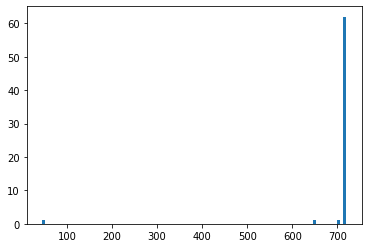

In [580]:
plt.hist([nnidx for nnidx, qidx_q_dist in found_idxs], bins=100)

In [568]:
[found_qkdist for found_idx, found_qkdist in found_idxs if found_idx<50]


[((0, 0, 3), ((0, 0, 3), (0, 0, 3)), 2.0889037433155126e-05),
 ((0, 1, 0), ((0, 1, 0), (0, 1, 0)), 2.0889037433155133e-05),
 ((0, 1, 3), ((0, 1, 3), (0, 1, 3)), 2.08890374331551e-05),
 ((0, 2, 1), ((0, 2, 1), (0, 2, 1)), 2.088903743315511e-05),
 ((0, 3, 0), ((0, 3, 0), (0, 3, 0)), 2.0889037433155177e-05),
 ((0, 3, 1), ((0, 3, 1), (0, 3, 1)), 2.0889037433155147e-05),
 ((1, 1, 3), ((1, 1, 3), (1, 1, 3)), 2.0889037433155133e-05),
 ((1, 2, 2), ((1, 2, 2), (1, 2, 2)), 2.0889037433155215e-05),
 ((2, 0, 0), ((2, 0, 0), (2, 0, 0)), 2.0889037433155282e-05),
 ((2, 2, 1), ((2, 2, 1), (2, 2, 1)), 2.088903743315529e-05),
 ((2, 2, 2), ((2, 2, 2), (2, 2, 2)), 2.0889037433155157e-05),
 ((2, 3, 2), ((2, 3, 2), (2, 3, 2)), 2.0889037433155215e-05),
 ((3, 0, 0), ((3, 0, 0), (3, 0, 0)), 2.088903743315524e-05),
 ((3, 2, 1), ((3, 2, 1), (3, 2, 1)), 2.088903743315513e-05)]

In [569]:
[found_qkdist for found_idx, found_qkdist in found_idxs if found_idx>700]


[((0, 0, 0), ((0, 0, 0), (0, 0, 0)), 2.088903743315495e-05),
 ((0, 0, 1), ((0, 0, 1), (0, 0, 1)), 2.0889037433154913e-05),
 ((0, 0, 2), ((0, 0, 2), (0, 0, 2)), 2.0889037433155004e-05),
 ((0, 2, 2), ((0, 2, 2), (0, 2, 2)), 2.0889037433154984e-05),
 ((1, 0, 0), ((1, 0, 0), (1, 0, 0)), 2.0889037433154855e-05),
 ((1, 1, 2), ((1, 1, 2), (1, 1, 2)), 2.0889037433155028e-05),
 ((1, 2, 1), ((1, 2, 1), (1, 2, 1)), 2.0889037433154988e-05),
 ((2, 1, 0), ((2, 1, 0), (2, 1, 0)), 2.088903743315493e-05),
 ((2, 1, 1), ((2, 1, 1), (2, 1, 1)), 2.0889037433154906e-05),
 ((2, 1, 3), ((2, 1, 3), (2, 1, 3)), 2.088903743315483e-05),
 ((2, 2, 0), ((2, 2, 0), (2, 2, 0)), 2.088903743315497e-05),
 ((2, 3, 1), ((2, 3, 1), (2, 3, 1)), 2.0889037433154967e-05),
 ((2, 3, 3), ((2, 3, 3), (2, 3, 3)), 2.0889037433154876e-05),
 ((3, 1, 3), ((3, 1, 3), (3, 1, 3)), 2.0889037433154855e-05),
 ((3, 3, 3), ((3, 3, 3), (3, 3, 3)), 2.088903743315491e-05),
 ((3, 3, 3), ((3, 3, 3), (3, 3, 3)), 2.088903743315491e-05)]

In [581]:
wrongs = (predictions != count_table).astype(int)

_, keep_querykeys33 = construct_filter(count_table, hparams, num_attr_shared_in_query=3, num_attr_hit_by_key=3)
_, keep_querykeys32 = construct_filter(count_table, hparams, num_attr_shared_in_query=3, num_attr_hit_by_key=2)
_, keep_querykeys31 = construct_filter(count_table, hparams, num_attr_shared_in_query=3, num_attr_hit_by_key=1)
_, keep_querykeys30 = construct_filter(count_table, hparams, num_attr_shared_in_query=3, num_attr_hit_by_key=0)

_, keep_querykeys22 = construct_filter(count_table, hparams, num_attr_shared_in_query=2, num_attr_hit_by_key=2)
_, keep_querykeys21 = construct_filter(count_table, hparams, num_attr_shared_in_query=2, num_attr_hit_by_key=1)
_, keep_querykeys20 = construct_filter(count_table, hparams, num_attr_shared_in_query=2, num_attr_hit_by_key=0)

_, keep_querykeys11 = construct_filter(count_table, hparams, num_attr_shared_in_query=1, num_attr_hit_by_key=1)
_, keep_querykeys10 = construct_filter(count_table, hparams, num_attr_shared_in_query=1, num_attr_hit_by_key=0)

_, keep_querykeys00 = construct_filter(count_table, hparams, num_attr_shared_in_query=0, num_attr_hit_by_key=0)

filters = {
"3-3":keep_querykeys33,
"3-2":keep_querykeys32,
"3-1":keep_querykeys31,
"3-0":keep_querykeys30,
"2-2":keep_querykeys22,
"2-1":keep_querykeys21,
"2-0":keep_querykeys20,
"1-1":keep_querykeys11,
"1-0":keep_querykeys10,
"0-0":keep_querykeys00,
}

for fil in filters:
    print(fil)
    print('error count',np.sum(filters[fil] * wrongs), '/', np.sum(filters[fil]))

3-3
error count 0.0 / 64.0
3-2
error count 0.0 / 576.0
3-1
error count 0.0 / 1728.0
3-0
error count 1124.0 / 1792.0
2-2
error count 0.0 / 2304.0
2-1
error count 0.0 / 13824.0
2-0
error count 7332.0 / 21312.0
1-1
error count 0.0 / 27648.0
1-0
error count 0.0 / 84672.0
0-0
error count 0.0 / 110592.0


In [551]:
w_k, w_q = np.nonzero(wrongs)

total_match_count = 0

for q, k in zip(w_q, w_k):   
    w_q_prop = decode_query_idx_to_key_properties(game_data['num_attributes'], game_data['num_attr_vals'], q)
    w_q_prop = [tuple(w_q_prop[0]), tuple(w_q_prop[1])]
    w_k_prop = decode_key_idx(game_data['num_attributes'], game_data['num_attr_vals'], k)
    if tuple(set(w_q_prop)) == (tuple(w_k_prop),):
        total_match_count += 1
    print(f'{w_q_prop}\t{w_k_prop}')

In [552]:
total_match_count

0

In [553]:
# distance of a query from other queries
for i in range(game_data['query_support_size']):
    q_prop = decode_query_idx_to_key_properties(game_data['num_attributes'], game_data['num_attr_vals'], i)
    print('query:' , q_prop)
    print(('NNs:\n'))
    nns, distances = find_nn(v=query_repr.T[i], Wv=query_repr.T, similarity_fn=find_dotproduct, k=20)
    for nni, dist in zip(nns, distances):
        q_prop2 = decode_query_idx_to_key_properties(game_data['num_attributes'], game_data['num_attr_vals'], nni)
        print(q_prop2, dist)
    print('---------------------------')

query: [array([0, 0, 0]), array([0, 0, 0])]
NNs:

hit
[array([0, 0, 0]), array([0, 0, 0])] 0.493387435775715
[array([1, 3, 0]), array([1, 3, 0])] 0.03632372386443318
[array([1, 0, 2]), array([1, 0, 2])] 0.03632372386443287
[array([1, 0, 3]), array([1, 0, 3])] 0.03632372386443176
[array([1, 0, 1]), array([1, 0, 1])] 0.03632372386443167
[array([1, 2, 0]), array([1, 2, 0])] 0.0363237238644312
[array([1, 1, 0]), array([1, 1, 0])] 0.03632372386443
[array([0, 2, 3]), array([0, 2, 3])] 0.03632372386442029
[array([0, 1, 2]), array([0, 1, 2])] 0.036323723864417845
[array([0, 1, 1]), array([0, 1, 1])] 0.036323723864417796
[array([0, 3, 2]), array([0, 3, 2])] 0.03632372386441725
[array([0, 3, 1]), array([0, 3, 1])] 0.03632372386441682
[array([0, 1, 3]), array([0, 1, 3])] 0.036323723864416735
[array([0, 3, 3]), array([0, 3, 3])] 0.03632372386441632
[array([0, 2, 2]), array([0, 2, 2])] 0.036323723864416305
[array([0, 2, 1]), array([0, 2, 1])] 0.036323723864415625
[array([3, 0, 3]), array([3, 0, 3])

[array([0, 0, 0]), array([2, 2, 2])] 0.000578703703703724
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037105
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037017
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037004
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037036963
[array([0, 0, 0]), array([3, 2, 1])] 0.0005787037037036962
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037036951
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037036939
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036932
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036922
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036915
[array([0, 0, 0]), array([1, 3, 1])] 0.000578703703703691
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036906
[array([1, 2, 0]), array([0, 1, 3])] 0.0005787037037036895
[array([1, 2, 0]), array([2, 0, 1])] 0.0005787037037036895
[array([1, 2, 0]), array([2, 3, 2])] 0.0005787037037036895
[array([1, 2, 0]), array([2, 3, 1])] 0.0005787037037036895

[array([2, 0, 2]), array([3, 0, 1])] 0.003954251334936104
[array([1, 0, 1]), array([3, 0, 3])] 0.003954251334936104
[array([0, 0, 1]), array([1, 0, 2])] 0.003954251334936104
[array([0, 0, 1]), array([1, 0, 0])] 0.003954251334936104
[array([1, 0, 2]), array([2, 0, 0])] 0.003954251334936104
[array([1, 0, 2]), array([2, 0, 1])] 0.003954251334936104
[array([1, 0, 2]), array([2, 0, 3])] 0.003954251334936104
[array([1, 0, 2]), array([0, 0, 0])] 0.003954251334936104
[array([1, 0, 1]), array([3, 0, 2])] 0.003954251334936104
---------------------------
query: [array([0, 0, 0]), array([2, 0, 3])]
NNs:

hit
[array([0, 0, 0]), array([1, 0, 1])] 0.003954251334936106
[array([0, 0, 0]), array([3, 0, 2])] 0.003954251334936104
[array([0, 0, 0]), array([3, 0, 3])] 0.003954251334936104
[array([0, 0, 2]), array([2, 0, 3])] 0.003954251334936103
[array([3, 0, 0]), array([1, 0, 2])] 0.003954251334936103
[array([3, 0, 0]), array([2, 0, 3])] 0.003954251334936103
[array([3, 0, 0]), array([2, 0, 2])] 0.003954251

[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037075
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037037067
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037037056
[array([0, 0, 0]), array([1, 2, 3])] 0.000578703703703705
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037037045
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037037041
[array([2, 2, 3]), array([3, 1, 1])] 0.000578703703703703
[array([1, 1, 1]), array([0, 0, 2])] 0.000578703703703703
[array([1, 1, 1]), array([0, 2, 0])] 0.000578703703703703
[array([1, 1, 1]), array([0, 2, 2])] 0.000578703703703703
[array([1, 1, 1]), array([0, 3, 0])] 0.000578703703703703
[array([1, 1, 1]), array([0, 2, 3])] 0.000578703703703703
[array([1, 1, 1]), array([0, 0, 3])] 0.000578703703703703
---------------------------
query: [array([0, 0, 0]), array([3, 2, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037205
[array([0, 0, 0]), array([3, 2, 3])] 0.000578703703703707
[array([0, 0, 0]), array([1, 3, 3])] 0.000

[array([1, 2, 0]), array([1, 2, 3])] 0.0037996454057626274
---------------------------
query: [array([0, 0, 1]), array([0, 1, 0])]
NNs:

hit
[array([0, 0, 0]), array([0, 1, 1])] 0.003954251334936135
[array([0, 0, 0]), array([0, 1, 3])] 0.003954251334936111
[array([0, 0, 0]), array([0, 3, 2])] 0.00395425133493611
[array([0, 0, 0]), array([0, 2, 1])] 0.003954251334936107
[array([0, 0, 0]), array([0, 2, 2])] 0.003954251334936107
[array([0, 0, 0]), array([0, 3, 3])] 0.003954251334936106
[array([0, 0, 0]), array([0, 3, 1])] 0.003954251334936105
[array([0, 0, 0]), array([0, 2, 3])] 0.003954251334936105
[array([0, 2, 0]), array([0, 3, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 3])] 0.003954251334936103
[array([0, 3, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 3])] 0.003954251

[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 0, 1]), array([1, 2, 1])]
NNs:

hit
[array([1, 2, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 2, 1]), array([3, 0, 1])] 0.003954251334936103
[array([2, 1, 1]), array([3, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([2, 0, 1])] 0.003954251334936103
[array([0, 1, 1]), array([2, 0, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 2, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 1, 1])] 0.0039

[array([0, 0, 0]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 0]), array([3, 0, 3])] 0.003954251334936106
[array([3, 0, 2]), array([1, 0, 3])] 0.0039542513349361055
[array([1, 0, 2]), array([3, 0, 0])] 0.0039542513349361055
[array([0, 0, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 3])] 0.0039542513349361055
[array([3, 0, 2]), array([1, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([1, 0, 1])] 0.0039542513349361055
[array([0, 0, 3]), array([1, 0, 0])] 0.0039542513349361055
[array([1, 0, 2]), array([3, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 3])] 0.0039542513349361055

[array([3, 0, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 2, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 0, 1])] 0.003954251334936103
[array([2, 1, 1]), array([3, 2, 1])] 0.003954251334936103
---------------------------
query: [array([0, 0, 1]), array([3, 2, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005

[array([0, 2, 0]), array([0, 1, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 3])] 0.003954251334936103
[array([0, 3, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 2])] 0.003954251334936103
[array([0, 1, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 1]), array([0, 0, 0])] 0.003954251334936103
---------------------------
query: [array([0, 0, 2]), array([0, 1, 2])]
NNs:

hit
[array([0, 3, 2]), array([0, 0, 2])] 0.0444275309089943
[array([0, 3, 2]), array([0, 1, 2])] 0.0444275309089943
[array([0, 0, 2]), array([0, 2, 2])] 0.0444275309089943
[array([0, 0, 2]), array([0, 1, 2])] 0.0444275309089943
[array([0, 2, 2]), array([0, 3, 2])] 0.0444275309089943


[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 0, 2]), array([2, 2, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1]

[array([0, 0, 2]), array([2, 1, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 1, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 1, 2]), array([1, 0, 2])] 0.003954251334936106
[array([0, 2, 2]), array([1, 3, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 0, 2])] 0.003954251334936106
[array([1, 2, 2]), array([2, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 3, 2])] 0.003954251334936106
[array([0, 1, 2]), array([3, 2, 2])] 0.003954251334936106
---------------------------
query: [array([0, 0, 2]), array([3, 3, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005

[array([0, 2, 0]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 2])] 0.003954251334936103
[array([0, 1, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 1]), array([0, 0, 0])] 0.003954251334936103
---------------------------
query: [array([0, 0, 3]), array([0, 2, 2])]
NNs:

hit
[array([0, 0, 0]), array([0, 1, 1])] 0.003954251334936135
[array([0, 0, 0]), array([0, 1, 3])] 0.003954251334936111
[array([0, 0, 0]), array([0, 3, 2])] 0.00395425133493611
[array([0, 0, 0]), array([0, 2, 1])] 0.003954251334936107
[array([0, 0, 0]), array([0, 2, 2])] 0.003954251334936107
[array([0, 0, 0]), array([0, 3, 3])] 0.003954251334936106
[array([0, 0, 0]), array([0, 3, 1])] 0.003954251334936105
[array([0, 0, 0]), array([0, 2, 3])] 0.003954251334936105
[array([0, 2, 0]), array([0, 3, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 2])] 0.0039542513

[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 0, 3]), array([1, 3, 3])]
NNs:

hit
[array([1, 1, 3]), array([3, 0, 3]

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([1, 3, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 2, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 2, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 2, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 1, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 2, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 3, 3])] 0.003954251334936103
[array([2, 0, 3]), array([1, 1, 3])] 0.003954251334936103
---------------------------
query: [array([0, 1, 0]), array([0, 0, 0])]
NNs:

hit
[array([0, 3, 0]), array([0, 1, 0])] 0.0444275309089944
[array([0, 2, 0]), array([0, 1, 0])] 0.0444275309089944
[array([0, 3, 0]), array([0, 2, 0])] 0.0444275309089944
[array([0, 1, 0]), array([0, 0, 0])] 0.0444275309089944
[array([0, 3, 0]), array([0, 0, 0])] 0.0444275309089944
[array([0, 2, 0]), array([0, 3, 0])] 0.0444275309089944
[a

[array([0, 0, 0]), array([0, 1, 1])] 0.003954251334936135
[array([0, 0, 0]), array([0, 1, 3])] 0.003954251334936111
[array([0, 0, 0]), array([0, 3, 2])] 0.00395425133493611
[array([0, 0, 0]), array([0, 2, 1])] 0.003954251334936107
[array([0, 0, 0]), array([0, 2, 2])] 0.003954251334936107
[array([0, 0, 0]), array([0, 3, 3])] 0.003954251334936106
[array([0, 0, 0]), array([0, 3, 1])] 0.003954251334936105
[array([0, 0, 0]), array([0, 2, 3])] 0.003954251334936105
[array([0, 2, 0]), array([0, 3, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 3])] 0.003954251334936103
[array([0, 3, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 1])] 0.003954251334936103
[array([0, 2, 0

[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 1, 0]), array([2, 0, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3

[array([0, 0, 0]), array([1, 3, 0])] 0.003954251334936137
[array([0, 0, 0]), array([1, 2, 0])] 0.003954251334936123
[array([0, 0, 0]), array([2, 3, 0])] 0.003954251334936111
[array([0, 0, 0]), array([3, 3, 0])] 0.00395425133493611
[array([1, 0, 0]), array([2, 1, 0])] 0.003954251334936109
[array([3, 2, 0]), array([2, 1, 0])] 0.003954251334936109
[array([2, 2, 0]), array([0, 1, 0])] 0.003954251334936109
[array([2, 0, 0]), array([1, 1, 0])] 0.003954251334936109
[array([0, 3, 0]), array([2, 0, 0])] 0.003954251334936109
[array([2, 0, 0]), array([3, 3, 0])] 0.003954251334936109
[array([3, 2, 0]), array([2, 3, 0])] 0.003954251334936109
[array([0, 3, 0]), array([2, 1, 0])] 0.003954251334936109
[array([1, 2, 0]), array([0, 0, 0])] 0.003954251334936109
[array([0, 2, 0]), array([1, 0, 0])] 0.003954251334936109
[array([3, 3, 0]), array([1, 2, 0])] 0.003954251334936109
[array([1, 3, 0]), array([2, 2, 0])] 0.003954251334936109
[array([0, 3, 0]), array([2, 2, 0])] 0.003954251334936109
[array([1, 0, 0

[array([0, 2, 0]), array([0, 1, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 3])] 0.003954251334936103
[array([0, 3, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 2])] 0.003954251334936103
[array([0, 1, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 1]), array([0, 0, 0])] 0.003954251334936103
---------------------------
query: [array([0, 1, 1]), array([0, 2, 1])]
NNs:

hit
[array([0, 3, 1]), array([0, 1, 1])] 0.04442753090899432
[array([0, 2, 1]), array([0, 3, 1])] 0.04442753090899432
[array([0, 2, 1]), array([0, 0, 1])] 0.04442753090899432
[array([0, 2, 1]), array([0, 1, 1])] 0.04442753090899432
[array([0, 0, 1]), array([0, 2, 1])] 0.04442753090899432
[array([0, 3, 1]), array([0, 0, 1])] 0.04442753090899

[array([3, 1, 3]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 0]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 0])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 2]), array([0, 1, 3])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([3, 1, 2]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 3])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 2])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([2, 1, 0])] 0.003954251334936104
[array([3, 1, 2]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([2, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([2, 1, 2])] 0.003954251334936104
[array([3, 1, 

query: [array([0, 1, 1]), array([2, 2, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[ar

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([0, 2, 0]), array([0, 1, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 3])] 0.003954251334936103
[array([0, 3, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 2])] 0.003954251334936103
[array([0, 1, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 1]), array([0, 0, 0])] 0.003954251334936103
---------------------------
query: [array([0, 1, 2]), array([0, 2, 1])]
NNs:

hit
[array([0, 0, 0]), array([0, 1, 1])] 0.003954251334936135
[array([0, 0, 0]), array([0, 1, 3])] 0.003954251334936111
[array([0, 0, 0]), array([0, 3, 2])] 0.00395425133493611
[array([0, 0, 0]), array([0, 2, 1])] 0.003954251334936107
[array([0, 0, 0]), array([0, 2, 2])] 0.0039542513

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 1, 2]), array([2, 2, 2])]
NNs:

hit
[array([1, 1, 2]), array([3, 0, 2]

query: [array([0, 1, 2]), array([3, 0, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[ar

[array([0, 0, 0]), array([0, 3, 3])] 0.003954251334936106
[array([0, 0, 0]), array([0, 3, 1])] 0.003954251334936105
[array([0, 0, 0]), array([0, 2, 3])] 0.003954251334936105
[array([0, 2, 0]), array([0, 3, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 3])] 0.003954251334936103
[array([0, 3, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 2])] 0.003954251334936103
[array([0, 1, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 1]), array([0, 0, 0])] 0.003954251334936103
---------------------------
query: [array([0, 1, 3]), array([0, 2, 2])]
NNs:

hit
[array([0, 0, 0]), array([0, 1, 1])] 0.003954251

[array([2, 1, 3]), array([3, 1, 1])] 0.003954251334936104
[array([0, 1, 2]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 2]), array([1, 1, 0])] 0.003954251334936104
[array([2, 1, 3]), array([1, 1, 2])] 0.003954251334936104
[array([2, 1, 3]), array([1, 1, 1])] 0.003954251334936104
[array([2, 1, 3]), array([1, 1, 0])] 0.003954251334936104
[array([2, 1, 3]), array([0, 1, 2])] 0.003954251334936104
[array([2, 1, 3]), array([0, 1, 1])] 0.003954251334936104
[array([2, 1, 3]), array([0, 1, 0])] 0.003954251334936104
[array([2, 1, 2]), array([3, 1, 3])] 0.003954251334936104
[array([0, 1, 3]), array([3, 1, 0])] 0.003954251334936104
[array([0, 1, 3]), array([3, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([3, 1, 2])] 0.003954251334936104
[array([2, 1, 2]), array([3, 1, 1])] 0.003954251334936104
---------------------------
query: [array([0, 1, 3]), array([1, 1, 2])]
NNs:

hit
[array([3, 1, 3]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 2])] 0.003954251

[array([1, 2, 3]), array([3, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 2, 3])] 0.003954251334936103
[array([3, 1, 3]), array([1, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 2, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 2, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 2, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 1, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 2, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 3, 3])] 0.003954251334936103
[array([2, 0, 3]), array([1, 1, 3])] 0.003954251334936103
---------------------------
query: [array([0, 1, 3]), array([2, 3, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.000578703

[array([3, 1, 3]), array([3, 1, 3])] 0.03377706077873351
[array([1, 1, 3]), array([1, 1, 3])] 0.03377706077873349
[array([2, 1, 3]), array([2, 1, 3])] 0.03377706077873346
[array([0, 1, 3]), array([0, 1, 3])] 0.03377706077873337
[array([0, 0, 0]), array([1, 0, 0])] 0.0037996454057628087
[array([0, 0, 0]), array([2, 0, 0])] 0.0037996454057626977
[array([0, 0, 0]), array([3, 0, 0])] 0.0037996454057626907
[array([2, 0, 0]), array([0, 0, 0])] 0.0037996454057626266
---------------------------
query: [array([0, 1, 3]), array([3, 2, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.000

[array([0, 0, 0]), array([0, 3, 1])] 0.003954251334936105
[array([0, 0, 0]), array([0, 2, 3])] 0.003954251334936105
[array([0, 2, 0]), array([0, 3, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 3])] 0.003954251334936103
[array([0, 3, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 2])] 0.003954251334936103
[array([0, 1, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 1]), array([0, 0, 0])] 0.003954251334936103
---------------------------
query: [array([0, 2, 0]), array([0, 3, 3])]
NNs:

hit
[array([0, 0, 0]), array([0, 1, 1])] 0.003954251334936135
[array([0, 0, 0]), array([0, 1, 3])] 0.003954251

[array([0, 2, 2]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 1])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 3])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 1])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 3])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 1])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 3])] 0.003954251334936102
[array([1, 2, 1]), array([0, 2, 0])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 1])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 0])] 0.003954251334936102
[array([1, 2, 1]), array([0, 2, 2])] 0.003954251334936102
---------------------------
query: [array([0, 2, 0]), array([1, 2, 3])]
NNs:

hit
[array([0, 2, 3]), array([3, 2, 2])] 0.003954251334936102
[array([3, 2, 0]), array([1, 2, 2])] 0.003954251

[array([1, 3, 0]), array([3, 0, 0])] 0.003954251334936109
---------------------------
query: [array([0, 2, 0]), array([3, 0, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])

[array([1, 2, 1]), array([0, 2, 0])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 1])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 0])] 0.003954251334936102
[array([1, 2, 1]), array([0, 2, 2])] 0.003954251334936102
---------------------------
query: [array([0, 2, 0]), array([3, 3, 0])]
NNs:

hit
[array([0, 0, 0]), array([1, 3, 0])] 0.003954251334936137
[array([0, 0, 0]), array([1, 2, 0])] 0.003954251334936123
[array([0, 0, 0]), array([2, 3, 0])] 0.003954251334936111
[array([0, 0, 0]), array([3, 3, 0])] 0.00395425133493611
[array([1, 0, 0]), array([2, 1, 0])] 0.003954251334936109
[array([3, 2, 0]), array([2, 1, 0])] 0.003954251334936109
[array([2, 2, 0]), array([0, 1, 0])] 0.003954251334936109
[array([2, 0, 0]), array([1, 1, 0])] 0.003954251334936109
[array([0, 3, 0]), array([2, 0, 0])] 0.003954251334936109
[array([2, 0, 0]), array([3, 3, 0])] 0.003954251334936109
[array([3, 2, 0]), array([2, 3, 0])] 0.003954251334936109
[array([0, 3, 0]), array([2, 1, 0])] 0.0039542513

[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 2, 1]), array([1, 0, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3

[array([3, 0, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 2, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 2, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 0, 1])] 0.003954251334936103
[array([2, 1, 1]), array([3, 2, 1])] 0.003954251334936103
---------------------------
query: [array([0, 2, 1]), array([1, 3, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.000578703

[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 2, 1]), array([3, 0, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1]

[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 2, 1]), array([3, 3, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1

query: [array([0, 2, 2]), array([1, 1, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[ar

[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 2, 2]), array([2, 0, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3]

[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 2, 2]), array([3, 1, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1]

[array([0, 0, 0]), array([0, 3, 3])] 0.003954251334936106
[array([0, 0, 0]), array([0, 3, 1])] 0.003954251334936105
[array([0, 0, 0]), array([0, 2, 3])] 0.003954251334936105
[array([0, 2, 0]), array([0, 3, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 3])] 0.003954251334936103
[array([0, 3, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 2])] 0.003954251334936103
[array([0, 1, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 1]), array([0, 0, 0])] 0.003954251334936103
---------------------------
query: [array([0, 2, 3]), array([0, 0, 1])]
NNs:

hit
[array([0, 0, 0]), array([0, 1, 1])] 0.003954251

[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 2, 3]), array([1, 1, 3])]
NNs:

hit
[array([1, 1, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 1, 3])] 0.003954251334936103
[array([3, 1, 3]), array([2, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 0, 3])] 0.

[array([1, 1, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 1, 3])] 0.003954251334936103
[array([3, 1, 3]), array([2, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 2, 3])] 0.003954251334936103
[array([3, 1, 3]), array([1, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 2, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 2, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 2, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 1, 3])] 0.003954251334936103
[array([2, 0, 

[array([0, 2, 3]), array([3, 2, 2])] 0.003954251334936102
[array([3, 2, 0]), array([1, 2, 2])] 0.003954251334936102
[array([0, 2, 3]), array([2, 2, 0])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 2])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 1])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 1])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 3])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 1])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 3])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 1])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 3])] 0.003954251334936102
[array([1, 2, 1]), array([0, 2, 0])] 0.003954251334936102
[array([1, 2, 

[array([0, 0, 0]), array([0, 1, 1])] 0.003954251334936135
[array([0, 0, 0]), array([0, 1, 3])] 0.003954251334936111
[array([0, 0, 0]), array([0, 3, 2])] 0.00395425133493611
[array([0, 0, 0]), array([0, 2, 1])] 0.003954251334936107
[array([0, 0, 0]), array([0, 2, 2])] 0.003954251334936107
[array([0, 0, 0]), array([0, 3, 3])] 0.003954251334936106
[array([0, 0, 0]), array([0, 3, 1])] 0.003954251334936105
[array([0, 0, 0]), array([0, 2, 3])] 0.003954251334936105
[array([0, 2, 0]), array([0, 3, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 3])] 0.003954251334936103
[array([0, 3, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 1])] 0.003954251334936103
[array([0, 2, 0

query: [array([0, 3, 0]), array([1, 2, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[ar

[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 3, 0]), array([2, 1, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2]

[array([1, 3, 2]), array([0, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([2, 3, 3])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 3])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 3])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 2])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 

[array([0, 0, 0]), array([0, 3, 1])] 0.003954251334936105
[array([0, 0, 0]), array([0, 2, 3])] 0.003954251334936105
[array([0, 2, 0]), array([0, 3, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 3])] 0.003954251334936103
[array([0, 3, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 2])] 0.003954251334936103
[array([0, 1, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 1]), array([0, 0, 0])] 0.003954251334936103
---------------------------
query: [array([0, 3, 1]), array([0, 2, 3])]
NNs:

hit
[array([0, 0, 0]), array([0, 1, 1])] 0.003954251334936135
[array([0, 0, 0]), array([0, 1, 3])] 0.003954251

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([2, 3, 1]), array([0, 3, 1])] 0.04442753090899437
[array([3, 3, 1]), array([2, 3, 1])] 0.04442753090899437
[array([0, 3, 1]), array([1, 3, 1])] 0.04442753090899437
[array([2, 3, 1]), array([1, 3, 1])] 0.04442753090899437
[array([0, 3, 1]), array([2, 3, 1])] 0.04442753090899437
[array([3, 3, 1]), array([1, 3, 1])] 0.04442753090899437
[array([0, 3, 1]), array([3, 3, 1])] 0.04442753090899437
[array([2, 3, 1]), array([3, 3, 1])] 0.04442753090899437
[array([3, 3, 1]), array([0, 3, 1])] 0.04442753090899437
[array([1, 3, 1]), array([2, 3, 1])] 0.04442753090899437
[array([1, 3, 1]), array([0, 3, 1])] 0.04442753090899437
[array([1, 3, 1]), array([3, 3, 1])] 0.04442753090899437
[array([1, 3, 1]), array([1, 3, 1])] 0.033777060778733506
[array([3, 3, 1]), array([3, 3, 1])] 0.033777060778733485
[array([0, 3, 1]), array([0, 3, 1])] 0.033777060778733436
[array([2, 3, 1]), array([2, 3, 1])] 0.03377706077873341
[array([0, 0, 0]), array([3, 0, 0])] 0.003799645405762663
[array([2, 0, 0]), array([0

[array([0, 2, 0]), array([0, 3, 3])] 0.003954251334936103
[array([0, 3, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 2])] 0.003954251334936103
[array([0, 1, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 1]), array([0, 0, 0])] 0.003954251334936103
---------------------------
query: [array([0, 3, 2]), array([0, 1, 0])]
NNs:

hit
[array([0, 0, 0]), array([0, 1, 1])] 0.003954251334936135
[array([0, 0, 0]), array([0, 1, 3])] 0.003954251334936111
[array([0, 0, 0]), array([0, 3, 2])] 0.00395425133493611
[array([0, 0, 0]), array([0, 2, 1])] 0.003954251334936107
[array([0, 0, 0]), array([0, 2, 2])] 0.003954251334936107
[array([0, 0, 0]), array([0, 3, 3])] 0.003954251334936106
[array([0, 0, 0]), array([0, 3, 1])] 0.0039542513

[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 3, 2]), array([1, 0, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1]

[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 3, 2]), array([2, 1, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0]

[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 3, 2]), array([3, 0, 2])]
NNs:

hit
[array([1, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 2, 2])] 0.003954251334936106
[array([0, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 3, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 0, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 2, 2])] 0.

[array([0, 2, 0]), array([0, 1, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 3])] 0.003954251334936103
[array([0, 3, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 1, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 3])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 0]), array([0, 0, 1])] 0.003954251334936103
[array([0, 2, 0]), array([0, 3, 2])] 0.003954251334936103
[array([0, 1, 3]), array([0, 0, 2])] 0.003954251334936103
[array([0, 2, 1]), array([0, 0, 0])] 0.003954251334936103
---------------------------
query: [array([0, 3, 3]), array([0, 1, 2])]
NNs:

hit
[array([0, 0, 0]), array([0, 1, 1])] 0.003954251334936135
[array([0, 0, 0]), array([0, 1, 3])] 0.003954251334936111
[array([0, 0, 0]), array([0, 3, 2])] 0.00395425133493611
[array([0, 0, 0]), array([0, 2, 1])] 0.003954251334936107
[array([0, 0, 0]), array([0, 2, 2])] 0.003954251334936107
[array([0, 0, 0]), array([0, 3, 3])] 0.0039542513

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([0, 3, 3]), array([3, 0, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2]

[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 0, 0]), array([0, 1, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1]

[array([1, 0, 3]), array([1, 0, 1])] 0.04442753090899443
[array([1, 0, 3]), array([1, 0, 3])] 0.03377706077873367
[array([1, 0, 1]), array([1, 0, 1])] 0.03377706077873357
[array([1, 0, 2]), array([1, 0, 2])] 0.033777060778733554
[array([1, 0, 0]), array([1, 0, 0])] 0.033777060778733166
[array([2, 1, 2]), array([2, 1, 3])] 0.0037996454057626482
[array([2, 1, 0]), array([2, 1, 3])] 0.0037996454057626482
[array([2, 1, 1]), array([2, 1, 3])] 0.0037996454057626482
[array([2, 1, 2]), array([2, 1, 1])] 0.0037996454057626482
---------------------------
query: [array([1, 0, 0]), array([1, 0, 2])]
NNs:

hit
[array([1, 0, 3]), array([1, 0, 2])] 0.04442753090899443
[array([1, 0, 0]), array([1, 0, 1])] 0.04442753090899443
[array([1, 0, 0]), array([1, 0, 2])] 0.04442753090899443
[array([1, 0, 0]), array([1, 0, 3])] 0.04442753090899443
[array([1, 0, 1]), array([1, 0, 0])] 0.04442753090899443
[array([1, 0, 1]), array([1, 0, 2])] 0.04442753090899443
[array([1, 0, 1]), array([1, 0, 3])] 0.04442753090899

[array([1, 2, 0]), array([0, 0, 0])] 0.003954251334936109
[array([0, 2, 0]), array([1, 0, 0])] 0.003954251334936109
[array([3, 3, 0]), array([1, 2, 0])] 0.003954251334936109
[array([1, 3, 0]), array([2, 2, 0])] 0.003954251334936109
[array([0, 3, 0]), array([2, 2, 0])] 0.003954251334936109
[array([1, 0, 0]), array([3, 3, 0])] 0.003954251334936109
[array([3, 1, 0]), array([0, 0, 0])] 0.003954251334936109
[array([1, 3, 0]), array([3, 0, 0])] 0.003954251334936109
---------------------------
query: [array([1, 0, 0]), array([2, 2, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.000

[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 0, 0]), array([3, 1, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2]

[array([1, 2, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 2, 1]), array([3, 0, 1])] 0.003954251334936103
[array([2, 1, 1]), array([3, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([2, 0, 1])] 0.003954251334936103
[array([0, 1, 1]), array([2, 0, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 2, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 

[array([1, 0, 2]), array([1, 3, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 1])] 0.003954251334936111
[array([1, 1, 3]), array([1, 0, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 3])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 2])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 3])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 0])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 1])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 3])] 0.003954251334936111
[array([1, 0, 3]), array([1, 2, 0])] 0.003954251334936111
---------------------------
query: [array([1, 0, 1]), array([1, 2, 1])]
NNs:

hit
[array([1, 1, 1]), array([1, 3, 1])] 0.044427530908994414
[array([1, 3, 1]), array([1, 2, 1])] 0.044427530908994414
[array([1, 2, 1]), array([1, 3, 1])] 0.044427530

[array([1, 2, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 2, 1]), array([3, 0, 1])] 0.003954251334936103
[array([2, 1, 1]), array([3, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([2, 0, 1])] 0.003954251334936103
[array([0, 1, 1]), array([2, 0, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 2, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 

[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 0, 1]), array([3, 2, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2]

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([1, 0, 2]), array([1, 2, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 1])] 0.003954251334936111
[array([1, 1, 3]), array([1, 0, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 3])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 2])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 3])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 0])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 1])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 3])] 0.003954251334936111
[array([1, 0, 3]), array([1, 2, 0])] 0.003954251334936111
---------------------------
query: [array([1, 0, 2]), array([1, 2, 0])]


[array([1, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 2, 2])] 0.003954251334936106
[array([0, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 3, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 0, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 2, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 2, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 2, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 1, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 1, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 1, 2]), array([1, 0, 2])] 0.003954251334936106
[array([0, 2, 2]), array([1, 3, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 0, 2])] 0.003954251334936106
[array([1, 2, 

[array([1, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 2, 2])] 0.003954251334936106
[array([0, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 3, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 0, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 2, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 2, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 2, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 1, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 1, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 1, 2]), array([1, 0, 2])] 0.003954251334936106
[array([0, 2, 2]), array([1, 3, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 0, 2])] 0.003954251334936106
[array([1, 2, 

[array([1, 2, 3]), array([3, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 2, 3])] 0.003954251334936103
[array([3, 1, 3]), array([1, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 2, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 2, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 2, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 1, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 2, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 3, 3])] 0.003954251334936103
[array([2, 0, 3]), array([1, 1, 3])] 0.003954251334936103
---------------------------
query: [array([1, 0, 3]), array([1, 0, 0])]
NNs:

hit
[array([1, 0, 3]), array([1, 0, 2])] 0.044427530

[array([1, 0, 2]), array([1, 2, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 1])] 0.003954251334936111
[array([1, 1, 3]), array([1, 0, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 3])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 2])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 3])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 0])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 1])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 3])] 0.003954251334936111
[array([1, 0, 3]), array([1, 2, 0])] 0.003954251334936111
---------------------------
query: [array([1, 0, 3]), array([1, 2, 3])]
NNs:

hit
[array([1, 2, 3]), array([1, 3, 3])] 0.04442753090899447
[array([1, 0, 3]), array([1, 1, 3])] 0.0444275309

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 1, 0]), array([0, 3, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2]

[array([1, 3, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 1])] 0.003954251334936111
[array([1, 1, 3]), array([1, 0, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 3])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 2])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 3])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 0])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 1])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 

[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 1, 0]), array([3, 0, 0])]
NNs:

hit
[array([0, 0, 0]), array([1, 3, 0]

[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 1, 0]), array([3, 3, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3

[array([1, 3, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 1])] 0.003954251334936111
[array([1, 1, 3]), array([1, 0, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 3])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 2])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 3])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 0])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 1])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 

[array([1, 0, 2]), array([1, 2, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 1])] 0.003954251334936111
[array([1, 1, 3]), array([1, 0, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 3])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 2])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 3])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 0])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 1])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 3])] 0.003954251334936111
[array([1, 0, 3]), array([1, 2, 0])] 0.003954251334936111
---------------------------
query: [array([1, 1, 1]), array([1, 3, 3])]
NNs:

hit
[array([1, 3, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 0])] 0.003954251

[array([3, 1, 3]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 0]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 0])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 2]), array([0, 1, 3])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([3, 1, 2]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 3])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 2])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([2, 1, 0])] 0.003954251334936104
[array([3, 1, 2]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([2, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([2, 1, 2])] 0.003954251334936104
[array([3, 1, 

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([1, 0, 2]), array([1, 3, 3])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 2])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 3])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 0])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 1])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 3])] 0.003954251334936111
[array([1, 0, 3]), array([1, 2, 0])] 0.003954251334936111
---------------------------
query: [array([1, 1, 2]), array([1, 3, 1])]
NNs:

hit
[array([1, 3, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 1])] 0.003954251

[array([1, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 2, 2])] 0.003954251334936106
[array([0, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 3, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 0, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 2, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 2, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 2, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 1, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 1, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 1, 2]), array([1, 0, 2])] 0.003954251334936106
[array([0, 2, 2]), array([1, 3, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 0, 2])] 0.003954251334936106
[array([1, 2, 

[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 1, 3]), array([0, 0, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3

[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 1, 3]), array([0, 3, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1

[array([0, 1, 3]), array([2, 1, 0])] 0.003954251334936104
[array([3, 1, 2]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([2, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([2, 1, 2])] 0.003954251334936104
[array([3, 1, 2]), array([1, 1, 0])] 0.003954251334936104
[array([1, 1, 3]), array([2, 1, 0])] 0.003954251334936104
[array([1, 1, 3]), array([2, 1, 1])] 0.003954251334936104
---------------------------
query: [array([1, 1, 3]), array([2, 1, 1])]
NNs:

hit
[array([2, 1, 3]), array([3, 1, 0])] 0.003954251334936104
[array([1, 1, 3]), array([3, 1, 1])] 0.003954251334936104
[array([0, 1, 1]), array([2, 1, 2])] 0.003954251334936104
[array([0, 1, 1]), array([2, 1, 3])] 0.003954251334936104
[array([2, 1, 3]), array([3, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 3]), array([3, 1, 1])] 0.003954251334936104
[array([0, 1, 2]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 2]), array([1, 1, 0])] 0.003954251

[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 1, 3]), array([3, 0, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1]

[array([2, 2, 0]), array([0, 2, 0])] 0.044427530908994387
[array([1, 2, 0]), array([2, 2, 0])] 0.044427530908994387
[array([3, 2, 0]), array([1, 2, 0])] 0.044427530908994387
[array([2, 2, 0]), array([3, 2, 0])] 0.044427530908994387
[array([2, 2, 0]), array([1, 2, 0])] 0.044427530908994387
[array([0, 2, 0]), array([1, 2, 0])] 0.044427530908994387
[array([3, 2, 0]), array([2, 2, 0])] 0.044427530908994387
[array([1, 2, 0]), array([0, 2, 0])] 0.044427530908994387
[array([1, 2, 0]), array([3, 2, 0])] 0.044427530908994387
[array([0, 2, 0]), array([2, 2, 0])] 0.044427530908994387
[array([0, 2, 0]), array([3, 2, 0])] 0.044427530908994387
[array([3, 2, 0]), array([0, 2, 0])] 0.044427530908994387
[array([1, 2, 0]), array([1, 2, 0])] 0.03377706077873363
[array([0, 2, 0]), array([0, 2, 0])] 0.03377706077873359
[array([2, 2, 0]), array([2, 2, 0])] 0.03377706077873339
[array([3, 2, 0]), array([3, 2, 0])] 0.033777060778733256
[array([1, 0, 3]), array([2, 0, 3])] 0.0037996454057626335
[array([3, 0, 3]

[array([1, 2, 0]), array([1, 1, 0])] 0.04442753090899438
[array([1, 0, 0]), array([1, 1, 0])] 0.04442753090899438
[array([1, 0, 0]), array([1, 3, 0])] 0.04442753090899438
[array([1, 2, 0]), array([1, 0, 0])] 0.04442753090899438
[array([1, 1, 0]), array([1, 0, 0])] 0.04442753090899438
[array([1, 0, 0]), array([1, 2, 0])] 0.04442753090899438
[array([1, 1, 0]), array([1, 2, 0])] 0.04442753090899438
[array([1, 3, 0]), array([1, 2, 0])] 0.04442753090899438
[array([1, 1, 0]), array([1, 3, 0])] 0.04442753090899438
[array([1, 3, 0]), array([1, 0, 0])] 0.04442753090899438
[array([1, 3, 0]), array([1, 1, 0])] 0.04442753090899438
[array([1, 2, 0]), array([1, 3, 0])] 0.04442753090899438
[array([1, 1, 0]), array([1, 1, 0])] 0.03377706077873386
[array([1, 2, 0]), array([1, 2, 0])] 0.033777060778733825
[array([1, 3, 0]), array([1, 3, 0])] 0.03377706077873354
[array([1, 0, 0]), array([1, 0, 0])] 0.033777060778732604
[array([3, 1, 3]), array([3, 0, 3])] 0.003799645405762617
[array([3, 2, 3]), array([3,

[array([1, 0, 0]), array([3, 3, 0])] 0.003954251334936109
[array([3, 1, 0]), array([0, 0, 0])] 0.003954251334936109
[array([1, 3, 0]), array([3, 0, 0])] 0.003954251334936109
---------------------------
query: [array([1, 2, 0]), array([2, 3, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 

[array([2, 2, 0]), array([0, 2, 0])] 0.044427530908994387
[array([1, 2, 0]), array([2, 2, 0])] 0.044427530908994387
[array([3, 2, 0]), array([1, 2, 0])] 0.044427530908994387
[array([2, 2, 0]), array([3, 2, 0])] 0.044427530908994387
[array([2, 2, 0]), array([1, 2, 0])] 0.044427530908994387
[array([0, 2, 0]), array([1, 2, 0])] 0.044427530908994387
[array([3, 2, 0]), array([2, 2, 0])] 0.044427530908994387
[array([1, 2, 0]), array([0, 2, 0])] 0.044427530908994387
[array([1, 2, 0]), array([3, 2, 0])] 0.044427530908994387
[array([0, 2, 0]), array([2, 2, 0])] 0.044427530908994387
[array([0, 2, 0]), array([3, 2, 0])] 0.044427530908994387
[array([3, 2, 0]), array([0, 2, 0])] 0.044427530908994387
[array([1, 2, 0]), array([1, 2, 0])] 0.03377706077873363
[array([0, 2, 0]), array([0, 2, 0])] 0.03377706077873359
[array([2, 2, 0]), array([2, 2, 0])] 0.03377706077873339
[array([3, 2, 0]), array([3, 2, 0])] 0.033777060778733256
[array([1, 0, 3]), array([2, 0, 3])] 0.0037996454057626335
[array([3, 0, 3]

[array([3, 0, 1]), array([2, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 2, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 0, 1])] 0.003954251334936103
[array([2, 1, 1]), array([3, 2, 1])] 0.003954251334936103
---------------------------
query: [array([1, 2, 1]), array([0, 3, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.00057

[array([1, 2, 0]), array([1, 2, 1])] 0.044427530908994387
[array([1, 2, 3]), array([1, 2, 1])] 0.044427530908994387
[array([1, 2, 2]), array([1, 2, 3])] 0.044427530908994387
[array([1, 2, 2]), array([1, 2, 1])] 0.044427530908994387
[array([1, 2, 1]), array([1, 2, 3])] 0.044427530908994387
[array([1, 2, 0]), array([1, 2, 3])] 0.044427530908994387
[array([1, 2, 1]), array([1, 2, 0])] 0.04442753090899438
[array([1, 2, 3]), array([1, 2, 2])] 0.04442753090899438
[array([1, 2, 3]), array([1, 2, 0])] 0.04442753090899438
[array([1, 2, 0]), array([1, 2, 2])] 0.04442753090899438
[array([1, 2, 2]), array([1, 2, 0])] 0.04442753090899438
[array([1, 2, 1]), array([1, 2, 2])] 0.04442753090899438
[array([1, 2, 1]), array([1, 2, 1])] 0.03377706077873359
[array([1, 2, 2]), array([1, 2, 2])] 0.03377706077873349
[array([1, 2, 3]), array([1, 2, 3])] 0.03377706077873344
[array([1, 2, 0]), array([1, 2, 0])] 0.03377706077873331
[array([0, 0, 0]), array([0, 0, 3])] 0.003799645405762706
[array([2, 3, 2]), array

[array([3, 0, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 2, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 2, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 0, 1])] 0.003954251334936103
[array([2, 1, 1]), array([3, 2, 1])] 0.003954251334936103
---------------------------
query: [array([1, 2, 1]), array([3, 0, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.000578703

[array([3, 0, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 2, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 2, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 0, 1])] 0.003954251334936103
[array([2, 1, 1]), array([3, 2, 1])] 0.003954251334936103
---------------------------
query: [array([1, 2, 1]), array([3, 3, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.000578703

[array([1, 2, 2]), array([1, 0, 2])] 0.04442753090899437
[array([1, 1, 2]), array([1, 3, 2])] 0.04442753090899437
[array([1, 3, 2]), array([1, 0, 2])] 0.04442753090899437
[array([1, 0, 2]), array([1, 3, 2])] 0.04442753090899437
[array([1, 0, 2]), array([1, 2, 2])] 0.04442753090899437
[array([1, 1, 2]), array([1, 1, 2])] 0.033777060778733575
[array([1, 2, 2]), array([1, 2, 2])] 0.03377706077873351
[array([1, 3, 2]), array([1, 3, 2])] 0.03377706077873345
[array([1, 0, 2]), array([1, 0, 2])] 0.03377706077873331
[array([0, 0, 0]), array([0, 1, 0])] 0.003799645405762907
[array([0, 0, 0]), array([0, 3, 0])] 0.00379964540576279
[array([0, 0, 0]), array([0, 2, 0])] 0.003799645405762714
[array([3, 3, 3]), array([3, 0, 3])] 0.00379964540576262
---------------------------
query: [array([1, 2, 2]), array([1, 0, 3])]
NNs:

hit
[array([1, 3, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 1])] 0.003954251334936111


[array([3, 3, 3]), array([3, 0, 3])] 0.00379964540576262
---------------------------
query: [array([1, 2, 2]), array([1, 3, 3])]
NNs:

hit
[array([1, 3, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 1])] 0.003954251334936111
[array([1, 1, 3]), array([1, 0, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 3])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 2])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 3])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 0])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 1])] 0.0039542513

[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 2, 2]), array([3, 1, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3

[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 2, 3]), array([0, 0, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1

query: [array([1, 2, 3]), array([1, 1, 3])]
NNs:

hit
[array([1, 2, 3]), array([1, 3, 3])] 0.04442753090899447
[array([1, 0, 3]), array([1, 1, 3])] 0.04442753090899447
[array([1, 0, 3]), array([1, 3, 3])] 0.04442753090899447
[array([1, 1, 3]), array([1, 0, 3])] 0.04442753090899447
[array([1, 1, 3]), array([1, 3, 3])] 0.04442753090899447
[array([1, 0, 3]), array([1, 2, 3])] 0.04442753090899447
[array([1, 2, 3]), array([1, 1, 3])] 0.04442753090899447
[array([1, 2, 3]), array([1, 0, 3])] 0.04442753090899447
[array([1, 1, 3]), array([1, 2, 3])] 0.04442753090899447
[array([1, 3, 3]), array([1, 2, 3])] 0.04442753090899447
[array([1, 3, 3]), array([1, 1, 3])] 0.04442753090899447
[array([1, 3, 3]), array([1, 0, 3])] 0.04442753090899447
[array([1, 2, 3]), array([1, 2, 3])] 0.03377706077873371
[array([1, 3, 3]), array([1, 3, 3])] 0.03377706077873359
[array([1, 1, 3]), array([1, 1, 3])] 0.03377706077873344
[array([1, 0, 3]), array([1, 0, 3])] 0.03377706077873339
[array([0, 0, 0]), array([0, 2, 0]

query: [array([1, 2, 3]), array([2, 0, 3])]
NNs:

hit
[array([1, 1, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 1, 3])] 0.003954251334936103
[array([3, 1, 3]), array([2, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 2, 3])] 0.003954251334936103
[array([3, 1, 3]), array([1, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 2, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 2, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 2, 3])] 0.003954251334936103
[array([2, 0, 3]),

[array([0, 2, 3]), array([3, 2, 2])] 0.003954251334936102
[array([3, 2, 0]), array([1, 2, 2])] 0.003954251334936102
[array([0, 2, 3]), array([2, 2, 0])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 2])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 1])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 1])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 3])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 1])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 3])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 1])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 3])] 0.003954251334936102
[array([1, 2, 1]), array([0, 2, 0])] 0.003954251334936102
[array([1, 2, 

[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 3, 0]), array([0, 1, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1]

[array([1, 3, 2]), array([1, 3, 1])] 0.04442753090899441
[array([1, 3, 2]), array([1, 3, 0])] 0.04442753090899441
[array([1, 3, 3]), array([1, 3, 0])] 0.04442753090899441
[array([1, 3, 1]), array([1, 3, 2])] 0.04442753090899441
[array([1, 3, 1]), array([1, 3, 0])] 0.04442753090899441
[array([1, 3, 0]), array([1, 3, 3])] 0.04442753090899441
[array([1, 3, 0]), array([1, 3, 2])] 0.04442753090899441
[array([1, 3, 2]), array([1, 3, 2])] 0.03377706077873359
[array([1, 3, 3]), array([1, 3, 3])] 0.03377706077873352
[array([1, 3, 1]), array([1, 3, 1])] 0.03377706077873352
[array([1, 3, 0]), array([1, 3, 0])] 0.033777060778733325
[array([2, 1, 2]), array([2, 1, 1])] 0.0037996454057626387
[array([2, 1, 1]), array([2, 1, 0])] 0.0037996454057626387
[array([2, 1, 1]), array([2, 1, 2])] 0.0037996454057626387
[array([2, 1, 1]), array([2, 1, 3])] 0.0037996454057626387
---------------------------
query: [array([1, 3, 0]), array([1, 3, 3])]
NNs:

hit
[array([1, 3, 0]), array([1, 3, 1])] 0.044427530908994

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([1, 3, 3]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 2])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([1, 3, 3])] 0.003954251334936106
[array([3, 3, 1]), array([1, 3, 2])] 0.003954251334936106
---------------------------
query: [array([1, 3, 1]), array([1, 0, 0])]
NNs:

hit
[array([1, 3, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 0])] 0.003954251

[array([1, 2, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 2, 1]), array([3, 0, 1])] 0.003954251334936103
[array([2, 1, 1]), array([3, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([2, 0, 1])] 0.003954251334936103
[array([0, 1, 1]), array([2, 0, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 2, 1]), array([2, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([2, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 

[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 3, 1]), array([3, 1, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3]

[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([1, 3, 2]), array([0, 2, 2])]
NNs:

hit
[array([1, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 2, 2]

[array([3, 3, 3]), array([3, 0, 3])] 0.00379964540576262
---------------------------
query: [array([1, 3, 2]), array([1, 1, 3])]
NNs:

hit
[array([1, 3, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 1])] 0.003954251334936111
[array([1, 1, 3]), array([1, 0, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 3])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 2])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 3])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 0])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 1])] 0.0039542513

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([1, 3, 2]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 3])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 3])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 2])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([1, 3, 3])] 0.003954251334936106
[array([3, 3, 1]), array([1, 3, 2])] 0.003954251334936106
---------------------------
query: [array([1, 3, 2]), array([3, 3, 1])]


[array([1, 3, 2]), array([1, 0, 3])] 0.003954251334936111
[array([1, 0, 3]), array([1, 2, 0])] 0.003954251334936111
---------------------------
query: [array([1, 3, 3]), array([1, 1, 1])]
NNs:

hit
[array([1, 3, 3]), array([1, 1, 2])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 1, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 1])] 0.003954251334936111
[array([1, 0, 2]), array([1, 2, 3])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 1])] 0.003954251334936111
[array([1, 1, 3]), array([1, 0, 0])] 0.003954251334936111
[array([1, 0, 2]), array([1, 3, 3])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 2])] 0.003954251334936111
[array([1, 3, 1]), array([1, 2, 3])] 0.003954251334936111
[array([1, 3, 2]), array([1, 0, 0])] 0.003954251

[array([2, 2, 3]), array([2, 2, 3])] 0.03632372386441848
[array([2, 3, 0]), array([2, 3, 0])] 0.036323723864418435
[array([3, 1, 3]), array([3, 1, 3])] 0.03632372386441838
[array([2, 3, 1]), array([2, 3, 1])] 0.036323723864418365
[array([1, 2, 2]), array([1, 2, 2])] 0.03632372386441835
[array([3, 3, 2]), array([3, 3, 2])] 0.03632372386441824
[array([2, 3, 2]), array([2, 3, 2])] 0.036323723864418136
[array([1, 1, 2]), array([1, 1, 2])] 0.0363237238644181
---------------------------
query: [array([1, 3, 3]), array([2, 0, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.000578703

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([2, 2, 0]), array([0, 1, 0])] 0.003954251334936109
[array([2, 0, 0]), array([1, 1, 0])] 0.003954251334936109
[array([0, 3, 0]), array([2, 0, 0])] 0.003954251334936109
[array([2, 0, 0]), array([3, 3, 0])] 0.003954251334936109
[array([3, 2, 0]), array([2, 3, 0])] 0.003954251334936109
[array([0, 3, 0]), array([2, 1, 0])] 0.003954251334936109
[array([1, 2, 0]), array([0, 0, 0])] 0.003954251334936109
[array([0, 2, 0]), array([1, 0, 0])] 0.003954251334936109
[array([3, 3, 0]), array([1, 2, 0])] 0.003954251334936109
[array([1, 3, 0]), array([2, 2, 0])] 0.003954251334936109
[array([0, 3, 0]), array([2, 2, 0])] 0.003954251334936109
[array([1, 0, 0]), array([3, 3, 0])] 0.003954251334936109
[array([3, 1, 0]), array([0, 0, 0])] 0.003954251334936109
[array([1, 3, 0]), array([3, 0, 0])] 0.003954251334936109
---------------------------
query: [array([2, 0, 0]), array([0, 1, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.00057870

[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 0, 0]), array([1, 3, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3]

[array([2, 0, 0]), array([2, 0, 0])] 0.033777060778734304
[array([2, 3, 0]), array([2, 3, 0])] 0.033777060778733346
[array([2, 2, 0]), array([2, 2, 0])] 0.03377706077873319
[array([2, 1, 0]), array([2, 1, 0])] 0.03377706077873313
[array([3, 1, 1]), array([3, 3, 1])] 0.0037996454057626244
[array([3, 1, 1]), array([3, 0, 1])] 0.0037996454057626244
[array([3, 1, 1]), array([3, 2, 1])] 0.0037996454057626244
[array([3, 0, 1]), array([3, 1, 1])] 0.0037996454057626244
---------------------------
query: [array([2, 0, 0]), array([2, 2, 1])]
NNs:

hit
[array([2, 1, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 0, 2]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 1])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 1])] 0.

[array([0, 0, 3]), array([1, 0, 0])] 0.0039542513349361055
[array([1, 0, 2]), array([3, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 3])] 0.0039542513349361055
[array([3, 0, 3]), array([0, 0, 0])] 0.0039542513349361055
[array([3, 0, 3]), array([0, 0, 1])] 0.0039542513349361055
---------------------------
query: [array([2, 0, 1]), array([0, 0, 3])]
NNs:

hit
[array([0, 0, 0]), array([1, 0, 1])] 0.003954251334936109
[array([0, 0, 0]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 0]), array([3, 0, 3])] 0.003954251334936106
[array([3, 0, 2]), array([1, 0, 3])] 0.0039542513349361055
[array([1, 0, 2]), array([3, 0, 0])] 0.0039542513349361055
[array([0, 0, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 0])]

[array([3, 0, 1]), array([1, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([1, 1, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 2, 1])] 0.003954251334936103
[array([3, 0, 1]), array([0, 2, 1])] 0.003954251334936103
[array([0, 1, 1]), array([1, 0, 1])] 0.003954251334936103
[array([2, 1, 1]), array([3, 2, 1])] 0.003954251334936103
---------------------------
query: [array([2, 0, 1]), array([0, 3, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005

[array([2, 1, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 0, 2]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 1])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 2])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 2])] 0.00395425133493610

[array([0, 0, 1]), array([1, 0, 1])] 0.04442753090899448
[array([0, 0, 1]), array([0, 0, 1])] 0.03377706077873385
[array([1, 0, 1]), array([1, 0, 1])] 0.03377706077873357
[array([2, 0, 1]), array([2, 0, 1])] 0.03377706077873336
[array([3, 0, 1]), array([3, 0, 1])] 0.03377706077873332
[array([2, 1, 0]), array([0, 1, 0])] 0.0037996454057626808
[array([1, 1, 0]), array([0, 1, 0])] 0.0037996454057626808
[array([1, 1, 0]), array([2, 1, 0])] 0.0037996454057626808
[array([2, 1, 0]), array([1, 1, 0])] 0.0037996454057626808
---------------------------
query: [array([2, 0, 1]), array([3, 0, 2])]
NNs:

hit
[array([0, 0, 0]), array([1, 0, 1])] 0.003954251334936109
[array([0, 0, 0]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 0]), array([3, 0, 3])] 0.003954251334936106
[array([3, 0, 2]), array([1, 0, 3])] 0.0039542513349361055
[array([1, 0, 2]), array([3, 0, 0])] 0.0039542513349361055
[array([0, 0, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 0])] 0.0039542

[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 0, 2]), array([0, 3, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3]

[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 0, 2]), array([1, 1, 2])]
NNs:

hit
[array([1, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 2, 2])] 0.003954251334936106
[array([0, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 3, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 0, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 2, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 2, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 2, 2])] 0.003

[array([0, 0, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 3])] 0.0039542513349361055
[array([3, 0, 2]), array([1, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([1, 0, 1])] 0.0039542513349361055
[array([0, 0, 3]), array([1, 0, 0])] 0.0039542513349361055
[array([1, 0, 2]), array([3, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 3])] 0.0039542513349361055
[array([3, 0, 3]), array([0, 0, 0])] 0.0039542513349361055
[array([3, 0, 3]), array([0, 0, 1])] 0.0039542513349361055
---------------------------
query: [array([2, 0, 2]), array([3, 0, 1])]
NNs:

hit
[array([0, 0, 0]), array([1, 0, 1

[array([2, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 1, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 1, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 1, 2]), array([1, 0, 2])] 0.003954251334936106
[array([0, 2, 2]), array([1, 3, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 0, 2])] 0.003954251334936106
[array([1, 2, 2]), array([2, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 3, 2])] 0.003954251334936106
[array([0, 1, 2]), array([3, 2, 2])] 0.003954251334936106
---------------------------
query: [array([2, 0, 2]), array([3, 2, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.0005

[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 0, 3]), arr

[array([2, 2, 0]), array([2, 1, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 2])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 0, 2]), array([2, 3, 1])] 0.0039542513349361055
[array([2, 0, 2]), array([2, 3, 0])] 0.0039542513349361055
---------------------------
query: [array([2, 0, 3]), array([2, 1, 1])]
NNs:

hit
[array([2, 1, 1]), array([2, 3, 3

[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 0, 3]), array([3, 3, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1]

[array([0, 1, 3]), array([3, 1, 0])] 0.003954251334936104
[array([0, 1, 3]), array([3, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([3, 1, 2])] 0.003954251334936104
[array([2, 1, 2]), array([3, 1, 1])] 0.003954251334936104
---------------------------
query: [array([2, 1, 0]), array([0, 1, 2])]
NNs:

hit
[array([3, 1, 3]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 0]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 0])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 2]), array([0, 1, 3])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([3, 1, 2]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 3])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 2])] 0.003954251

[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 1, 0]), array([1, 3, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2]

[array([1, 0, 2]), array([1, 0, 0])] 0.0037996454057626482
[array([1, 0, 0]), array([1, 0, 1])] 0.0037996454057626482
---------------------------
query: [array([2, 1, 0]), array([2, 2, 0])]
NNs:

hit
[array([2, 1, 0]), array([2, 3, 0])] 0.044427530908994414
[array([2, 0, 0]), array([2, 3, 0])] 0.044427530908994414
[array([2, 2, 0]), array([2, 3, 0])] 0.044427530908994414
[array([2, 0, 0]), array([2, 1, 0])] 0.044427530908994414
[array([2, 3, 0]), array([2, 1, 0])] 0.044427530908994414
[array([2, 2, 0]), array([2, 1, 0])] 0.044427530908994414
[array([2, 3, 0]), array([2, 2, 0])] 0.044427530908994414
[array([2, 0, 0]), array([2, 2, 0])] 0.044427530908994414
[array([2, 1, 0]), array([2, 2, 0])] 0.044427530908994414
[array([2, 3, 0]), array([2, 0, 0])] 0.044427530908994414
[array([2, 1, 0]), array([2, 0, 0])] 0.044427530908994414
[array([2, 2, 0]), array([2, 0, 0])] 0.044427530908994414
[array([2, 0, 0]), array([2, 0, 0])] 0.033777060778734304
[array([2, 3, 0]), array([2, 3, 0])] 0.0337770

[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 1, 1]), array([0, 0, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3]

[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 1, 1]), array([0, 3, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3]

[array([2, 2, 2]), array([2, 2, 2])] 0.03632372386441854
[array([2, 3, 2]), array([2, 3, 2])] 0.03632372386441853
[array([2, 2, 3]), array([2, 2, 3])] 0.036323723864418525
[array([2, 0, 2]), array([2, 0, 2])] 0.03632372386441849
[array([1, 3, 1]), array([1, 3, 1])] 0.036323723864418456
[array([1, 1, 2]), array([1, 1, 2])] 0.036323723864418254
---------------------------
query: [array([2, 1, 1]), array([2, 1, 2])]
NNs:

hit
[array([2, 1, 1]), array([2, 1, 2])] 0.044427530908994345
[array([2, 1, 3]), array([2, 1, 2])] 0.044427530908994345
[array([2, 1, 0]), array([2, 1, 2])] 0.044427530908994345
[array([2, 1, 0]), array([2, 1, 3])] 0.044427530908994345
[array([2, 1, 1]), array([2, 1, 0])] 0.044427530908994345
[array([2, 1, 1]), array([2, 1, 3])] 0.044427530908994345
[array([2, 1, 2]), array([2, 1, 0])] 0.044427530908994345
[array([2, 1, 2]), array([2, 1, 1])] 0.044427530908994345
[array([2, 1, 2]), array([2, 1, 3])] 0.044427530908994345
[array([2, 1, 3]), array([2, 1, 0])] 0.044427530908

[array([2, 1, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 0, 2]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 1])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 2])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 2])] 0.00395425133493610

[array([0, 1, 2]), array([0, 1, 2])] 0.03377706077873345
[array([0, 0, 0]), array([2, 0, 0])] 0.003799645405762758
[array([1, 2, 1]), array([0, 2, 1])] 0.003799645405762626
[array([1, 2, 1]), array([2, 2, 1])] 0.003799645405762626
[array([1, 2, 1]), array([3, 2, 1])] 0.003799645405762626
---------------------------
query: [array([2, 1, 2]), array([0, 1, 3])]
NNs:

hit
[array([2, 1, 3]), array([3, 1, 0])] 0.003954251334936104
[array([1, 1, 3]), array([3, 1, 1])] 0.003954251334936104
[array([0, 1, 1]), array([2, 1, 2])] 0.003954251334936104
[array([0, 1, 1]), array([2, 1, 3])] 0.003954251334936104
[array([2, 1, 3]), array([3, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 3]), array([3, 1, 1])] 0.003954251334936104
[array([0, 1, 2]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 2]), array([1, 1, 0])] 0.003954251334936104
[array([2, 1, 3]), array([1, 1, 2])] 0.003954251334936104
[array([2, 1, 3]), array([1, 1, 1])] 0.0039542513

[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 1, 2]), array([1, 0, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3]

[array([2, 1, 1]), array([2, 1, 2])] 0.044427530908994345
[array([2, 1, 3]), array([2, 1, 2])] 0.044427530908994345
[array([2, 1, 0]), array([2, 1, 2])] 0.044427530908994345
[array([2, 1, 0]), array([2, 1, 3])] 0.044427530908994345
[array([2, 1, 1]), array([2, 1, 0])] 0.044427530908994345
[array([2, 1, 1]), array([2, 1, 3])] 0.044427530908994345
[array([2, 1, 2]), array([2, 1, 0])] 0.044427530908994345
[array([2, 1, 2]), array([2, 1, 1])] 0.044427530908994345
[array([2, 1, 2]), array([2, 1, 3])] 0.044427530908994345
[array([2, 1, 3]), array([2, 1, 0])] 0.044427530908994345
[array([2, 1, 3]), array([2, 1, 1])] 0.044427530908994345
[array([2, 1, 0]), array([2, 1, 1])] 0.044427530908994345
[array([2, 1, 0]), array([2, 1, 0])] 0.03377706077873348
[array([2, 1, 3]), array([2, 1, 3])] 0.03377706077873343
[array([2, 1, 1]), array([2, 1, 1])] 0.0337770607787334
[array([2, 1, 2]), array([2, 1, 2])] 0.03377706077873338
[array([0, 0, 0]), array([0, 0, 1])] 0.003799645405762774
[array([1, 0, 0]), 

[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 1, 2]), array([3, 0, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3

[array([1, 1, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 1, 3])] 0.003954251334936103
[array([3, 1, 3]), array([2, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 2, 3])] 0.003954251334936103
[array([3, 1, 3]), array([1, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 2, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 2, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 2, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 1, 3])] 0.003954251334936103
[array([2, 0, 

[array([3, 1, 3]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 0]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 0])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 2]), array([0, 1, 3])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([3, 1, 2]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 3])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 2])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([2, 1, 0])] 0.003954251334936104
[array([3, 1, 2]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([2, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([2, 1, 2])] 0.003954251334936104
[array([3, 1, 

query: [array([2, 1, 3]), array([2, 2, 3])]
NNs:

hit
[array([2, 0, 3]), array([2, 1, 3])] 0.04442753090899428
[array([2, 0, 3]), array([2, 2, 3])] 0.04442753090899428
[array([2, 0, 3]), array([2, 3, 3])] 0.04442753090899428
[array([2, 1, 3]), array([2, 0, 3])] 0.04442753090899428
[array([2, 1, 3]), array([2, 2, 3])] 0.04442753090899428
[array([2, 1, 3]), array([2, 3, 3])] 0.04442753090899428
[array([2, 2, 3]), array([2, 0, 3])] 0.04442753090899428
[array([2, 2, 3]), array([2, 1, 3])] 0.04442753090899428
[array([2, 2, 3]), array([2, 3, 3])] 0.04442753090899428
[array([2, 3, 3]), array([2, 0, 3])] 0.04442753090899428
[array([2, 3, 3]), array([2, 1, 3])] 0.04442753090899428
[array([2, 3, 3]), array([2, 2, 3])] 0.04442753090899428
[array([2, 0, 3]), array([2, 0, 3])] 0.03377706077873355
[array([2, 3, 3]), array([2, 3, 3])] 0.03377706077873339
[array([2, 2, 3]), array([2, 2, 3])] 0.03377706077873331
[array([2, 1, 3]), array([2, 1, 3])] 0.03377706077873331
[array([0, 0, 0]), array([0, 1, 0]

[array([2, 1, 2]), array([3, 1, 3])] 0.003954251334936104
[array([0, 1, 3]), array([3, 1, 0])] 0.003954251334936104
[array([0, 1, 3]), array([3, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([3, 1, 2])] 0.003954251334936104
[array([2, 1, 2]), array([3, 1, 1])] 0.003954251334936104
---------------------------
query: [array([2, 1, 3]), array([3, 1, 2])]
NNs:

hit
[array([3, 1, 3]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 0]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 0])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 2]), array([0, 1, 3])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([3, 1, 2]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 3])] 0.003954251

[array([0, 0, 0]), array([1, 3, 0])] 0.003954251334936137
[array([0, 0, 0]), array([1, 2, 0])] 0.003954251334936123
[array([0, 0, 0]), array([2, 3, 0])] 0.003954251334936111
[array([0, 0, 0]), array([3, 3, 0])] 0.00395425133493611
[array([1, 0, 0]), array([2, 1, 0])] 0.003954251334936109
[array([3, 2, 0]), array([2, 1, 0])] 0.003954251334936109
[array([2, 2, 0]), array([0, 1, 0])] 0.003954251334936109
[array([2, 0, 0]), array([1, 1, 0])] 0.003954251334936109
[array([0, 3, 0]), array([2, 0, 0])] 0.003954251334936109
[array([2, 0, 0]), array([3, 3, 0])] 0.003954251334936109
[array([3, 2, 0]), array([2, 3, 0])] 0.003954251334936109
[array([0, 3, 0]), array([2, 1, 0])] 0.003954251334936109
[array([1, 2, 0]), array([0, 0, 0])] 0.003954251334936109
[array([0, 2, 0]), array([1, 0, 0])] 0.003954251334936109
[array([3, 3, 0]), array([1, 2, 0])] 0.003954251334936109
[array([1, 3, 0]), array([2, 2, 0])] 0.003954251334936109
[array([0, 3, 0]), array([2, 2, 0])] 0.003954251334936109
[array([1, 0, 0

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 2, 0]), array([3, 1, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2]

[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 2, 1]), array([0, 0, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3

[array([1, 2, 0]), array([2, 2, 3])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 1])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 3])] 0.003954251334936102
[array([1, 2, 1]), array([0, 2, 0])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 1])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 0])] 0.003954251334936102
[array([1, 2, 1]), array([0, 2, 2])] 0.003954251334936102
---------------------------
query: [array([2, 2, 1]), array([1, 2, 1])]
NNs:

hit
[array([2, 2, 1]), array([1, 2, 1])] 0.04442753090899437
[array([1, 2, 1]), array([2, 2, 1])] 0.04442753090899437
[array([2, 2, 1]), array([0, 2, 1])] 0.04442753090899437
[array([0, 2, 1]), array([3, 2, 1])] 0.04442753090899437
[array([0, 2, 1]), array([2, 2, 1])] 0.04442753090899437
[array([0, 2, 1]), array([1, 2, 1])] 0.04442753090899437
[array([2, 2, 1]), array([3, 2, 1])] 0.04442753090899437
[array([1, 2, 1]), array([3, 2, 1])] 0.0444275309089943

[array([2, 2, 0]), array([2, 0, 2])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 0, 2]), array([2, 3, 1])] 0.0039542513349361055
[array([2, 0, 2]), array([2, 3, 0])] 0.0039542513349361055
---------------------------
query: [array([2, 2, 1]), array([2, 0, 3])]
NNs:

hit
[array([2, 1, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 0, 2]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 1

[array([1, 2, 3]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 1])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 3])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 1])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 3])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 1])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 3])] 0.003954251334936102
[array([1, 2, 1]), array([0, 2, 0])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 1])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 0])] 0.003954251334936102
[array([1, 2, 1]), array([0, 2, 2])] 0.003954251334936102
---------------------------
query: [array([2, 2, 1]), array([3, 3, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.000578703

[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 2, 2]), array([0, 1, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3]

[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 2, 2]), array([1, 3, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3

[array([2, 0, 2]), array([2, 1, 2])] 0.04442753090899435
[array([2, 0, 2]), array([2, 2, 2])] 0.04442753090899435
[array([2, 2, 2]), array([2, 3, 2])] 0.04442753090899435
[array([2, 3, 2]), array([2, 0, 2])] 0.04442753090899435
[array([2, 3, 2]), array([2, 1, 2])] 0.04442753090899435
[array([2, 2, 2]), array([2, 0, 2])] 0.04442753090899435
[array([2, 1, 2]), array([2, 3, 2])] 0.04442753090899435
[array([2, 3, 2]), array([2, 2, 2])] 0.04442753090899435
[array([2, 1, 2]), array([2, 2, 2])] 0.04442753090899435
[array([2, 2, 2]), array([2, 1, 2])] 0.04442753090899435
[array([2, 1, 2]), array([2, 0, 2])] 0.04442753090899435
[array([2, 0, 2]), array([2, 3, 2])] 0.04442753090899435
[array([2, 0, 2]), array([2, 0, 2])] 0.03377706077873349
[array([2, 2, 2]), array([2, 2, 2])] 0.033777060778733464
[array([2, 3, 2]), array([2, 3, 2])] 0.03377706077873346
[array([2, 1, 2]), array([2, 1, 2])] 0.0337770607787333
[array([3, 2, 0]), array([3, 1, 0])] 0.003799645405762627
[array([3, 1, 0]), array([3, 3

[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 2, 2]), array([3, 3, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2]

[array([1, 3, 3]), array([2, 2, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 2, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 1, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 2, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 3, 3])] 0.003954251334936103
[array([2, 0, 3]), array([1, 1, 3])] 0.003954251334936103
---------------------------
query: [array([2, 2, 3]), array([0, 2, 0])]
NNs:

hit
[array([0, 2, 3]), array([3, 2, 2])] 0.003954251334936102
[array([3, 2, 0]), array([1, 2, 2])] 0.003954251334936102
[array([0, 2, 3]), array([2, 2, 0])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 2])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 1])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 1])] 0.003954251

[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 2, 3]), array([1, 3, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1]

[array([2, 2, 3]), array([2, 2, 0])] 0.04442753090899428
[array([2, 2, 3]), array([2, 2, 2])] 0.04442753090899428
[array([2, 2, 0]), array([2, 2, 1])] 0.04442753090899428
[array([2, 2, 0]), array([2, 2, 2])] 0.04442753090899428
[array([2, 2, 0]), array([2, 2, 3])] 0.04442753090899428
[array([2, 2, 1]), array([2, 2, 0])] 0.04442753090899428
[array([2, 2, 1]), array([2, 2, 2])] 0.04442753090899428
[array([2, 2, 1]), array([2, 2, 3])] 0.04442753090899428
[array([2, 2, 2]), array([2, 2, 0])] 0.04442753090899428
[array([2, 2, 2]), array([2, 2, 1])] 0.04442753090899428
[array([2, 2, 2]), array([2, 2, 3])] 0.04442753090899428
[array([2, 2, 3]), array([2, 2, 1])] 0.04442753090899428
[array([2, 2, 0]), array([2, 2, 0])] 0.033777060778733534
[array([2, 2, 1]), array([2, 2, 1])] 0.033777060778733395
[array([2, 2, 3]), array([2, 2, 3])] 0.033777060778733346
[array([2, 2, 2]), array([2, 2, 2])] 0.03377706077873332
[array([0, 0, 0]), array([0, 0, 1])] 0.003799645405762772
[array([0, 0, 0]), array([0

[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 2, 3]), array([3, 3, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2]

[array([3, 1, 0]), array([0, 0, 0])] 0.003954251334936109
[array([1, 3, 0]), array([3, 0, 0])] 0.003954251334936109
---------------------------
query: [array([2, 3, 0]), array([0, 2, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])]

[array([2, 1, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 0, 2]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 1])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 2])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 2])] 0.00395425133493610

[array([2, 1, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 0, 2]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 1])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 2])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 2])] 0.00395425133493610

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([1, 3, 2]), array([0, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([2, 3, 3])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 3])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 3])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 2])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 

[array([2, 2, 0]), array([2, 1, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 2])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 0, 2]), array([2, 3, 1])] 0.0039542513349361055
[array([2, 0, 2]), array([2, 3, 0])] 0.0039542513349361055
---------------------------
query: [array([2, 3, 1]), array([2, 1, 3])]
NNs:

hit
[array([2, 1, 1]), array([2, 3, 3

[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 3, 1]), array([3, 0, 1])]
NNs:

hit
[array([1, 2, 1]), array([0, 3, 1]

[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 3, 2]), array([0, 2, 2])]
NNs:

hit
[array([1, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 2, 2])] 0.003954251334936106
[array([0, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 3, 2])] 

[array([0, 1, 2]), array([3, 2, 2])] 0.003954251334936106
---------------------------
query: [array([2, 3, 2]), array([1, 0, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])

[array([2, 1, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 1]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 0, 2]), array([2, 3, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 3, 1])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 3])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 2])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 1, 2])] 0.0039542513349361055
[array([2, 2, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 0])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 1])] 0.0039542513349361055
[array([2, 0, 3]), array([2, 2, 2])] 0.00395425133493610

[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 3, 2]), array([3, 1, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3]

[array([1, 3, 2]), array([0, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([2, 3, 3])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 3])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 3])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 2])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 

[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([2, 3, 3]), array([1, 1, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1]

[array([2, 3, 0]), array([2, 3, 3])] 0.044427530908994414
[array([2, 3, 1]), array([2, 3, 0])] 0.044427530908994414
[array([2, 3, 3]), array([2, 3, 2])] 0.044427530908994414
[array([2, 3, 1]), array([2, 3, 2])] 0.044427530908994414
[array([2, 3, 2]), array([2, 3, 0])] 0.044427530908994414
[array([2, 3, 2]), array([2, 3, 1])] 0.044427530908994414
[array([2, 3, 2]), array([2, 3, 3])] 0.044427530908994414
[array([2, 3, 3]), array([2, 3, 0])] 0.044427530908994414
[array([2, 3, 2]), array([2, 3, 2])] 0.03377706077873356
[array([2, 3, 0]), array([2, 3, 0])] 0.03377706077873352
[array([2, 3, 3]), array([2, 3, 3])] 0.03377706077873348
[array([2, 3, 1]), array([2, 3, 1])] 0.033777060778733464
[array([0, 0, 0]), array([0, 0, 1])] 0.003799645405762664
[array([1, 2, 3]), array([1, 2, 1])] 0.003799645405762636
[array([1, 2, 2]), array([1, 2, 1])] 0.003799645405762636
[array([1, 2, 2]), array([1, 2, 3])] 0.003799645405762636
---------------------------
query: [array([2, 3, 3]), array([2, 3, 3])]
NNs

[array([1, 1, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 1, 3])] 0.003954251334936103
[array([3, 1, 3]), array([2, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 2, 3])] 0.003954251334936103
[array([3, 1, 3]), array([1, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 2, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 2, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 2, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 1, 3])] 0.003954251334936103
[array([2, 0, 

[array([0, 0, 0]), array([1, 0, 1])] 0.003954251334936109
[array([0, 0, 0]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 0]), array([3, 0, 3])] 0.003954251334936106
[array([3, 0, 2]), array([1, 0, 3])] 0.0039542513349361055
[array([1, 0, 2]), array([3, 0, 0])] 0.0039542513349361055
[array([0, 0, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 3])] 0.0039542513349361055
[array([3, 0, 2]), array([1, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([1, 0, 1])] 0.0039542513349361055
[array([0, 0, 3]), array([1, 0, 0])] 0.0039542513349361055
[array([1, 0, 2]), array([3, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 1])] 0.0039542513349361055


[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 0, 0]), array([1, 2, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1]

[array([0, 3, 2]), array([0, 3, 3])] 0.0037996454057626187
[array([0, 3, 3]), array([0, 3, 0])] 0.0037996454057626187
[array([0, 3, 1]), array([0, 3, 0])] 0.0037996454057626187
---------------------------
query: [array([3, 0, 0]), array([3, 0, 3])]
NNs:

hit
[array([3, 0, 0]), array([3, 0, 3])] 0.044427530908994324
[array([3, 0, 3]), array([3, 0, 2])] 0.044427530908994324
[array([3, 0, 2]), array([3, 0, 3])] 0.044427530908994324
[array([3, 0, 2]), array([3, 0, 0])] 0.044427530908994324
[array([3, 0, 1]), array([3, 0, 0])] 0.044427530908994324
[array([3, 0, 0]), array([3, 0, 1])] 0.044427530908994324
[array([3, 0, 1]), array([3, 0, 2])] 0.044427530908994324
[array([3, 0, 1]), array([3, 0, 3])] 0.044427530908994324
[array([3, 0, 0]), array([3, 0, 2])] 0.044427530908994324
[array([3, 0, 2]), array([3, 0, 1])] 0.044427530908994324
[array([3, 0, 3]), array([3, 0, 1])] 0.044427530908994324
[array([3, 0, 3]), array([3, 0, 0])] 0.044427530908994324
[array([3, 0, 0]), array([3, 0, 0])] 0.033777

[array([3, 3, 1]), array([3, 0, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 1])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 2])] 0.003954251334936107
[array([3, 0, 3]), array([3, 2, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 2, 1])] 0.003954251334936107
[array([3, 2, 2]), array([3, 3, 3])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 1])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 2])] 0.003954251334936107
[array([3, 1, 0]), array([3, 0, 1])] 0.003954251334936107
[array([3, 1, 0]), array([3, 0, 2])] 0.003954251334936107
---------------------------
query: [array([3, 0, 0]), array([3, 2, 3])]
NNs:

hit
[array([3, 0, 3]), array([3, 2, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 2, 3])] 0.003954251

[array([1, 0, 2]), array([3, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 3])] 0.0039542513349361055
[array([3, 0, 3]), array([0, 0, 0])] 0.0039542513349361055
[array([3, 0, 3]), array([0, 0, 1])] 0.0039542513349361055
---------------------------
query: [array([3, 0, 1]), array([1, 0, 3])]
NNs:

hit
[array([0, 0, 0]), array([1, 0, 1])] 0.003954251334936109
[array([0, 0, 0]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 0]), array([3, 0, 3])] 0.003954251334936106
[array([3, 0, 2]), array([1, 0, 3])] 0.0039542513349361055
[array([1, 0, 2]), array([3, 0, 0])] 0.0039542513349361055
[array([0, 0, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 1])]

[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 0, 1]), array([1, 3, 1])]
NNs:

hit
[array([1, 2, 1]), array([0, 3, 1])] 0.003954251334936103
[array([0, 2, 1]), array([3, 0, 1])] 0.003954251334936103
[array([2, 1, 1]), array([3, 3, 1])] 0.003954251334936103
[array([0, 3, 1]), array([2, 0, 1])]

[array([3, 3, 1]), array([3, 0, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 1])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 2])] 0.003954251334936107
[array([3, 0, 3]), array([3, 2, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 2, 1])] 0.003954251334936107
[array([3, 2, 2]), array([3, 3, 3])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 1])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 2])] 0.003954251334936107
[array([3, 1, 0]), array([3, 0, 1])] 0.003954251334936107
[array([3, 1, 0]), array([3, 0, 2])] 0.003954251334936107
---------------------------
query: [array([3, 0, 1]), array([3, 2, 3])]
NNs:

hit
[array([3, 0, 3]), array([3, 2, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 2, 3])] 0.003954251

[array([0, 0, 0]), array([1, 0, 1])] 0.003954251334936109
[array([0, 0, 0]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 0]), array([3, 0, 3])] 0.003954251334936106
[array([3, 0, 2]), array([1, 0, 3])] 0.0039542513349361055
[array([1, 0, 2]), array([3, 0, 0])] 0.0039542513349361055
[array([0, 0, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 3])] 0.0039542513349361055
[array([3, 0, 2]), array([1, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([1, 0, 1])] 0.0039542513349361055
[array([0, 0, 3]), array([1, 0, 0])] 0.0039542513349361055
[array([1, 0, 2]), array([3, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([2, 0, 1])] 0.0039542513349361055


[array([1, 1, 2]), array([0, 0, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 2, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 2, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 2, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 1, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 1, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 1, 2]), array([1, 0, 2])] 0.003954251334936106
[array([0, 2, 2]), array([1, 3, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 0, 2])] 0.003954251334936106
[array([1, 2, 2]), array([2, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 3, 2])] 0.003954251334936106
[array([0, 1, 2]), array([3, 2, 2])] 0.003954251334936106
---------------------------
query: [array([3, 0, 2]), array([1, 3, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.000578703

[array([1, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 2, 2])] 0.003954251334936106
[array([0, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 3, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 0, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 2, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 2, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 2, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 1, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 1, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 1, 2]), array([1, 0, 2])] 0.003954251334936106
[array([0, 2, 2]), array([1, 3, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 0, 2])] 0.003954251334936106
[array([1, 2, 

[array([3, 1, 0]), array([3, 0, 2])] 0.003954251334936107
---------------------------
query: [array([3, 0, 3]), array([0, 0, 0])]
NNs:

hit
[array([0, 0, 0]), array([1, 0, 1])] 0.003954251334936109
[array([0, 0, 0]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 0]), array([3, 0, 3])] 0.003954251334936106
[array([3, 0, 2]), array([1, 0, 3])] 0.0039542513349361055
[array([1, 0, 2]), array([3, 0, 0])] 0.0039542513349361055
[array([0, 0, 0]), array([2, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 1])] 0.0039542513349361055
[array([3, 0, 2]), array([0, 0, 3])] 0.0039542513349361055
[array([3, 0, 2]), array([1, 0, 0])] 0.0039542513349361055
[array([3, 0, 2]), array([1, 0, 1])] 0.0039542513349361055
[array([0, 0, 3]), array([1, 0, 0])] 0.0039542513349361055
[array([1, 0, 2]), array([3, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 1])] 0.0039542513349361055
[array([1, 0, 2]), array([2, 0, 0])] 

[array([2, 0, 3]), array([0, 3, 3])] 0.003954251334936103
[array([2, 0, 3]), array([1, 1, 3])] 0.003954251334936103
---------------------------
query: [array([3, 0, 3]), array([0, 2, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])]

[array([2, 0, 3]), array([1, 0, 3])] 0.044427530908994435
[array([3, 0, 3]), array([2, 0, 3])] 0.044427530908994435
[array([1, 0, 3]), array([3, 0, 3])] 0.044427530908994435
[array([3, 0, 3]), array([3, 0, 3])] 0.0337770607787336
[array([0, 0, 3]), array([0, 0, 3])] 0.033777060778733596
[array([1, 0, 3]), array([1, 0, 3])] 0.03377706077873345
[array([2, 0, 3]), array([2, 0, 3])] 0.03377706077873332
[array([2, 2, 0]), array([0, 2, 0])] 0.0037996454057626335
[array([2, 2, 0]), array([1, 2, 0])] 0.0037996454057626335
[array([1, 2, 0]), array([3, 2, 0])] 0.0037996454057626335
[array([3, 2, 0]), array([2, 2, 0])] 0.0037996454057626335
---------------------------
query: [array([3, 0, 3]), array([2, 1, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.00057

[array([1, 1, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 1, 3])] 0.003954251334936103
[array([3, 1, 3]), array([2, 0, 3])] 0.003954251334936103
[array([1, 2, 3]), array([3, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([0, 2, 3])] 0.003954251334936103
[array([3, 1, 3]), array([1, 3, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 2, 3]), array([2, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([2, 2, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 0, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 1, 3])] 0.003954251334936103
[array([1, 3, 3]), array([3, 2, 3])] 0.003954251334936103
[array([2, 0, 3]), array([0, 1, 3])] 0.003954251334936103
[array([2, 0, 

[array([2, 1, 2]), array([3, 1, 3])] 0.003954251334936104
[array([0, 1, 3]), array([3, 1, 0])] 0.003954251334936104
[array([0, 1, 3]), array([3, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([3, 1, 2])] 0.003954251334936104
[array([2, 1, 2]), array([3, 1, 1])] 0.003954251334936104
---------------------------
query: [array([3, 1, 0]), array([0, 1, 2])]
NNs:

hit
[array([3, 1, 3]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 0]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 0])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 2]), array([0, 1, 3])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([3, 1, 2]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 3])] 0.003954251

[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 1, 0]), array([0, 3, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2]

[array([3, 1, 2]), array([1, 1, 0])] 0.003954251334936104
[array([1, 1, 3]), array([2, 1, 0])] 0.003954251334936104
[array([1, 1, 3]), array([2, 1, 1])] 0.003954251334936104
---------------------------
query: [array([3, 1, 0]), array([2, 1, 3])]
NNs:

hit
[array([2, 1, 3]), array([3, 1, 0])] 0.003954251334936104
[array([1, 1, 3]), array([3, 1, 1])] 0.003954251334936104
[array([0, 1, 1]), array([2, 1, 2])] 0.003954251334936104
[array([0, 1, 1]), array([2, 1, 3])] 0.003954251334936104
[array([2, 1, 3]), array([3, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 3]), array([3, 1, 1])] 0.003954251334936104
[array([0, 1, 2]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 2]), array([1, 1, 0])] 0.003954251334936104
[array([2, 1, 3]), array([1, 1, 2])] 0.003954251334936104
[array([2, 1, 3]), array([1, 1, 1])] 0.003954251334936104
[array([2, 1, 3]), array([1, 1, 0])] 0.003954251334936104
[array([2, 1, 3]), array([0, 1, 2])] 0.003954251

[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 1, 0]), array([3, 0, 0])]
NNs:

hit
[array([3, 2, 0]), array([3, 3, 0])] 0.04442753090899448
[array([3, 3, 0]), array([3, 1, 0])] 0.04442753090899448
[array([3, 0, 0]), array([3, 2, 0])] 0.04442753090899448
[array([3, 0, 0]), array([3, 1, 0])] 0.04442753090899448
[array([3, 3, 0]), array([3, 2, 0])] 0.04

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 1, 1]), array([1, 0, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3]

[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 1, 1]), array([2, 2, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3]

[array([3, 0, 3]), array([3, 1, 2])] 0.003954251334936107
[array([3, 0, 3]), array([3, 2, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 2, 1])] 0.003954251334936107
[array([3, 2, 2]), array([3, 3, 3])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 1])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 2])] 0.003954251334936107
[array([3, 1, 0]), array([3, 0, 1])] 0.003954251334936107
[array([3, 1, 0]), array([3, 0, 2])] 0.003954251334936107
---------------------------
query: [array([3, 1, 1]), array([3, 0, 3])]
NNs:

hit
[array([3, 0, 3]), array([3, 2, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 2, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 2, 0])] 0.003954251334936107
[array([3, 3, 1]), array([3, 1, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 1, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 1, 0])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 3])] 0.003954251

[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 1, 2]), array([0, 3, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3]

query: [array([3, 1, 2]), array([1, 1, 0])]
NNs:

hit
[array([3, 1, 3]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 1])] 0.003954251334936104
[array([2, 1, 0]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 2])] 0.003954251334936104
[array([0, 1, 2]), array([2, 1, 0])] 0.003954251334936104
[array([0, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 2]), array([0, 1, 3])] 0.003954251334936104
[array([2, 1, 1]), array([1, 1, 3])] 0.003954251334936104
[array([3, 1, 2]), array([1, 1, 3])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 3])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 2])] 0.003954251334936104
[array([2, 1, 0]), array([0, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([2, 1, 0])] 0.003954251334936104
[array([3, 1, 2]), array([1, 1, 1])] 0.003954251334936104
[array([0, 1, 3]), array([2, 1, 1])] 0.003954251334936104
[array([0, 1, 3]),

[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.000578703703703696

[array([3, 1, 0]), array([3, 1, 1])] 0.04442753090899435
[array([3, 1, 0]), array([3, 1, 0])] 0.03377706077873352
[array([3, 1, 3]), array([3, 1, 3])] 0.033777060778733436
[array([3, 1, 2]), array([3, 1, 2])] 0.03377706077873342
[array([3, 1, 1]), array([3, 1, 1])] 0.03377706077873332
[array([0, 0, 0]), array([0, 0, 1])] 0.0037996454057629327
[array([0, 0, 1]), array([0, 0, 0])] 0.003799645405762614
[array([0, 0, 2]), array([0, 0, 3])] 0.003799645405762614
[array([0, 0, 2]), array([0, 0, 0])] 0.003799645405762614
---------------------------
query: [array([3, 1, 2]), array([3, 1, 1])]
NNs:

hit
[array([3, 1, 1]), array([3, 1, 0])] 0.04442753090899435
[array([3, 1, 3]), array([3, 1, 2])] 0.04442753090899435
[array([3, 1, 3]), array([3, 1, 1])] 0.04442753090899435
[array([3, 1, 3]), array([3, 1, 0])] 0.04442753090899435
[array([3, 1, 2]), array([3, 1, 3])] 0.04442753090899435
[array([3, 1, 2]), array([3, 1, 1])] 0.04442753090899435
[array([3, 1, 2]), array([3, 1, 0])] 0.04442753090899435


[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([0, 0, 0]), array([3, 0, 0])] 0.0037996454057626907
[array([2, 0, 0]), array([0, 0, 0])] 0.0037996454057626266
---------------------------
query: [array([3, 1, 3]), array([1, 2, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0]

[array([3, 3, 3]), array([3, 0, 3])] 0.04442753090899434
[array([3, 0, 3]), array([3, 0, 3])] 0.0337770607787335
[array([3, 3, 3]), array([3, 3, 3])] 0.03377706077873347
[array([3, 2, 3]), array([3, 2, 3])] 0.0337770607787334
[array([3, 1, 3]), array([3, 1, 3])] 0.03377706077873333
[array([0, 0, 0]), array([0, 3, 0])] 0.0037996454057631075
[array([0, 0, 0]), array([0, 1, 0])] 0.003799645405762737
[array([1, 2, 2]), array([1, 0, 2])] 0.00379964540576262
[array([1, 1, 2]), array([1, 2, 2])] 0.00379964540576262
---------------------------
query: [array([3, 1, 3]), array([3, 1, 0])]
NNs:

hit
[array([3, 1, 1]), array([3, 1, 0])] 0.04442753090899435
[array([3, 1, 3]), array([3, 1, 2])] 0.04442753090899435
[array([3, 1, 3]), array([3, 1, 1])] 0.04442753090899435
[array([3, 1, 3]), array([3, 1, 0])] 0.04442753090899435
[array([3, 1, 2]), array([3, 1, 3])] 0.04442753090899435
[array([3, 1, 2]), array([3, 1, 1])] 0.04442753090899435
[array([3, 1, 2]), array([3, 1, 0])] 0.04442753090899435
[arra

[array([3, 1, 3]), array([3, 0, 3])] 0.04442753090899434
[array([3, 3, 3]), array([3, 1, 3])] 0.04442753090899434
[array([3, 0, 3]), array([3, 3, 3])] 0.04442753090899434
[array([3, 0, 3]), array([3, 2, 3])] 0.04442753090899434
[array([3, 0, 3]), array([3, 1, 3])] 0.04442753090899434
[array([3, 3, 3]), array([3, 0, 3])] 0.04442753090899434
[array([3, 0, 3]), array([3, 0, 3])] 0.0337770607787335
[array([3, 3, 3]), array([3, 3, 3])] 0.03377706077873347
[array([3, 2, 3]), array([3, 2, 3])] 0.0337770607787334
[array([3, 1, 3]), array([3, 1, 3])] 0.03377706077873333
[array([0, 0, 0]), array([0, 3, 0])] 0.0037996454057631075
[array([0, 0, 0]), array([0, 1, 0])] 0.003799645405762737
[array([1, 2, 2]), array([1, 0, 2])] 0.00379964540576262
[array([1, 1, 2]), array([1, 2, 2])] 0.00379964540576262
---------------------------
query: [array([3, 1, 3]), array([3, 3, 0])]
NNs:

hit
[array([3, 0, 3]), array([3, 2, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 2, 3])] 0.003954251334936107
[ar

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([3, 0, 3]), array([3, 2, 1])] 0.003954251334936107
[array([3, 2, 2]), array([3, 3, 3])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 1])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 2])] 0.003954251334936107
[array([3, 1, 0]), array([3, 0, 1])] 0.003954251334936107
[array([3, 1, 0]), array([3, 0, 2])] 0.003954251334936107
---------------------------
query: [array([3, 2, 0]), array([3, 1, 2])]
NNs:

hit
[array([3, 0, 3]), array([3, 2, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 2, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 2, 0])] 0.003954251334936107
[array([3, 3, 1]), array([3, 1, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 1, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 1, 0])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 0])] 0.003954251

[array([3, 0, 3]), array([3, 2, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 2, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 2, 0])] 0.003954251334936107
[array([3, 3, 1]), array([3, 1, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 1, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 1, 0])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 1])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 2])] 0.003954251334936107
[array([3, 0, 3]), array([3, 2, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 2, 1])] 0.003954251334936107
[array([3, 2, 2]), array([3, 3, 3])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 1])] 0.003954251334936107
[array([3, 0, 

[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 2, 1]), array([1, 2, 0])]
NNs:

hit
[array([0, 2, 3]), array([3, 2, 2])] 0.003954251334936102
[array([3, 2, 0]), array([1, 2, 2])] 0.003954251334936102
[array([0, 2, 3]), array([2, 2, 0])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 2])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 1])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 0])] 0.

[array([3, 3, 2]), array([3, 3, 2])] 0.03632372386441885
[array([3, 3, 3]), array([3, 3, 3])] 0.03632372386441875
[array([3, 1, 3]), array([3, 1, 3])] 0.03632372386441874
[array([3, 1, 2]), array([3, 1, 2])] 0.036323723864418636
[array([0, 2, 3]), array([0, 2, 3])] 0.036323723864418636
[array([2, 2, 3]), array([2, 2, 3])] 0.036323723864418615
[array([1, 2, 2]), array([1, 2, 2])] 0.036323723864418594
[array([3, 3, 0]), array([3, 3, 0])] 0.03632372386441857
[array([2, 2, 0]), array([2, 2, 0])] 0.03632372386441856
[array([1, 3, 1]), array([1, 3, 1])] 0.03632372386441855
[array([0, 1, 1]), array([0, 1, 1])] 0.03632372386441847
[array([1, 2, 3]), array([1, 2, 3])] 0.03632372386441845
[array([0, 3, 1]), array([0, 3, 1])] 0.03632372386441841
---------------------------
query: [array([3, 2, 1]), array([3, 2, 2])]
NNs:

hit
[array([3, 2, 0]), array([3, 2, 3])] 0.04442753090899431
[array([3, 2, 3]), array([3, 2, 0])] 0.04442753090899431
[array([3, 2, 0]), array([3, 2, 1])] 0.04442753090899431
[a

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([1, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 2, 2])] 0.003954251334936106
[array([0, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 3, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 0, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 2, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 2, 2])] 0.003954251334936106
[array([1, 1, 2]), array([0, 3, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 2, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 0, 2]), array([2, 1, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 1, 2])] 0.003954251334936106
[array([2, 1, 2]), array([3, 3, 2])] 0.003954251334936106
[array([0, 1, 2]), array([1, 0, 2])] 0.003954251334936106
[array([0, 2, 2]), array([1, 3, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 0, 2])] 0.003954251334936106
[array([1, 2, 

[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 2, 2]), array([2, 1, 2])]
NNs:

hit
[array([1, 1, 2]), array([3, 0, 2]

[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 2, 3]), array([0, 0, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1

[array([0, 2, 3]), array([3, 2, 2])] 0.003954251334936102
[array([3, 2, 0]), array([1, 2, 2])] 0.003954251334936102
[array([0, 2, 3]), array([2, 2, 0])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 2])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 1])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 1])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 3])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 1])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 3])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 1])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 3])] 0.003954251334936102
[array([1, 2, 1]), array([0, 2, 0])] 0.003954251334936102
[array([1, 2, 

[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 2, 3]), array([2, 0, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0]

[array([0, 2, 3]), array([3, 2, 2])] 0.003954251334936102
[array([3, 2, 0]), array([1, 2, 2])] 0.003954251334936102
[array([0, 2, 3]), array([2, 2, 0])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 2])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 1])] 0.003954251334936102
[array([1, 2, 3]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 0])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 1])] 0.003954251334936102
[array([0, 2, 2]), array([3, 2, 3])] 0.003954251334936102
[array([1, 2, 3]), array([2, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 1])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([2, 2, 3])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 1])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 2])] 0.003954251334936102
[array([1, 2, 0]), array([3, 2, 3])] 0.003954251334936102
[array([1, 2, 1]), array([0, 2, 0])] 0.003954251334936102
[array([1, 2, 

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([1, 3, 3]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([1, 3, 3])] 0.003954251334936106
[array([3, 3, 1]), array([1, 3, 2])] 0.003954251334936106
---------------------------
query: [array([3, 3, 0]), array([0, 3, 3])]
NNs:

hit
[array([1, 3, 2]), array([0, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([2, 3, 3])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 3])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 3])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 0])] 0.003954251

[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 3, 0]), array([2, 2, 2])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3]

[array([3, 2, 0]), array([3, 3, 0])] 0.04442753090899448
[array([3, 3, 0]), array([3, 1, 0])] 0.04442753090899448
[array([3, 0, 0]), array([3, 2, 0])] 0.04442753090899448
[array([3, 0, 0]), array([3, 1, 0])] 0.04442753090899448
[array([3, 3, 0]), array([3, 2, 0])] 0.04442753090899448
[array([3, 3, 0]), array([3, 0, 0])] 0.04442753090899448
[array([3, 1, 0]), array([3, 0, 0])] 0.04442753090899448
[array([3, 2, 0]), array([3, 0, 0])] 0.04442753090899448
[array([3, 0, 0]), array([3, 3, 0])] 0.04442753090899448
[array([3, 1, 0]), array([3, 2, 0])] 0.04442753090899448
[array([3, 2, 0]), array([3, 1, 0])] 0.04442753090899448
[array([3, 1, 0]), array([3, 3, 0])] 0.04442753090899448
[array([3, 0, 0]), array([3, 0, 0])] 0.03377706077873442
[array([3, 3, 0]), array([3, 3, 0])] 0.03377706077873351
[array([3, 1, 0]), array([3, 1, 0])] 0.03377706077873323
[array([3, 2, 0]), array([3, 2, 0])] 0.033777060778732944
[array([0, 1, 3]), array([0, 0, 3])] 0.0037996454057626474
[array([0, 0, 3]), array([0,

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([1, 3, 3]), array([0, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 3])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 2])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([1, 3, 3])] 0.003954251334936106
[array([3, 3, 1]), array([1, 3, 2])] 0.003954251334936106
---------------------------
query: [array([3, 3, 1]), array([2, 0, 0])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.000578

[array([3, 3, 1]), array([3, 1, 0])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 1])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 2])] 0.003954251334936107
[array([3, 0, 3]), array([3, 2, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 2, 1])] 0.003954251334936107
[array([3, 2, 2]), array([3, 3, 3])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 1])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 2])] 0.003954251334936107
[array([3, 1, 0]), array([3, 0, 1])] 0.003954251334936107
[array([3, 1, 0]), array([3, 0, 2])] 0.003954251334936107
---------------------------
query: [array([3, 3, 1]), array([3, 2, 1])]
NNs:

hit
[array([3, 3, 1]), array([3, 2, 1])] 0.044427530

[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 3, 2]), array([0, 0, 1])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3

[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 0, 3])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([2, 1, 1])] 0.0005787037037036962
---------------------------
query: [array([3, 3, 2]), array([1, 2, 2])]
NNs:

hit
[array([1, 1, 2]), array([3, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 2, 2]

[array([0, 1, 2]), array([1, 0, 2])] 0.003954251334936106
[array([0, 2, 2]), array([1, 3, 2])] 0.003954251334936106
[array([2, 2, 2]), array([3, 0, 2])] 0.003954251334936106
[array([1, 2, 2]), array([2, 0, 2])] 0.003954251334936106
[array([0, 0, 2]), array([1, 3, 2])] 0.003954251334936106
[array([0, 1, 2]), array([3, 2, 2])] 0.003954251334936106
---------------------------
query: [array([3, 3, 2]), array([2, 0, 3])]
NNs:

hit
[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0

[array([3, 0, 3]), array([3, 2, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 2, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 2, 0])] 0.003954251334936107
[array([3, 3, 1]), array([3, 1, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 1, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 1, 0])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 3])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 2])] 0.003954251334936107
[array([3, 3, 1]), array([3, 0, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 1])] 0.003954251334936107
[array([3, 0, 3]), array([3, 1, 2])] 0.003954251334936107
[array([3, 0, 3]), array([3, 2, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 2, 1])] 0.003954251334936107
[array([3, 2, 2]), array([3, 3, 3])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 0])] 0.003954251334936107
[array([3, 0, 3]), array([3, 3, 1])] 0.003954251334936107
[array([3, 0, 

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([1, 3, 2]), array([0, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([2, 3, 3])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 0])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 2]), array([3, 3, 3])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([0, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 3])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 2])] 0.003954251334936106
[array([3, 3, 1]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 1])] 0.003954251334936106
[array([1, 3, 3]), array([2, 3, 2])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 0])] 0.003954251334936106
[array([1, 3, 3]), array([3, 3, 1])] 0.003954251334936106
[array([1, 3, 

[array([0, 0, 0]), array([2, 2, 2])] 0.0005787037037037307
[array([0, 0, 0]), array([3, 2, 3])] 0.0005787037037037172
[array([0, 0, 0]), array([1, 3, 3])] 0.0005787037037037086
[array([0, 0, 0]), array([3, 3, 1])] 0.0005787037037037071
[array([0, 0, 0]), array([3, 3, 3])] 0.0005787037037037031
[array([0, 0, 0]), array([3, 2, 1])] 0.000578703703703703
[array([0, 0, 0]), array([3, 1, 3])] 0.0005787037037037019
[array([0, 0, 0]), array([1, 2, 1])] 0.0005787037037037006
[array([0, 0, 0]), array([3, 1, 1])] 0.0005787037037036999
[array([0, 0, 0]), array([2, 3, 3])] 0.0005787037037036989
[array([0, 0, 0]), array([1, 2, 3])] 0.0005787037037036983
[array([0, 0, 0]), array([1, 3, 1])] 0.0005787037037036977
[array([0, 0, 0]), array([1, 2, 2])] 0.0005787037037036973
[array([1, 3, 3]), array([0, 2, 0])] 0.0005787037037036962
[array([1, 3, 2]), array([3, 1, 0])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 1])] 0.0005787037037036962
[array([1, 3, 3]), array([2, 0, 0])] 0.000578703703703696

[array([2, 2, 3]), array([2, 2, 3])] 0.036323723864418525
[array([3, 2, 2]), array([3, 2, 2])] 0.036323723864418504
[array([1, 0, 3]), array([1, 0, 3])] 0.036323723864418414
[array([0, 3, 2]), array([0, 3, 2])] 0.03632372386441838
[array([3, 0, 2]), array([3, 0, 2])] 0.03632372386441833
[array([3, 1, 0]), array([3, 1, 0])] 0.03632372386441833
[array([0, 2, 3]), array([0, 2, 3])] 0.036323723864418324
[array([1, 3, 0]), array([1, 3, 0])] 0.03632372386441831
[array([1, 1, 3]), array([1, 1, 3])] 0.0363237238644183
---------------------------


In [584]:
# find total distance of each key from all other keys
import torch

tot_dists = []
for i in range(game_data['key_support_size']):
    tot_dist = np.sum(find_dotproduct(v=key_repr[i], Wv=key_repr))
    tot_dists.append(tot_dist)

hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit
hit


In [585]:
tot_dists

[6.6923288584621206e-06,
 6.692328858462131e-06,
 6.692328858462126e-06,
 6.692328858462124e-06,
 6.692328858462124e-06,
 6.692328858462127e-06,
 6.692328858462127e-06,
 6.692328858462116e-06,
 6.692328858462132e-06,
 6.692328858462132e-06,
 6.692328858462131e-06,
 6.692328858462124e-06,
 6.692328858462129e-06,
 6.692328858462127e-06,
 6.692328858462128e-06,
 6.692328858462122e-06,
 6.692328858462122e-06,
 6.692328858462136e-06,
 6.6923288584621324e-06,
 6.69232885846213e-06,
 6.692328858462124e-06,
 6.69232885846213e-06,
 6.692328858462133e-06,
 6.692328858462131e-06,
 6.692328858462131e-06,
 6.692328858462135e-06,
 6.69232885846214e-06,
 6.692328858462133e-06,
 6.692328858462131e-06,
 6.6923288584621324e-06,
 6.692328858462137e-06,
 6.692328858462131e-06,
 6.692328858462164e-06,
 6.692328858462125e-06,
 6.6923288584621096e-06,
 6.692328858462109e-06,
 6.692328858462102e-06,
 6.692328858462131e-06,
 6.692328858462122e-06,
 6.692328858462115e-06,
 6.692328858462119e-06,
 6.692328858462

In [586]:
key_repr.shape

(65, 37)

(array([ 1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 64.]),
 array([7.54016057e-07, 8.13399185e-07, 8.72782313e-07, 9.32165441e-07,
        9.91548569e-07, 1.05093170e-06, 1.11031483e-06, 1.16969795e-06,
        1.22908108e-06, 1.28846421e-06, 1.34784734e-06, 1.40723047e-06,
        1.46661359e-06, 1.52599672e-06, 1.58537985e-06, 1.64476298e-06,
        1.70414611e-06, 1.76352923e-06, 1.82291236e-06, 1.88229549e-06,
        1.94167862e-06, 2.00106175e-06, 2.06044487e-06, 2.11982800e-06,
  

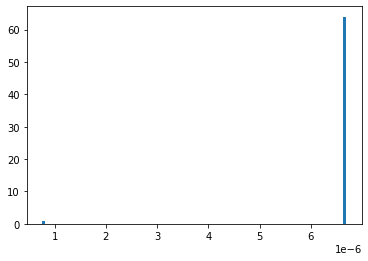

In [596]:
tot_dists = np.array(tot_dists)
plt.hist(tot_dists , bins=100)

In [592]:
np.min(tot_dist)

7.540160570791372e-07

In [597]:
tot_dists

array([6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
       6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
       6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
       6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
       6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
       6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
       6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
       6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
       6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
       6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
       6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
       6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
       6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
       6.69232886e-06, 6.69232886e-06, 6.69232886e-06, 6.69232886e-06,
      